In [12]:
# Scikit-learn (formerly scikits.learn and also known as sklearn) is a free
# software machine learning library for the Python programming language.
# It features various classification, regression and clustering algorithms,
# and is designed to interoperate with the Python numerical and scientific
# libraries NumPy and SciPy. (from wiki)
#!pip install scikit-learn
from sklearn import linear_model
from sklearn import tree
from sklearn import ensemble


import sklearn
from sklearn.preprocessing import StandardScaler 
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.datasets import make_blobs
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.inspection import permutation_importance

from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
#!pip install plotly
#!pip install seaborn
#!pip install tensorflow

# common visualization module
from matplotlib import pyplot as plt
import plotly.express as px
import seaborn as sns
sns.set()
# numeric library
import numpy as np

import os
import pandas as pd
from time import time as timer
import tarfile

import tensorflow as tf

%matplotlib inline
from matplotlib import animation
from IPython.display import HTML


#! pip install dtreeviz==1.4.0

from dtreeviz.trees import dtreeviz



In [5]:
df_diabetes=pd.DataFrame(pd.read_csv('sample_data/diabetes_7_lines_removed.csv'))
df_diabetes.head()
df_diabetes.tail()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
756,0,162,76,56,100,53.2,0.759,25,1
757,1,88,30,42,99,55.0,0.496,26,1
758,3,123,100,35,240,57.3,0.880,22,0
759,0,180,78,63,14,59.4,2.420,25,1
760,0,129,110,46,130,67.1,0.319,26,1


In [6]:
df_diabetes.info() # to see if we do not have null values

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 761 entries, 0 to 760
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Pregnancies               761 non-null    int64  
 1   Glucose                   761 non-null    int64  
 2   BloodPressure             761 non-null    int64  
 3   SkinThickness             761 non-null    int64  
 4   Insulin                   761 non-null    int64  
 5   BMI                       761 non-null    float64
 6   DiabetesPedigreeFunction  761 non-null    float64
 7   Age                       761 non-null    int64  
 8   Outcome                   761 non-null    int64  
dtypes: float64(2), int64(7)
memory usage: 53.6 KB


In [7]:
# to find correlations
corr = df_diabetes.corr()
corr


,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
Pregnancies,1.000000,0.128221,0.155633,-0.081089,-0.073177,0.024611,-0.033328,0.547661,0.219453
Glucose,0.128221,1.000000,0.134775,0.048342,0.328272,0.208180,0.132351,0.258764,0.465099
BloodPressure,0.155633,0.134775,1.000000,0.177027,0.070583,0.171465,0.018134,0.228983,0.054316
SkinThickness,-0.081089,0.048342,0.177027,1.000000,0.432838,0.376870,0.177007,-0.124315,0.070400
Insulin,-0.073177,0.328272,0.070583,0.432838,1.000000,0.187134,0.181254,-0.047263,0.128502
BMI,0.024611,0.208180,0.171465,0.376870,0.187134,1.000000,0.123081,0.008474,0.301248
DiabetesPedigreeFunction,-0.033328,0.132351,0.018134,0.177007,0.181254,0.123081,1.000000,0.028450,0.171662
Age,0.547661,0.258764,0.228983,-0.124315,-0.047263,0.008474,0.028450,1.000000,0.235470
Outcome,0.219453,0.465099,0.054316,0.070400,0.128502,0.301248,0.171662,0.235470,1.000000


<Axes: >

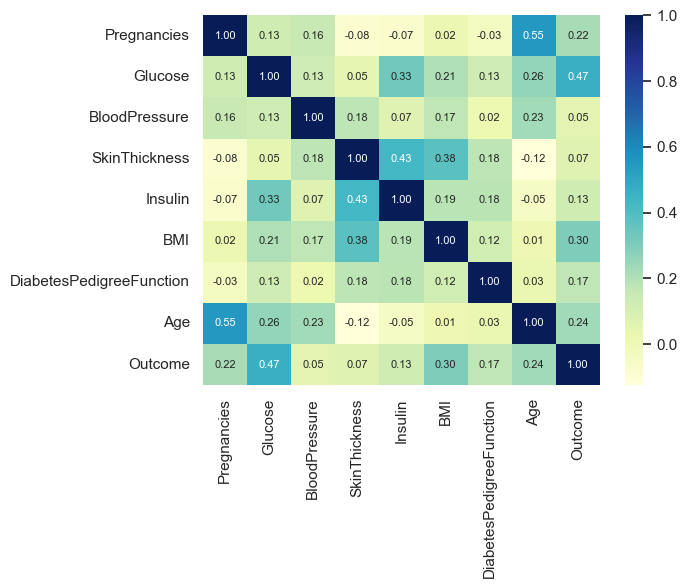

In [5]:
sns.heatmap(corr,
         xticklabels=corr.columns,
         yticklabels=corr.columns, cmap='YlGnBu', annot=True, fmt='.2f', annot_kws={"size": 8})

predict outcome by logistic regression, trees, random forest, boosted randorm forests.
Make feature importance

 we can also try to do linear regression and predict for example, glucose levels with the other variables or insulin levels with the other variables for example (does not make much sense in diagnostics, but for learning)
the most linear looks skin sickness vs BMI for example

In [6]:
df_diabetes.describe().T

,count,mean,std,min,25%,50%,75%,max
Pregnancies,761.0,3.840999,3.370491,0.000,1.000,3.000,6.000,17.00
Glucose,761.0,121.131406,31.989531,0.000,99.000,117.000,141.000,199.00
BloodPressure,761.0,69.741130,18.267674,0.000,64.000,72.000,80.000,122.00
SkinThickness,761.0,20.725361,15.902731,0.000,0.000,23.000,32.000,99.00
Insulin,761.0,80.533509,115.517596,0.000,0.000,36.000,129.000,846.00
BMI,761.0,32.286859,7.295107,0.000,27.400,32.200,36.600,67.10
DiabetesPedigreeFunction,761.0,0.474126,0.331947,0.078,0.244,0.378,0.629,2.42
Age,761.0,33.323259,11.779469,21.000,24.000,29.000,41.000,81.00
Outcome,761.0,0.350854,0.477551,0.000,0.000,0.000,1.000,1.00


array([[<Axes: title={'center': 'Pregnancies'}>,
        <Axes: title={'center': 'Glucose'}>,
        <Axes: title={'center': 'BloodPressure'}>],
       [<Axes: title={'center': 'SkinThickness'}>,
        <Axes: title={'center': 'Insulin'}>,
        <Axes: title={'center': 'BMI'}>],
       [<Axes: title={'center': 'DiabetesPedigreeFunction'}>,
        <Axes: title={'center': 'Age'}>,
        <Axes: title={'center': 'Outcome'}>]], dtype=object)

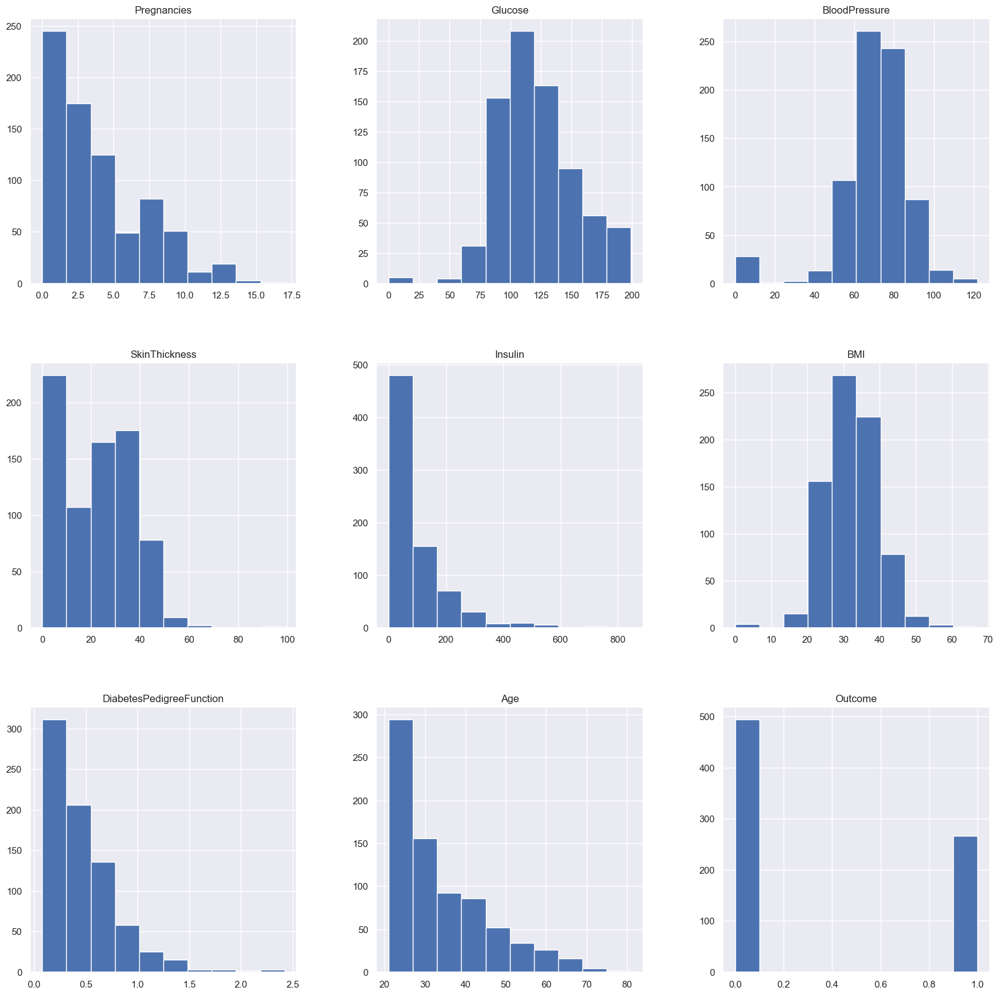

In [7]:


df_diabetes.hist(figsize = (20,20))



Cero values i columns: glucose, Blood Pressure, SkinThickness, Insulin and BMI do not make sense. Have to be replace. We will first replace them by nan, then by the mean value of each column because we do not want to miss data



In [8]:
df_diabetes_preprocessed=pd.DataFrame(pd.read_csv('sample_data/diabetes_preprocessed_correct.csv'))
df_diabetes_preprocessed.head()
df_diabetes_preprocessed.tail()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
756,0,162,76,56,100,53.2,0.759,25,1
757,1,88,30,42,99,55.0,0.496,26,1
758,3,123,100,35,240,57.3,0.880,22,0
759,0,180,78,63,14,59.4,2.420,25,1
760,0,129,110,46,130,67.1,0.319,26,1


In [9]:
print(df_diabetes_preprocessed.isnull().sum())

Pregnancies                 0
Glucose                     0
BloodPressure               0
SkinThickness               0
Insulin                     0
BMI                         0
DiabetesPedigreeFunction    0
Age                         0
Outcome                     0
dtype: int64


there are too many values to remove because we do not have enough data. We could replace them with the median of the column. But first look at the distribution.

array([[<Axes: title={'center': 'Pregnancies'}>,
        <Axes: title={'center': 'Glucose'}>,
        <Axes: title={'center': 'BloodPressure'}>],
       [<Axes: title={'center': 'SkinThickness'}>,
        <Axes: title={'center': 'Insulin'}>,
        <Axes: title={'center': 'BMI'}>],
       [<Axes: title={'center': 'DiabetesPedigreeFunction'}>,
        <Axes: title={'center': 'Age'}>,
        <Axes: title={'center': 'Outcome'}>]], dtype=object)

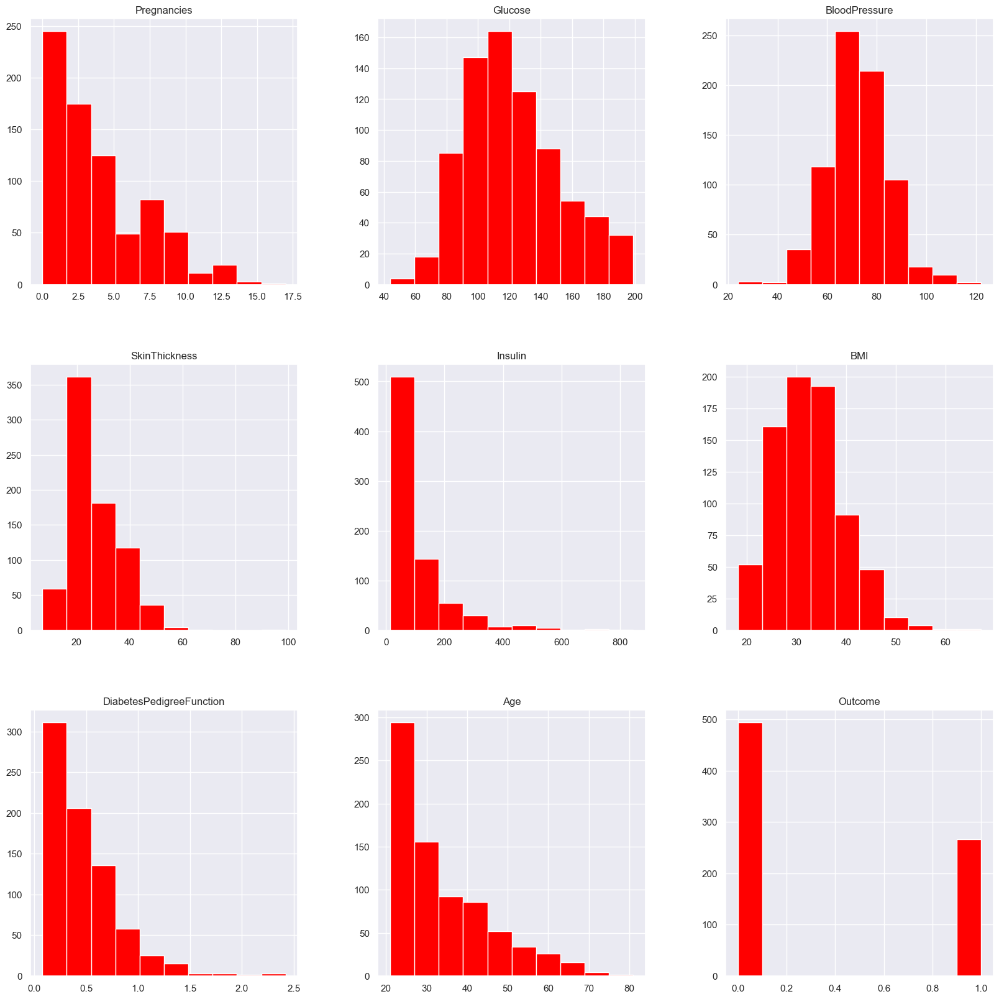

In [10]:


df_diabetes_preprocessed.hist(figsize= (20,20), color='Red')



In [11]:
corr2= df_diabetes_preprocessed.corr()
corr2

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
Pregnancies,1.000000,0.126957,0.209557,0.033311,-0.051649,0.021693,-0.033328,0.547661,0.219453
Glucose,0.126957,1.000000,0.219707,0.169336,0.359774,0.231954,0.131952,0.261836,0.491450
BloodPressure,0.209557,0.219707,1.000000,0.147822,-0.025488,0.281208,-0.002603,0.325652,0.166148
SkinThickness,0.033311,0.169336,0.147822,1.000000,0.234713,0.547167,0.140307,0.051423,0.188011
Insulin,-0.051649,0.359774,-0.025488,0.234713,1.000000,0.189379,0.173113,-0.014246,0.150226
BMI,0.021693,0.231954,0.281208,0.547167,0.189379,1.000000,0.153628,0.025462,0.313004
DiabetesPedigreeFunction,-0.033328,0.131952,-0.002603,0.140307,0.173113,0.153628,1.000000,0.028450,0.171662
Age,0.547661,0.261836,0.325652,0.051423,-0.014246,0.025462,0.028450,1.000000,0.235470
Outcome,0.219453,0.491450,0.166148,0.188011,0.150226,0.313004,0.171662,0.235470,1.000000


Text(0.5, 1.0, 'Heat map replace 0 values by mean')

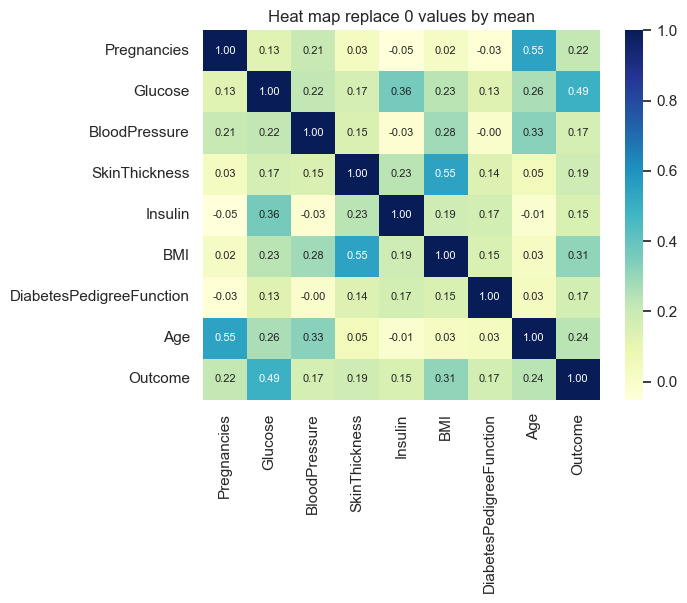

In [12]:
sns.heatmap(corr2,
         xticklabels=corr.columns,
         yticklabels=corr.columns, cmap='YlGnBu', annot=True, fmt='.2f', annot_kws={"size": 8})
plt.title('Heat map replace 0 values by mean')


Text(0.5, 1.0, 'Heat map original values')

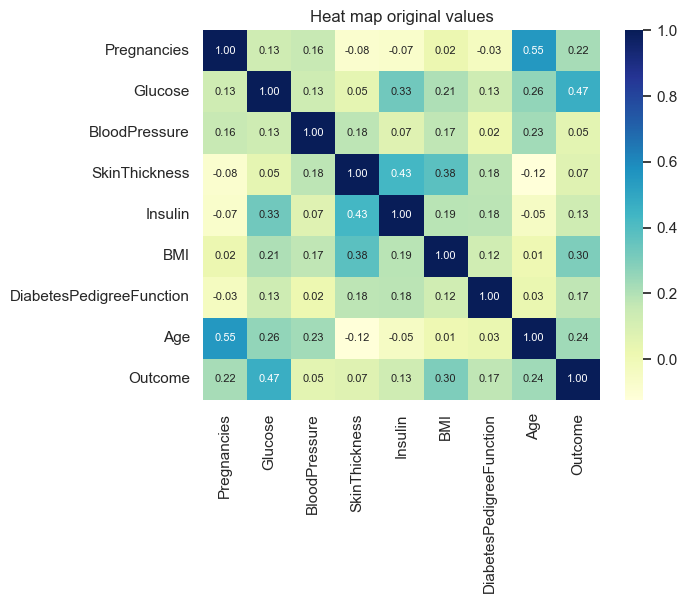

In [13]:
sns.heatmap(corr,
         xticklabels=corr.columns,
         yticklabels=corr.columns, cmap='YlGnBu', annot=True, fmt='.2f', annot_kws={"size": 8})
plt.title('Heat map original values')

OptionError: "No such keys(s): 'mode.use_inf_as_null'"

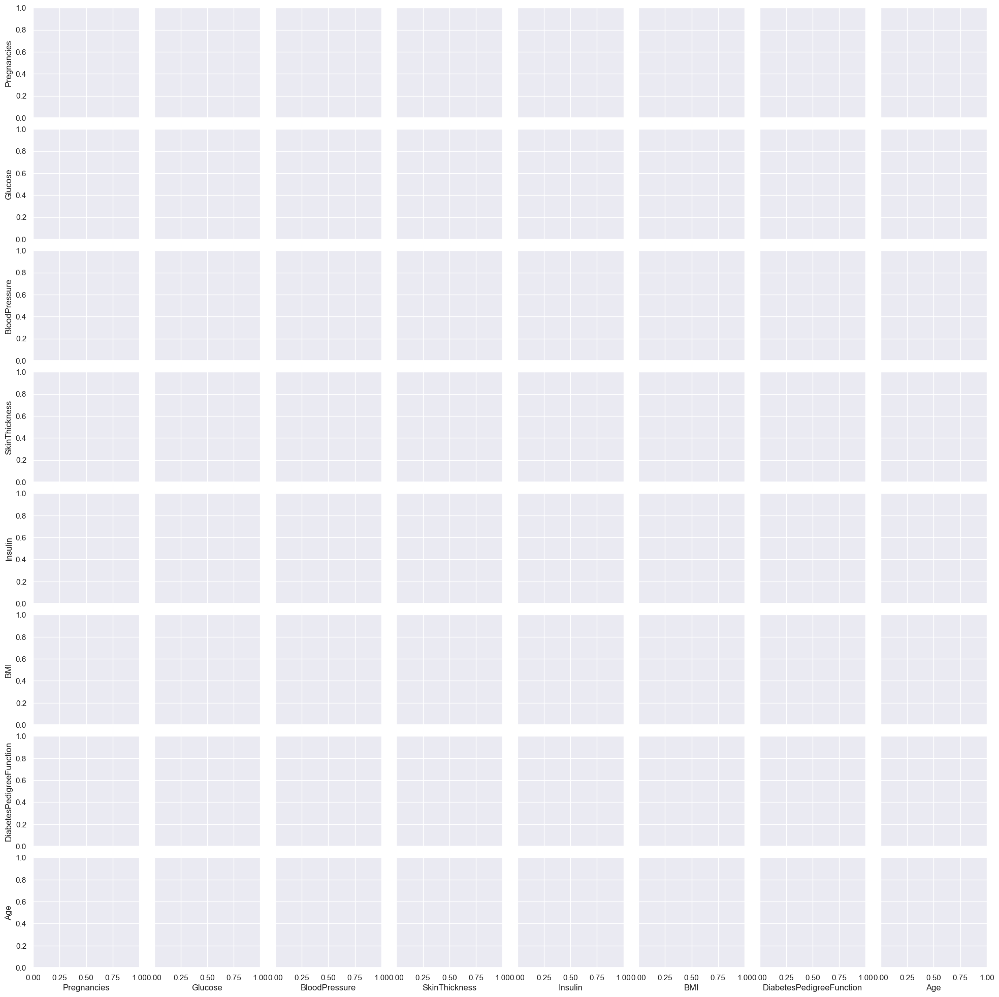

In [348]:
sns.pairplot(df_diabetes, hue = 'Outcome')
plt.title('Original values')
# suddenly this code is not working....but was a nice pair plots of all the features.

OptionError: "No such keys(s): 'mode.use_inf_as_null'"

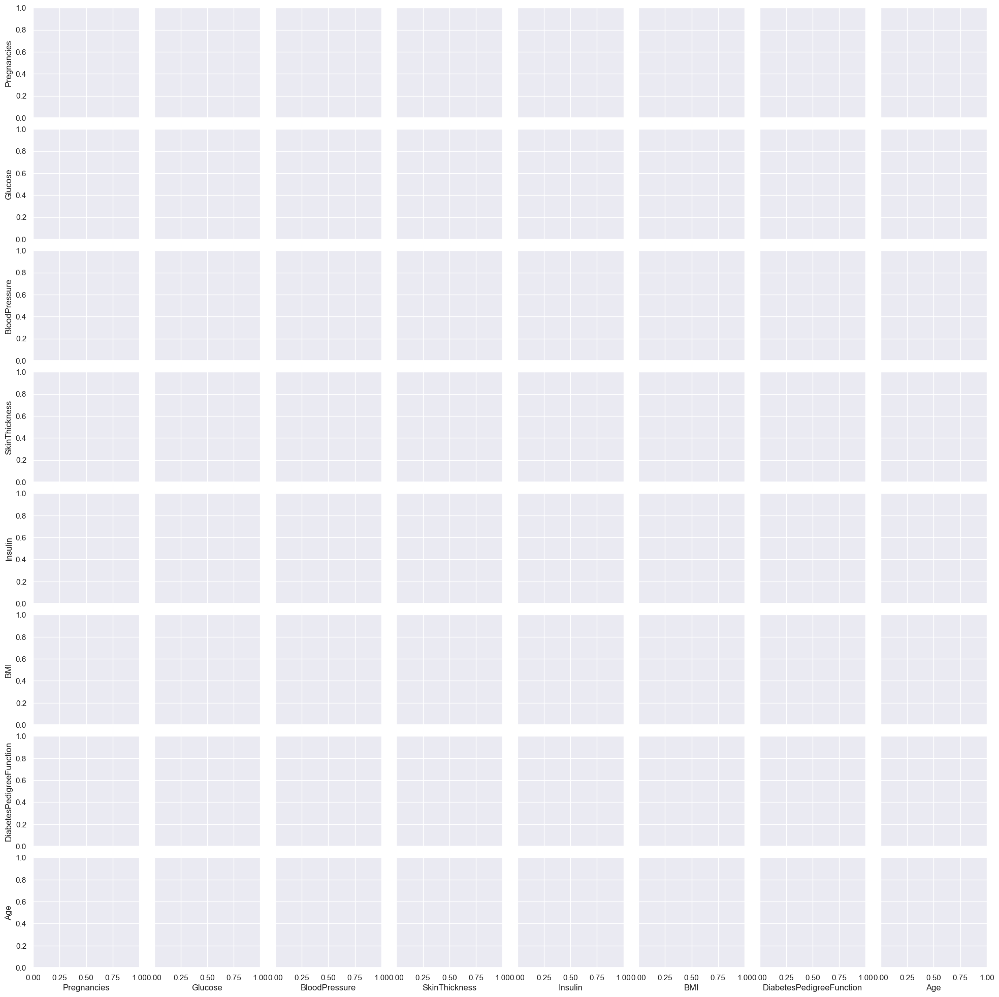

In [349]:

p = sns.pairplot(df_diabetes, hue='Outcome')
plt.title('Original values')

# Show the plot
plt.show()

OptionError: "No such keys(s): 'mode.use_inf_as_null'"

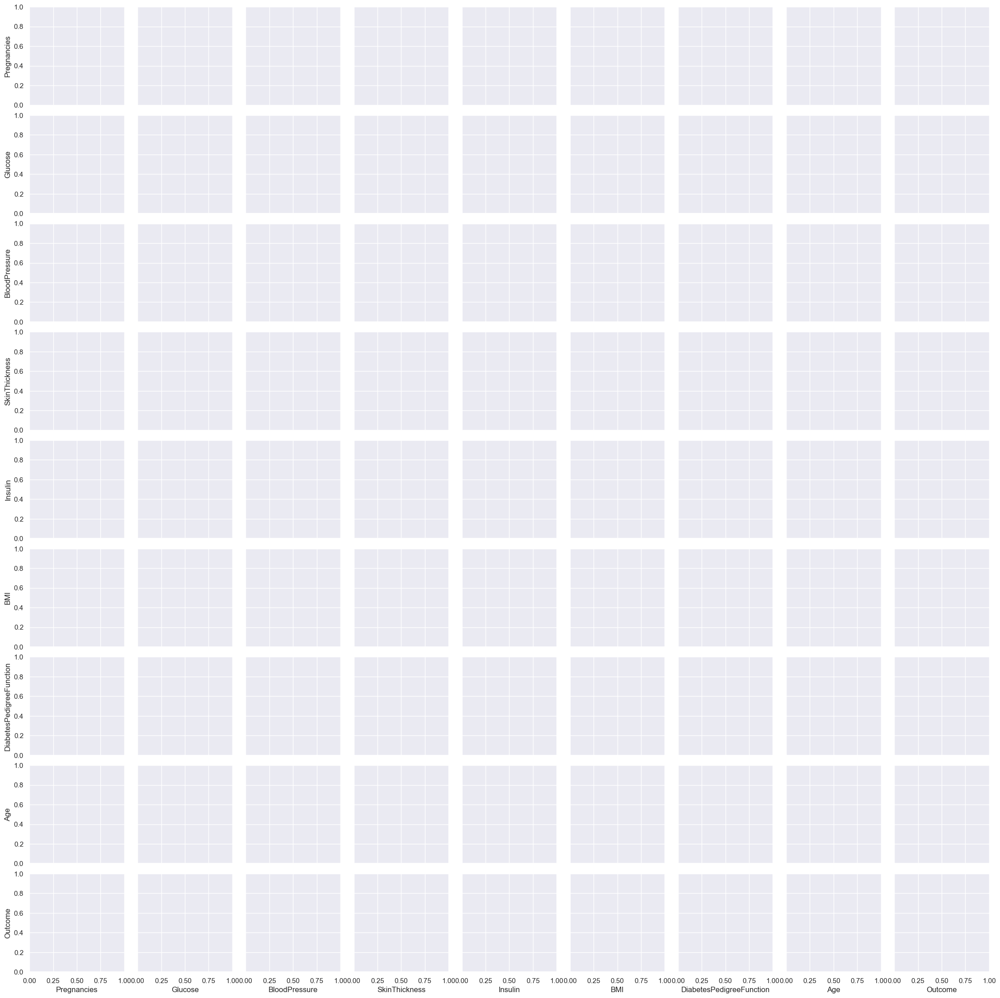

/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is depr

/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dty

/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is depr

/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is depr

/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is depr

/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is depr

/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is depr

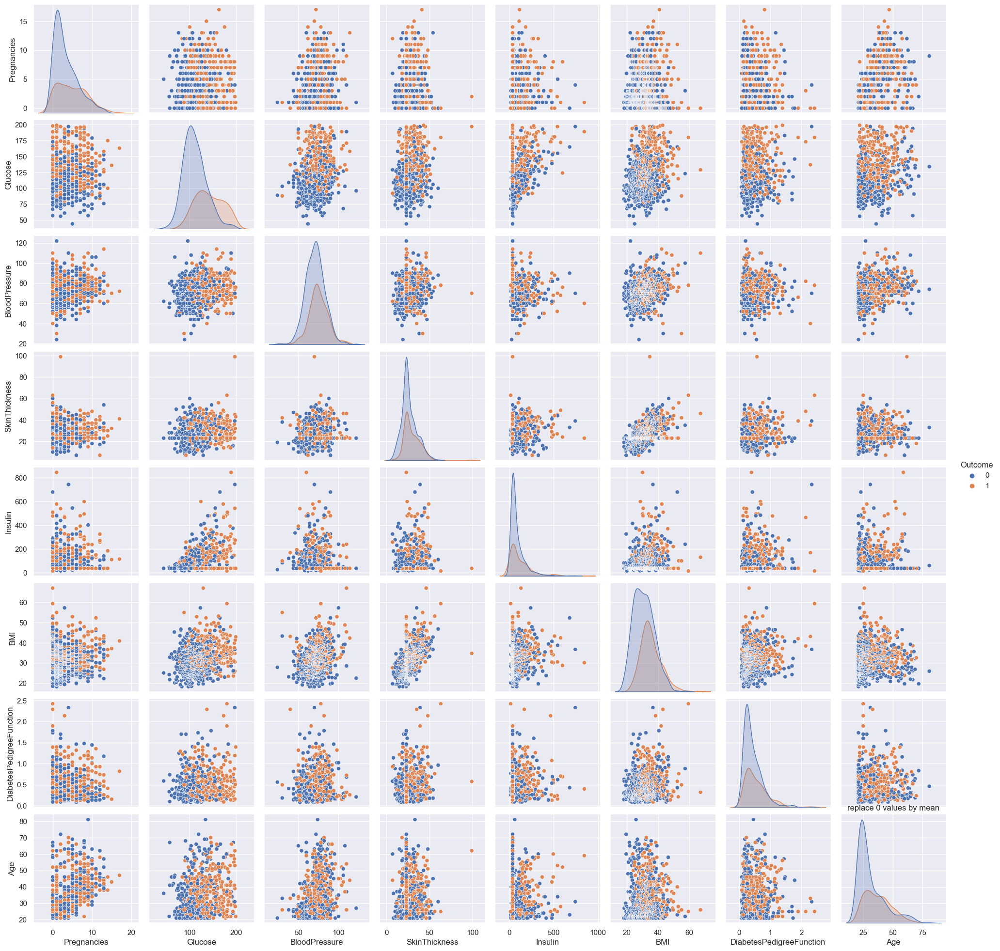

In [15]:

    


P= sns.pairplot(df_diabetes_preprocessed, hue = 'Outcome')
plt.title('replace 0 values by mean')
plt.show()

OptionError: "No such keys(s): 'mode.use_inf_as_null'"

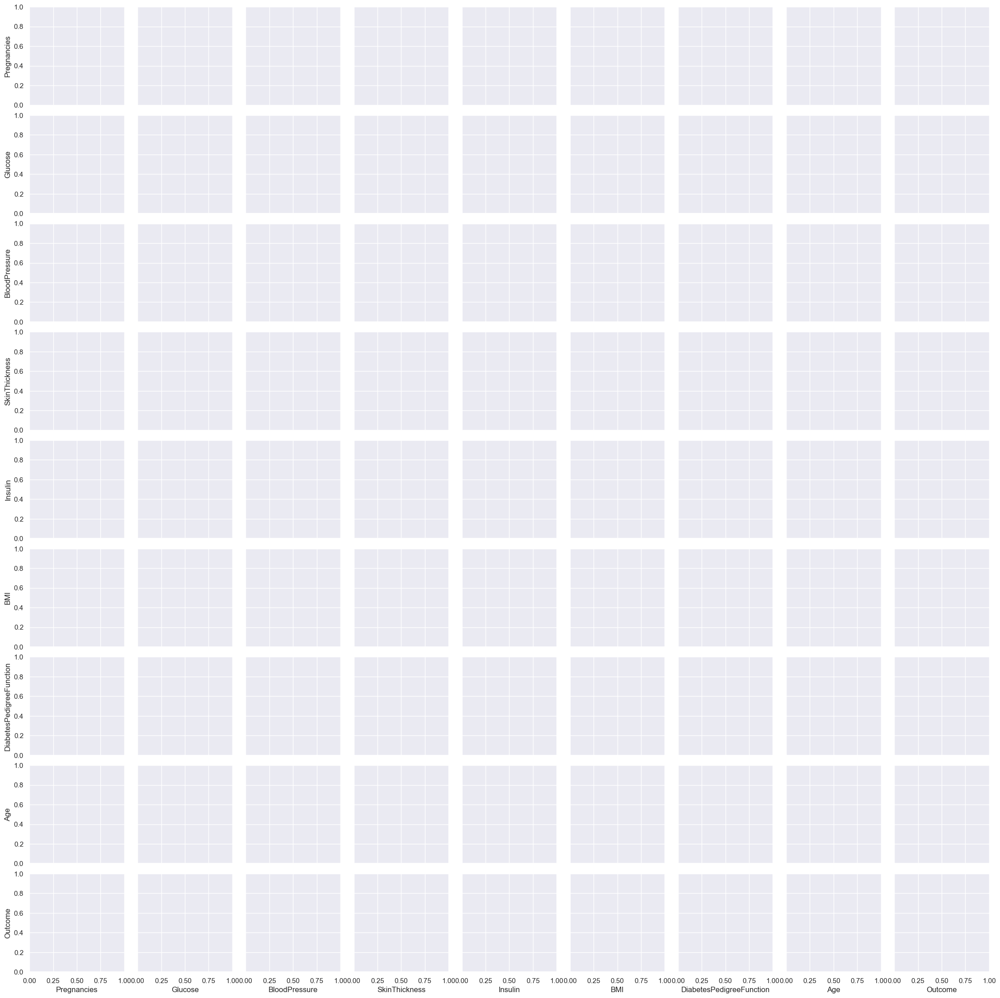

In [350]:
sns.pairplot(df_diabetes, diag_kind='kde')
P= sns.pairplot(df_diabetes_preprocessed, hue = 'Outcome')
plt.title('Original Data')


In [15]:
# try removed all entries with 0 insulin values and the replace by the median the other factors
df_diabetes_preprocessed_insulin = df_diabetes[df_diabetes['Insulin'] != 0].copy()

#df_diabetes
df_diabetes_preprocessed_insulin
print(df_diabetes_preprocessed_insulin.isnull().sum())


Pregnancies                 0
Glucose                     0
BloodPressure               0
SkinThickness               0
Insulin                     0
BMI                         0
DiabetesPedigreeFunction    0
Age                         0
Outcome                     0
dtype: int64


In [16]:
df_diabetes_preprocessed_insulin['BloodPressure'].replace(0, df_diabetes_preprocessed_insulin['BloodPressure'].median(), inplace=True)
df_diabetes_preprocessed_insulin['Glucose'].replace(0, df_diabetes_preprocessed_insulin['Glucose'].median(), inplace=True)
df_diabetes_preprocessed_insulin['BMI'].replace(0, df_diabetes_preprocessed_insulin['BMI'].median(), inplace=True)
df_diabetes_preprocessed_insulin['SkinThickness'].replace(0, df_diabetes_preprocessed_insulin['SkinThickness'].median(), inplace=True)
print(df_diabetes_preprocessed_insulin.isnull().sum())


Pregnancies                 0
Glucose                     0
BloodPressure               0
SkinThickness               0
Insulin                     0
BMI                         0
DiabetesPedigreeFunction    0
Age                         0
Outcome                     0
dtype: int64


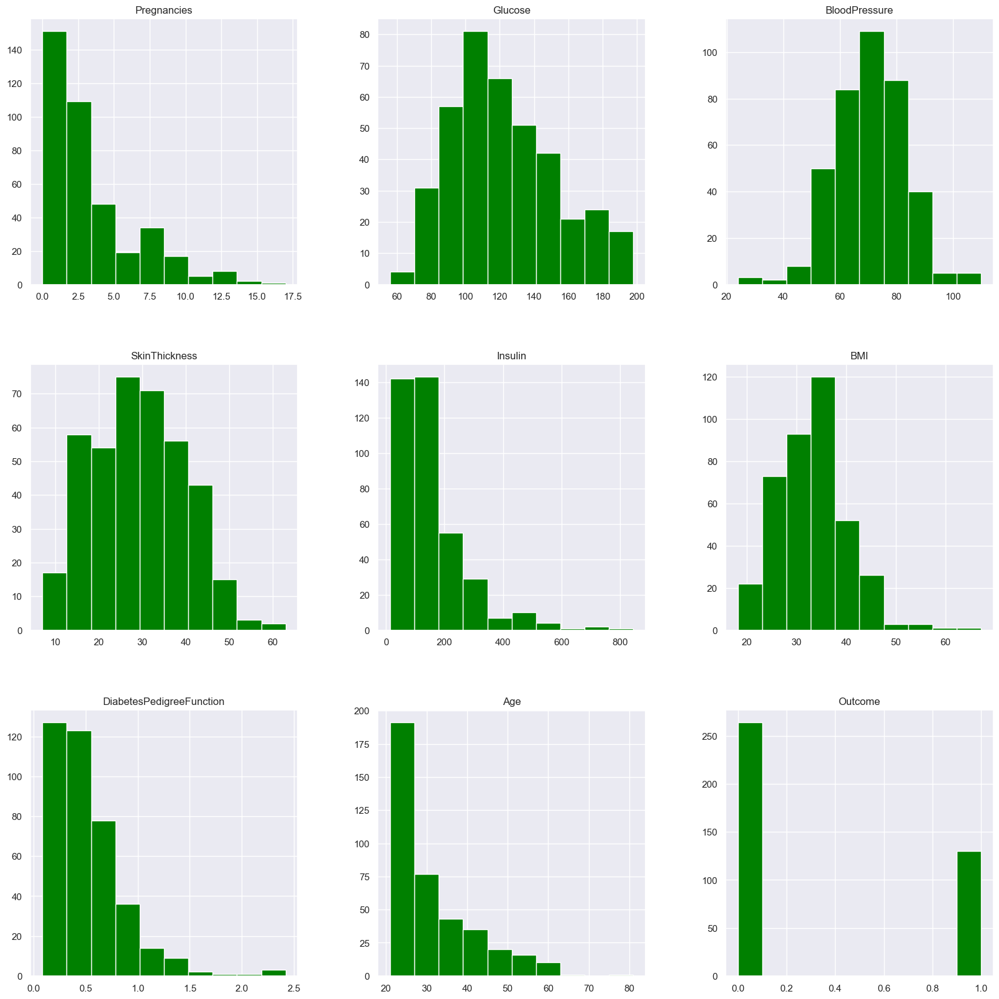

Text(0.5, 1.0, 'Heat map values all 0 insulin removed')

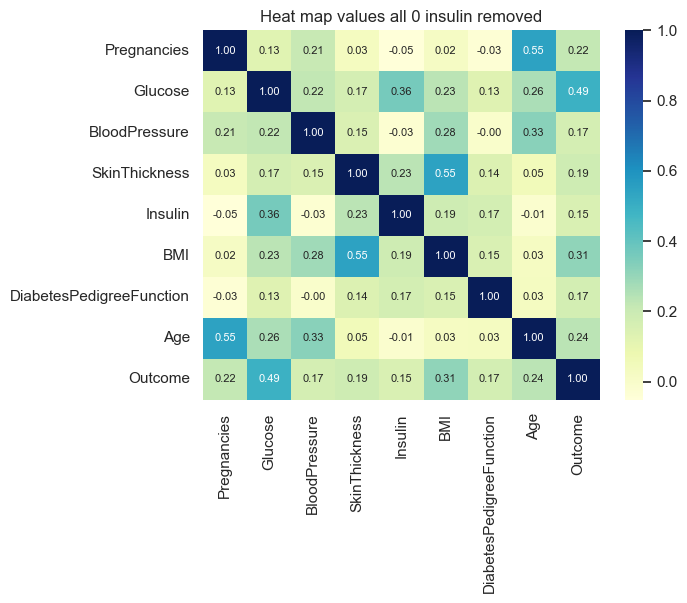

In [17]:
#exploration this filter data
df_diabetes_preprocessed_insulin.hist(figsize= (20,20), color='green')
plt.show()
corr3= df_diabetes_preprocessed.corr()
corr3
sns.heatmap(corr3,
         xticklabels=corr.columns,
         yticklabels=corr.columns, cmap='YlGnBu', annot=True, fmt='.2f', annot_kws={"size": 8})
plt.title('Heat map values all 0 insulin removed')

In [9]:
# prepare x and y for logistic regression and random forest:

# create the list  of features and outcomes for labelling graphs later

features = ['Pregnancies',
                  'Glucose', 'BloodPressure', 'SkinThickness',
                  'Insulin', 'BMI', 'DiabetesPedigreeFunction', 'Age'
                  ]

Output_names = ['Non-diabetes', 'Diabetes']

# select x (features to predict) and y (target out put fild) and convert to np arrays

# Select the data frame to use for training.
#data =df_diabetes_preprocessed_insulin # insulin values 0 all removed
data= df_diabetes_preprocessed # only 7 values removed

df_y = data.Outcome
#print(df_y)
df_x= data.drop('Outcome', axis=1)
#print(df_x)
x = df_x.to_numpy().astype(np.float32)
y = df_y.to_numpy().astype(np.float32)
print(y)
print(x)



[0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 1. 0. 0. 0.
 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 1. 0. 0. 0.
 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0. 0.
 0. 1. 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0.
 1. 0. 1. 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.
 1. 0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 1. 0. 0. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 0. 0.
 0. 0. 0. 0. 1. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 1. 0.
 0. 1. 1. 1. 0. 0. 0. 1. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 1.
 1. 1. 1. 0. 1. 1. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0.

In [78]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)
print(x_train)
print(y_train)
print(x_test)
print(y_test)
print(len(x_train))
print(len(x_test))
print(len(y_train))
print(len(y_test))

[[  5.    139.     80.    ...  31.6     0.361  25.   ]
 [  3.    111.     58.    ...  29.5     0.43   22.   ]
 [  6.    162.     62.    ...  24.3     0.178  50.   ]
 ...
 [  7.    107.     74.    ...  29.6     0.254  31.   ]
 [  1.    118.     58.    ...  33.3     0.261  23.   ]
 [  3.     96.     56.    ...  24.7     0.944  39.   ]]
[1. 0. 1. 0. 0. 0. 0. 1. 1. 0. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.
 0. 0. 1. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0. 1. 0. 0. 1. 0. 0. 1. 1.
 0. 1. 0. 0. 0. 1. 0. 1. 0. 0. 0. 0. 0. 1. 0. 1. 1. 0. 1. 0. 0. 1. 1. 0.
 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0.
 1. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1.
 1. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 0. 1. 0. 1. 1. 0. 0. 0. 1. 1. 1. 0. 1.
 1. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0. 0.
 0. 0. 1. 0. 1. 0. 1. 0. 0. 0. 1. 0. 0. 1. 1. 0. 0. 1. 1. 0. 0. 1. 0. 0.
 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 1. 0. 0. 1. 0. 0. 1. 1.
 0. 0. 

In [20]:
has_nan = np.isnan(x).any()

if has_nan:
    print("The array contains NaN values.")
else:
    print("The array does not contain any NaN values.")

same_dtype = np.all(np.array([x.dtype == x.dtype for x in x]))

if same_dtype:
    print("All elements have the same data type.")
else:
    print("Elements have different data types.")
    
has_infinite_values = np.isinf(x).any()

if has_infinite_values:
    print('x has infinite values')
else:
    print('x has NO infinite values')

The array does not contain any NaN values.
All elements have the same data type.
x has NO infinite values


In [21]:
for n_iter in (10, 20, 30,50, 100, 10000):
  clf = linear_model.LogisticRegression(solver='liblinear', max_iter= n_iter,
                                      multi_class='ovr')
#logreg = LogisticRegression(multi_class='ovr', solver='liblinear')

# 2. fit the model
  t1 = timer()
  clf.fit(x_train, y_train)
  t2 = timer()
  print ('training time: %.1fs'%(t2-t1),'in', n_iter, 'iterations')

# 3. evaluate accuracy on train and test datasets
  print("training score : %.3f" % (clf.score(x_train, y_train)),'in', n_iter, 'iterations')
  print("test score : %.3f" % (clf.score(x_test, y_test)),'in', n_iter, 'iterations')





training time: 0.0s in 10 iterations
training score : 0.722 in 10 iterations
test score : 0.641 in 10 iterations
training time: 0.0s in 20 iterations
training score : 0.776 in 20 iterations
test score : 0.732 in 20 iterations
training time: 0.0s in 30 iterations
training score : 0.776 in 30 iterations
test score : 0.732 in 30 iterations
training time: 0.0s in 50 iterations
training score : 0.776 in 50 iterations
test score : 0.732 in 50 iterations
training time: 0.0s in 100 iterations
training score : 0.776 in 100 iterations
test score : 0.732 in 100 iterations
training time: 0.0s in 10000 iterations
training score : 0.776 in 10000 iterations
test score : 0.732 in 10000 iterations


/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


In [22]:
# the score is not so good.. try to normalized the features for the test or remove missing values?


Confusion Matrix test:
[[83 16]
 [25 29]]
Confusion Matrix train:
[[350  45]
 [ 91 122]]
              precision    recall  f1-score   support

         0.0       0.77      0.84      0.80        99
         1.0       0.64      0.54      0.59        54

    accuracy                           0.73       153
   macro avg       0.71      0.69      0.69       153
weighted avg       0.72      0.73      0.73       153



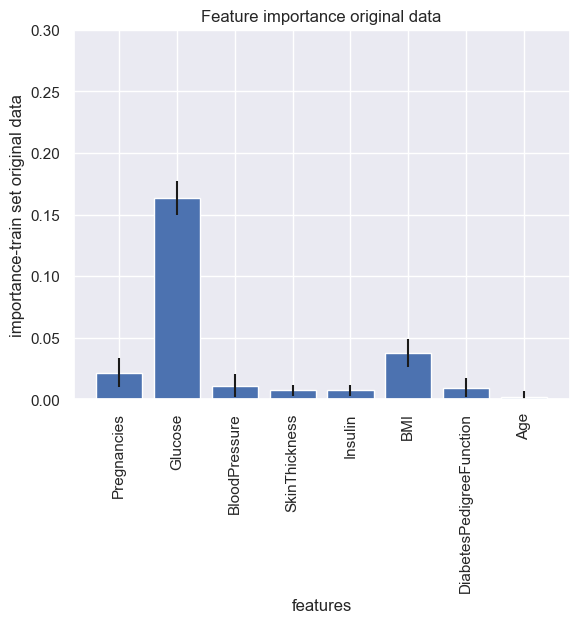

In [23]:
# 4. evaluate the confusion matrix on the test set using, from sklearn import metrics the metrics.confusion_matrix method (check documentation)

import sklearn
from sklearn.metrics import confusion_matrix

y_pred_test = clf.predict(x_test)
#y_pred_test_proba= clf.predict_proba(x_test)
#np.sum(_pred_test_proba[0])
sklearn.metrics.confusion_matrix(y_test, y_pred_test, labels=None, sample_weight=None, normalize=None)
y_pred_train=clf.predict(x_train)
sklearn.metrics.confusion_matrix(y_train,y_pred_train)

# 5. inspect the confusion metrics and compute using matrix manipulations the precision and recall for each category



# Calculate the confusion matrix
confusion_test = confusion_matrix(y_test, y_pred_test)

print("Confusion Matrix test:")
print(confusion_test)

confusion_train = confusion_matrix(y_train, y_pred_train)


print("Confusion Matrix train:")
print(confusion_train)

print(classification_report(y_test, y_pred_test))

# calculate feature importance

p_importances = permutation_importance(clf, x_train, y_train, n_repeats=20, n_jobs=-1,random_state=42)

plt.bar(features,
        p_importances.importances_mean,
        yerr=p_importances.importances_std)
plt.xticks(rotation=90)
plt.xlabel('features')
plt.ylabel('importance-train set original data')
plt.title('Feature importance original data')
plt.ylim(0, 0.3)
plt.show()

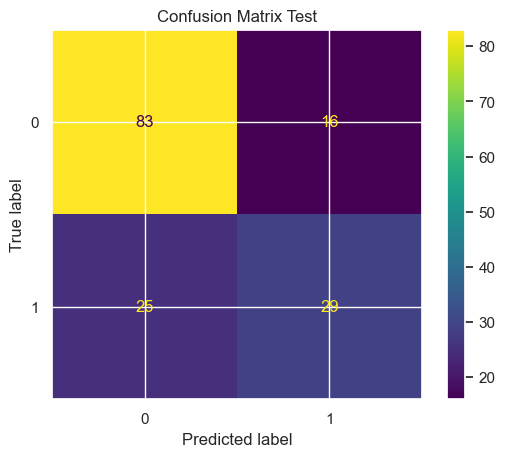

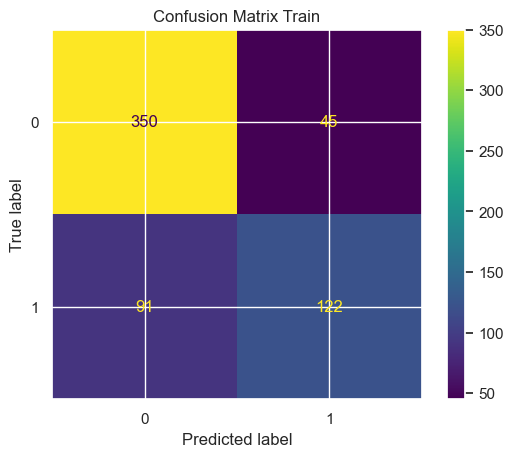

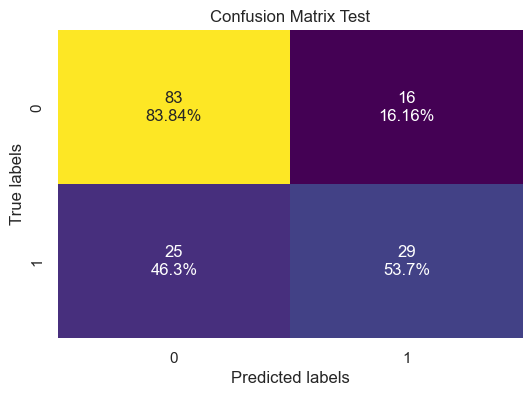

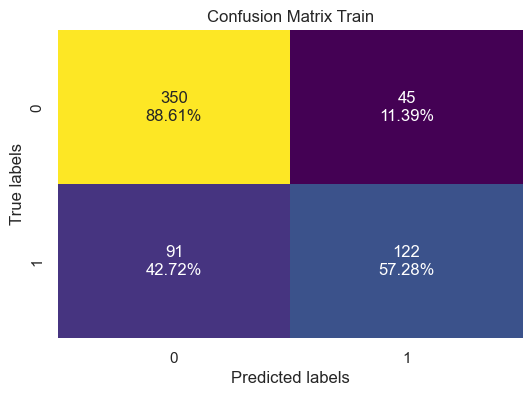

In [24]:
from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix

cm_display = ConfusionMatrixDisplay(confusion_test).plot()
plt.title('Confusion Matrix Test')
cm_display = ConfusionMatrixDisplay(confusion_train).plot()
plt.title('Confusion Matrix Train')


# Display the confusion matrix with values and percentages
cm_sum = np.sum(confusion_test, axis=1, keepdims=True)
cm_percentages = confusion_test / cm_sum.astype(float) * 100
cm_with_percentages = np.round(cm_percentages, 2)

plt.figure(figsize=(6, 4))
sns.heatmap(
    confusion_test,
    annot=np.array([f'{v1}\n{v2}%' for v1, v2 in zip(confusion_test.flatten(), cm_with_percentages.flatten())]).reshape(confusion_test.shape),
    fmt='',
    cmap='viridis',
    cbar=False
)
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix Test')
plt.show()


cm_sum = np.sum(confusion_train, axis=1, keepdims=True)
cm_percentages = confusion_train / cm_sum.astype(float) * 100
cm_with_percentages = np.round(cm_percentages, 2)

# Display the confusion matrix with values and percentages
plt.figure(figsize=(6, 4))
sns.heatmap(
    confusion_train,
    annot=np.array([f'{v1}\n{v2}%' for v1, v2 in zip(confusion_train.flatten(), cm_with_percentages.flatten())]).reshape(confusion_train.shape),
    fmt='',
    cmap='viridis',
    cbar=False
)
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix Train')
plt.show()

Check that you get the same accuracy from the score method: 0.7320261437908496


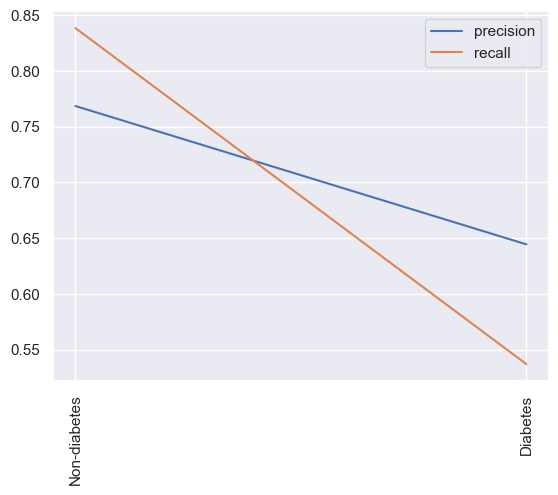

In [25]:


print(f'Check that you get the same accuracy from the score method: {np.sum([confusion_test[i,i] for i in range(2)])/np.sum(confusion_test)}')
#sums the diagonal and divide the whole matrix
precisions=[]
recalls=[]
#precision
for i in range(2):
    precisions.append(confusion_test[i,i]/np.sum(confusion_test[:,i])) #take the diagonal divided by the whole column
#percentage of positive identified??
#recall
for i in range(2):
    recalls.append(confusion_test[i,i]/np.sum(confusion_test[i,:])) #take the diagonal and divide by the whole row

plt.plot(Output_names,precisions, label='precision')
plt.plot(Output_names,recalls, label='recall')
plt.xticks(rotation=90)
plt.legend()

plt.show()

the accuracy is not so great with linear regression. We can try to normalized the data for example.
or use other methods


for non diabetes it looks ok, high precision, so good accuracy in predicting most of the positives and recall: good in finding the relevant cases (sensitivity).
for diabetes... it has much lower recall....so it is nit able to find all the positives.  

In [26]:
#try to normalized the data first:
# standard scaler: each feature has a mean of 0 and a standard deviation of 1. 

from sklearn.preprocessing import StandardScaler 
from sklearn.preprocessing import MinMaxScaler

scaler = StandardScaler()
x_scaled_standar = scaler.fit_transform(x)
print(x_scaled_standar)

print(x)


[[-1.1403456  -0.12822849 -0.69088876 ... -0.03710537  3.7888546
  -1.0468522 ]
 [-1.1403456  -0.6542763   0.21489507 ... -0.03710537  0.29504144
  -1.0468522 ]
 [ 0.34409332  0.46357533  0.791303   ... -0.03710537  0.5000278
   3.0307143 ]
 ...
 [-0.24968223  0.03616147  2.2734947  ...  3.5994024   1.2235093
  -0.9619029 ]
 [-1.1403456   1.9102069   0.46192703 ...  3.9036522   5.86585
  -0.707055  ]
 [-1.1403456   0.23342942  3.0969346  ...  5.0192337  -0.46762878
  -0.6221057 ]]
[[  0.    118.     64.    ...  32.2     1.731  21.   ]
 [  0.    102.     75.    ...  32.2     0.572  21.   ]
 [  5.    136.     82.    ...  32.2     0.64   69.   ]
 ...
 [  3.    123.    100.    ...  57.3     0.88   22.   ]
 [  0.    180.     78.    ...  59.4     2.42   25.   ]
 [  0.    129.    110.    ...  67.1     0.319  26.   ]]


In [27]:
has_nan = np.isnan(x_scaled_standar).any()

if has_nan:
    print("The array contains NaN values.")
else:
    print("The array does not contain any NaN values.")
    
    


The array does not contain any NaN values.


In [28]:
from sklearn.preprocessing import MinMaxScaler

# normalization to values between 0 and 1
scaler = MinMaxScaler()
x_scaled_minmax = scaler.fit_transform(x)
print(x_scaled_minmax)


[[0.         0.47741935 0.40816325 ... 0.2862986  0.705807   0.        ]
 [0.         0.37419352 0.52040815 ... 0.2862986  0.21093082 0.        ]
 [0.29411766 0.5935484  0.5918367  ... 0.2862986  0.23996583 0.8000001 ]
 ...
 [0.1764706  0.5096774  0.7755102  ... 0.79959095 0.34244233 0.01666665]
 [0.         0.87741935 0.5510204  ... 0.84253585 1.0000001  0.06666666]
 [0.         0.54838705 0.87755096 ... 1.         0.1029035  0.08333334]]


training time: 0.0s in 10 iterations
training score : 0.771 in 10 iterations
test score : 0.758 in 10 iterations
training time: 0.0s in 20 iterations
training score : 0.771 in 20 iterations
test score : 0.758 in 20 iterations
training time: 0.0s in 30 iterations
training score : 0.771 in 30 iterations
test score : 0.758 in 30 iterations
training time: 0.0s in 50 iterations
training score : 0.771 in 50 iterations
test score : 0.758 in 50 iterations
training time: 0.0s in 100 iterations
training score : 0.771 in 100 iterations
test score : 0.758 in 100 iterations
training time: 0.0s in 10000 iterations
training score : 0.771 in 10000 iterations
test score : 0.758 in 10000 iterations


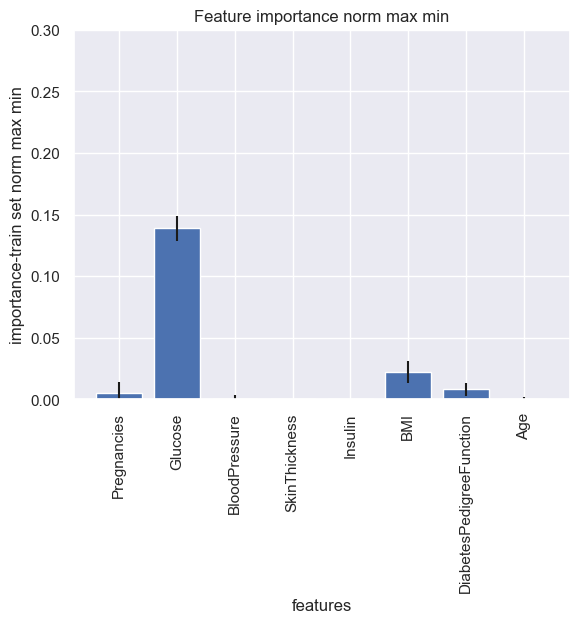

Confusion Matrix test:
[[87 12]
 [25 29]]
Confusion Matrix train:
[[357  38]
 [101 112]]


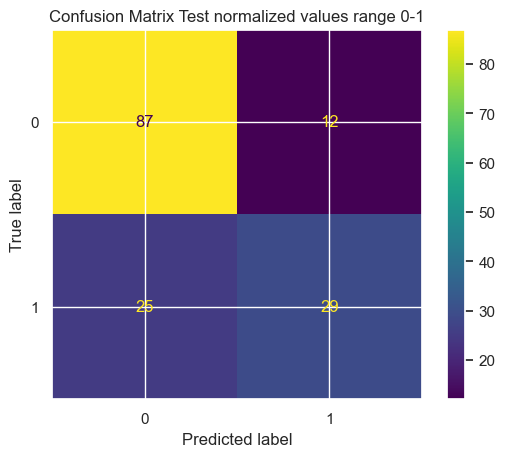

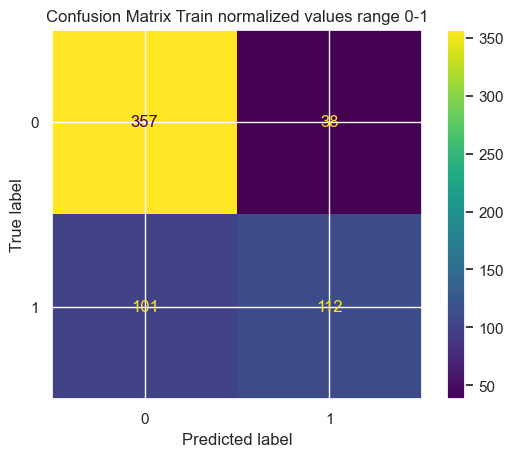

Check that you get the same accuracy from the score method: 0.7581699346405228


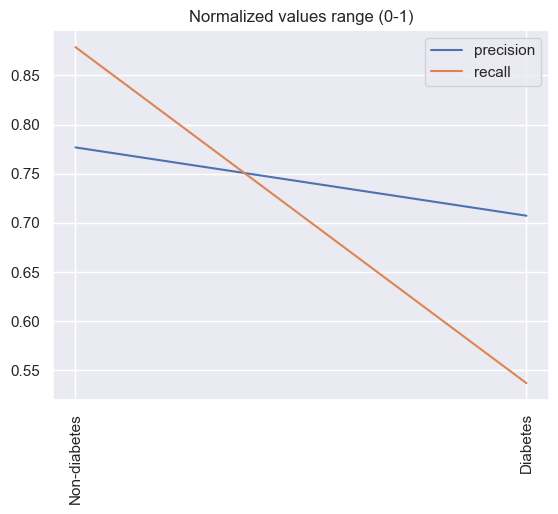

              precision    recall  f1-score   support

         0.0       0.78      0.88      0.82        99
         1.0       0.71      0.54      0.61        54

    accuracy                           0.76       153
   macro avg       0.74      0.71      0.72       153
weighted avg       0.75      0.76      0.75       153



In [29]:
# linear regression with normalized values between 0 to 1.

x_train, x_test, y_train, y_test = train_test_split(x_scaled_minmax, y, test_size=0.2,random_state=42)

for n_iter in (10, 20, 30,50, 100, 10000):
  clf = linear_model.LogisticRegression(solver='liblinear', max_iter= n_iter,
                                      multi_class='ovr')
#logreg = LogisticRegression(multi_class='ovr', solver='liblinear')

# 2. fit the model
  t1 = timer()
  clf.fit(x_train, y_train)
  t2 = timer()
  print ('training time: %.1fs'%(t2-t1),'in', n_iter, 'iterations')

# 3. evaluate accuracy on train and test datasets
  print("training score : %.3f" % (clf.score(x_train, y_train)),'in', n_iter, 'iterations')
  print("test score : %.3f" % (clf.score(x_test, y_test)),'in', n_iter, 'iterations')


# feature importance

p_importances = permutation_importance(clf, x_train, y_train, n_repeats=20, n_jobs=-1,random_state=42)

plt.bar(features,
        p_importances.importances_mean,
        yerr=p_importances.importances_std)
plt.xticks(rotation=90)
plt.xlabel('features')
plt.ylabel('importance-train set norm max min')
plt.title('Feature importance norm max min')
plt.ylim(0, 0.3)
plt.show()

# 4. evaluate the confusion matrix on the test set using, from sklearn import metrics the metrics.confusion_matrix method (check documentation)


y_pred_test = clf.predict(x_test)
#y_pred_test_proba= clf.predict_proba(x_test)
#np.sum(_pred_test_proba[0])
sklearn.metrics.confusion_matrix(y_test, y_pred_test, labels=None, sample_weight=None, normalize=None)
y_pred_train=clf.predict(x_train)
sklearn.metrics.confusion_matrix(y_train,y_pred_train)

# 5. inspect the confusion metrics and compute using matrix manipulations the precision and recall for each category


# Assuming you have already obtained 'y_pred' and 'y_test'
# 'y_pred' contains the predicted class labels, and 'y_test' contains the true class labels.

# Calculate the confusion matrix
confusion_test = confusion_matrix(y_test, y_pred_test)

print("Confusion Matrix test:")
print(confusion_test)

confusion_train = confusion_matrix(y_train, y_pred_train)

print("Confusion Matrix train:")
print(confusion_train)

cm_display = ConfusionMatrixDisplay(confusion_test).plot()
plt.title('Confusion Matrix Test normalized values range 0-1')
cm_display = ConfusionMatrixDisplay(confusion_train).plot()
plt.title('Confusion Matrix Train normalized values range 0-1')
plt.show()

Output_names = ['Non-diabetes', 'Diabetes']

print(f'Check that you get the same accuracy from the score method: {np.sum([confusion_test[i,i] for i in range(2)])/np.sum(confusion_test)}')
#sums the diagonal and divide the whole matrix
precisions=[]
recalls=[]
#precision
for i in range(2):
    precisions.append(confusion_test[i,i]/np.sum(confusion_test[:,i])) #take the diagonal divided by the whole column
#percentage of positive identified??
#recall
for i in range(2):
    recalls.append(confusion_test[i,i]/np.sum(confusion_test[i,:])) #take the diagonal and divide by the whole row

plt.plot(Output_names,precisions, label='precision')
plt.plot(Output_names,recalls, label='recall')
plt.title('Normalized values range (0-1)')
plt.xticks(rotation=90)
plt.legend()

plt.show()

print(classification_report(y_test, y_pred_test))


training time: 0.0s in 10 iterations
training score : 0.776 in 10 iterations
test score : 0.765 in 10 iterations
training time: 0.0s in 20 iterations
training score : 0.776 in 20 iterations
test score : 0.765 in 20 iterations
training time: 0.0s in 30 iterations
training score : 0.776 in 30 iterations
test score : 0.765 in 30 iterations
training time: 0.0s in 50 iterations
training score : 0.776 in 50 iterations
test score : 0.765 in 50 iterations
training time: 0.0s in 100 iterations
training score : 0.776 in 100 iterations
test score : 0.765 in 100 iterations
training time: 0.0s in 10000 iterations
training score : 0.776 in 10000 iterations
test score : 0.765 in 10000 iterations


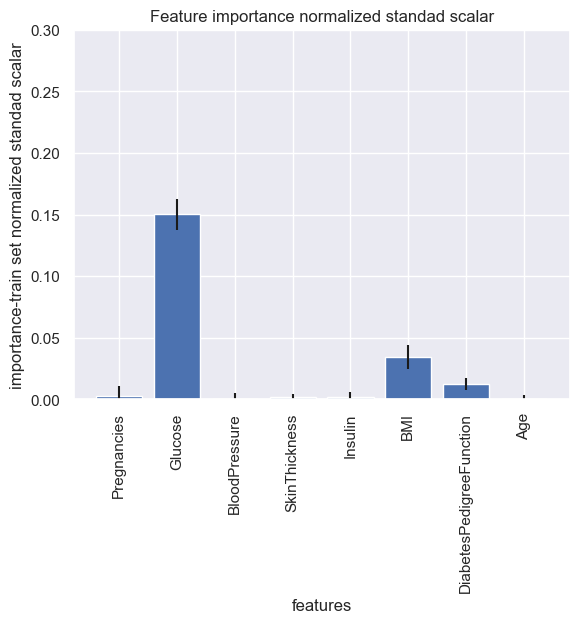

Confusion Matrix test:
[[85 14]
 [22 32]]
Confusion Matrix train:
[[350  45]
 [ 91 122]]


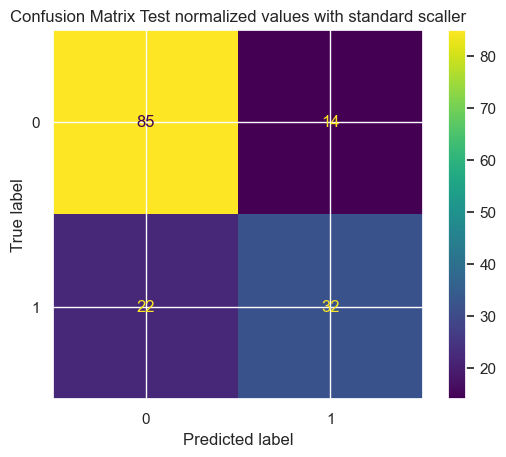

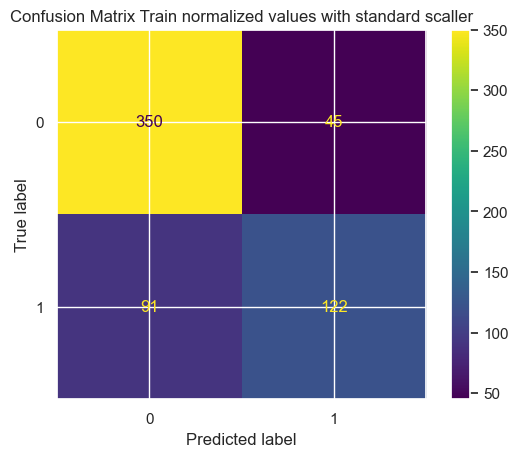

Check that you get the same accuracy from the score method: 0.7647058823529411


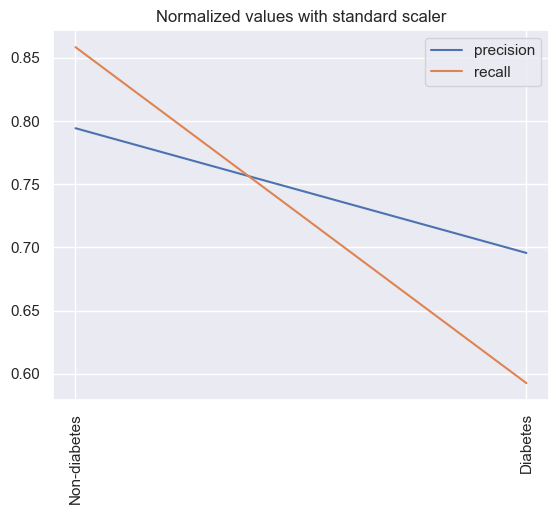

              precision    recall  f1-score   support

         0.0       0.79      0.86      0.83        99
         1.0       0.70      0.59      0.64        54

    accuracy                           0.76       153
   macro avg       0.75      0.73      0.73       153
weighted avg       0.76      0.76      0.76       153



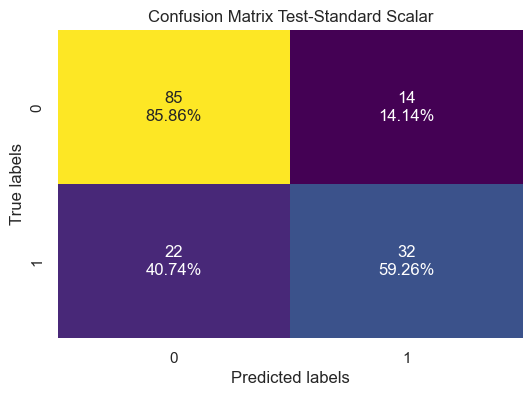

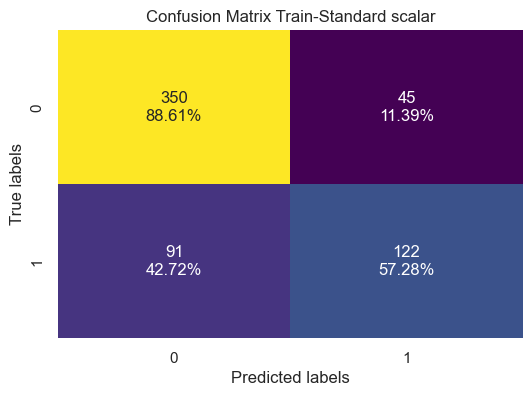

In [30]:
# linear regression with normalized values only with standard scaller.

x_train, x_test, y_train, y_test = train_test_split(x_scaled_standar, y, test_size=0.2,random_state=42)

for n_iter in (10, 20,30,50, 100, 10000):
  clf = linear_model.LogisticRegression(solver='liblinear', max_iter= n_iter,
                                      multi_class='ovr')
#logreg = LogisticRegression(multi_class='ovr', solver='liblinear')

# 2. fit the model
  t1 = timer()
  clf.fit(x_train, y_train)
  t2 = timer()
  print ('training time: %.1fs'%(t2-t1),'in', n_iter, 'iterations')

# 3. evaluate accuracy on train and test datasets
  print("training score : %.3f" % (clf.score(x_train, y_train)),'in', n_iter, 'iterations')
  print("test score : %.3f" % (clf.score(x_test, y_test)),'in', n_iter, 'iterations')


# feature importance

p_importances = permutation_importance(clf, x_train, y_train, n_repeats=20, n_jobs=-1,random_state=42)

plt.bar(features,
        p_importances.importances_mean,
        yerr=p_importances.importances_std)
plt.xticks(rotation=90)
plt.xlabel('features')
plt.ylabel('importance-train set normalized standad scalar')
plt.title('Feature importance normalized standad scalar')
plt.ylim(0, 0.3)
plt.show()


# 4. evaluate the confusion matrix on the test set using, from sklearn import metrics the metrics.confusion_matrix method (check documentation)


y_pred_test = clf.predict(x_test)
#y_pred_test_proba= clf.predict_proba(x_test)
#np.sum(_pred_test_proba[0])
sklearn.metrics.confusion_matrix(y_test, y_pred_test, labels=None, sample_weight=None, normalize=None)
y_pred_train=clf.predict(x_train)
sklearn.metrics.confusion_matrix(y_train,y_pred_train)

# 5. inspect the confusion metrics and compute using matrix manipulations the precision and recall for each category


# Assuming you have already obtained 'y_pred' and 'y_test'
# 'y_pred' contains the predicted class labels, and 'y_test' contains the true class labels.

# Calculate the confusion matrix
confusion_test = confusion_matrix(y_test, y_pred_test)

print("Confusion Matrix test:")
print(confusion_test)

confusion_train = confusion_matrix(y_train, y_pred_train)

print("Confusion Matrix train:")
print(confusion_train)

cm_display = ConfusionMatrixDisplay(confusion_test).plot()
plt.title('Confusion Matrix Test normalized values with standard scaller')
cm_display = ConfusionMatrixDisplay(confusion_train).plot()
plt.title('Confusion Matrix Train normalized values with standard scaller')
plt.show()

Output_names = ['Non-diabetes', 'Diabetes']

print(f'Check that you get the same accuracy from the score method: {np.sum([confusion_test[i,i] for i in range(2)])/np.sum(confusion_test)}')
#sums the diagonal and divide the whole matrix
precisions=[]
recalls=[]
#precision
for i in range(2):
    precisions.append(confusion_test[i,i]/np.sum(confusion_test[:,i])) #take the diagonal divided by the whole column
#percentage of positive identified??
#recall
for i in range(2):
    recalls.append(confusion_test[i,i]/np.sum(confusion_test[i,:])) #take the diagonal and divide by the whole row

plt.plot(Output_names,precisions, label='precision')
plt.plot(Output_names,recalls, label='recall')
plt.title('Normalized values with standard scaler')
plt.xticks(rotation=90)
plt.legend()

plt.show()

print(classification_report(y_test, y_pred_test))

# Display the confusion matrix with values and percentages
cm_sum = np.sum(confusion_test, axis=1, keepdims=True)
cm_percentages = confusion_test / cm_sum.astype(float) * 100
cm_with_percentages = np.round(cm_percentages, 2)

plt.figure(figsize=(6, 4))
sns.heatmap(
    confusion_test,
    annot=np.array([f'{v1}\n{v2}%' for v1, v2 in zip(confusion_test.flatten(), cm_with_percentages.flatten())]).reshape(confusion_test.shape),
    fmt='',
    cmap='viridis',
    cbar=False
)
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix Test-Standard Scalar')
plt.show()


cm_sum = np.sum(confusion_train, axis=1, keepdims=True)
cm_percentages = confusion_train / cm_sum.astype(float) * 100
cm_with_percentages = np.round(cm_percentages, 2)

# Display the confusion matrix with values and percentages
plt.figure(figsize=(6, 4))
sns.heatmap(
    confusion_train,
    annot=np.array([f'{v1}\n{v2}%' for v1, v2 in zip(confusion_train.flatten(), cm_with_percentages.flatten())]).reshape(confusion_train.shape),
    fmt='',
    cmap='viridis',
    cbar=False
)
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix Train-Standard scalar')
plt.show()

In [31]:
from sklearn.model_selection import cross_val_score

cv_scores = cross_val_score(clf, x, y, cv=5)

# Print the cross-validation scores
print("Cross-validation scores norm scalar: {}".format(cv_scores))
print("Average cross-validation score norm scalar: {:.2f}".format(cv_scores.mean()))



Cross-validation scores norm scalar: [0.73202614 0.75       0.76315789 0.78947368 0.71052632]
Average cross-validation score norm scalar: 0.75


In [79]:
#  Try Random forest:

#split again the origincal values to overwrite the normalized values

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2,random_state=42)

#print(df_diabetes.head())
features = ['Pregnancies',
                  'Glucose', 'BloodPressure', 'SkinThickness',
                  'Insulin', 'BMI', 'DiabetesPedigreeFunction', 'Age'
                  ]

Output_names = ['Non-diabetes', 'Diabetes']

 estimator: 1 depth: 4 test score:0.7058823529411765
 estimator: 1 depth: 4 train score:0.7730263157894737
Accuracy: 0.7058823529411765
Classification Report:
              precision    recall  f1-score   support

         0.0       0.76      0.79      0.78        99
         1.0       0.59      0.56      0.57        54

    accuracy                           0.71       153
   macro avg       0.68      0.67      0.67       153
weighted avg       0.70      0.71      0.70       153



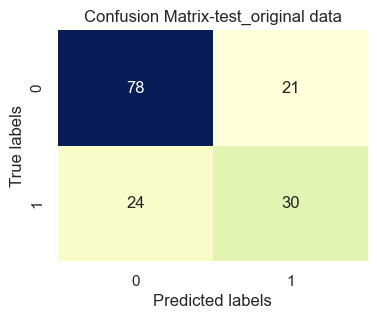

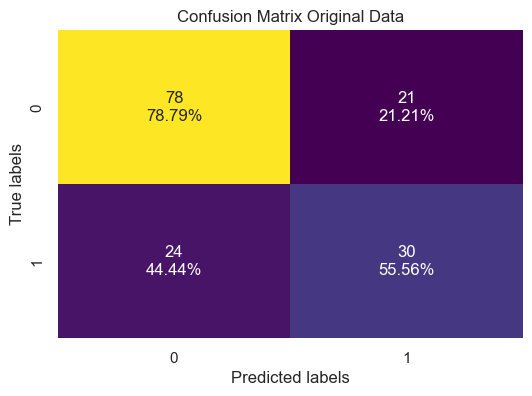

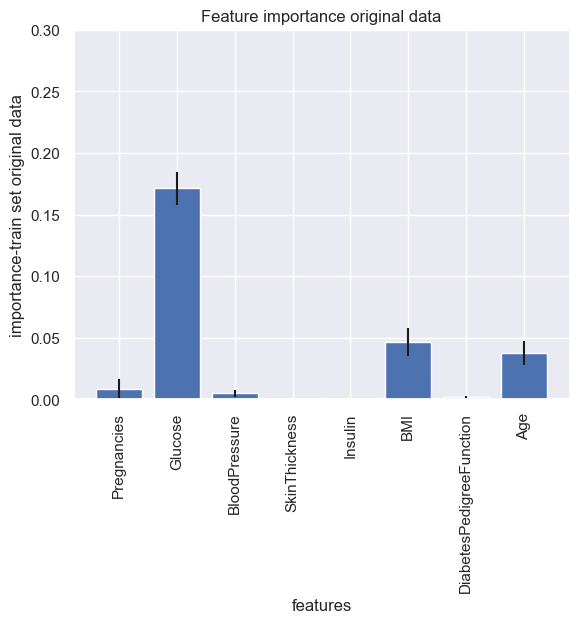

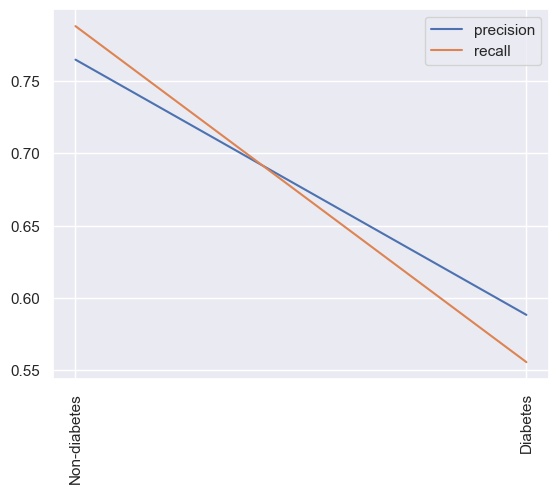

 estimator: 5 depth: 4 test score:0.7124183006535948
 estimator: 5 depth: 4 train score:0.8223684210526315
Accuracy: 0.7124183006535948
Classification Report:
              precision    recall  f1-score   support

         0.0       0.76      0.81      0.78        99
         1.0       0.60      0.54      0.57        54

    accuracy                           0.71       153
   macro avg       0.68      0.67      0.68       153
weighted avg       0.71      0.71      0.71       153



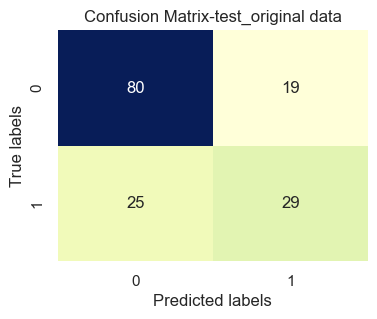

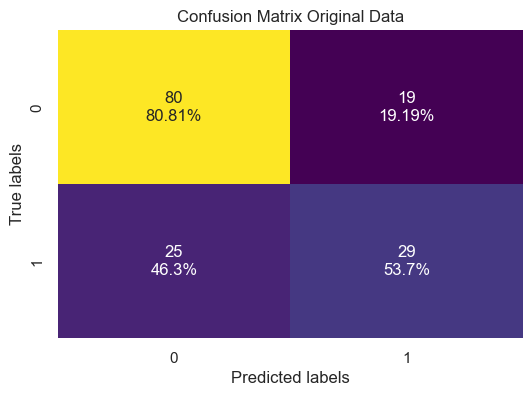

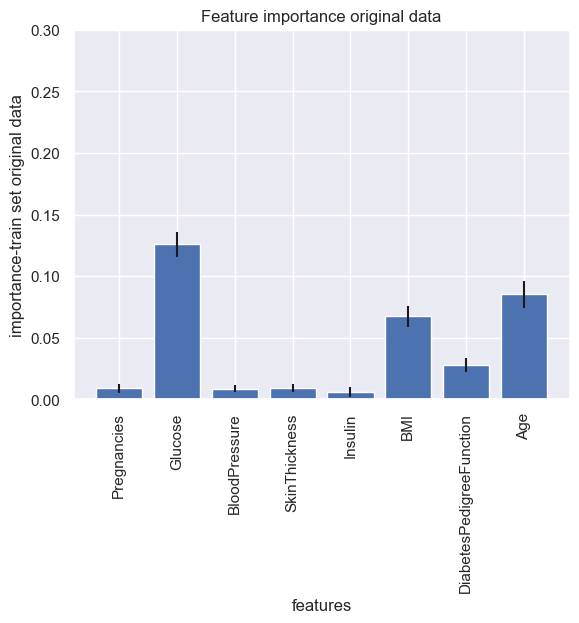

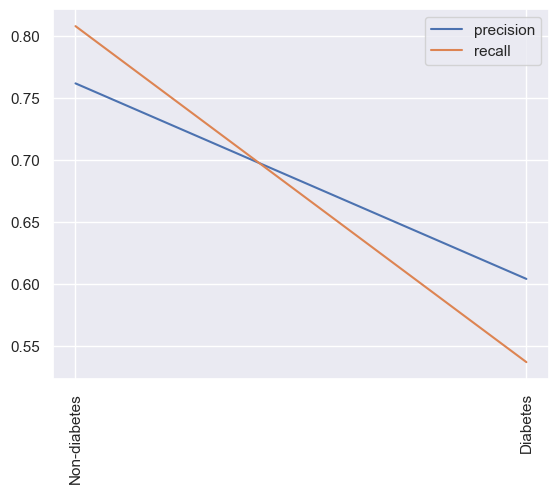

 estimator: 10 depth: 4 test score:0.6993464052287581
 estimator: 10 depth: 4 train score:0.8174342105263158
Accuracy: 0.6993464052287581
Classification Report:
              precision    recall  f1-score   support

         0.0       0.74      0.83      0.78        99
         1.0       0.60      0.46      0.52        54

    accuracy                           0.70       153
   macro avg       0.67      0.65      0.65       153
weighted avg       0.69      0.70      0.69       153



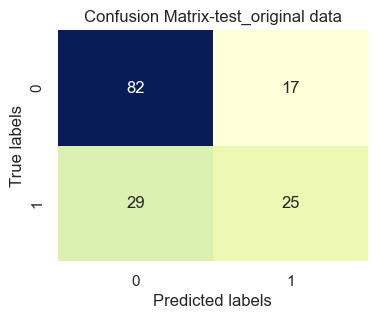

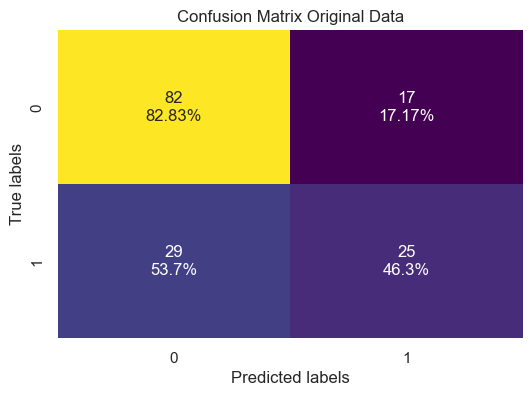

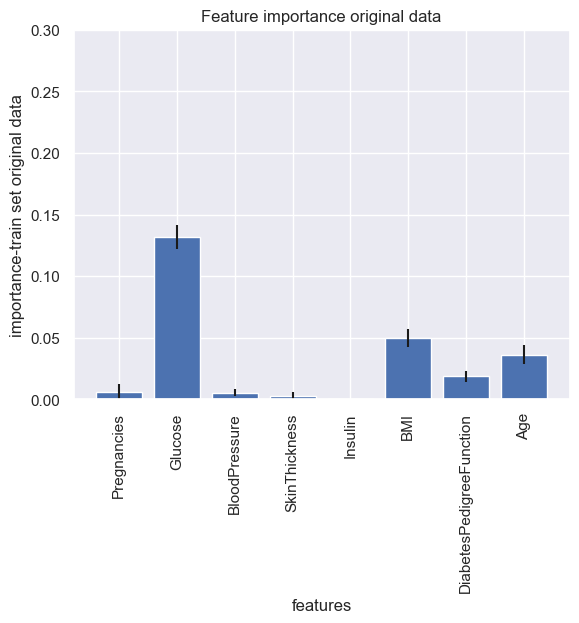

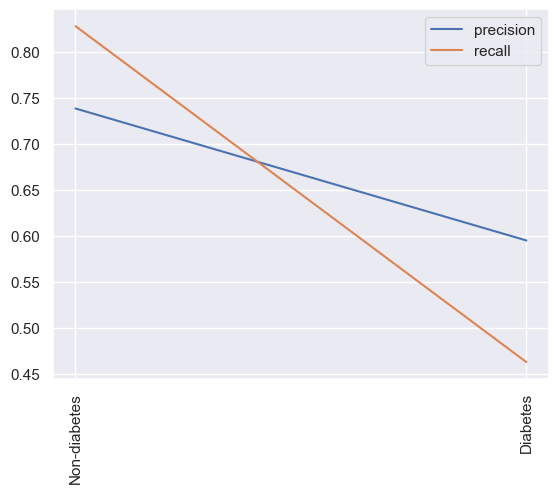

 estimator: 20 depth: 4 test score:0.7189542483660131
 estimator: 20 depth: 4 train score:0.8240131578947368
Accuracy: 0.7189542483660131
Classification Report:
              precision    recall  f1-score   support

         0.0       0.75      0.85      0.80        99
         1.0       0.63      0.48      0.55        54

    accuracy                           0.72       153
   macro avg       0.69      0.66      0.67       153
weighted avg       0.71      0.72      0.71       153



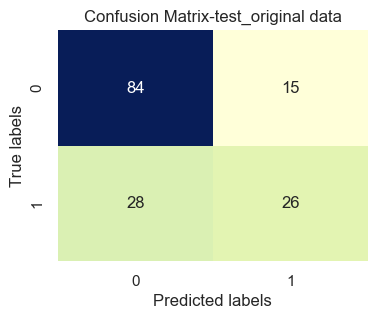

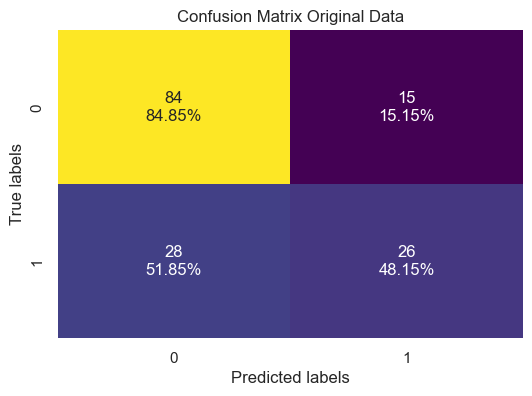

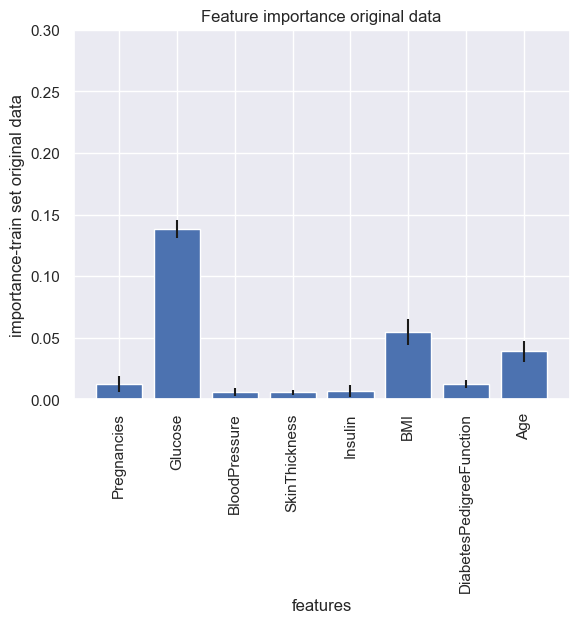

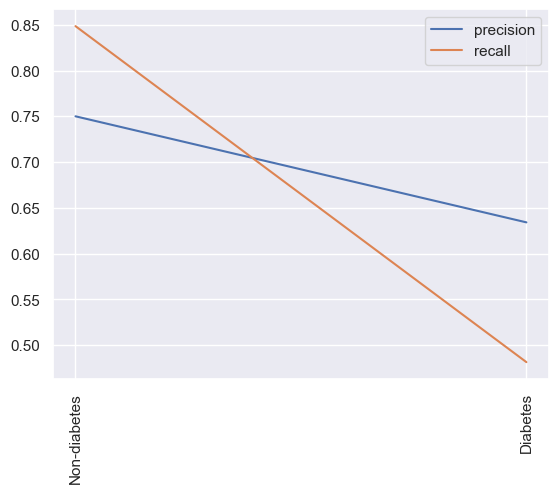

 estimator: 50 depth: 4 test score:0.7254901960784313
 estimator: 50 depth: 4 train score:0.8289473684210527
Accuracy: 0.7254901960784313
Classification Report:
              precision    recall  f1-score   support

         0.0       0.76      0.85      0.80        99
         1.0       0.64      0.50      0.56        54

    accuracy                           0.73       153
   macro avg       0.70      0.67      0.68       153
weighted avg       0.72      0.73      0.72       153



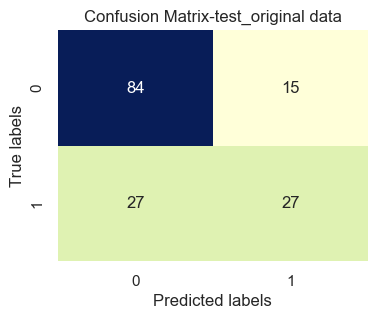

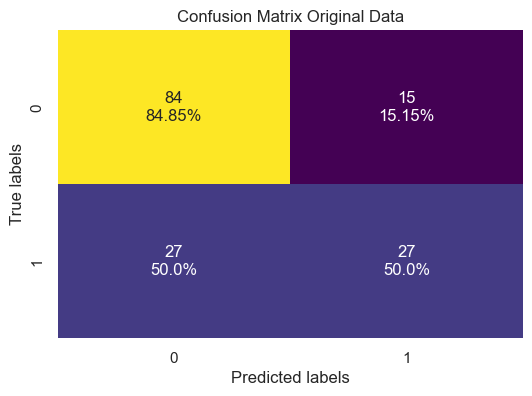

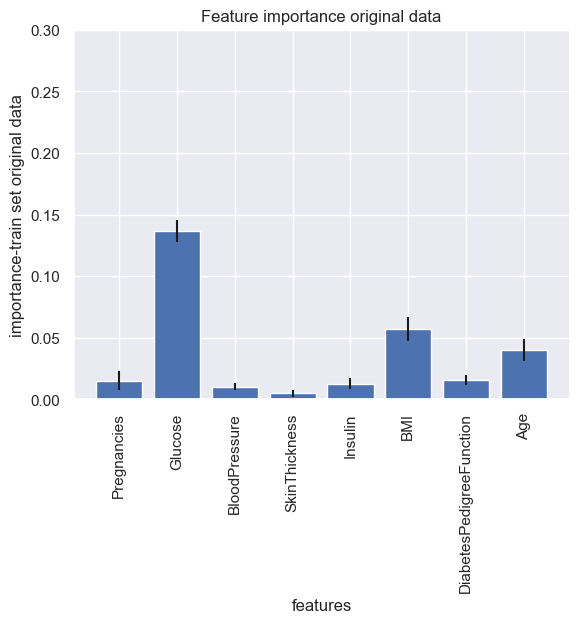

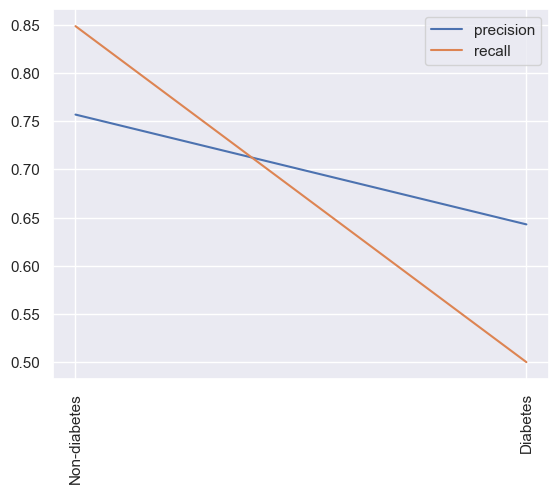

 estimator: 100 depth: 4 test score:0.7254901960784313
 estimator: 100 depth: 4 train score:0.8273026315789473
Accuracy: 0.7254901960784313
Classification Report:
              precision    recall  f1-score   support

         0.0       0.77      0.83      0.80        99
         1.0       0.63      0.54      0.58        54

    accuracy                           0.73       153
   macro avg       0.70      0.68      0.69       153
weighted avg       0.72      0.73      0.72       153



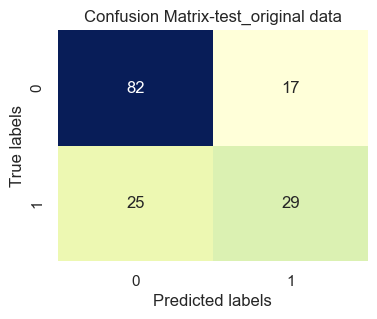

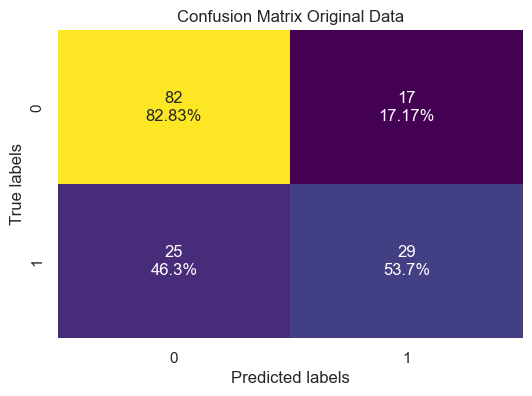

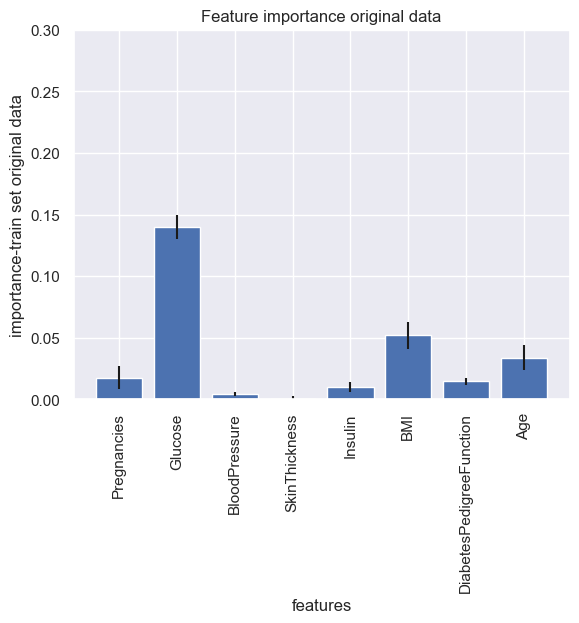

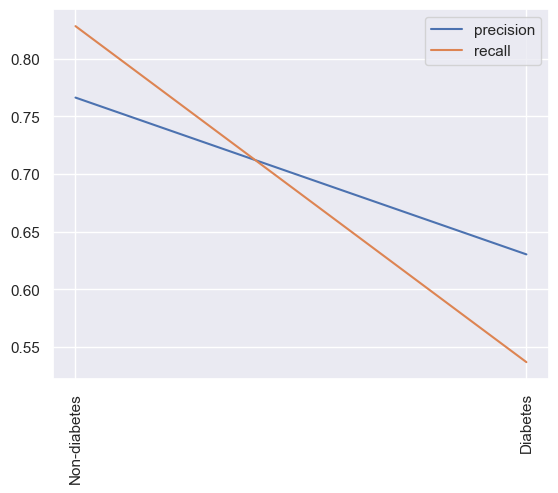

 estimator: 150 depth: 4 test score:0.7254901960784313
 estimator: 150 depth: 4 train score:0.8256578947368421
Accuracy: 0.7254901960784313
Classification Report:
              precision    recall  f1-score   support

         0.0       0.77      0.83      0.80        99
         1.0       0.63      0.54      0.58        54

    accuracy                           0.73       153
   macro avg       0.70      0.68      0.69       153
weighted avg       0.72      0.73      0.72       153



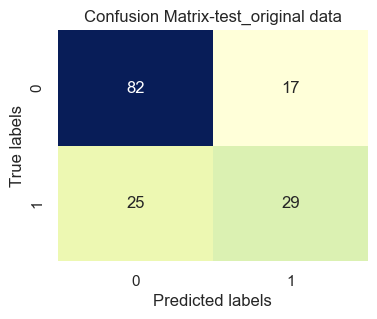

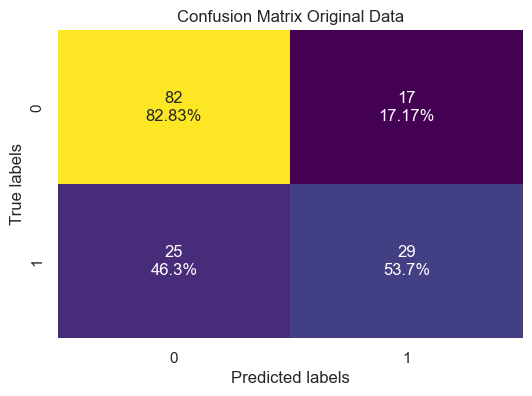

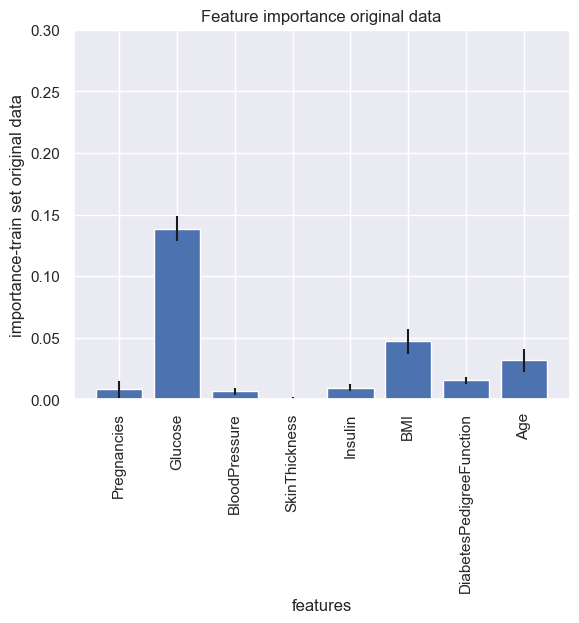

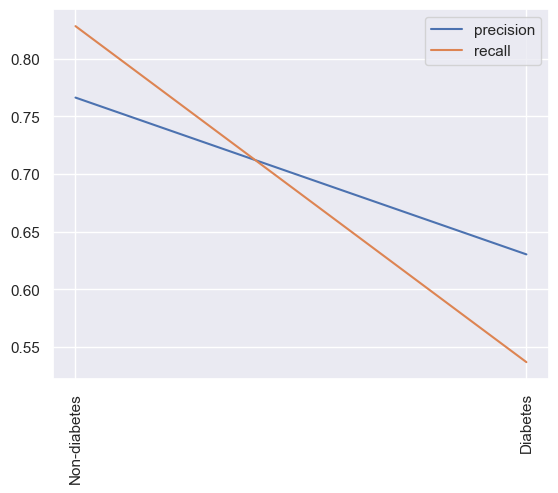

 estimator: 200 depth: 4 test score:0.7254901960784313
 estimator: 200 depth: 4 train score:0.8256578947368421
Accuracy: 0.7254901960784313
Classification Report:
              precision    recall  f1-score   support

         0.0       0.77      0.83      0.80        99
         1.0       0.63      0.54      0.58        54

    accuracy                           0.73       153
   macro avg       0.70      0.68      0.69       153
weighted avg       0.72      0.73      0.72       153



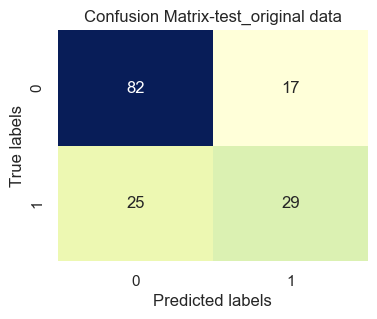

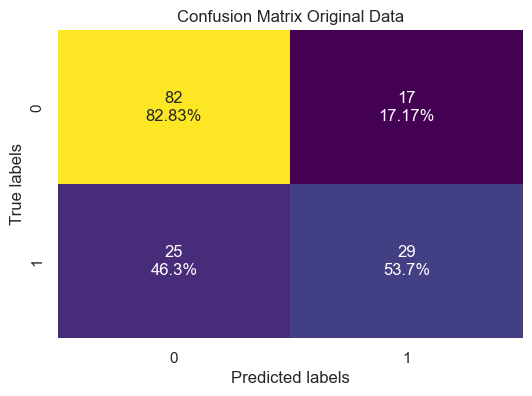

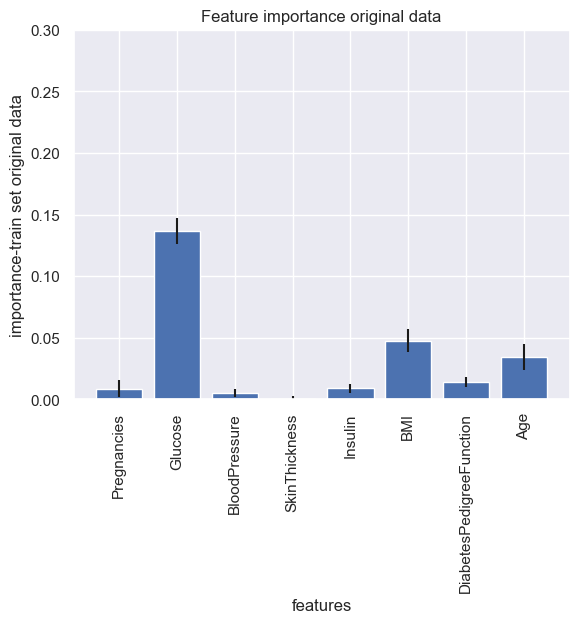

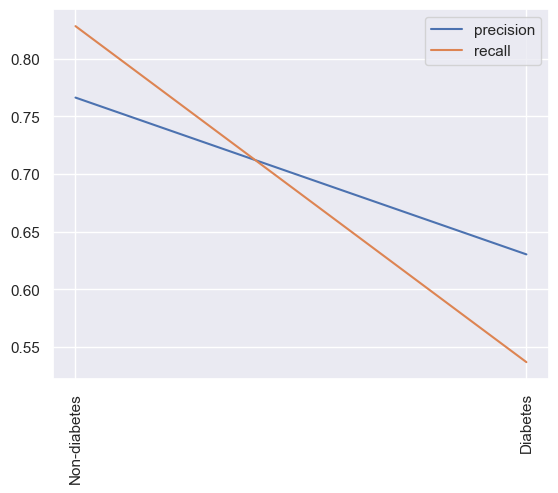

 estimator: 500 depth: 4 test score:0.7254901960784313
 estimator: 500 depth: 4 train score:0.8240131578947368
Accuracy: 0.7254901960784313
Classification Report:
              precision    recall  f1-score   support

         0.0       0.77      0.83      0.80        99
         1.0       0.63      0.54      0.58        54

    accuracy                           0.73       153
   macro avg       0.70      0.68      0.69       153
weighted avg       0.72      0.73      0.72       153



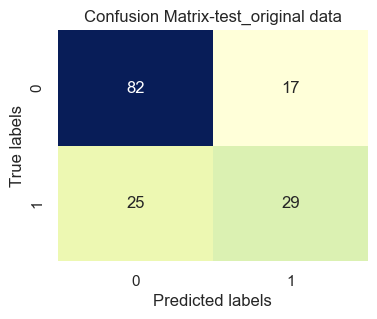

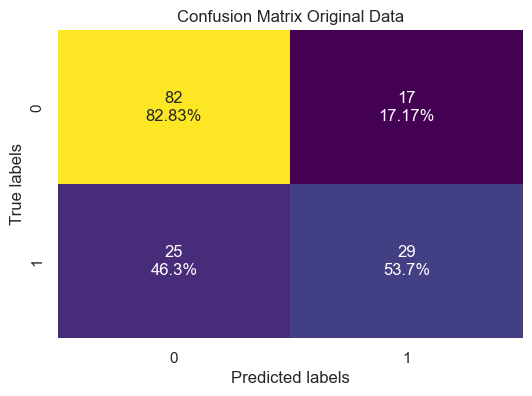

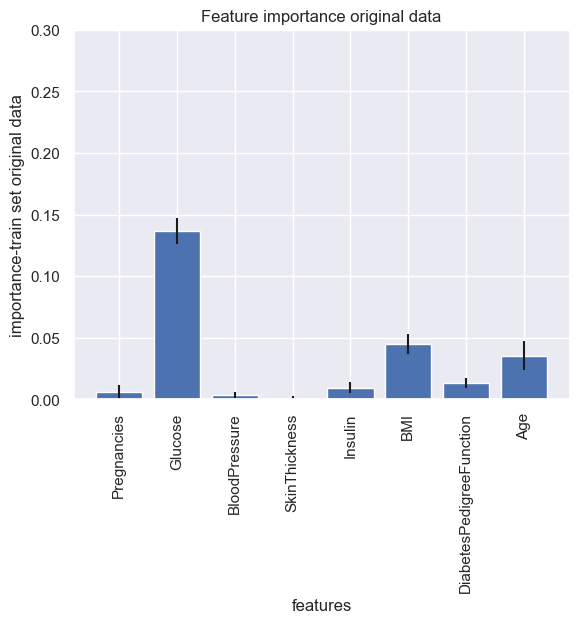

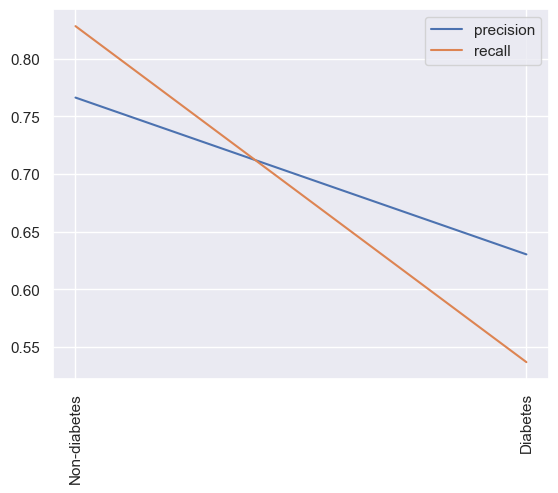

 estimator: 1 depth: 8 test score:0.673202614379085
 estimator: 1 depth: 8 train score:0.837171052631579
Accuracy: 0.673202614379085
Classification Report:
              precision    recall  f1-score   support

         0.0       0.73      0.79      0.76        99
         1.0       0.54      0.46      0.50        54

    accuracy                           0.67       153
   macro avg       0.64      0.63      0.63       153
weighted avg       0.66      0.67      0.67       153



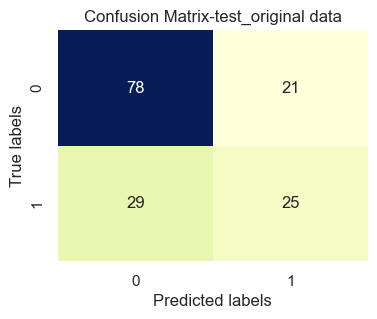

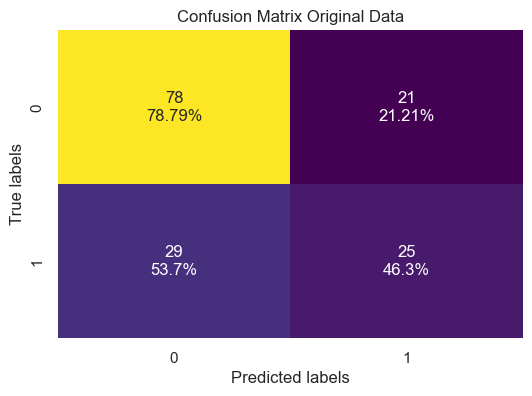

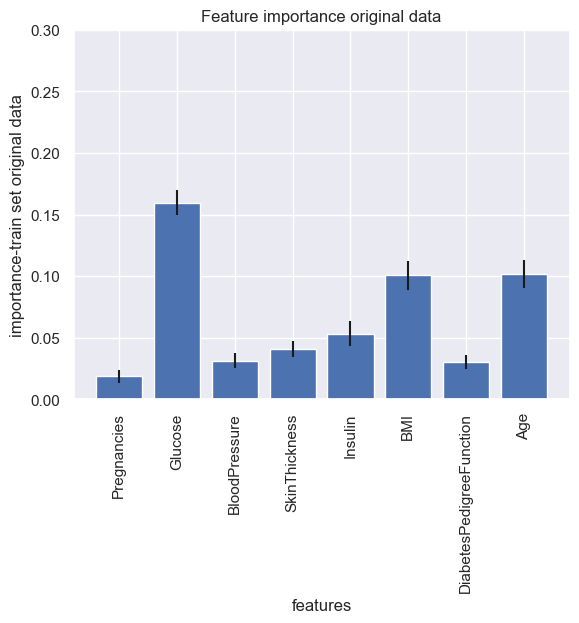

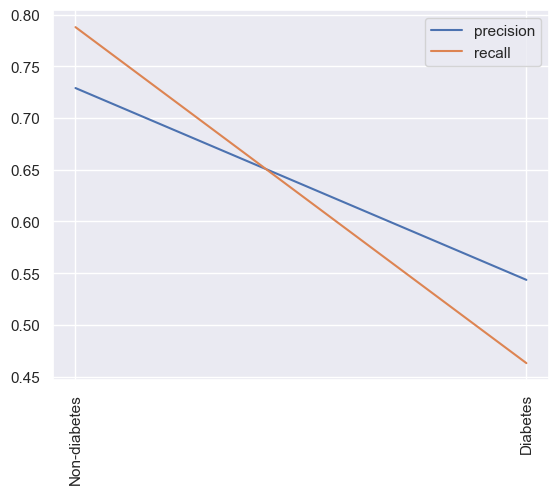

 estimator: 5 depth: 8 test score:0.7254901960784313
 estimator: 5 depth: 8 train score:0.9276315789473685
Accuracy: 0.7254901960784313
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.77      0.78        99
         1.0       0.60      0.65      0.62        54

    accuracy                           0.73       153
   macro avg       0.70      0.71      0.70       153
weighted avg       0.73      0.73      0.73       153



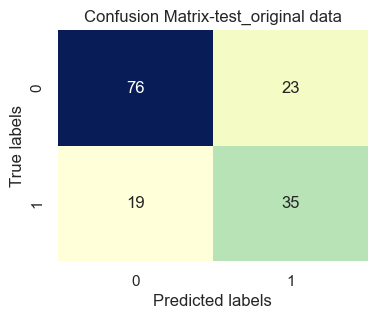

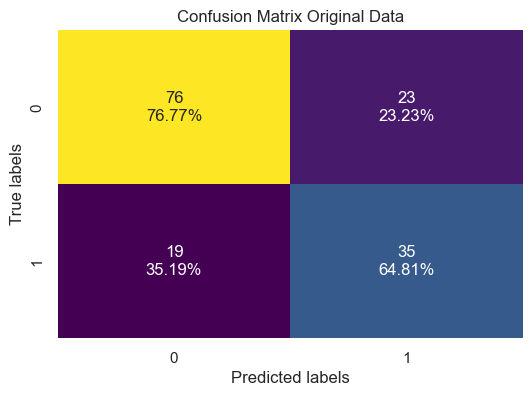

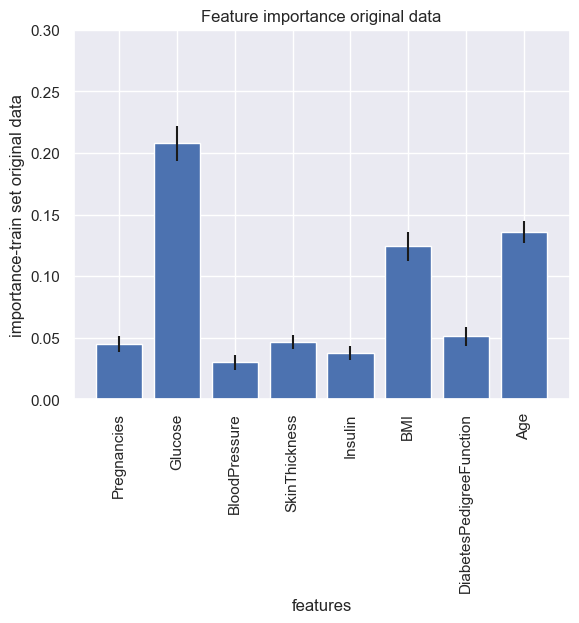

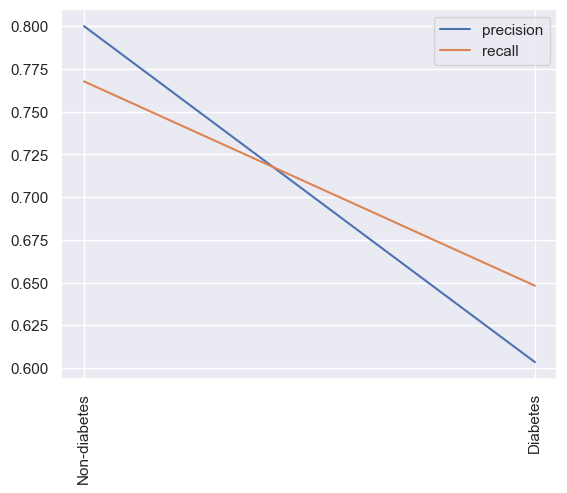

 estimator: 10 depth: 8 test score:0.738562091503268
 estimator: 10 depth: 8 train score:0.9457236842105263
Accuracy: 0.738562091503268
Classification Report:
              precision    recall  f1-score   support

         0.0       0.78      0.83      0.80        99
         1.0       0.65      0.57      0.61        54

    accuracy                           0.74       153
   macro avg       0.71      0.70      0.71       153
weighted avg       0.73      0.74      0.73       153



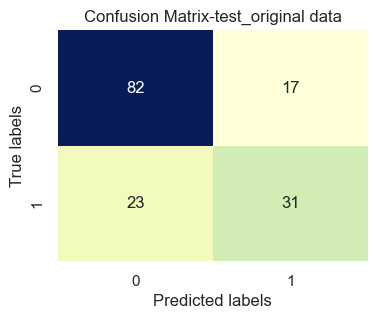

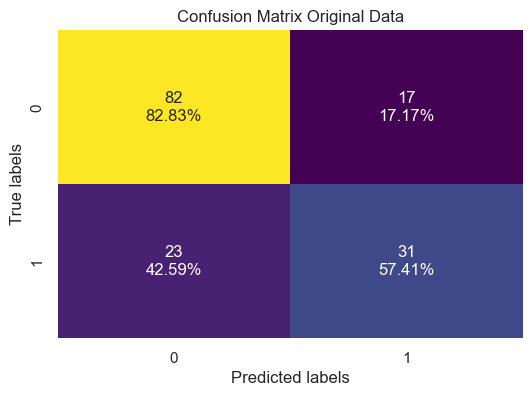

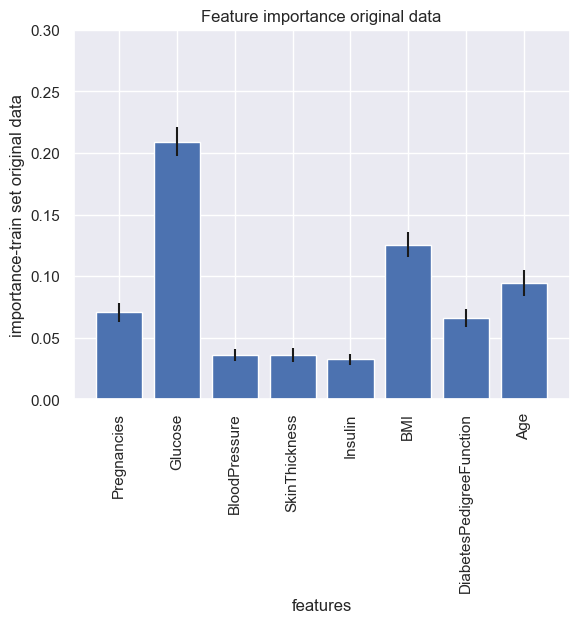

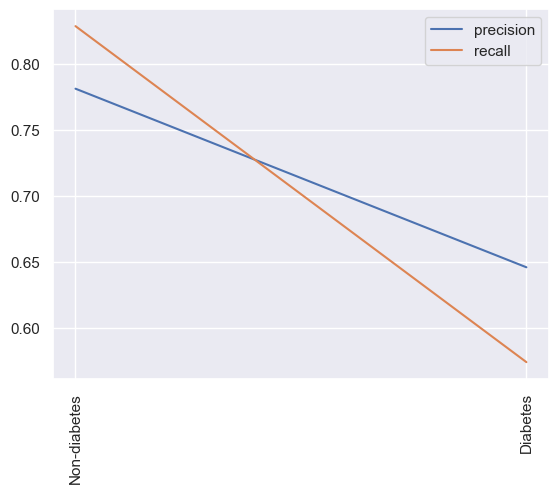

 estimator: 20 depth: 8 test score:0.7712418300653595
 estimator: 20 depth: 8 train score:0.9539473684210527
Accuracy: 0.7712418300653595
Classification Report:
              precision    recall  f1-score   support

         0.0       0.81      0.85      0.83        99
         1.0       0.69      0.63      0.66        54

    accuracy                           0.77       153
   macro avg       0.75      0.74      0.74       153
weighted avg       0.77      0.77      0.77       153



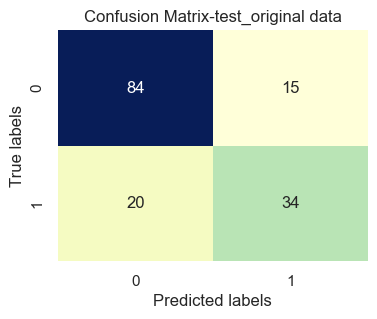

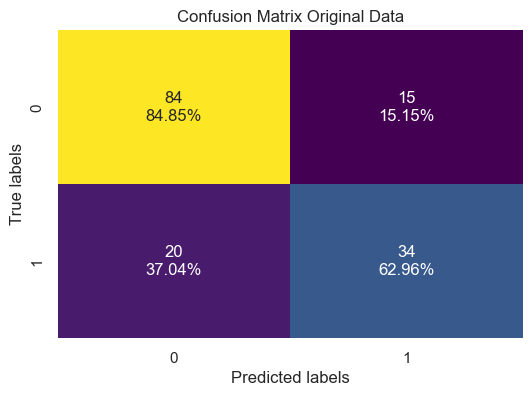

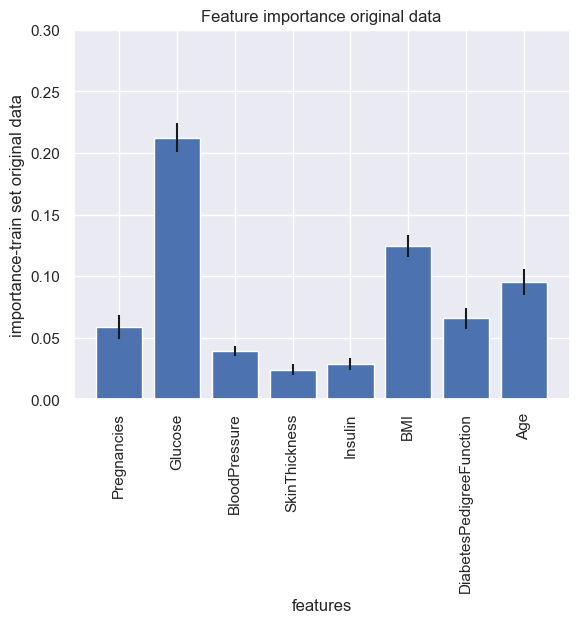

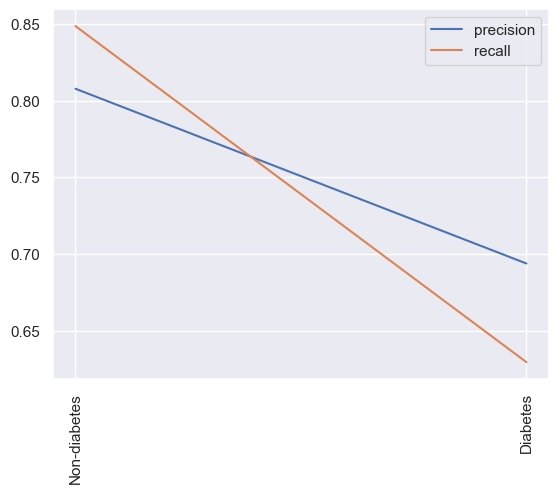

 estimator: 50 depth: 8 test score:0.7450980392156863
 estimator: 50 depth: 8 train score:0.9588815789473685
Accuracy: 0.7450980392156863
Classification Report:
              precision    recall  f1-score   support

         0.0       0.78      0.84      0.81        99
         1.0       0.66      0.57      0.61        54

    accuracy                           0.75       153
   macro avg       0.72      0.71      0.71       153
weighted avg       0.74      0.75      0.74       153



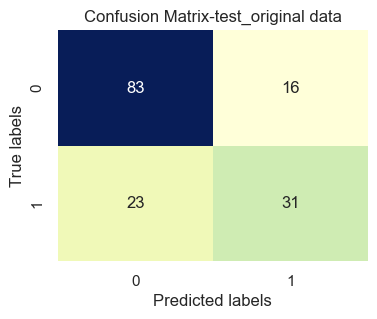

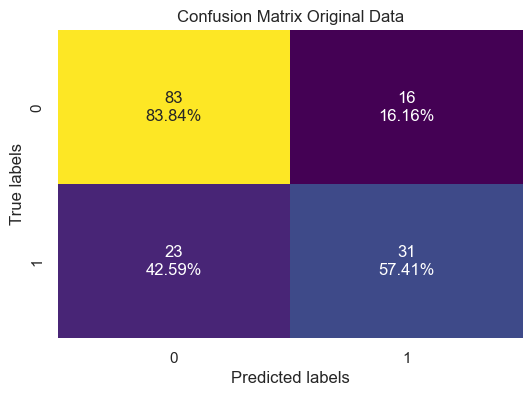

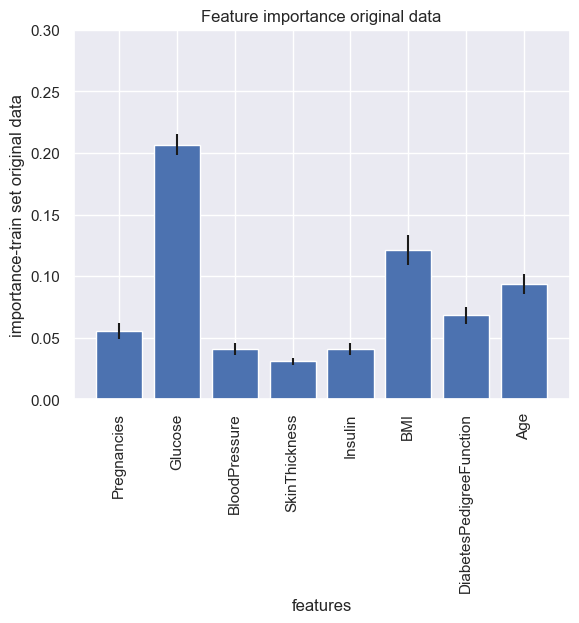

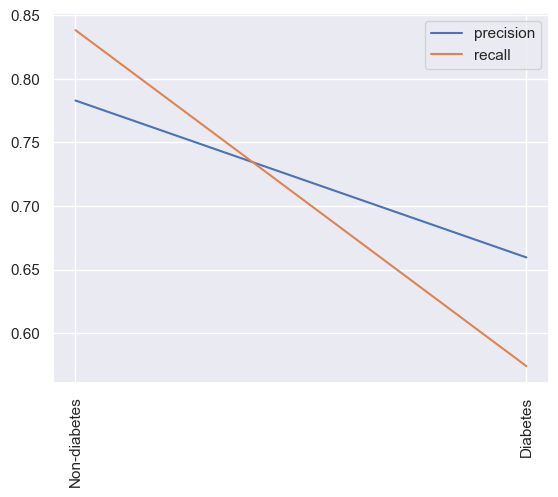

 estimator: 100 depth: 8 test score:0.7647058823529411
 estimator: 100 depth: 8 train score:0.9638157894736842
Accuracy: 0.7647058823529411
Classification Report:
              precision    recall  f1-score   support

         0.0       0.81      0.83      0.82        99
         1.0       0.67      0.65      0.66        54

    accuracy                           0.76       153
   macro avg       0.74      0.74      0.74       153
weighted avg       0.76      0.76      0.76       153



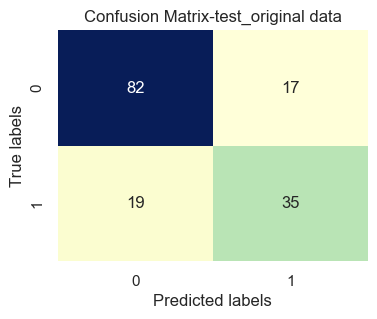

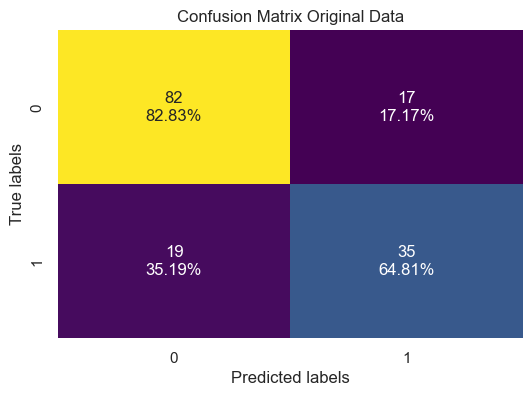

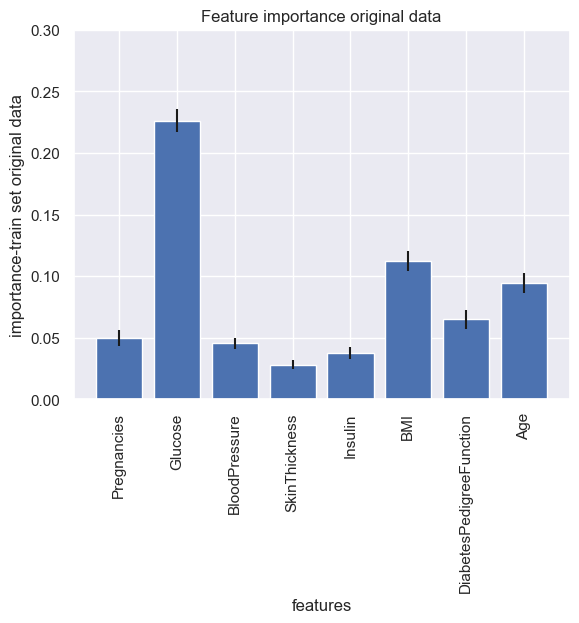

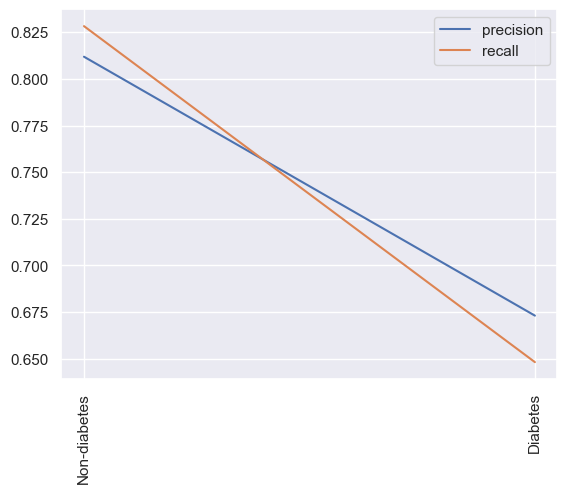

 estimator: 150 depth: 8 test score:0.7712418300653595
 estimator: 150 depth: 8 train score:0.9638157894736842
Accuracy: 0.7712418300653595
Classification Report:
              precision    recall  f1-score   support

         0.0       0.82      0.83      0.82        99
         1.0       0.68      0.67      0.67        54

    accuracy                           0.77       153
   macro avg       0.75      0.75      0.75       153
weighted avg       0.77      0.77      0.77       153



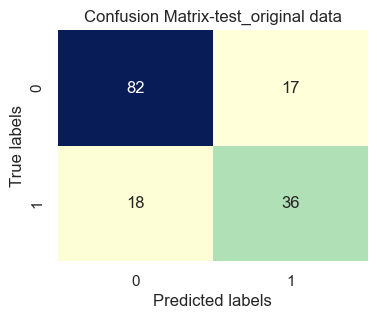

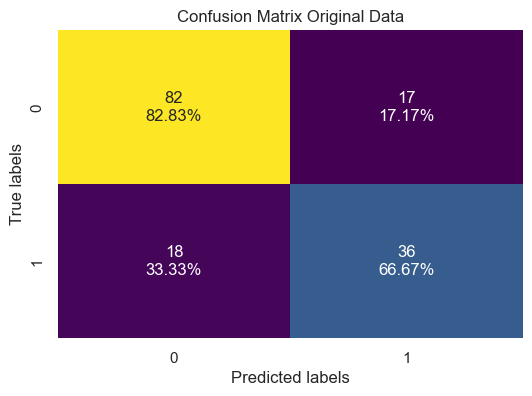

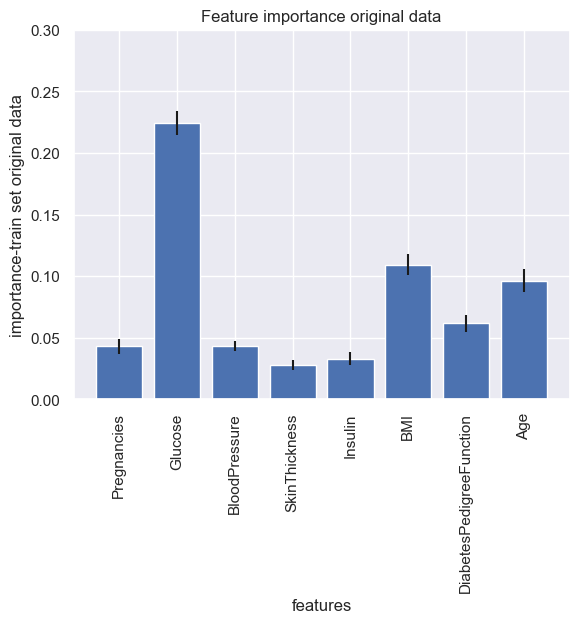

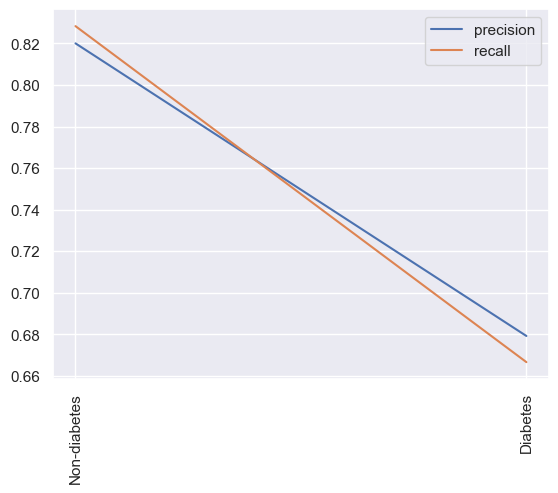

 estimator: 200 depth: 8 test score:0.7712418300653595
 estimator: 200 depth: 8 train score:0.9671052631578947
Accuracy: 0.7712418300653595
Classification Report:
              precision    recall  f1-score   support

         0.0       0.82      0.83      0.82        99
         1.0       0.68      0.67      0.67        54

    accuracy                           0.77       153
   macro avg       0.75      0.75      0.75       153
weighted avg       0.77      0.77      0.77       153



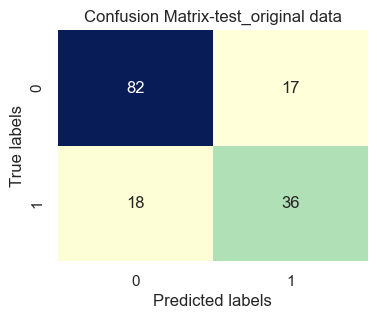

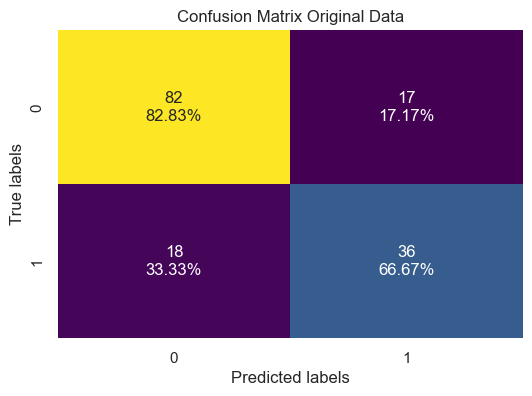

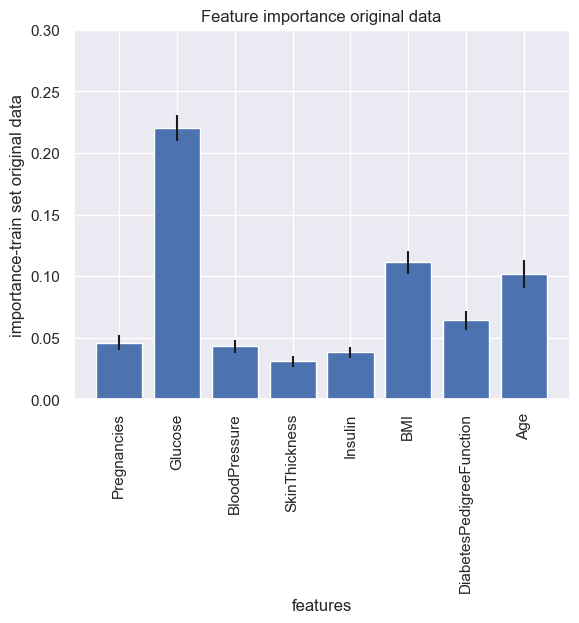

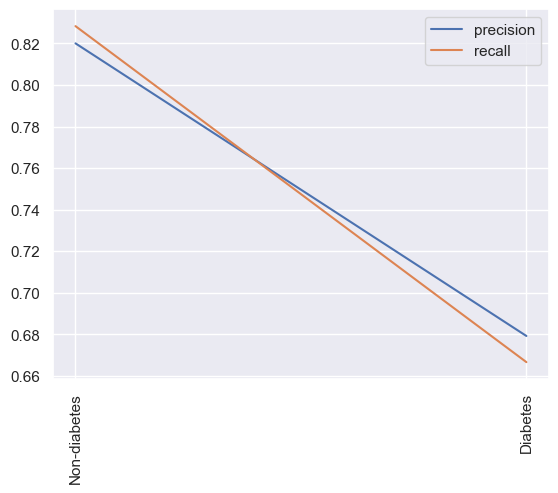

 estimator: 500 depth: 8 test score:0.7516339869281046
 estimator: 500 depth: 8 train score:0.9671052631578947
Accuracy: 0.7516339869281046
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.83      0.81        99
         1.0       0.66      0.61      0.63        54

    accuracy                           0.75       153
   macro avg       0.73      0.72      0.72       153
weighted avg       0.75      0.75      0.75       153



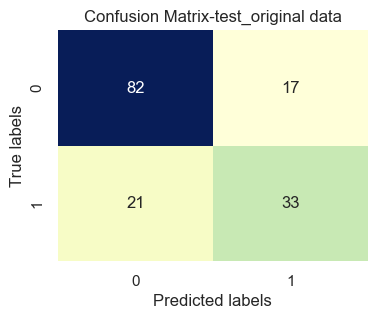

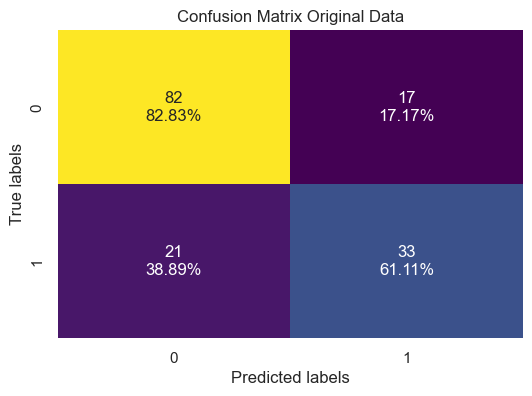

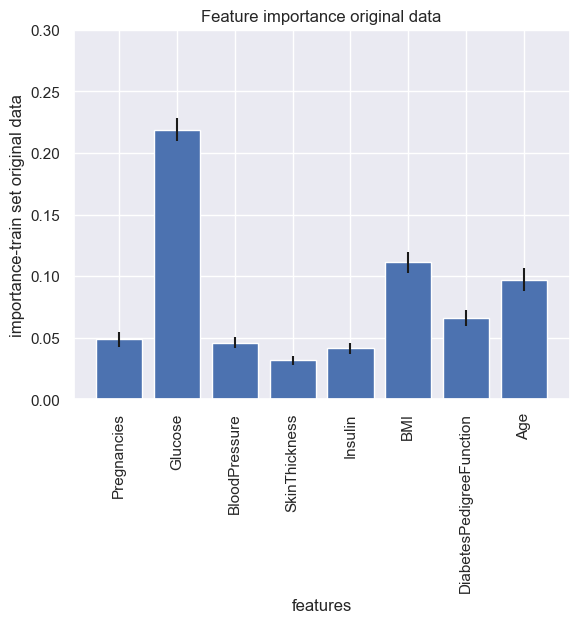

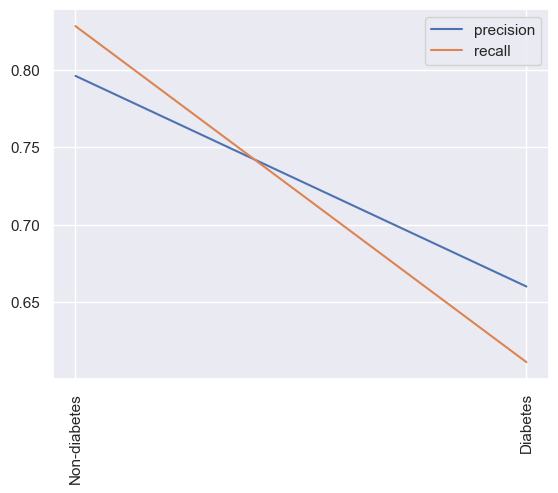

 estimator: 1 depth: 16 test score:0.6601307189542484
 estimator: 1 depth: 16 train score:0.881578947368421
Accuracy: 0.6601307189542484
Classification Report:
              precision    recall  f1-score   support

         0.0       0.74      0.74      0.74        99
         1.0       0.52      0.52      0.52        54

    accuracy                           0.66       153
   macro avg       0.63      0.63      0.63       153
weighted avg       0.66      0.66      0.66       153



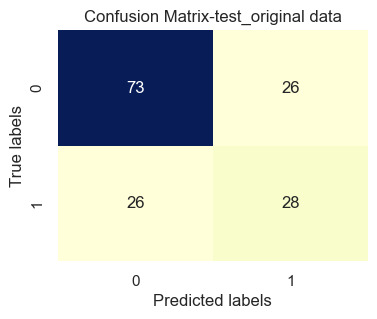

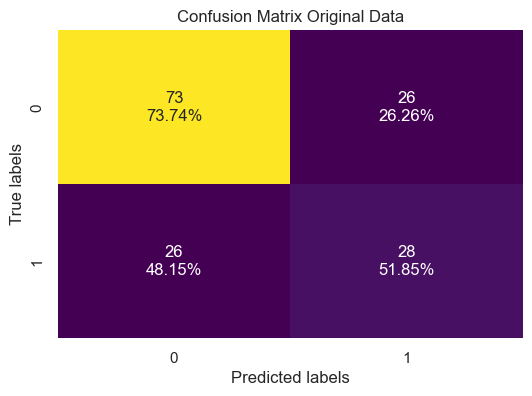

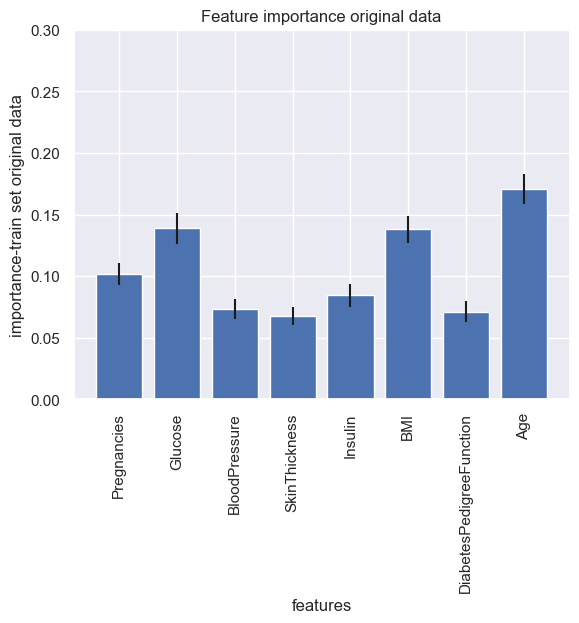

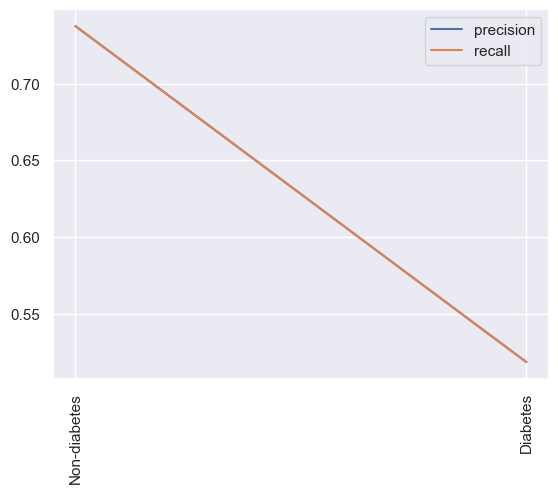

 estimator: 5 depth: 16 test score:0.7189542483660131
 estimator: 5 depth: 16 train score:0.975328947368421
Accuracy: 0.7189542483660131
Classification Report:
              precision    recall  f1-score   support

         0.0       0.78      0.79      0.78        99
         1.0       0.60      0.59      0.60        54

    accuracy                           0.72       153
   macro avg       0.69      0.69      0.69       153
weighted avg       0.72      0.72      0.72       153



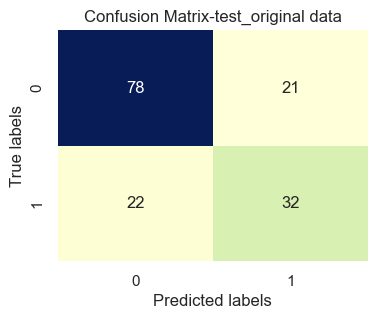

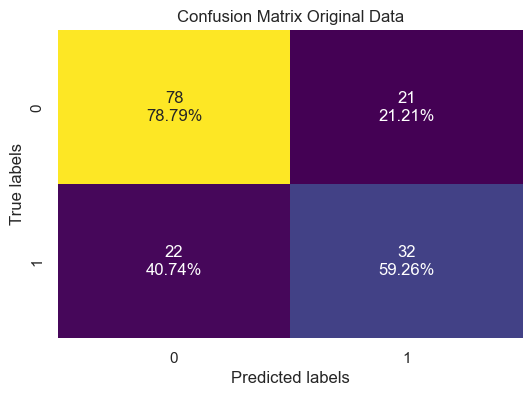

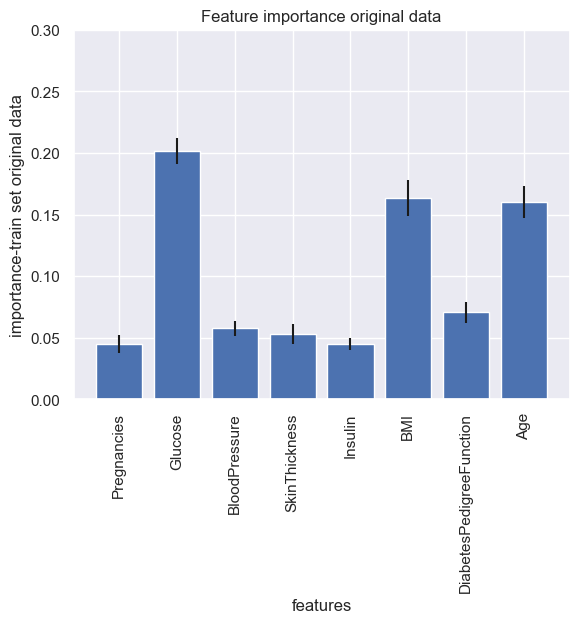

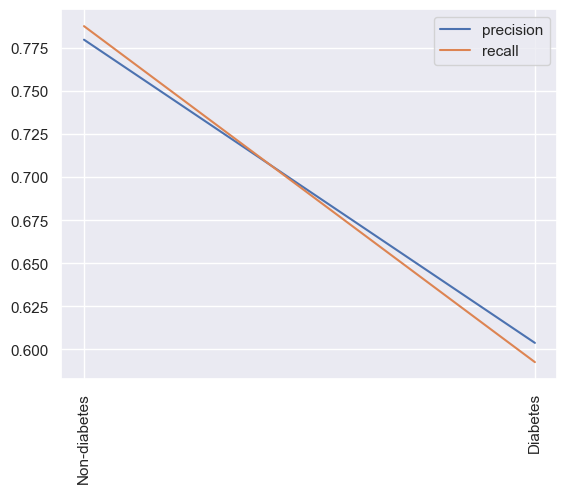

 estimator: 10 depth: 16 test score:0.7320261437908496
 estimator: 10 depth: 16 train score:0.9901315789473685
Accuracy: 0.7320261437908496
Classification Report:
              precision    recall  f1-score   support

         0.0       0.78      0.82      0.80        99
         1.0       0.63      0.57      0.60        54

    accuracy                           0.73       153
   macro avg       0.71      0.70      0.70       153
weighted avg       0.73      0.73      0.73       153



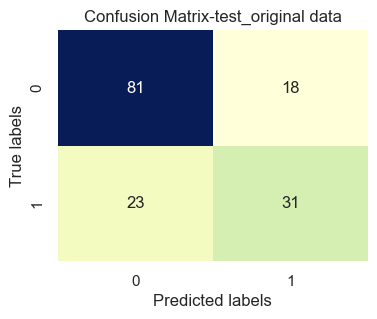

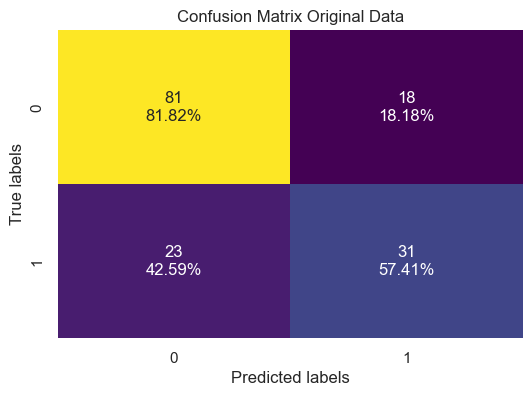

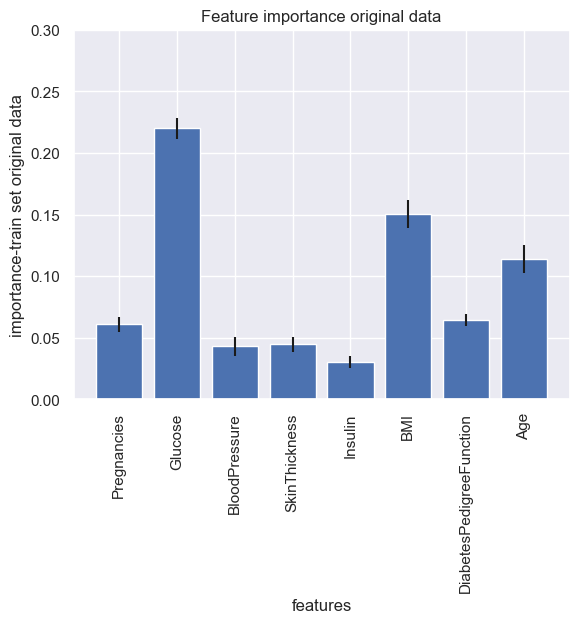

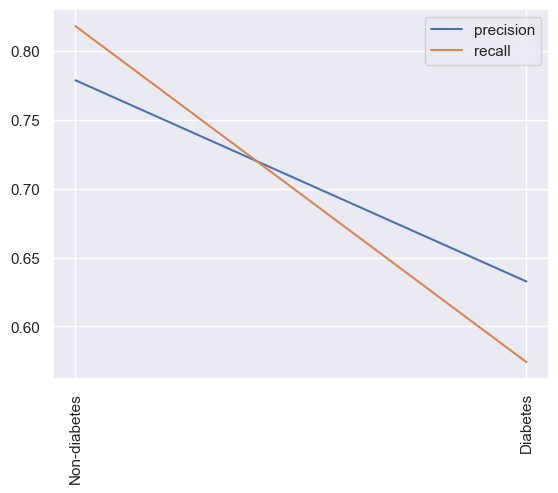

 estimator: 20 depth: 16 test score:0.7450980392156863
 estimator: 20 depth: 16 train score:1.0
Accuracy: 0.7450980392156863
Classification Report:
              precision    recall  f1-score   support

         0.0       0.79      0.83      0.81        99
         1.0       0.65      0.59      0.62        54

    accuracy                           0.75       153
   macro avg       0.72      0.71      0.71       153
weighted avg       0.74      0.75      0.74       153



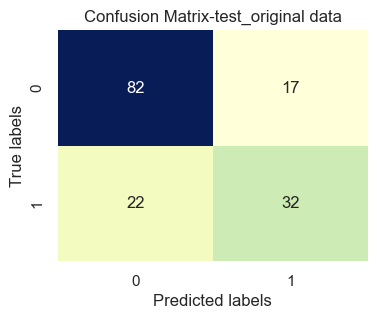

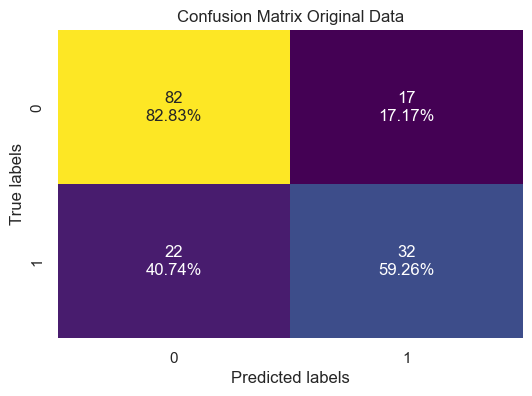

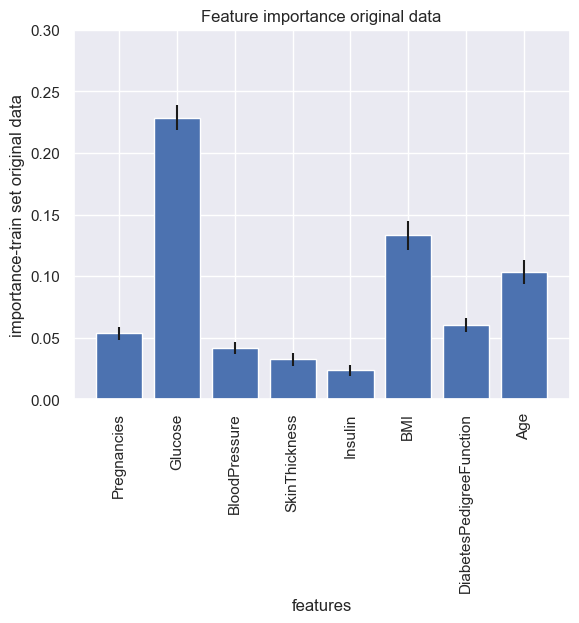

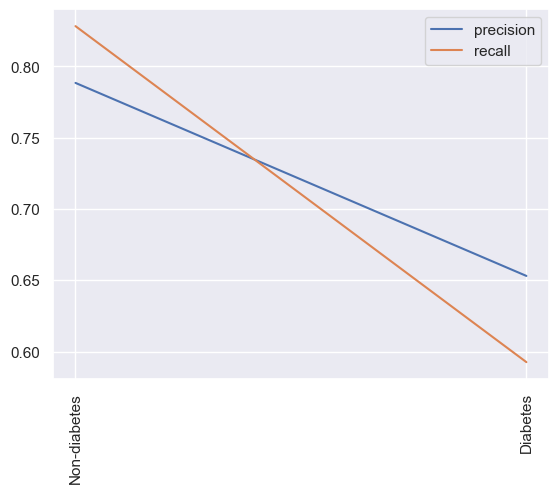

 estimator: 50 depth: 16 test score:0.7581699346405228
 estimator: 50 depth: 16 train score:1.0
Accuracy: 0.7581699346405228
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.83      0.82        99
         1.0       0.67      0.63      0.65        54

    accuracy                           0.76       153
   macro avg       0.74      0.73      0.73       153
weighted avg       0.76      0.76      0.76       153



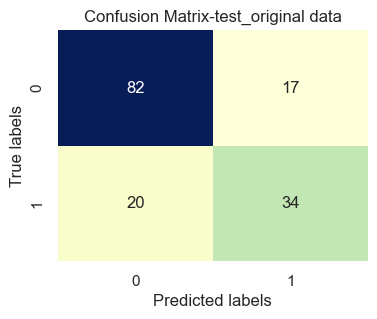

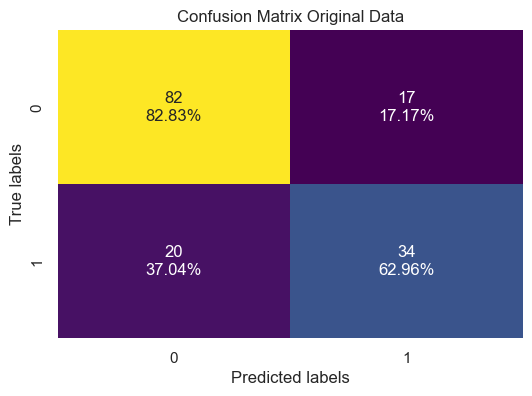

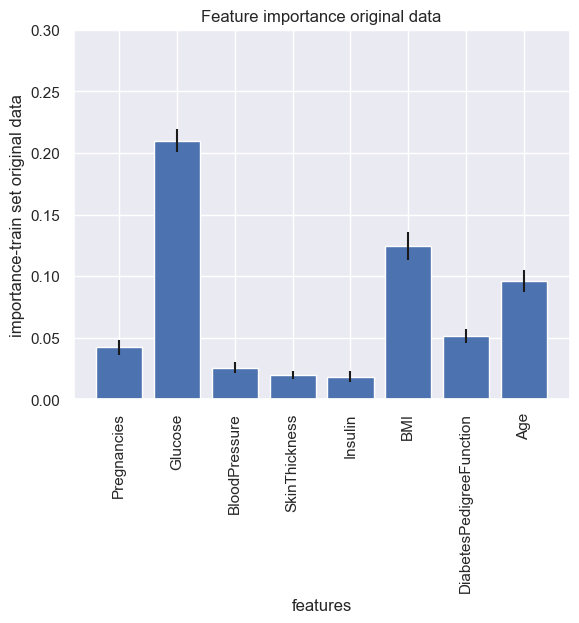

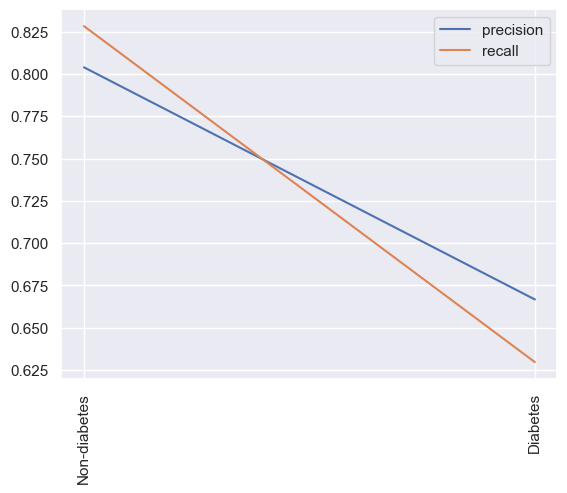

 estimator: 100 depth: 16 test score:0.7647058823529411
 estimator: 100 depth: 16 train score:1.0
Accuracy: 0.7647058823529411
Classification Report:
              precision    recall  f1-score   support

         0.0       0.82      0.82      0.82        99
         1.0       0.67      0.67      0.67        54

    accuracy                           0.76       153
   macro avg       0.74      0.74      0.74       153
weighted avg       0.76      0.76      0.76       153



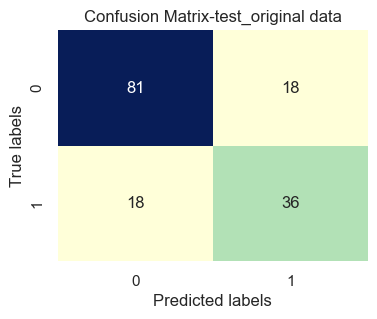

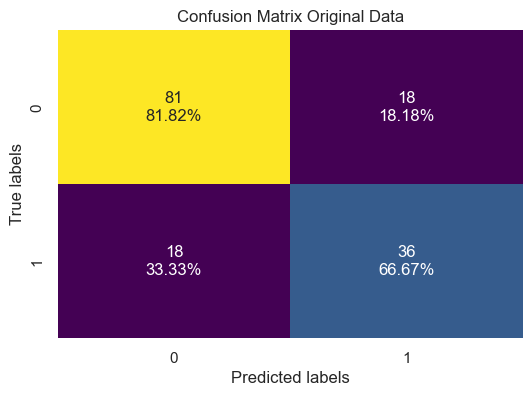

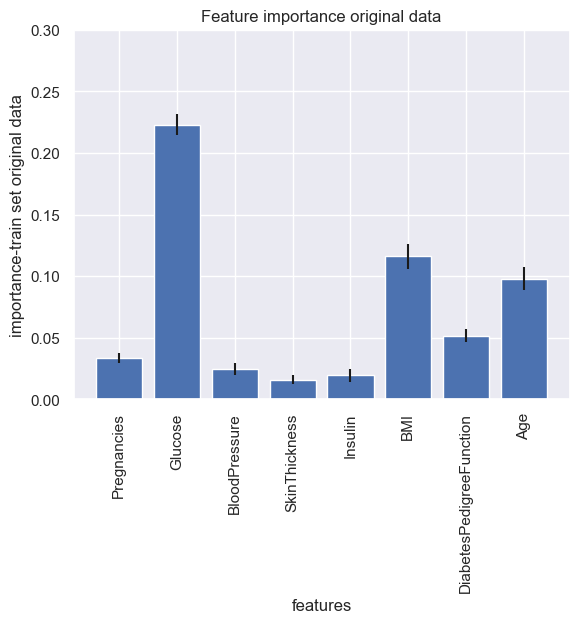

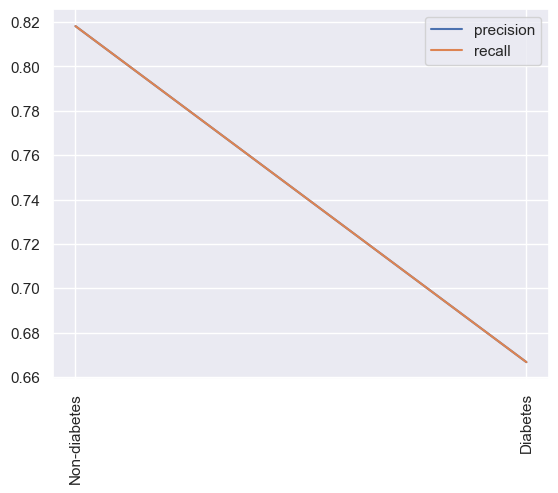

 estimator: 150 depth: 16 test score:0.7712418300653595
 estimator: 150 depth: 16 train score:1.0
Accuracy: 0.7712418300653595
Classification Report:
              precision    recall  f1-score   support

         0.0       0.83      0.82      0.82        99
         1.0       0.67      0.69      0.68        54

    accuracy                           0.77       153
   macro avg       0.75      0.75      0.75       153
weighted avg       0.77      0.77      0.77       153



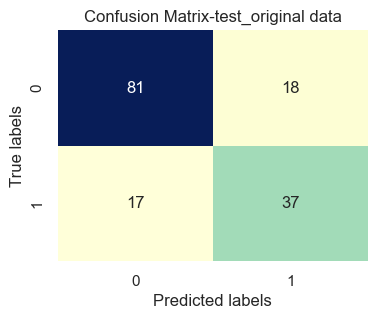

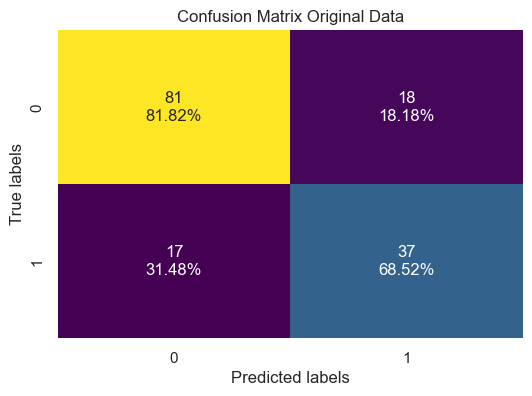

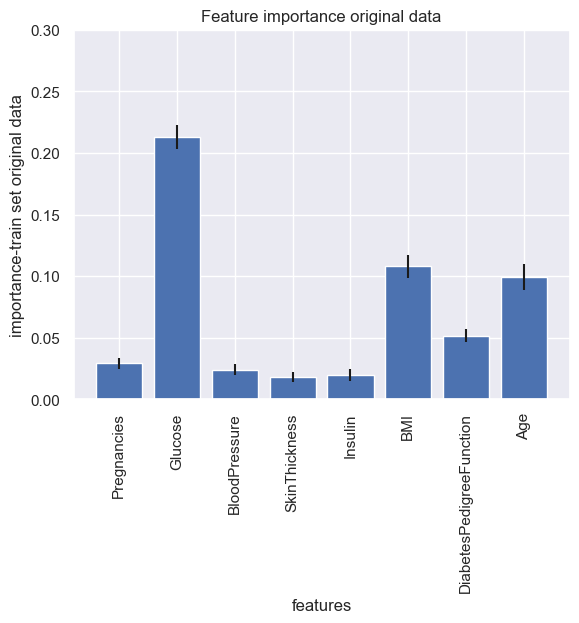

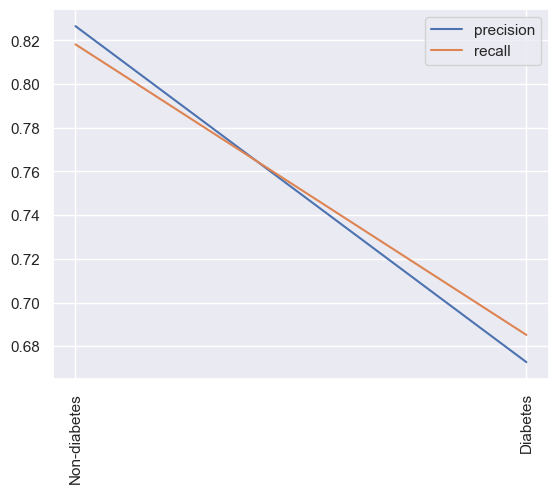

 estimator: 200 depth: 16 test score:0.7777777777777778
 estimator: 200 depth: 16 train score:1.0
Accuracy: 0.7777777777777778
Classification Report:
              precision    recall  f1-score   support

         0.0       0.84      0.82      0.83        99
         1.0       0.68      0.70      0.69        54

    accuracy                           0.78       153
   macro avg       0.76      0.76      0.76       153
weighted avg       0.78      0.78      0.78       153



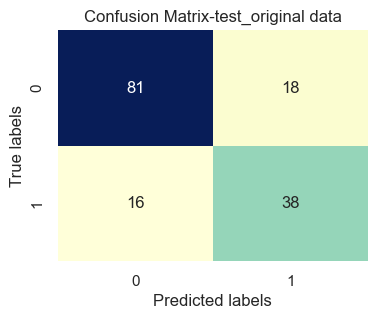

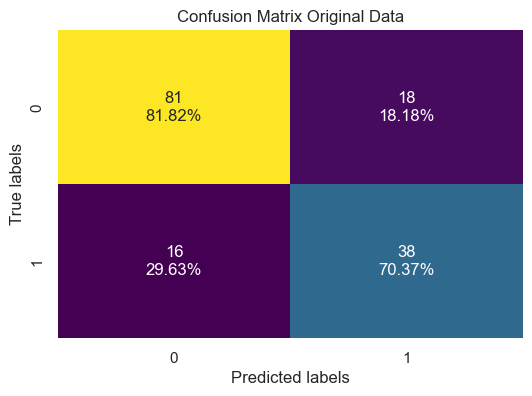

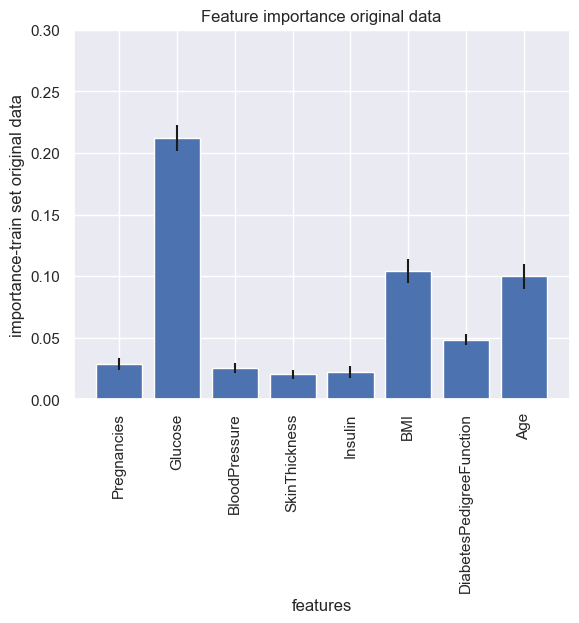

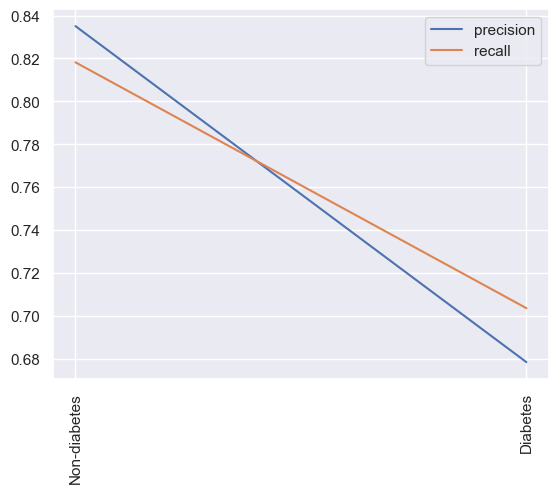

 estimator: 500 depth: 16 test score:0.7647058823529411
 estimator: 500 depth: 16 train score:1.0
Accuracy: 0.7647058823529411
Classification Report:
              precision    recall  f1-score   support

         0.0       0.82      0.81      0.82        99
         1.0       0.66      0.69      0.67        54

    accuracy                           0.76       153
   macro avg       0.74      0.75      0.74       153
weighted avg       0.77      0.76      0.77       153



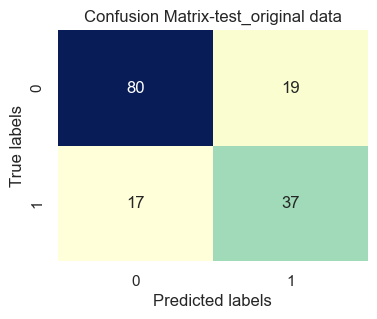

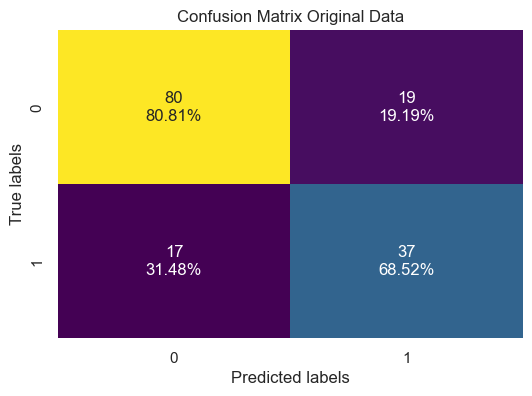

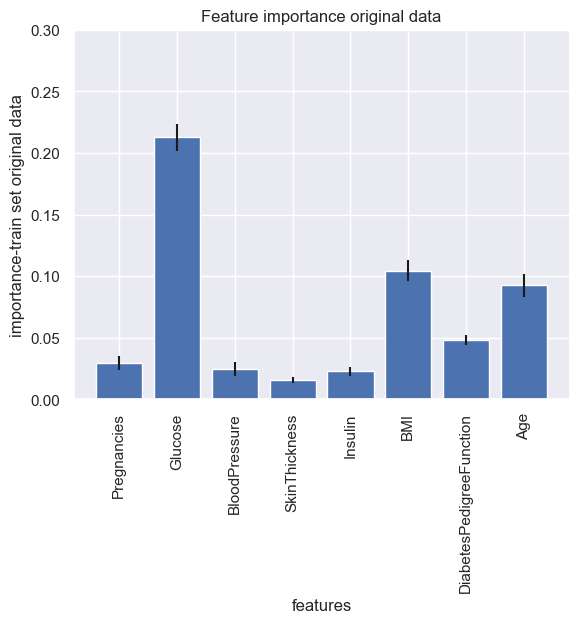

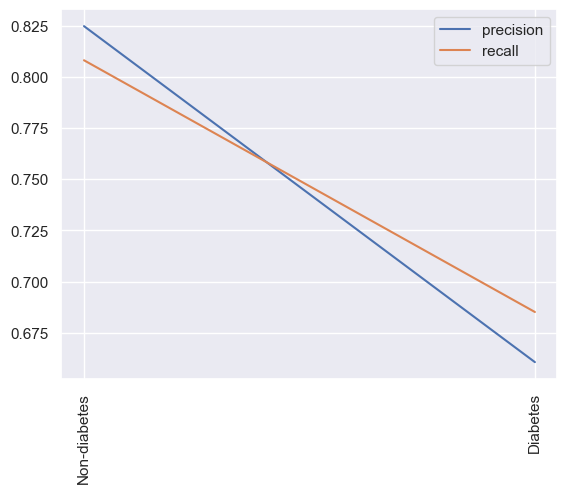

 estimator: 1 depth: 20 test score:0.6601307189542484
 estimator: 1 depth: 20 train score:0.881578947368421
Accuracy: 0.6601307189542484
Classification Report:
              precision    recall  f1-score   support

         0.0       0.74      0.74      0.74        99
         1.0       0.52      0.52      0.52        54

    accuracy                           0.66       153
   macro avg       0.63      0.63      0.63       153
weighted avg       0.66      0.66      0.66       153



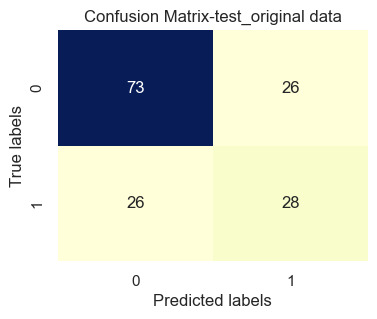

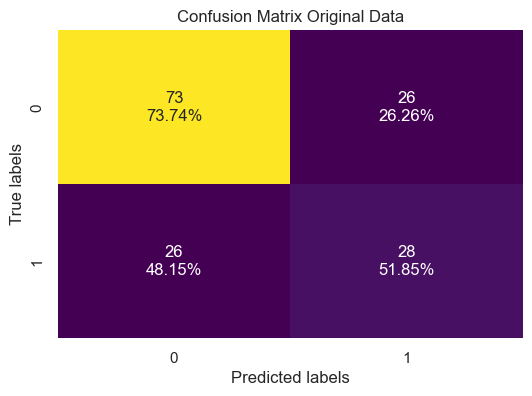

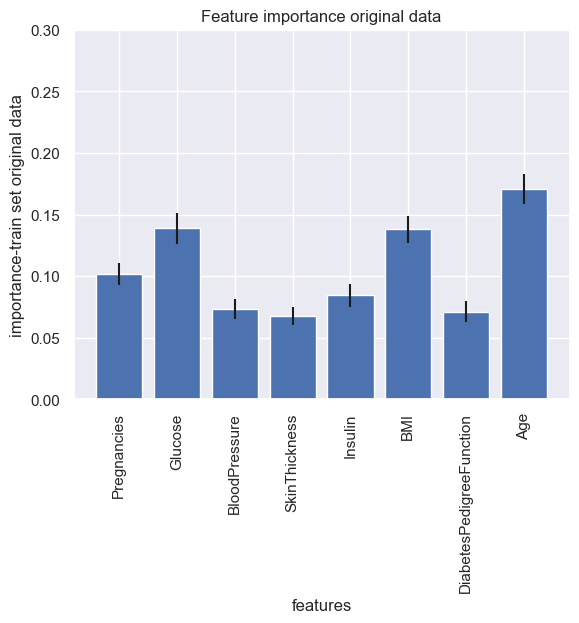

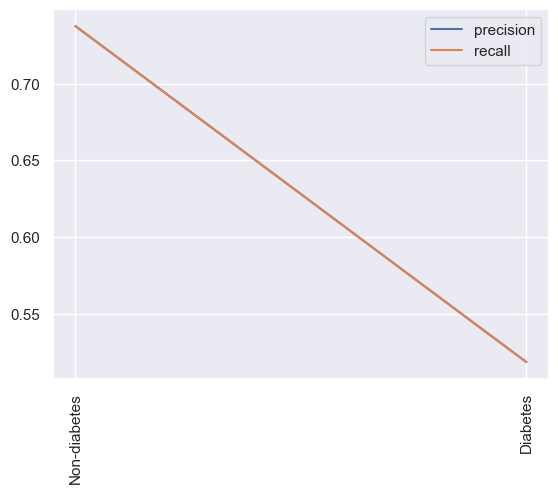

 estimator: 5 depth: 20 test score:0.7189542483660131
 estimator: 5 depth: 20 train score:0.975328947368421
Accuracy: 0.7189542483660131
Classification Report:
              precision    recall  f1-score   support

         0.0       0.78      0.79      0.78        99
         1.0       0.60      0.59      0.60        54

    accuracy                           0.72       153
   macro avg       0.69      0.69      0.69       153
weighted avg       0.72      0.72      0.72       153



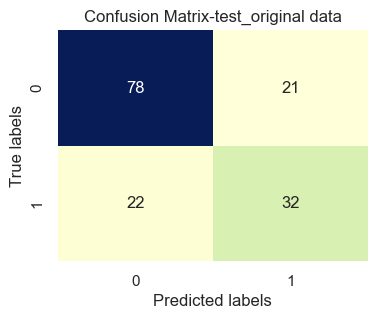

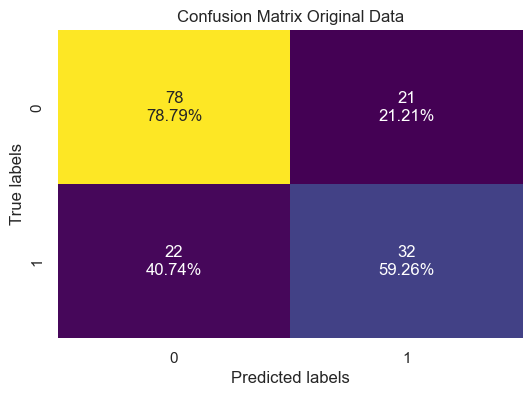

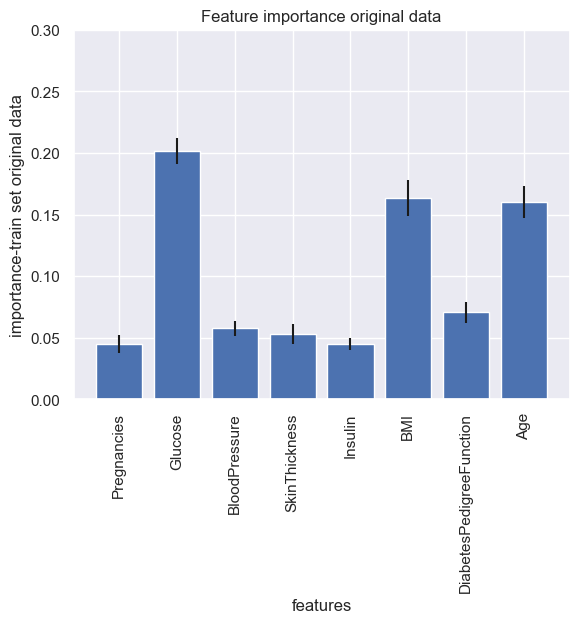

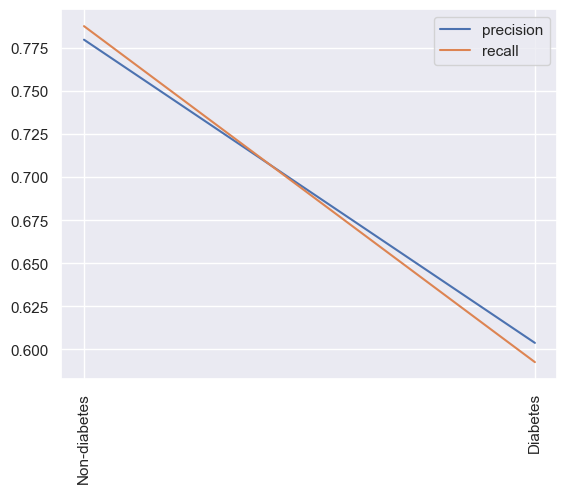

 estimator: 10 depth: 20 test score:0.7320261437908496
 estimator: 10 depth: 20 train score:0.9901315789473685
Accuracy: 0.7320261437908496
Classification Report:
              precision    recall  f1-score   support

         0.0       0.78      0.82      0.80        99
         1.0       0.63      0.57      0.60        54

    accuracy                           0.73       153
   macro avg       0.71      0.70      0.70       153
weighted avg       0.73      0.73      0.73       153



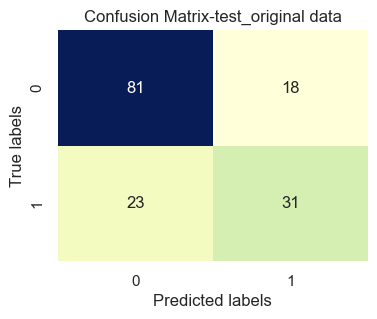

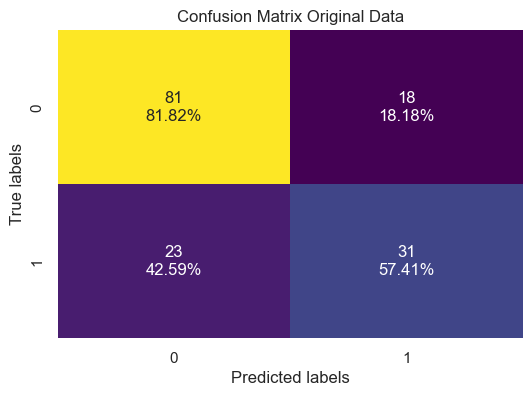

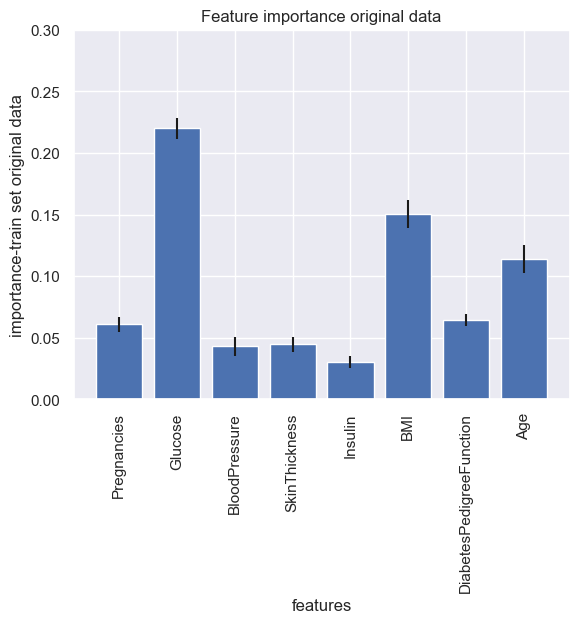

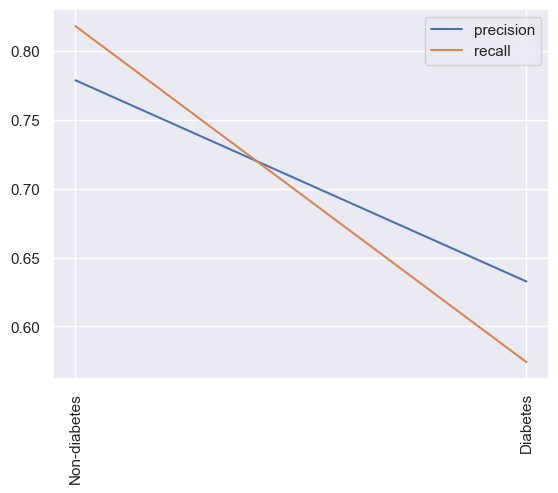

 estimator: 20 depth: 20 test score:0.7516339869281046
 estimator: 20 depth: 20 train score:1.0
Accuracy: 0.7516339869281046
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.83      0.81        99
         1.0       0.66      0.61      0.63        54

    accuracy                           0.75       153
   macro avg       0.73      0.72      0.72       153
weighted avg       0.75      0.75      0.75       153



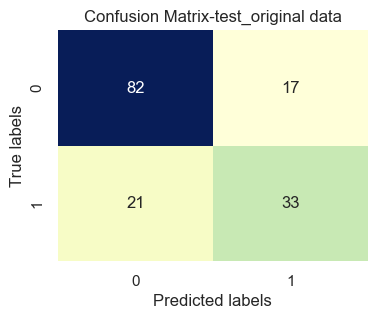

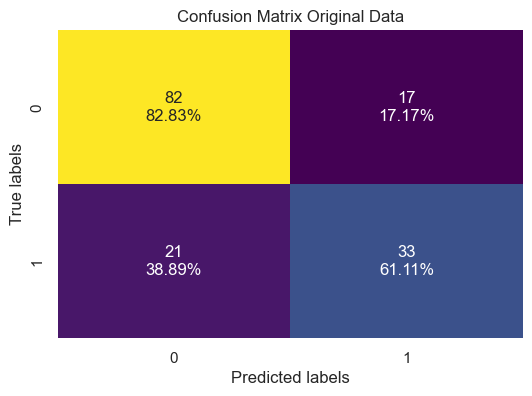

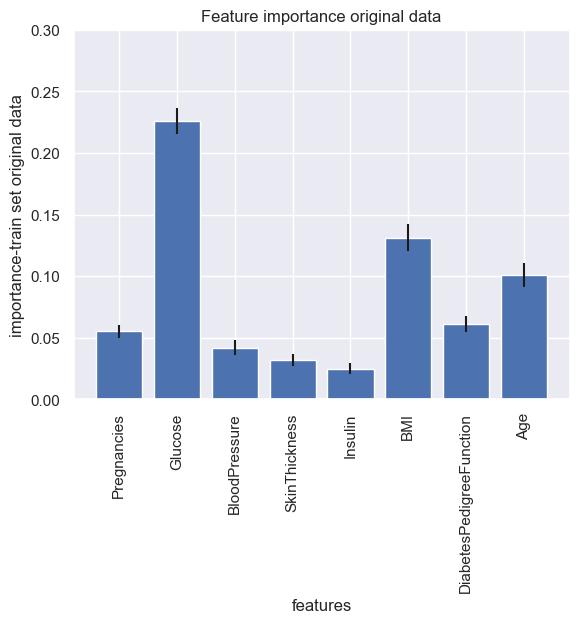

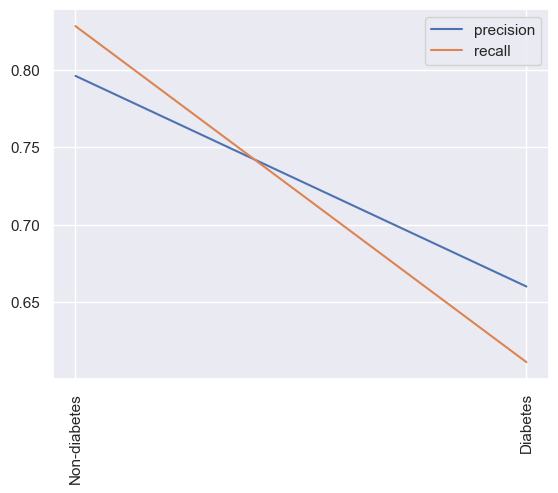

 estimator: 50 depth: 20 test score:0.7581699346405228
 estimator: 50 depth: 20 train score:1.0
Accuracy: 0.7581699346405228
Classification Report:
              precision    recall  f1-score   support

         0.0       0.81      0.82      0.81        99
         1.0       0.66      0.65      0.65        54

    accuracy                           0.76       153
   macro avg       0.74      0.73      0.73       153
weighted avg       0.76      0.76      0.76       153



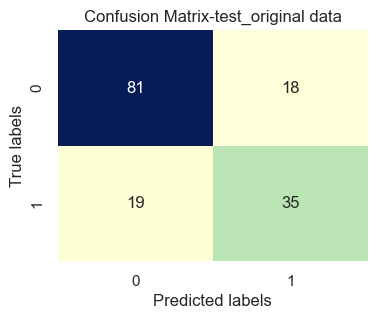

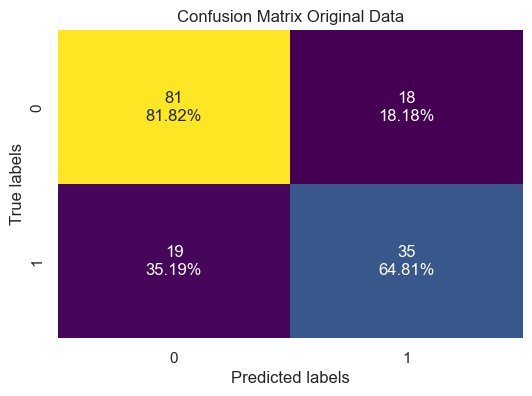

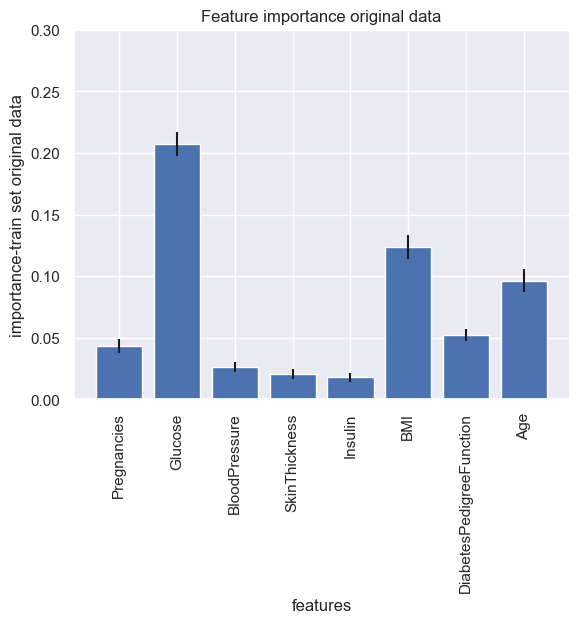

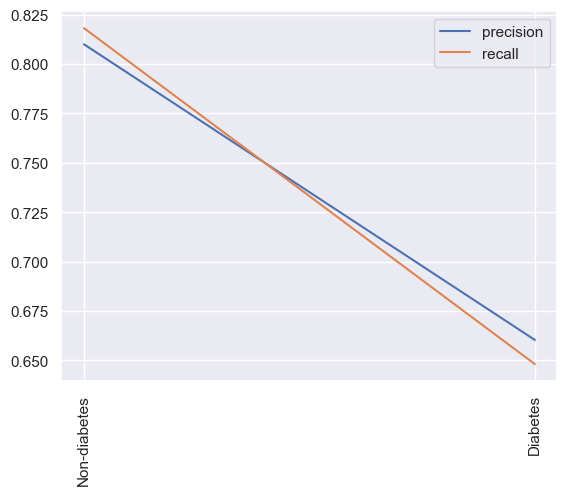

 estimator: 100 depth: 20 test score:0.7581699346405228
 estimator: 100 depth: 20 train score:1.0
Accuracy: 0.7581699346405228
Classification Report:
              precision    recall  f1-score   support

         0.0       0.81      0.82      0.81        99
         1.0       0.66      0.65      0.65        54

    accuracy                           0.76       153
   macro avg       0.74      0.73      0.73       153
weighted avg       0.76      0.76      0.76       153



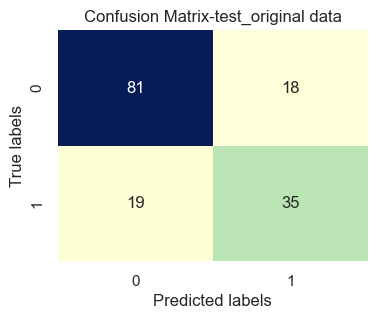

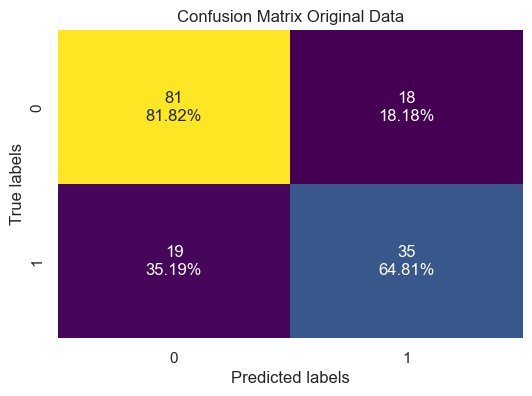

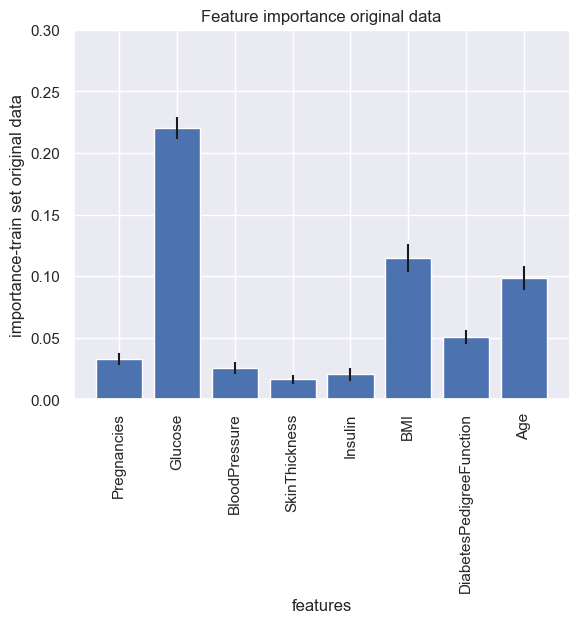

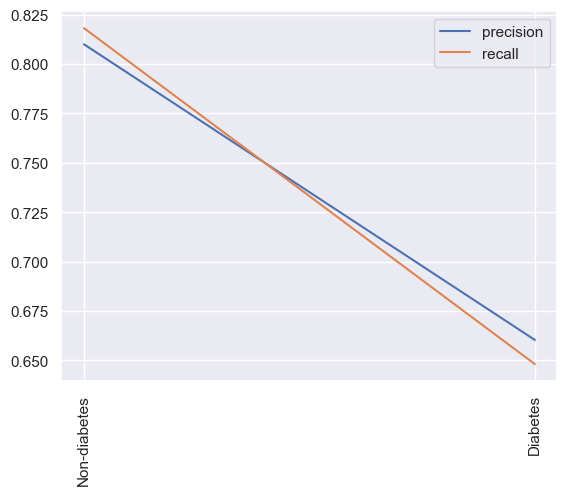

 estimator: 150 depth: 20 test score:0.7777777777777778
 estimator: 150 depth: 20 train score:1.0
Accuracy: 0.7777777777777778
Classification Report:
              precision    recall  f1-score   support

         0.0       0.84      0.82      0.83        99
         1.0       0.68      0.70      0.69        54

    accuracy                           0.78       153
   macro avg       0.76      0.76      0.76       153
weighted avg       0.78      0.78      0.78       153



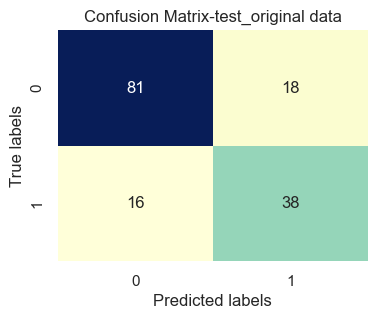

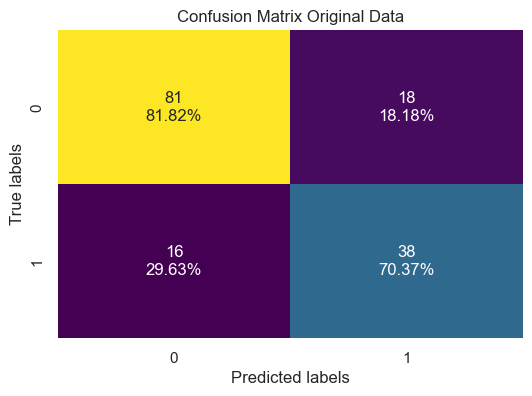

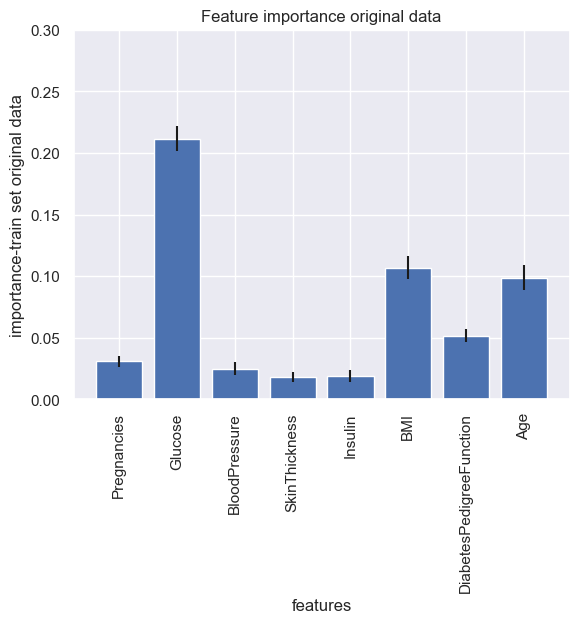

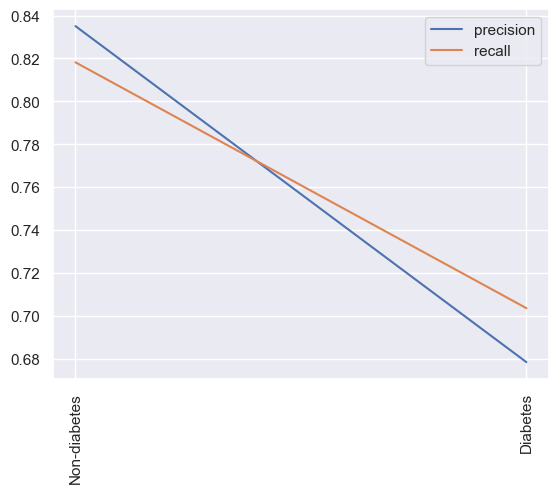

 estimator: 200 depth: 20 test score:0.7777777777777778
 estimator: 200 depth: 20 train score:1.0
Accuracy: 0.7777777777777778
Classification Report:
              precision    recall  f1-score   support

         0.0       0.84      0.82      0.83        99
         1.0       0.68      0.70      0.69        54

    accuracy                           0.78       153
   macro avg       0.76      0.76      0.76       153
weighted avg       0.78      0.78      0.78       153



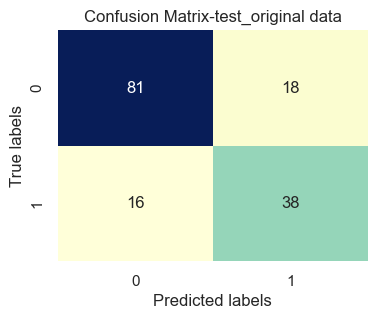

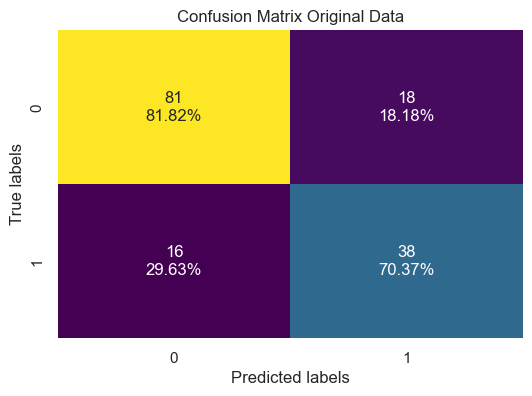

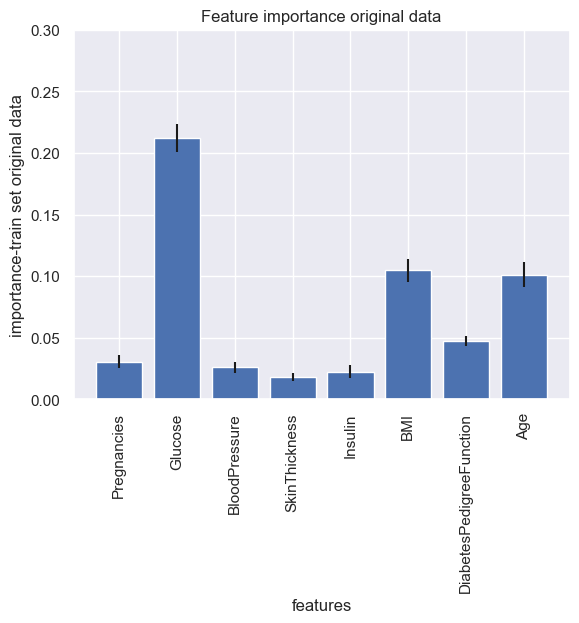

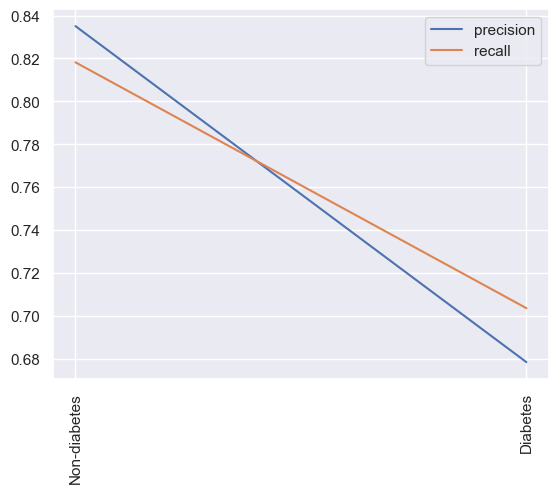

 estimator: 500 depth: 20 test score:0.7712418300653595
 estimator: 500 depth: 20 train score:1.0
Accuracy: 0.7712418300653595
Classification Report:
              precision    recall  f1-score   support

         0.0       0.83      0.82      0.82        99
         1.0       0.67      0.69      0.68        54

    accuracy                           0.77       153
   macro avg       0.75      0.75      0.75       153
weighted avg       0.77      0.77      0.77       153



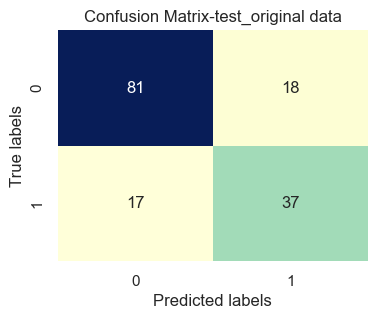

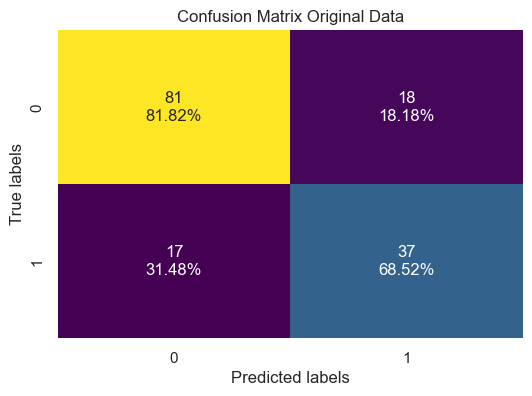

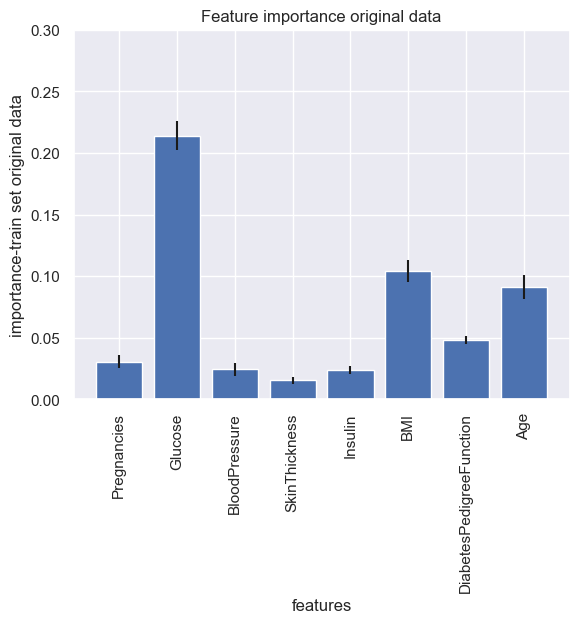

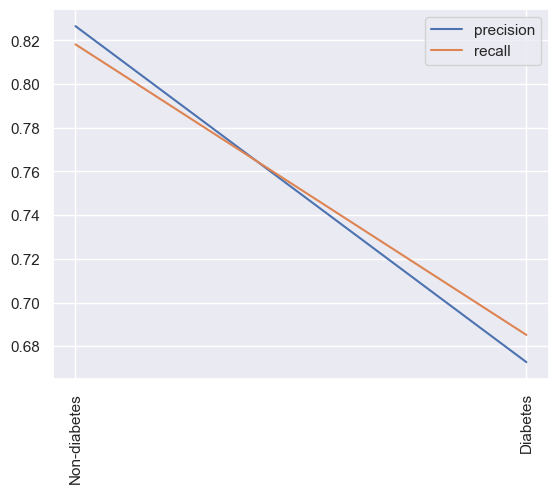

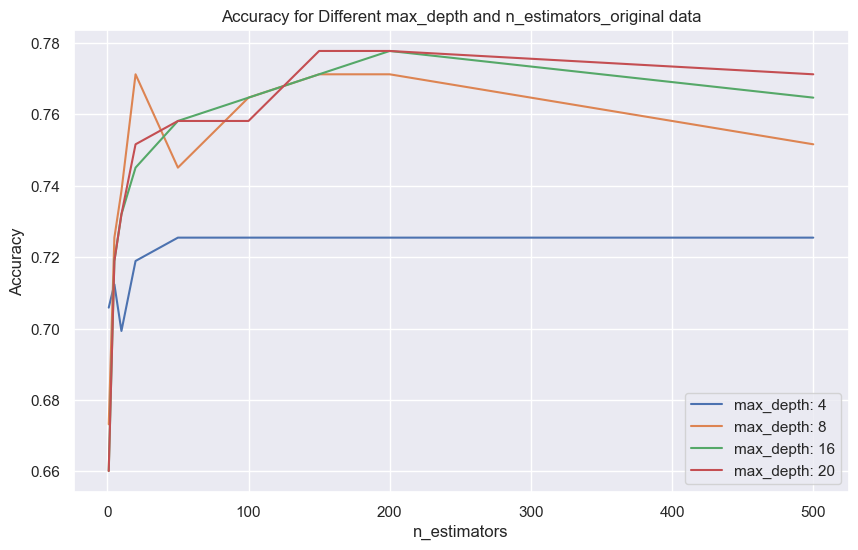

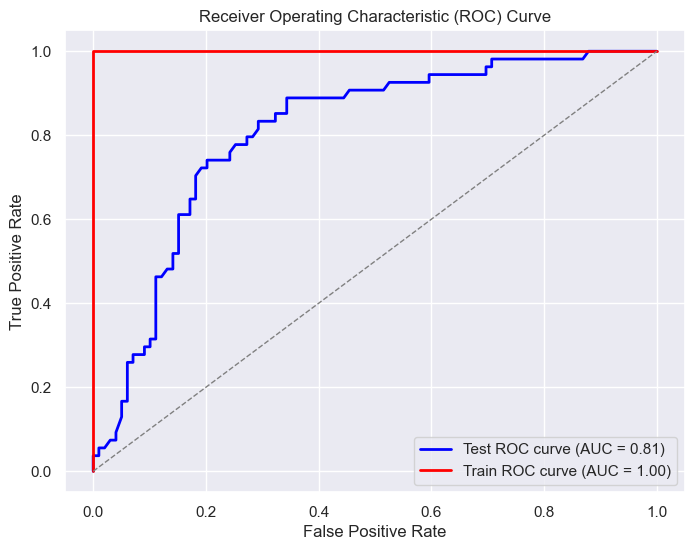

In [81]:
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

accuracies =[]
for m_deph in (4,8,16,20):
    acc_row =[]
    for n_est in (1, 5, 10,20, 50,100,150,200,500): #we are changing the number of estimatores to check
#for n_est in [100]:
# do fit
      rfc= ensemble.RandomForestClassifier(max_depth=m_deph, n_estimators=n_est,random_state=42)
      rfc.fit(x_train, y_train)
   # test different paramethers and take the one that gives the best aqurancy at the end.
    # print the training scores
      print(f' estimator: {n_est} depth: {m_deph} test score:{(rfc.score(x_test, y_test))}')
      print(f' estimator: {n_est} depth: {m_deph} train score:{(rfc.score(x_train, y_train))}')
      y_pred_test = rfc.predict(x_test)
      y_pred_train = rfc.predict(x_train)
    #print(y_pred_test)
       #Evaluate the classifier
      accuracy = accuracy_score(y_test, y_pred_test)
      print(f'Accuracy: {accuracy}')
      acc_row.append(accuracy) 
    
    # Print classification report and confusion matrix
      print("Classification Report:")
      print(classification_report(y_test, y_pred_test))

      #print("Confusion Matrix:")
      #print(confusion_matrix(y_test, y_pred_test))
    
      cm = confusion_matrix(y_test, y_pred_test)

    # Display the confusion matrix
      plt.figure(figsize=(4, 3))
      sns.heatmap(cm, annot=True, fmt='d', cmap='YlGnBu', cbar=False)
      plt.xlabel('Predicted labels')
      plt.ylabel('True labels')
      plt.title('Confusion Matrix-test_original data')
      plt.show()
    
    
    
    # Display the confusion matrix with values and percentages
      cm_sum = np.sum(cm, axis=1, keepdims=True)
      cm_percentages = cm / cm_sum.astype(float) * 100
      cm_with_percentages = np.round(cm_percentages, 2)

      plt.figure(figsize=(6, 4))
      sns.heatmap(
      cm,
      annot=np.array([f'{v1}\n{v2}%' for v1, v2 in zip(cm.flatten(), cm_with_percentages.flatten())]).reshape(cm.shape),
      fmt='',
      cmap='viridis',
      cbar=False
       )
      plt.xlabel('Predicted labels')
      plt.ylabel('True labels')
      plt.title('Confusion Matrix Original Data')
      plt.show()

     #calculate feature importance
      p_importances = permutation_importance(rfc, x_train, y_train, n_repeats=20, n_jobs=-1,random_state=42)

      plt.bar(features,
        p_importances.importances_mean,
        yerr=p_importances.importances_std)
      plt.xticks(rotation=90)
      plt.xlabel('features')
      plt.ylabel('importance-train set original data')
      plt.title('Feature importance original data')
      plt.ylim(0, 0.3)
      plt.show()
     #calculate recall and pressicion

      #print(f'Check that you get the same accuracy from the score method: {np.sum([confusion_test[i,i] for i in range(2)])/np.sum(confusion_test)}')
    #sums the diagonal and divide the whole matrix
      precisions=[]
      recalls=[]
    #precision
      for i in range(2):
        precisions.append(cm[i,i]/np.sum(cm[:,i])) #take the diagonal divided by the whole column
#percentage of positive identified??
#recall
      for i in range(2):
        recalls.append(cm[i,i]/np.sum(cm[i,:])) #take the diagonal and divide by the whole row

      plt.plot(Output_names,precisions, label='precision')
      plt.plot(Output_names,recalls, label='recall')
      plt.xticks(rotation=90)
      plt.legend()
      plt.show()
    
    accuracies.append(acc_row)
    
    
plt.figure(figsize=(10, 6))
for i, m_deph in enumerate((4, 8, 16, 20)):
    plt.plot((1, 5, 10,20, 50,100,150,200,500), accuracies[i], label=f"max_depth: {m_deph}")

plt.xlabel("n_estimators")
plt.ylabel("Accuracy")
plt.title("Accuracy for Different max_depth and n_estimators_original data")
plt.legend()
plt.show()
    
#plot both train and set ROCs

# Calculate ROC curve and ROC area for test set
y_test_pred_proba = rfc.predict_proba(x_test)[:, 1]
fpr_test, tpr_test, _ = roc_curve(y_test, y_test_pred_proba)
roc_auc_test = roc_auc_score(y_test, y_test_pred_proba)

# Calculate ROC curve and ROC area for train set
y_train_pred_proba = rfc.predict_proba(x_train)[:, 1]
fpr_train, tpr_train, _ = roc_curve(y_train, y_train_pred_proba)
roc_auc_train = roc_auc_score(y_train, y_train_pred_proba)

# Plotting ROC curves
plt.figure(figsize=(8, 6))
plt.plot(fpr_test, tpr_test, color='blue', lw=2, label=f'Test ROC curve (AUC = {roc_auc_test:.2f})')
plt.plot(fpr_train, tpr_train, color='red', lw=2, label=f'Train ROC curve (AUC = {roc_auc_train:.2f})')
plt.plot([0, 1], [0, 1], color='gray', lw=1, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.show()




 estimator: 1 depth: 4 test score:0.7058823529411765
 estimator: 1 depth: 4 train score:0.7730263157894737
Accuracy train: 0.7730263157894737
Classification Report-train:
              precision    recall  f1-score   support

         0.0       0.81      0.85      0.83       395
         1.0       0.69      0.63      0.66       213

    accuracy                           0.77       608
   macro avg       0.75      0.74      0.75       608
weighted avg       0.77      0.77      0.77       608



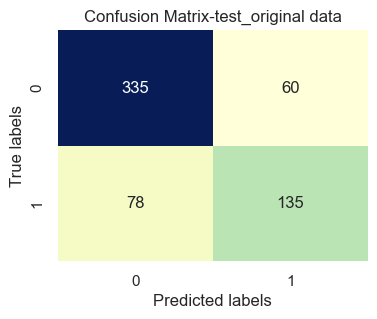

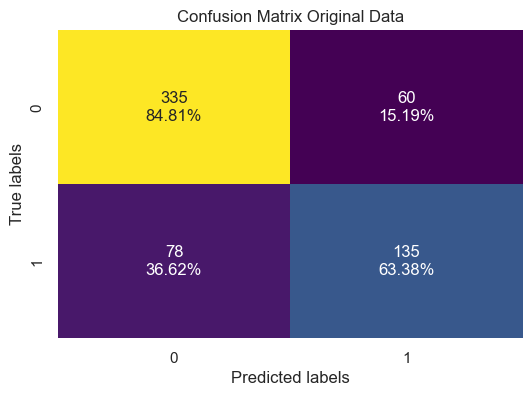

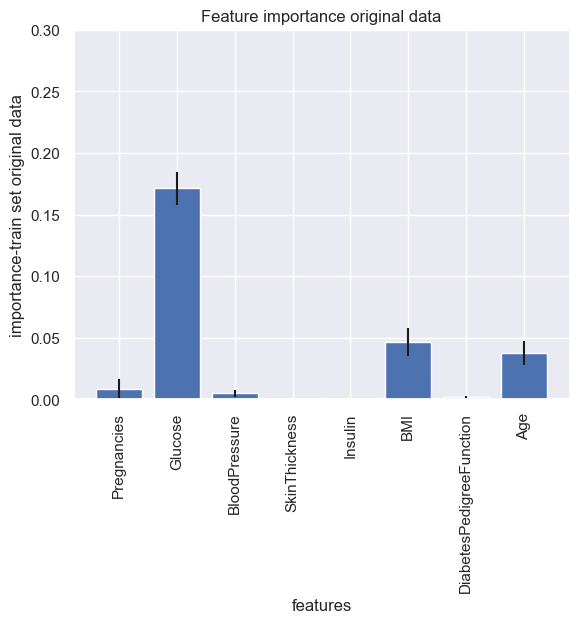

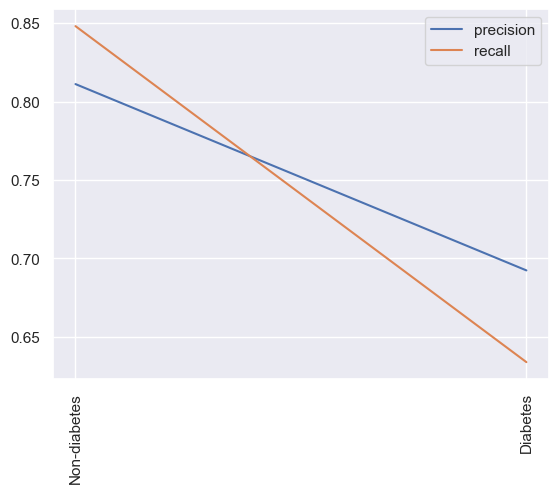

 estimator: 5 depth: 4 test score:0.7124183006535948
 estimator: 5 depth: 4 train score:0.8223684210526315
Accuracy train: 0.8223684210526315
Classification Report-train:
              precision    recall  f1-score   support

         0.0       0.83      0.92      0.87       395
         1.0       0.81      0.65      0.72       213

    accuracy                           0.82       608
   macro avg       0.82      0.78      0.79       608
weighted avg       0.82      0.82      0.82       608



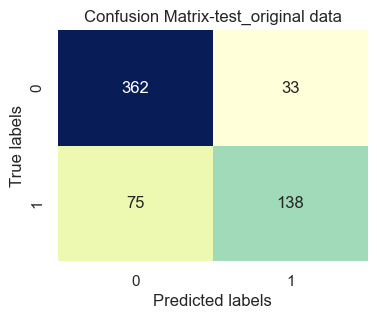

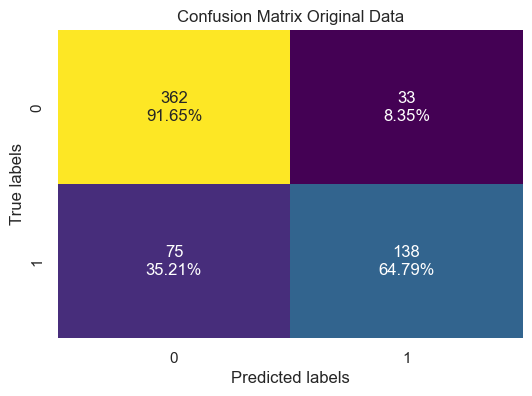

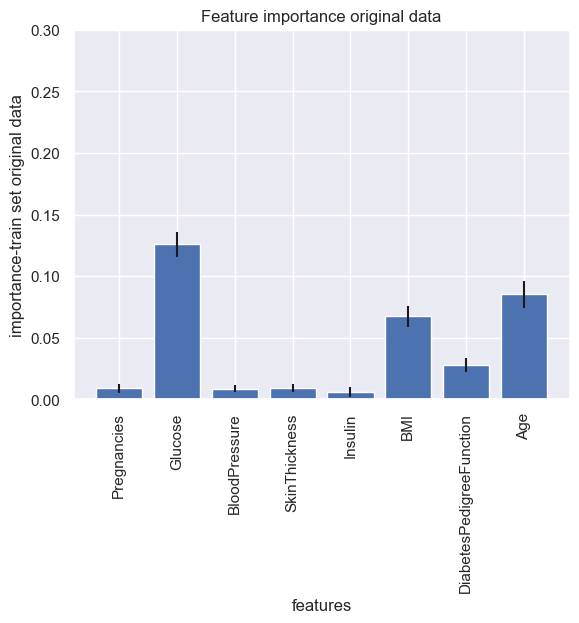

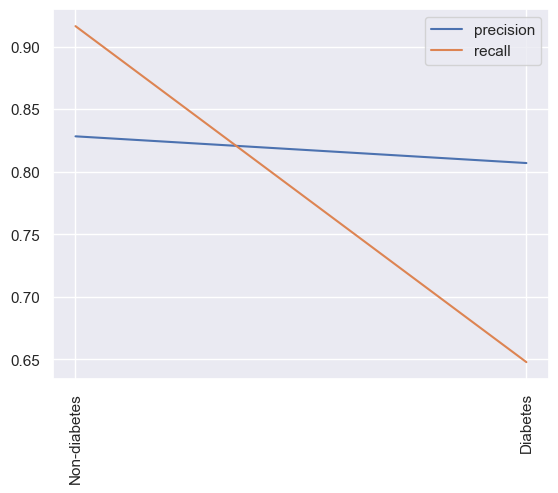

 estimator: 10 depth: 4 test score:0.6993464052287581
 estimator: 10 depth: 4 train score:0.8174342105263158
Accuracy train: 0.8174342105263158
Classification Report-train:
              precision    recall  f1-score   support

         0.0       0.82      0.92      0.87       395
         1.0       0.81      0.62      0.70       213

    accuracy                           0.82       608
   macro avg       0.82      0.77      0.79       608
weighted avg       0.82      0.82      0.81       608



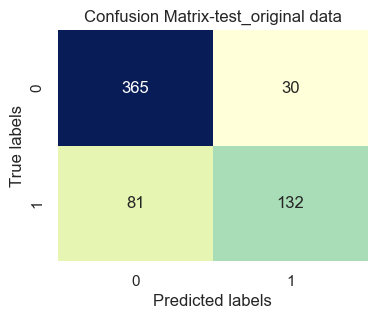

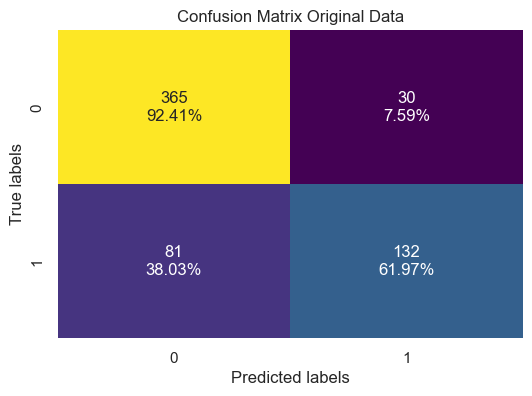

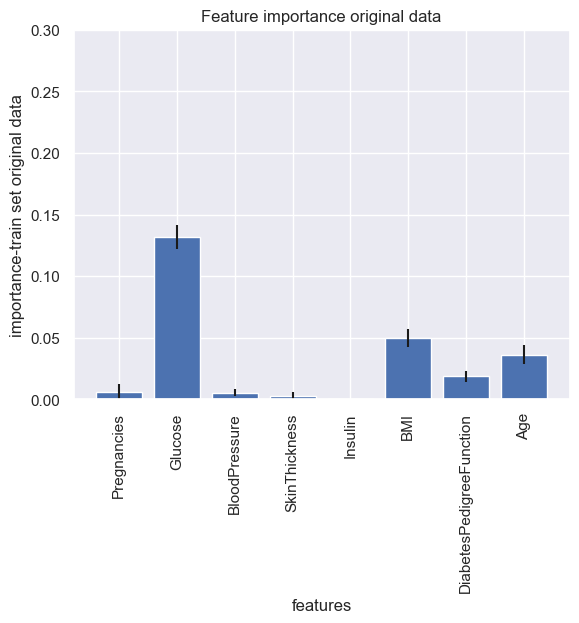

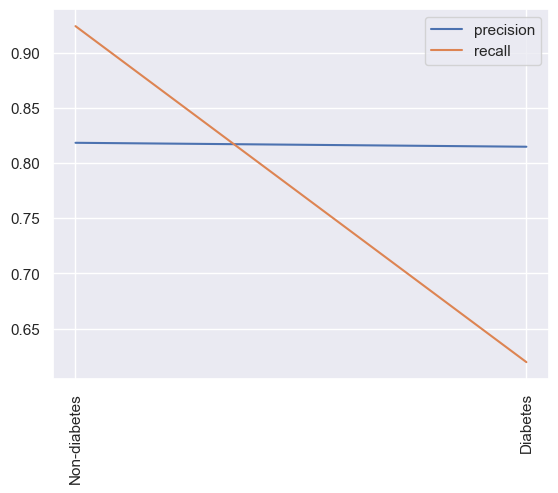

 estimator: 20 depth: 4 test score:0.7189542483660131
 estimator: 20 depth: 4 train score:0.8240131578947368
Accuracy train: 0.8240131578947368
Classification Report-train:
              precision    recall  f1-score   support

         0.0       0.82      0.93      0.87       395
         1.0       0.83      0.63      0.71       213

    accuracy                           0.82       608
   macro avg       0.83      0.78      0.79       608
weighted avg       0.82      0.82      0.82       608



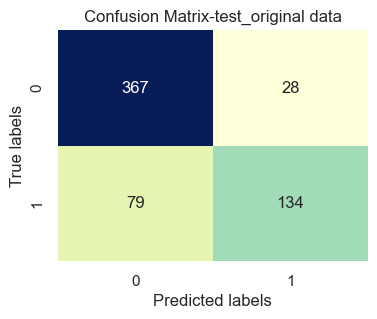

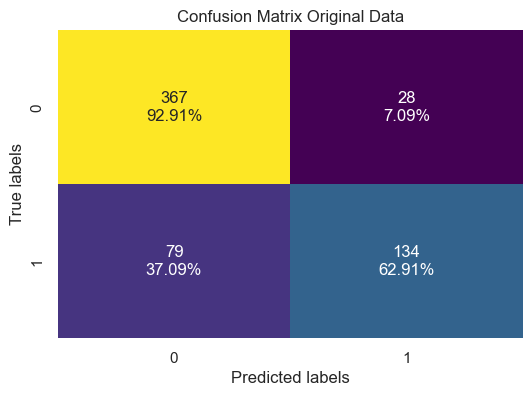

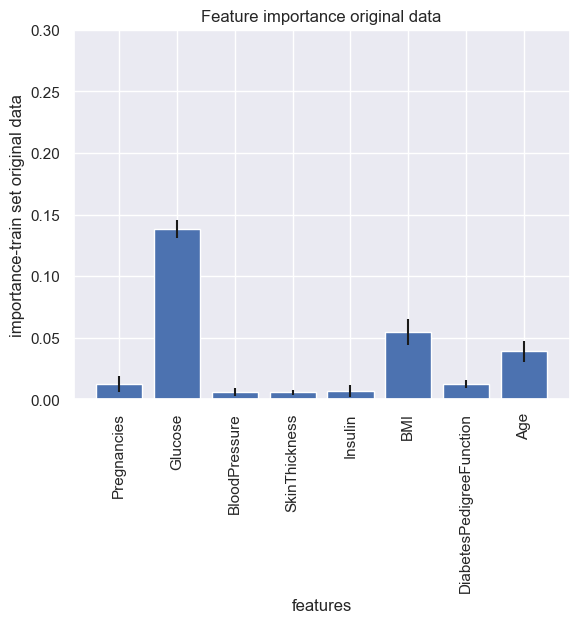

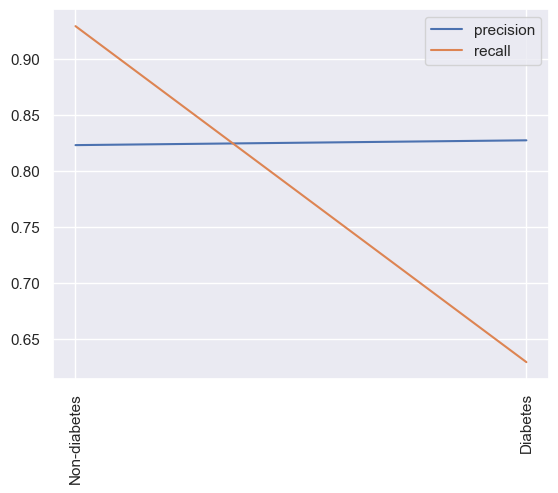

 estimator: 50 depth: 4 test score:0.7254901960784313
 estimator: 50 depth: 4 train score:0.8289473684210527
Accuracy train: 0.8289473684210527
Classification Report-train:
              precision    recall  f1-score   support

         0.0       0.83      0.93      0.88       395
         1.0       0.83      0.65      0.73       213

    accuracy                           0.83       608
   macro avg       0.83      0.79      0.80       608
weighted avg       0.83      0.83      0.82       608



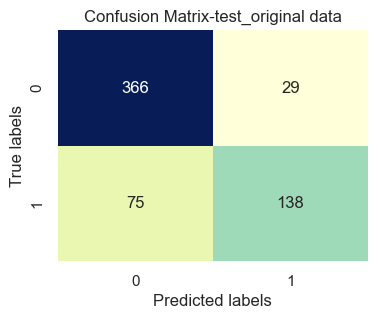

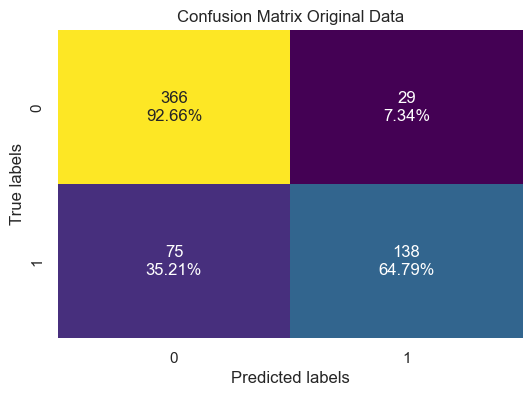

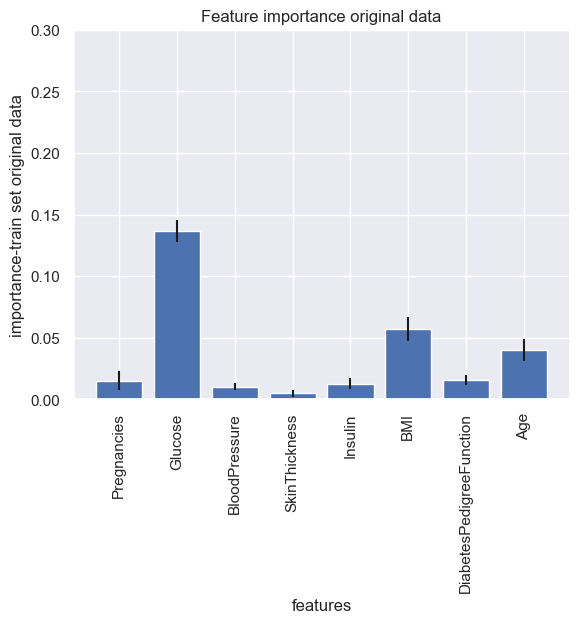

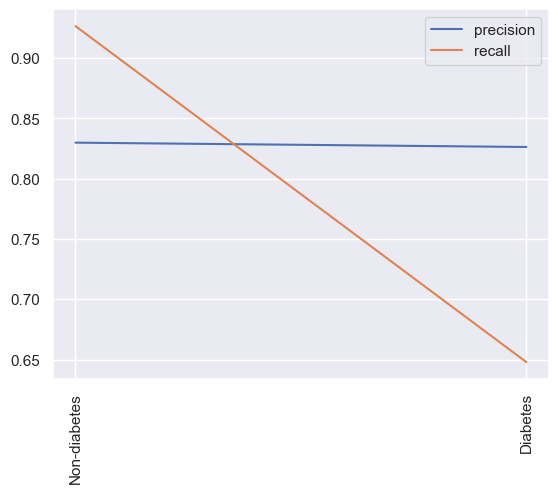

 estimator: 100 depth: 4 test score:0.7254901960784313
 estimator: 100 depth: 4 train score:0.8273026315789473
Accuracy train: 0.8273026315789473
Classification Report-train:
              precision    recall  f1-score   support

         0.0       0.83      0.93      0.87       395
         1.0       0.83      0.64      0.72       213

    accuracy                           0.83       608
   macro avg       0.83      0.78      0.80       608
weighted avg       0.83      0.83      0.82       608



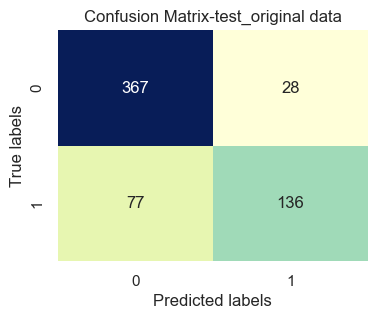

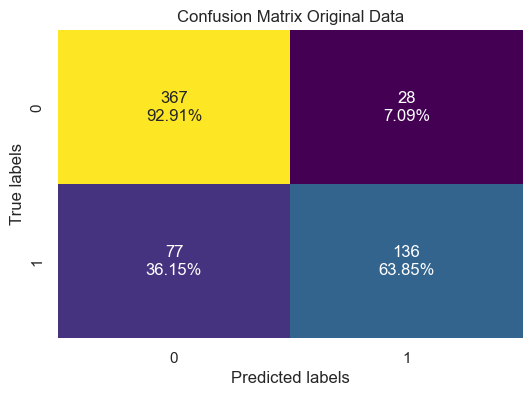

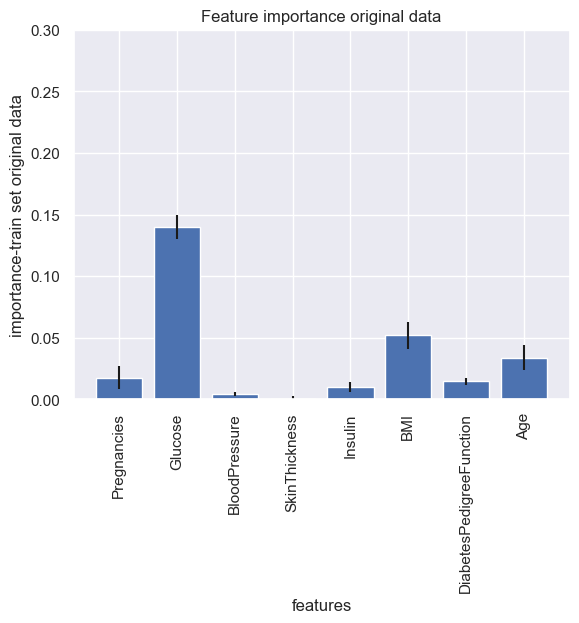

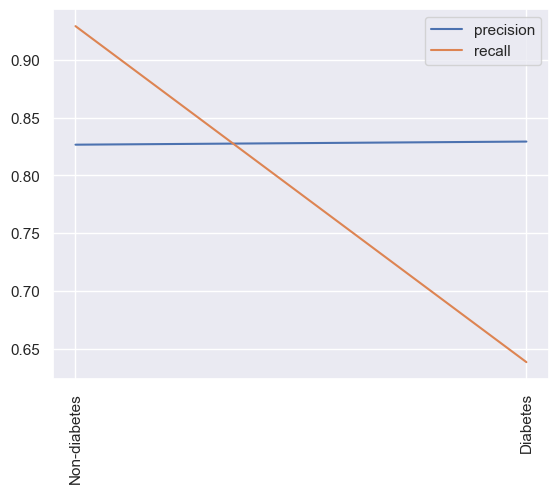

 estimator: 150 depth: 4 test score:0.7254901960784313
 estimator: 150 depth: 4 train score:0.8256578947368421
Accuracy train: 0.8256578947368421
Classification Report-train:
              precision    recall  f1-score   support

         0.0       0.82      0.93      0.87       395
         1.0       0.84      0.62      0.72       213

    accuracy                           0.83       608
   macro avg       0.83      0.78      0.79       608
weighted avg       0.83      0.83      0.82       608



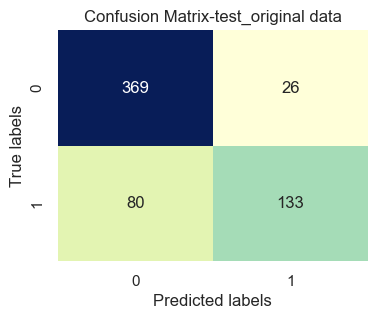

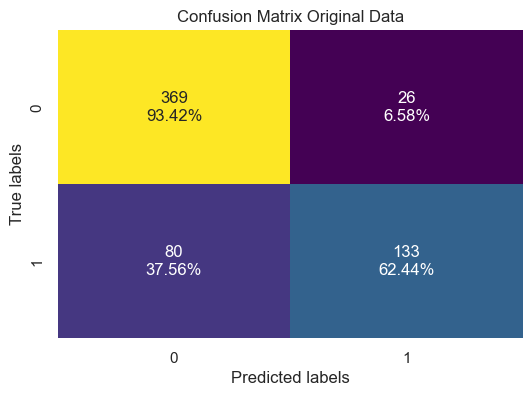

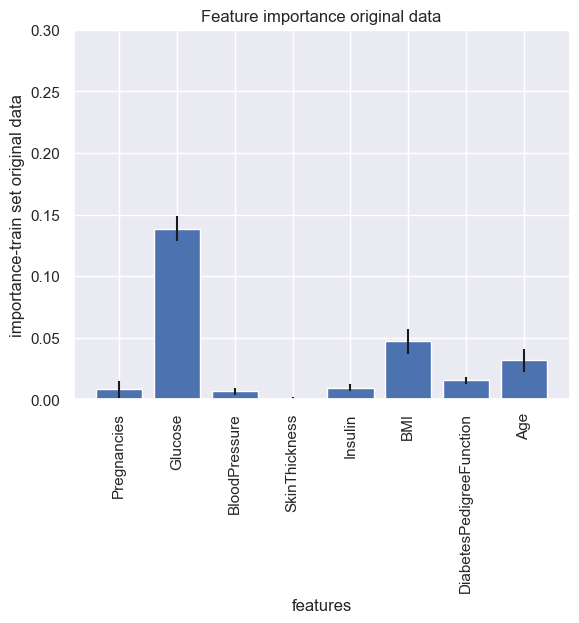

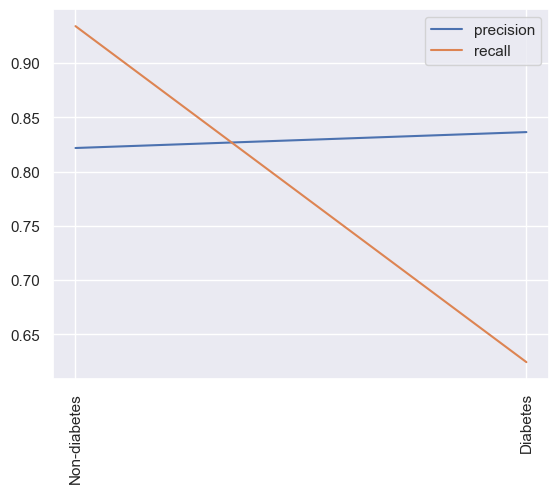

 estimator: 200 depth: 4 test score:0.7254901960784313
 estimator: 200 depth: 4 train score:0.8256578947368421
Accuracy train: 0.8256578947368421
Classification Report-train:
              precision    recall  f1-score   support

         0.0       0.82      0.93      0.87       395
         1.0       0.84      0.62      0.72       213

    accuracy                           0.83       608
   macro avg       0.83      0.78      0.79       608
weighted avg       0.83      0.83      0.82       608



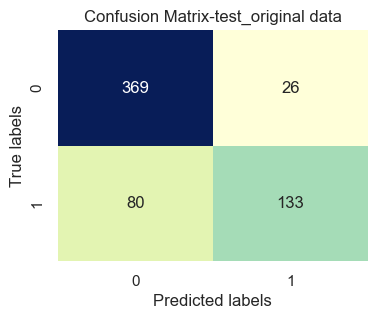

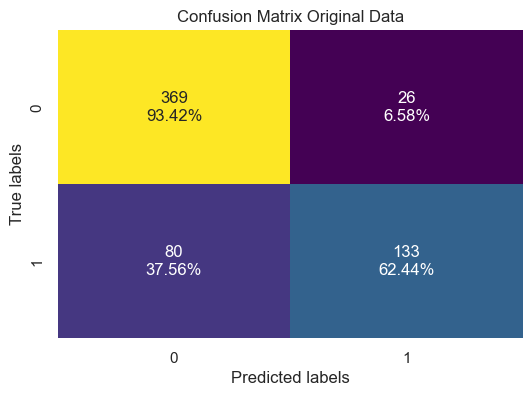

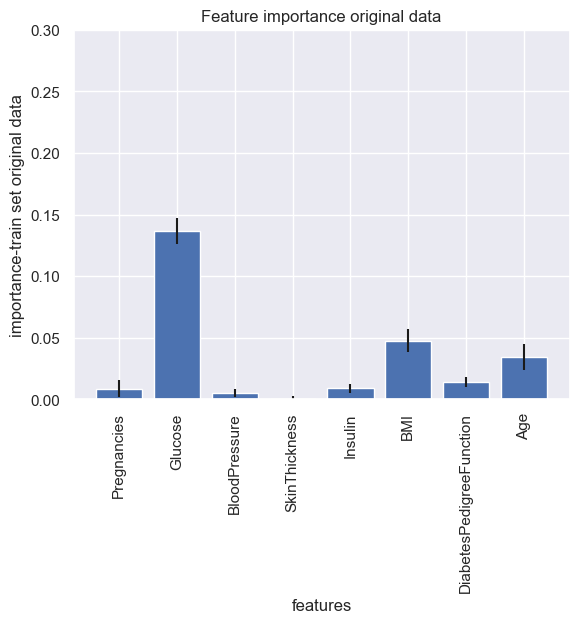

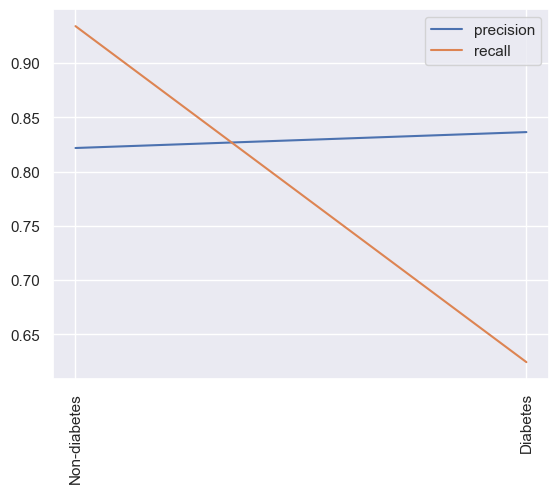

 estimator: 500 depth: 4 test score:0.7254901960784313
 estimator: 500 depth: 4 train score:0.8240131578947368
Accuracy train: 0.8240131578947368
Classification Report-train:
              precision    recall  f1-score   support

         0.0       0.82      0.94      0.87       395
         1.0       0.84      0.62      0.71       213

    accuracy                           0.82       608
   macro avg       0.83      0.78      0.79       608
weighted avg       0.83      0.82      0.82       608



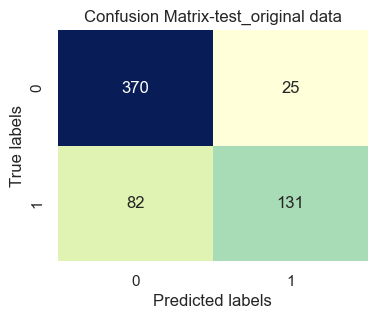

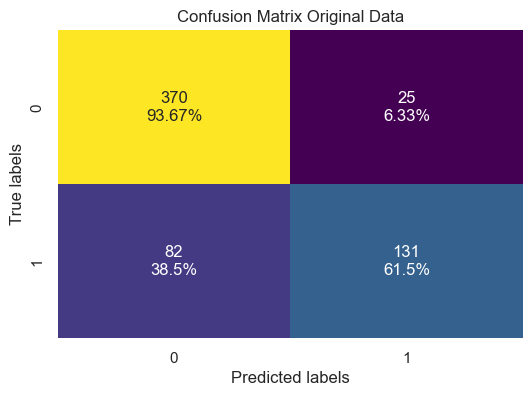

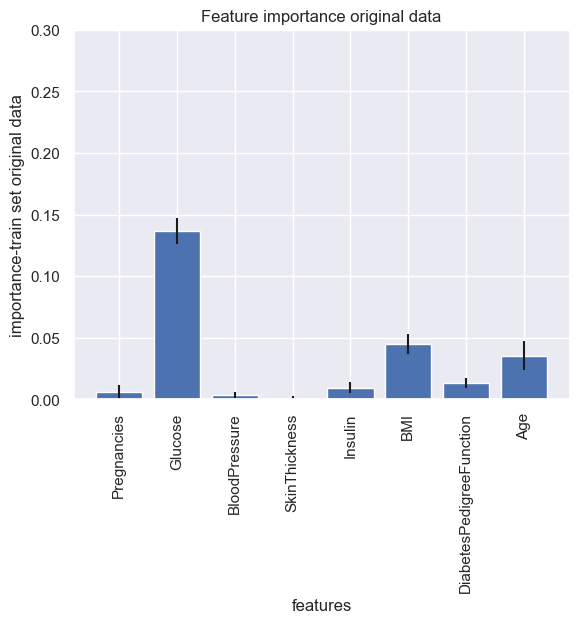

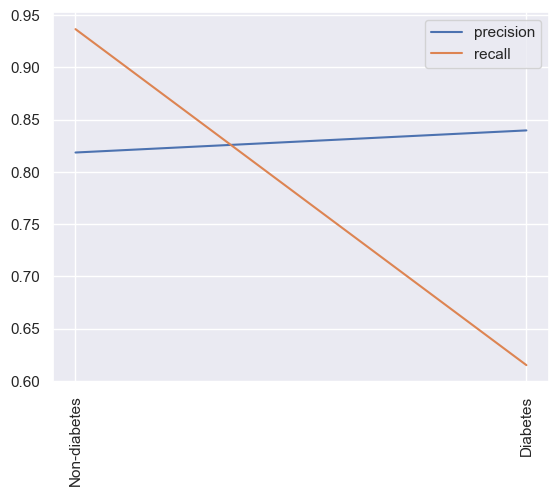

 estimator: 1 depth: 8 test score:0.673202614379085
 estimator: 1 depth: 8 train score:0.837171052631579
Accuracy train: 0.837171052631579
Classification Report-train:
              precision    recall  f1-score   support

         0.0       0.86      0.90      0.88       395
         1.0       0.79      0.73      0.76       213

    accuracy                           0.84       608
   macro avg       0.83      0.81      0.82       608
weighted avg       0.84      0.84      0.84       608



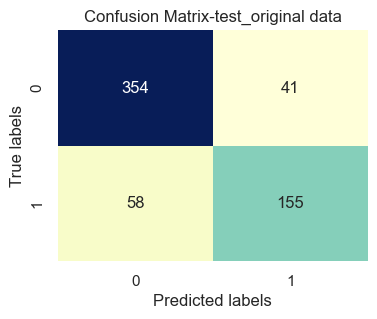

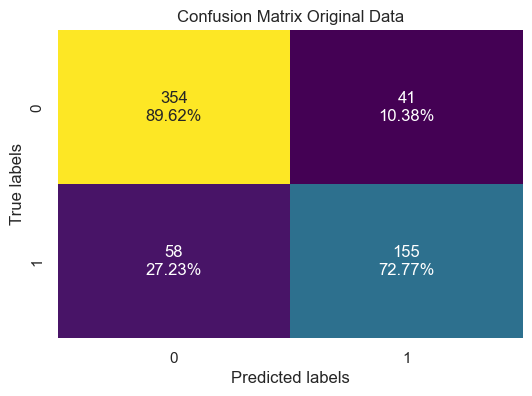

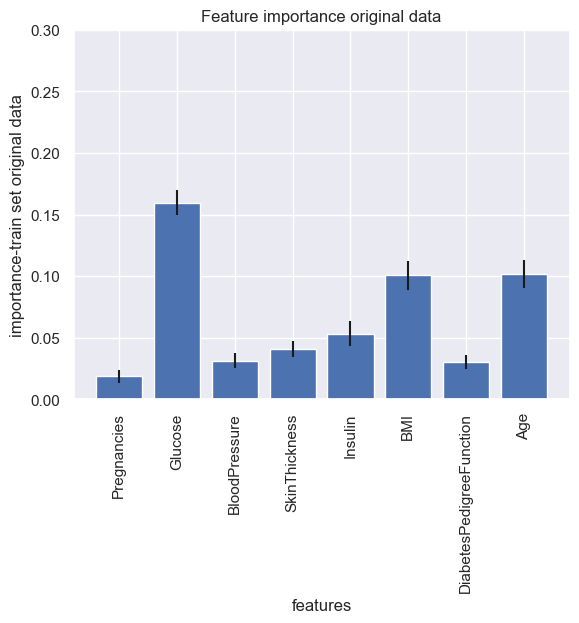

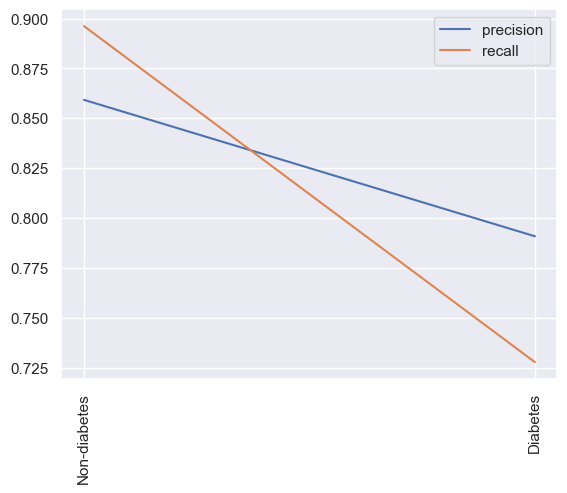

 estimator: 5 depth: 8 test score:0.7254901960784313
 estimator: 5 depth: 8 train score:0.9276315789473685
Accuracy train: 0.9276315789473685
Classification Report-train:
              precision    recall  f1-score   support

         0.0       0.95      0.94      0.94       395
         1.0       0.89      0.90      0.90       213

    accuracy                           0.93       608
   macro avg       0.92      0.92      0.92       608
weighted avg       0.93      0.93      0.93       608



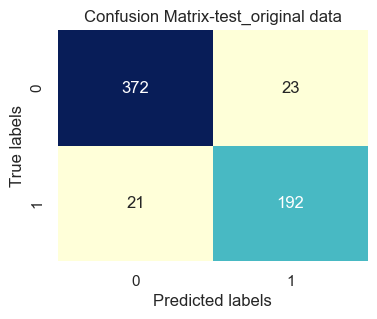

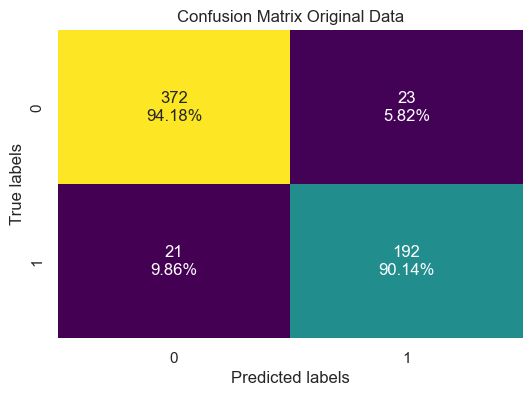

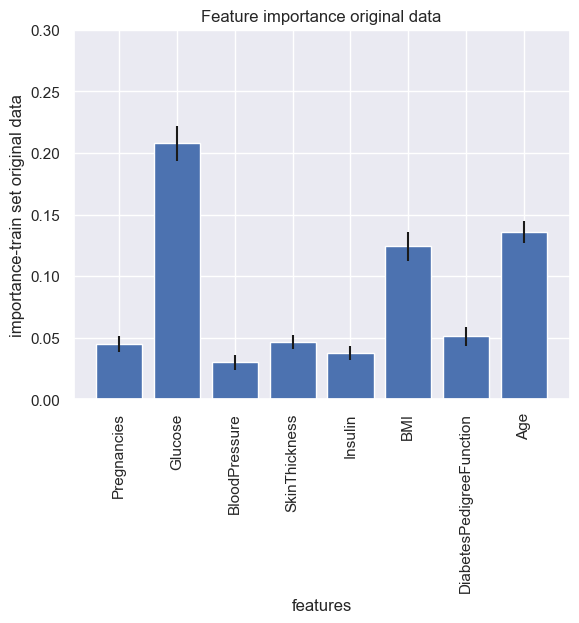

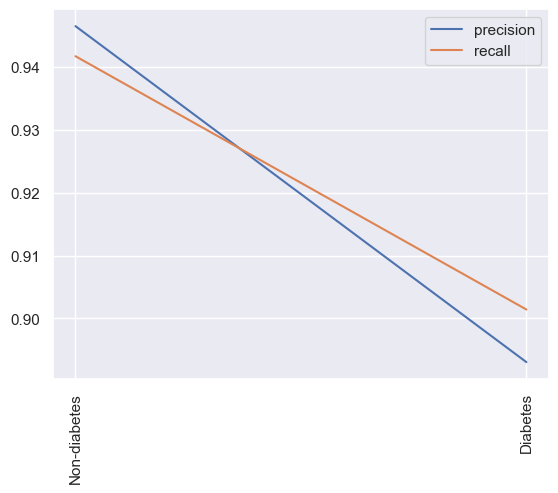

 estimator: 10 depth: 8 test score:0.738562091503268
 estimator: 10 depth: 8 train score:0.9457236842105263
Accuracy train: 0.9457236842105263
Classification Report-train:
              precision    recall  f1-score   support

         0.0       0.95      0.96      0.96       395
         1.0       0.93      0.91      0.92       213

    accuracy                           0.95       608
   macro avg       0.94      0.94      0.94       608
weighted avg       0.95      0.95      0.95       608



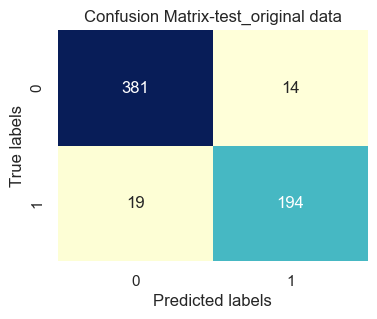

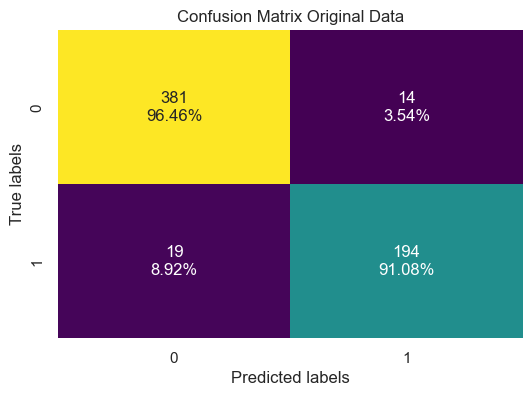

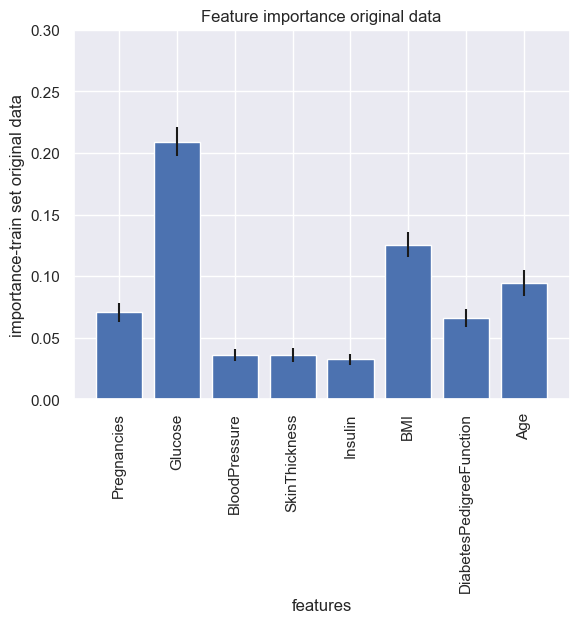

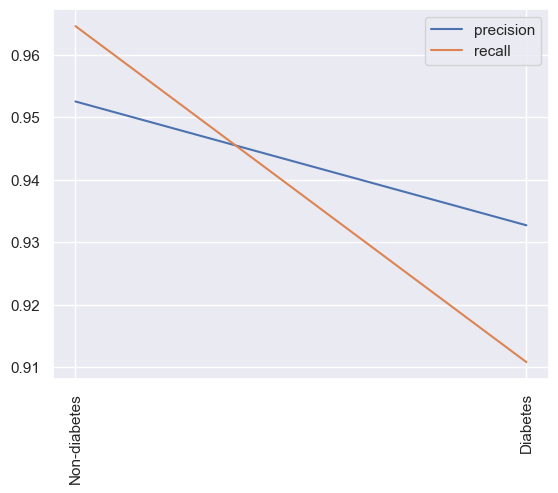

 estimator: 20 depth: 8 test score:0.7712418300653595
 estimator: 20 depth: 8 train score:0.9539473684210527
Accuracy train: 0.9539473684210527
Classification Report-train:
              precision    recall  f1-score   support

         0.0       0.95      0.98      0.97       395
         1.0       0.96      0.91      0.93       213

    accuracy                           0.95       608
   macro avg       0.95      0.94      0.95       608
weighted avg       0.95      0.95      0.95       608



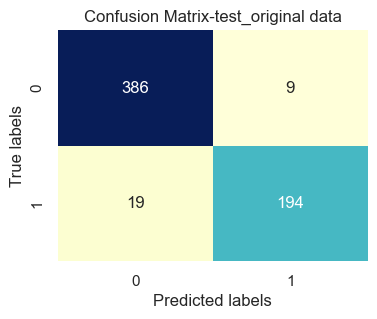

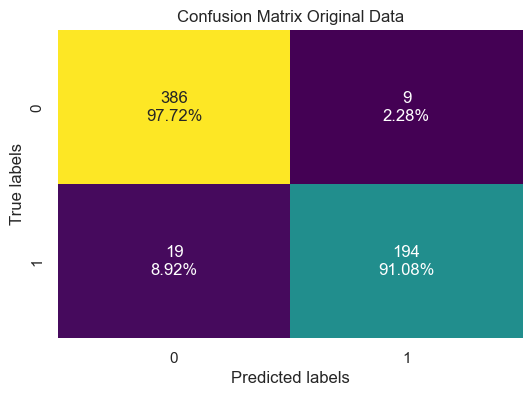

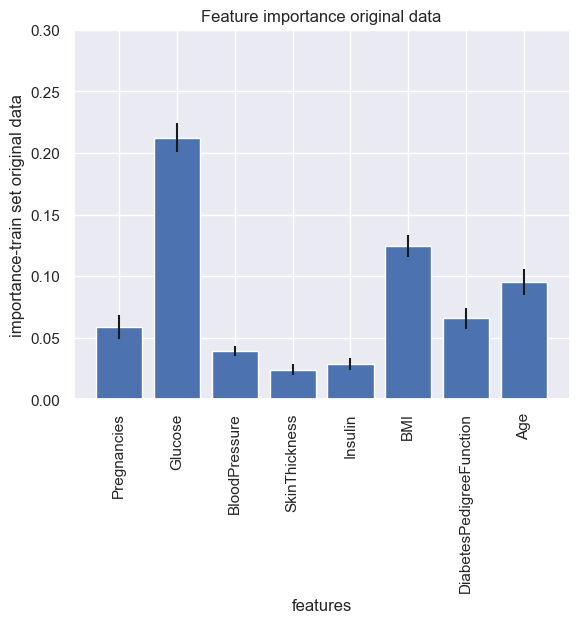

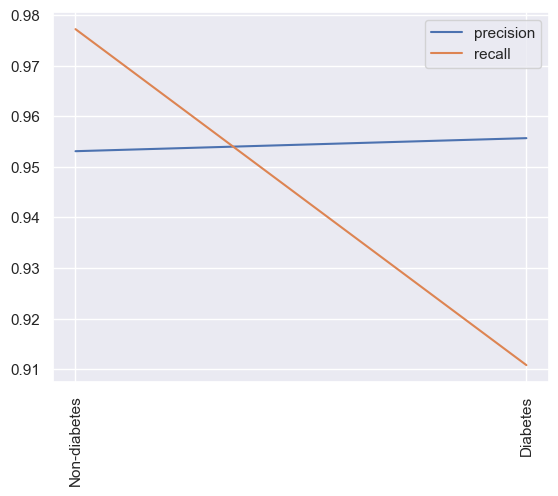

 estimator: 50 depth: 8 test score:0.7450980392156863
 estimator: 50 depth: 8 train score:0.9588815789473685
Accuracy train: 0.9588815789473685
Classification Report-train:
              precision    recall  f1-score   support

         0.0       0.95      0.99      0.97       395
         1.0       0.98      0.90      0.94       213

    accuracy                           0.96       608
   macro avg       0.96      0.95      0.95       608
weighted avg       0.96      0.96      0.96       608



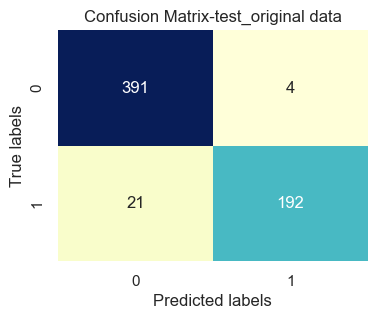

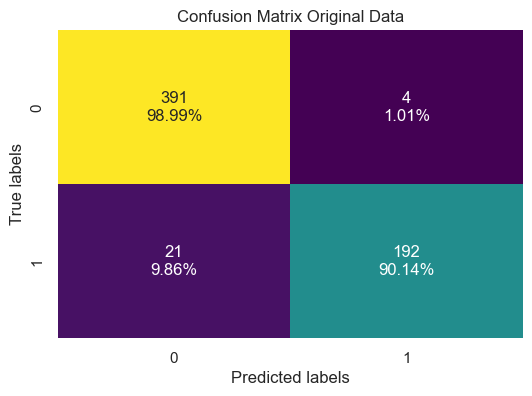

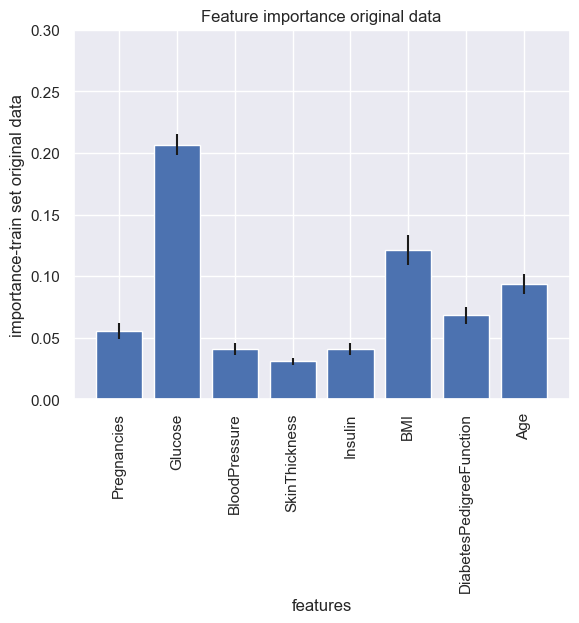

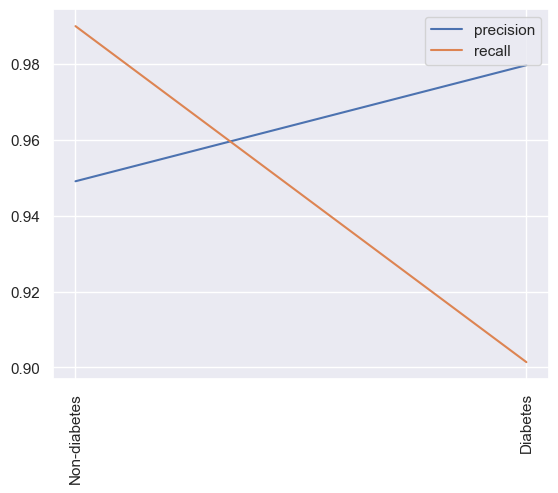

 estimator: 100 depth: 8 test score:0.7647058823529411
 estimator: 100 depth: 8 train score:0.9638157894736842
Accuracy train: 0.9638157894736842
Classification Report-train:
              precision    recall  f1-score   support

         0.0       0.96      0.99      0.97       395
         1.0       0.98      0.92      0.95       213

    accuracy                           0.96       608
   macro avg       0.97      0.95      0.96       608
weighted avg       0.96      0.96      0.96       608



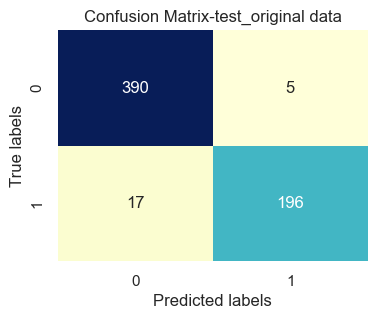

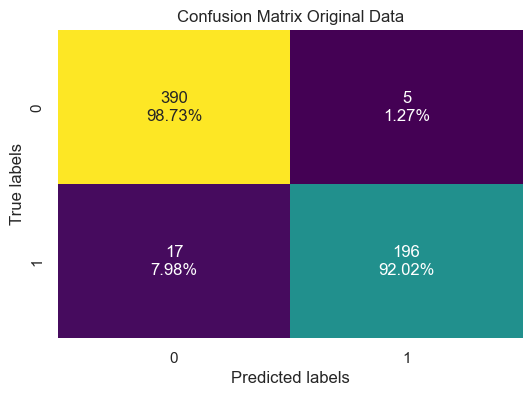

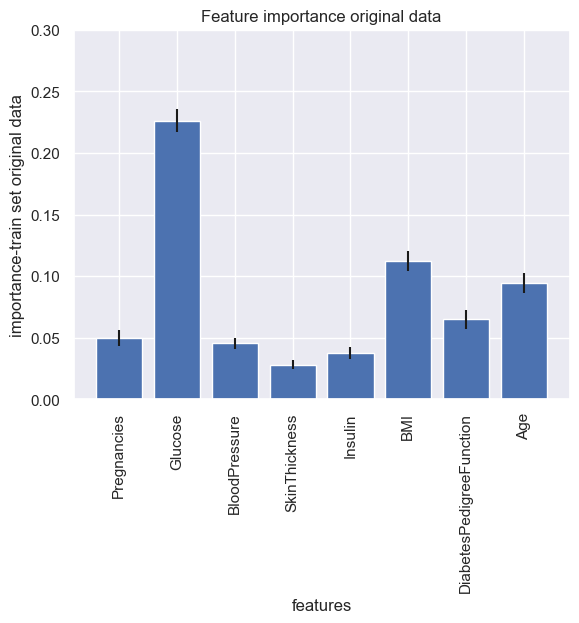

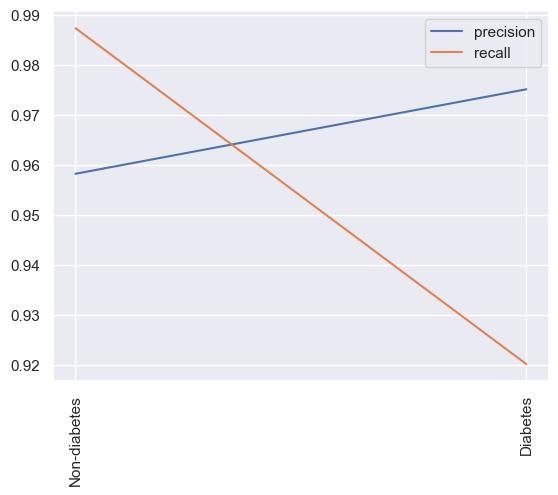

 estimator: 150 depth: 8 test score:0.7712418300653595
 estimator: 150 depth: 8 train score:0.9638157894736842
Accuracy train: 0.9638157894736842
Classification Report-train:
              precision    recall  f1-score   support

         0.0       0.96      0.99      0.97       395
         1.0       0.98      0.92      0.95       213

    accuracy                           0.96       608
   macro avg       0.97      0.95      0.96       608
weighted avg       0.96      0.96      0.96       608



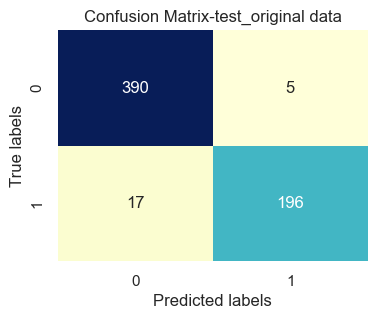

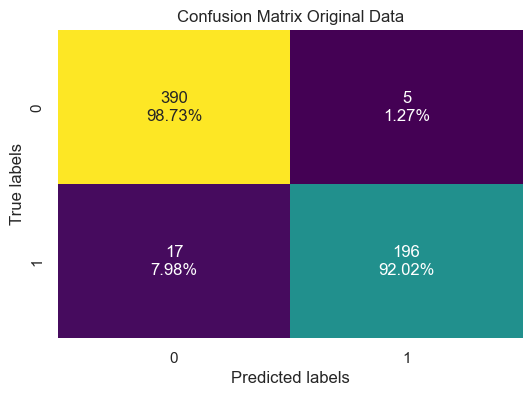

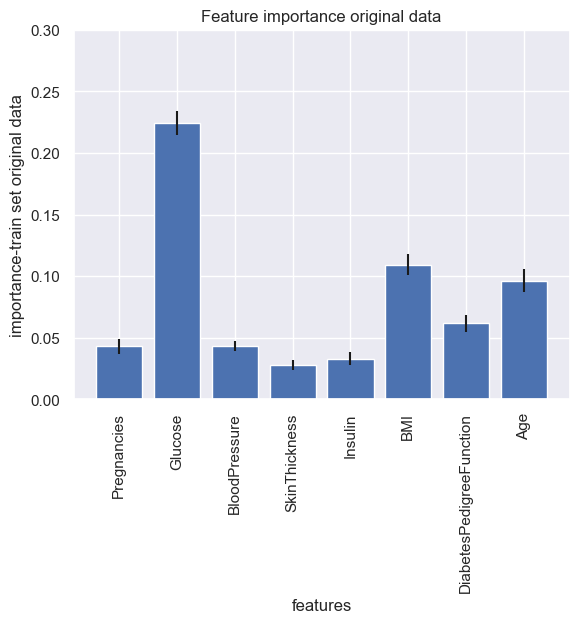

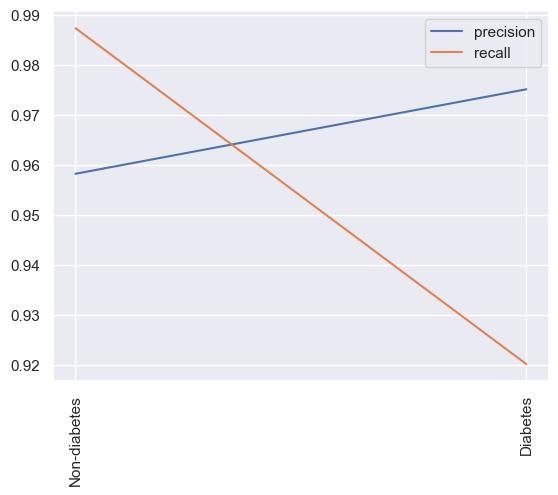

 estimator: 200 depth: 8 test score:0.7712418300653595
 estimator: 200 depth: 8 train score:0.9671052631578947
Accuracy train: 0.9671052631578947
Classification Report-train:
              precision    recall  f1-score   support

         0.0       0.96      0.99      0.97       395
         1.0       0.98      0.93      0.95       213

    accuracy                           0.97       608
   macro avg       0.97      0.96      0.96       608
weighted avg       0.97      0.97      0.97       608



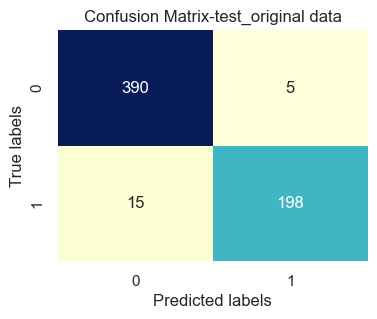

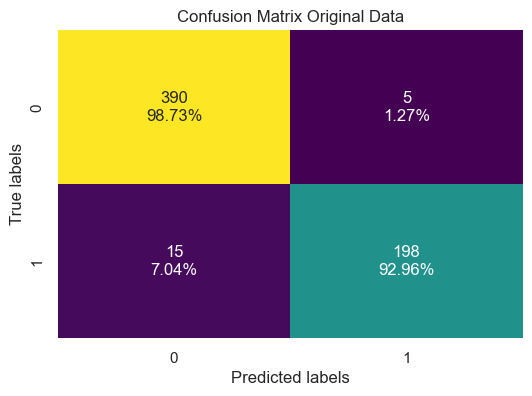

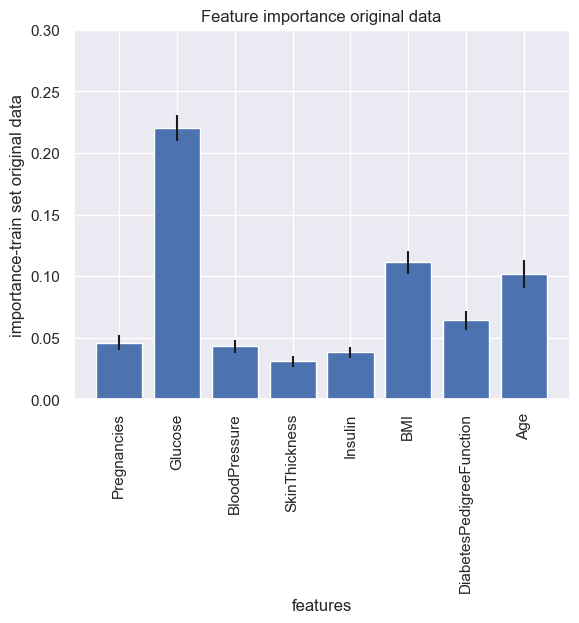

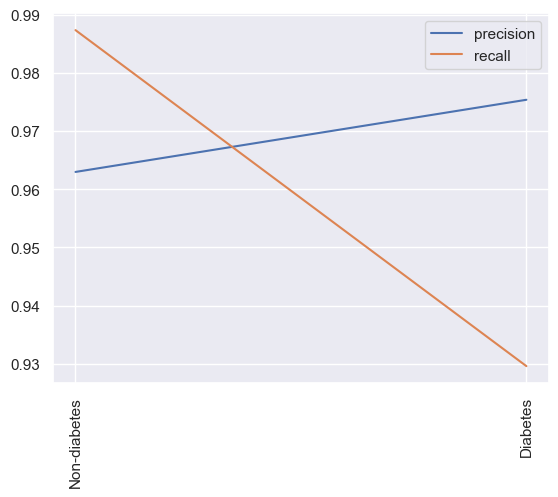

 estimator: 500 depth: 8 test score:0.7516339869281046
 estimator: 500 depth: 8 train score:0.9671052631578947
Accuracy train: 0.9671052631578947
Classification Report-train:
              precision    recall  f1-score   support

         0.0       0.96      0.99      0.98       395
         1.0       0.98      0.92      0.95       213

    accuracy                           0.97       608
   macro avg       0.97      0.96      0.96       608
weighted avg       0.97      0.97      0.97       608



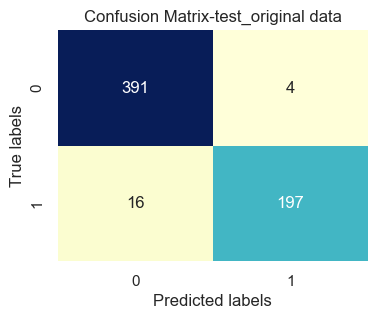

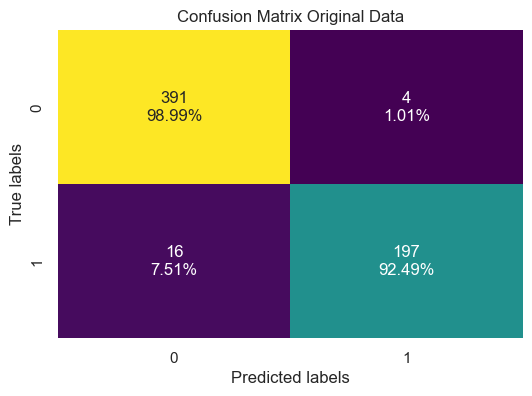

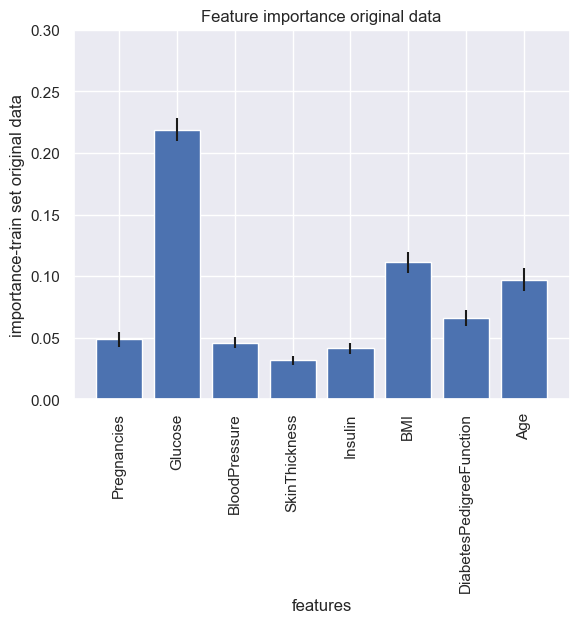

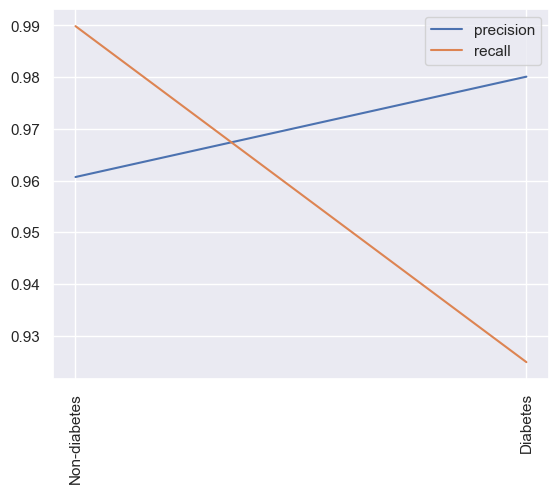

 estimator: 1 depth: 16 test score:0.6601307189542484
 estimator: 1 depth: 16 train score:0.881578947368421
Accuracy train: 0.881578947368421
Classification Report-train:
              precision    recall  f1-score   support

         0.0       0.91      0.90      0.91       395
         1.0       0.82      0.84      0.83       213

    accuracy                           0.88       608
   macro avg       0.87      0.87      0.87       608
weighted avg       0.88      0.88      0.88       608



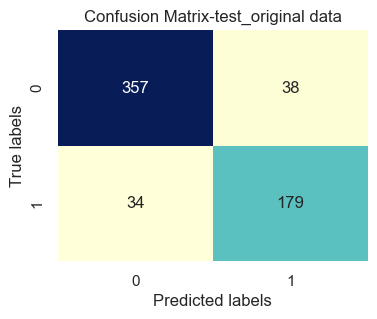

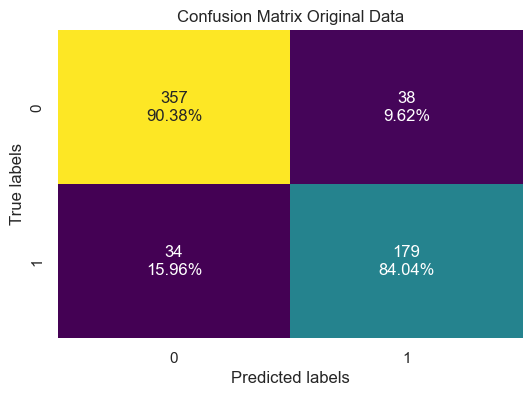

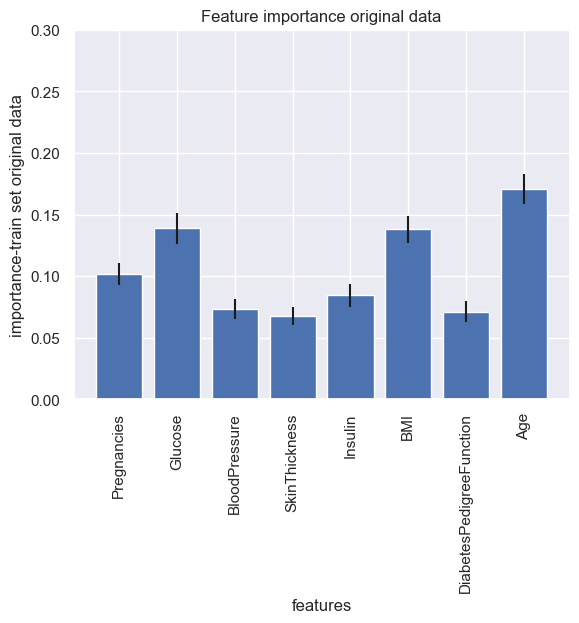

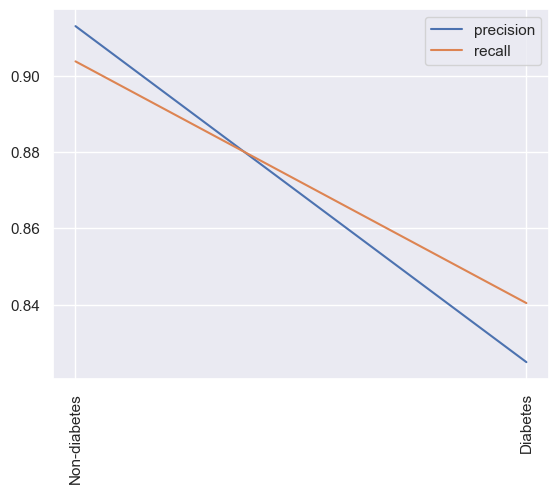

 estimator: 5 depth: 16 test score:0.7189542483660131
 estimator: 5 depth: 16 train score:0.975328947368421
Accuracy train: 0.975328947368421
Classification Report-train:
              precision    recall  f1-score   support

         0.0       0.97      0.99      0.98       395
         1.0       0.99      0.94      0.96       213

    accuracy                           0.98       608
   macro avg       0.98      0.97      0.97       608
weighted avg       0.98      0.98      0.98       608



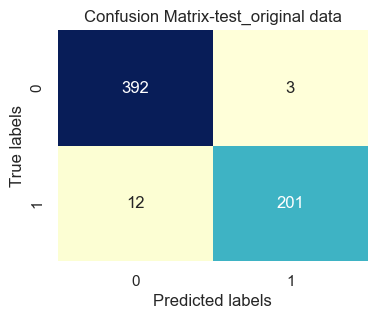

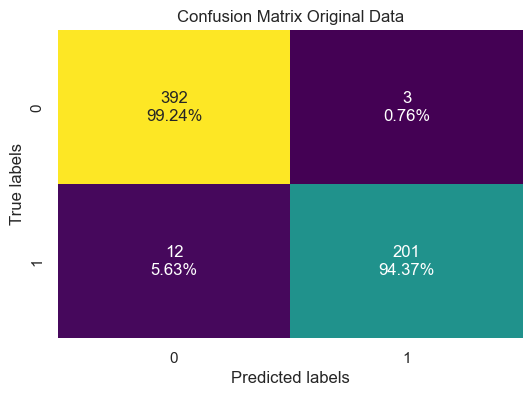

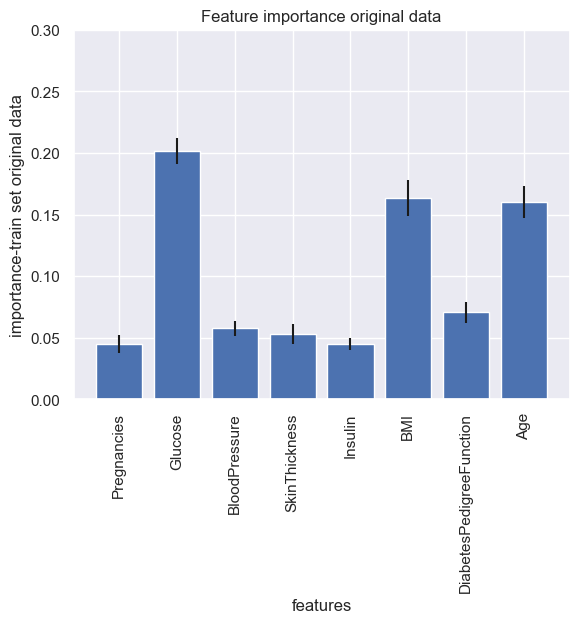

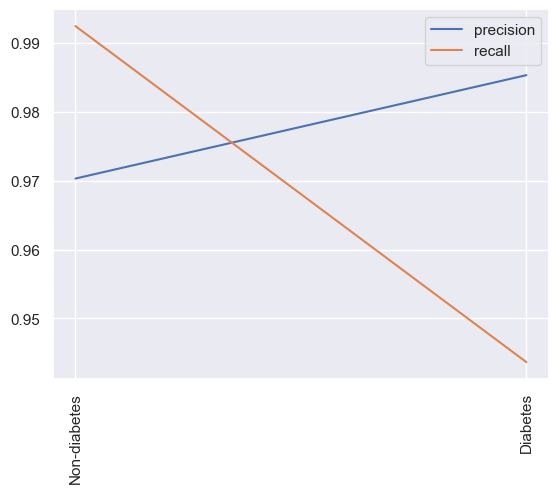

 estimator: 10 depth: 16 test score:0.7320261437908496
 estimator: 10 depth: 16 train score:0.9901315789473685
Accuracy train: 0.9901315789473685
Classification Report-train:
              precision    recall  f1-score   support

         0.0       0.99      1.00      0.99       395
         1.0       1.00      0.97      0.99       213

    accuracy                           0.99       608
   macro avg       0.99      0.99      0.99       608
weighted avg       0.99      0.99      0.99       608



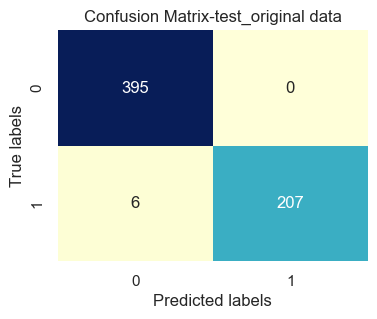

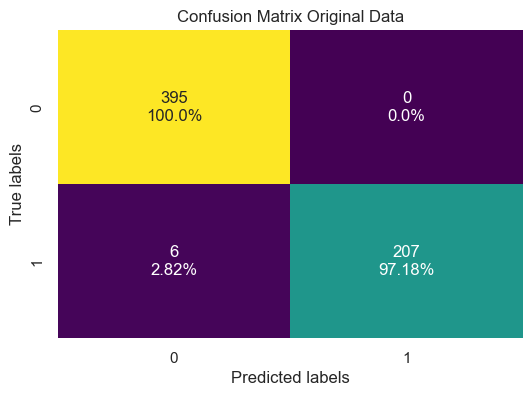

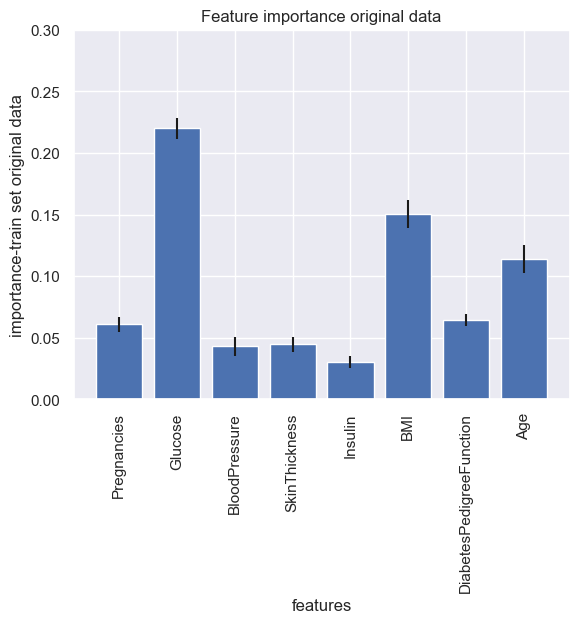

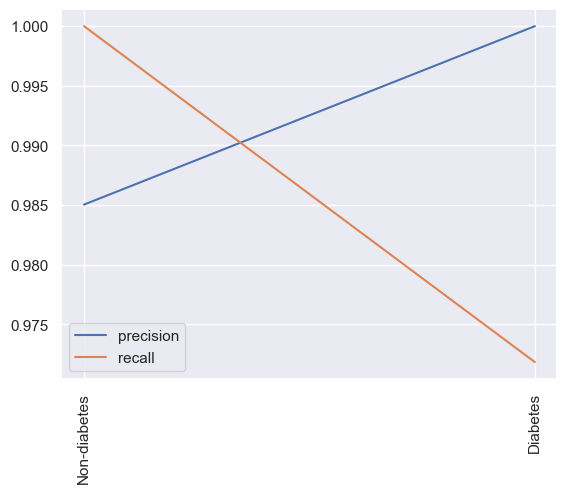

 estimator: 20 depth: 16 test score:0.7450980392156863
 estimator: 20 depth: 16 train score:1.0
Accuracy train: 1.0
Classification Report-train:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       395
         1.0       1.00      1.00      1.00       213

    accuracy                           1.00       608
   macro avg       1.00      1.00      1.00       608
weighted avg       1.00      1.00      1.00       608



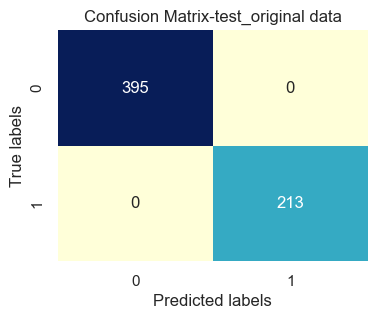

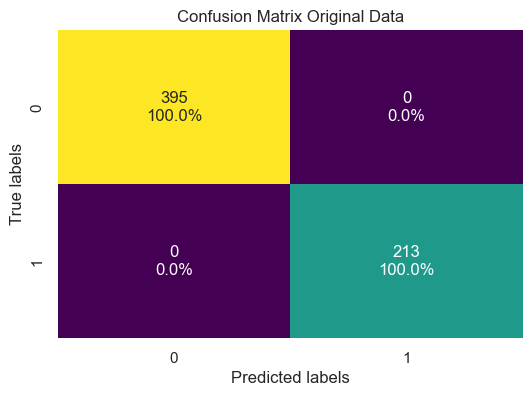

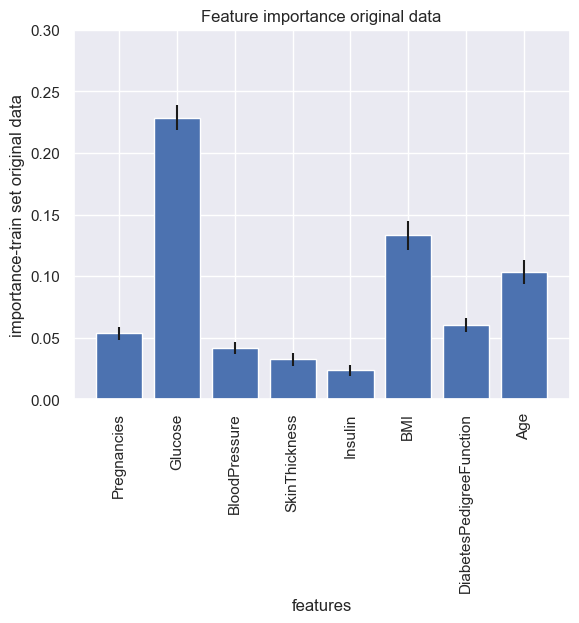

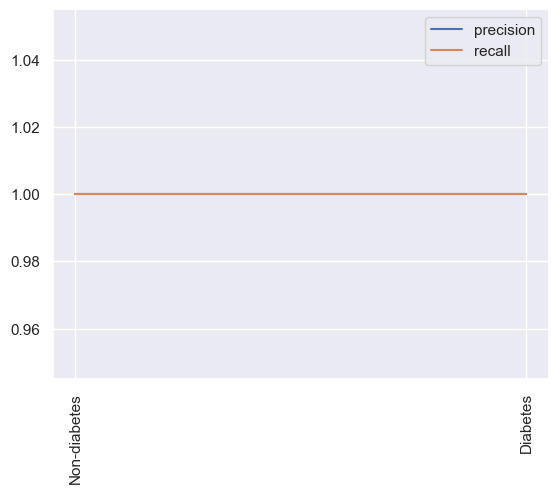

 estimator: 50 depth: 16 test score:0.7581699346405228
 estimator: 50 depth: 16 train score:1.0
Accuracy train: 1.0
Classification Report-train:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       395
         1.0       1.00      1.00      1.00       213

    accuracy                           1.00       608
   macro avg       1.00      1.00      1.00       608
weighted avg       1.00      1.00      1.00       608



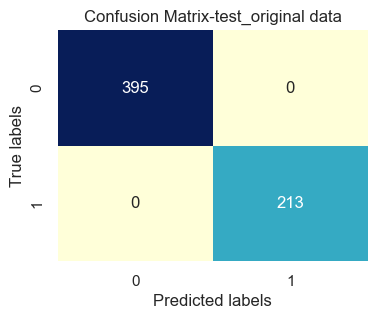

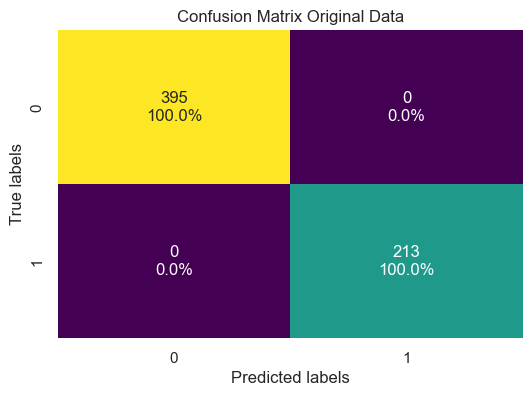

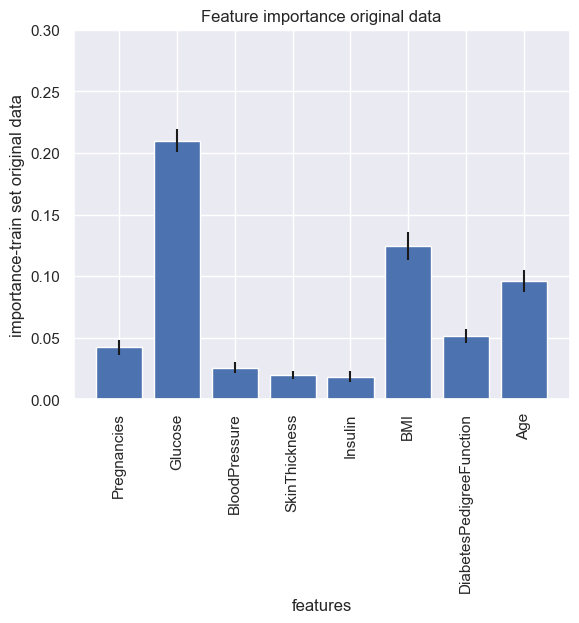

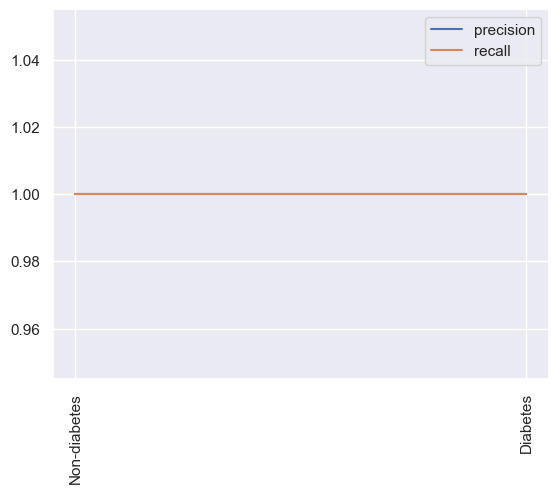

 estimator: 100 depth: 16 test score:0.7647058823529411
 estimator: 100 depth: 16 train score:1.0
Accuracy train: 1.0
Classification Report-train:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       395
         1.0       1.00      1.00      1.00       213

    accuracy                           1.00       608
   macro avg       1.00      1.00      1.00       608
weighted avg       1.00      1.00      1.00       608



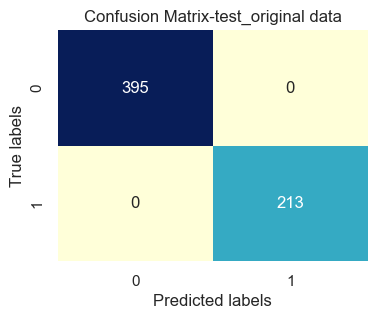

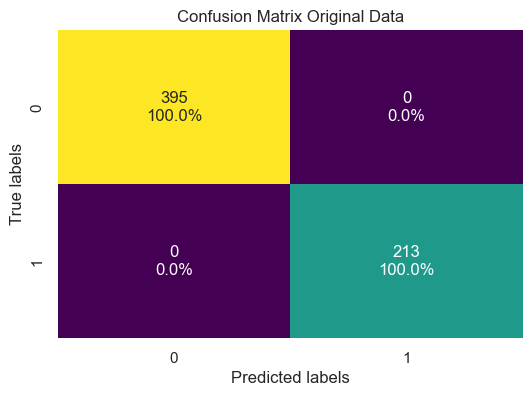

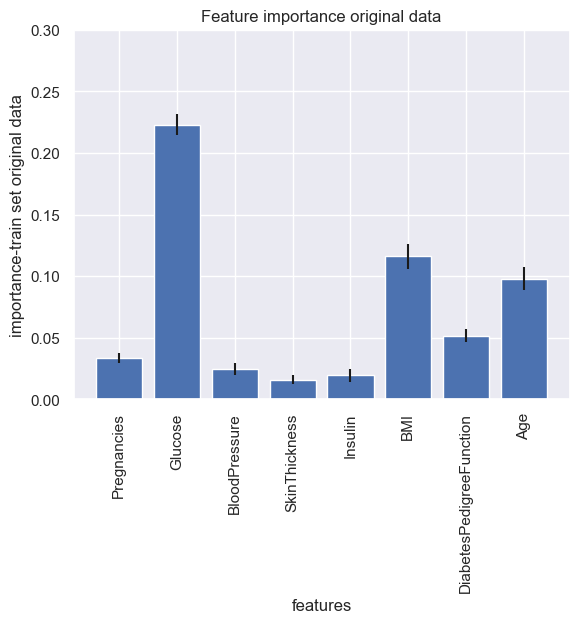

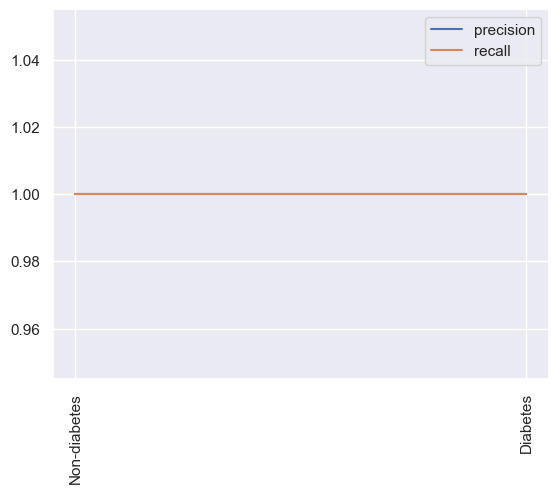

 estimator: 150 depth: 16 test score:0.7712418300653595
 estimator: 150 depth: 16 train score:1.0
Accuracy train: 1.0
Classification Report-train:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       395
         1.0       1.00      1.00      1.00       213

    accuracy                           1.00       608
   macro avg       1.00      1.00      1.00       608
weighted avg       1.00      1.00      1.00       608



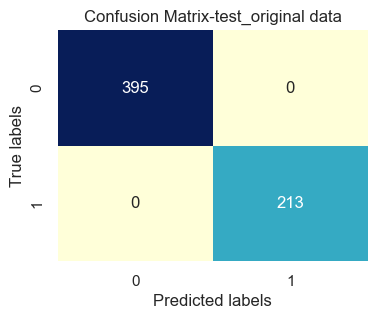

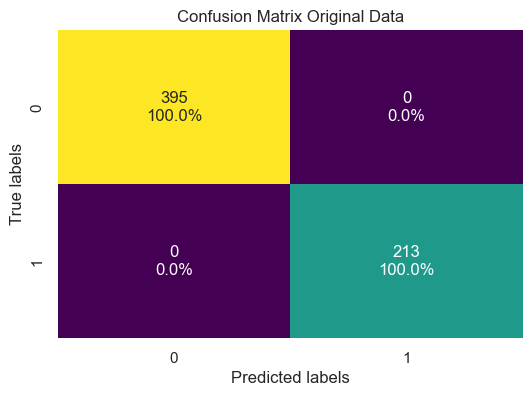

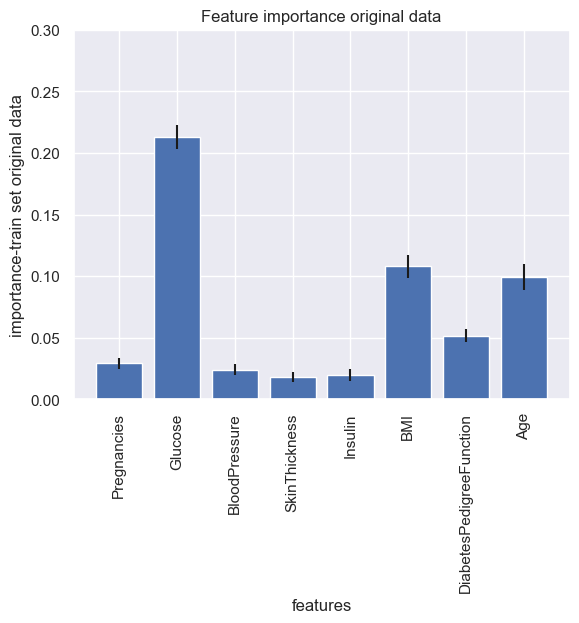

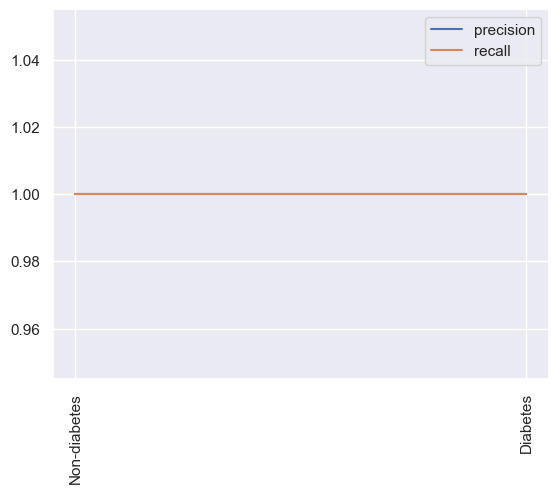

 estimator: 200 depth: 16 test score:0.7777777777777778
 estimator: 200 depth: 16 train score:1.0
Accuracy train: 1.0
Classification Report-train:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       395
         1.0       1.00      1.00      1.00       213

    accuracy                           1.00       608
   macro avg       1.00      1.00      1.00       608
weighted avg       1.00      1.00      1.00       608



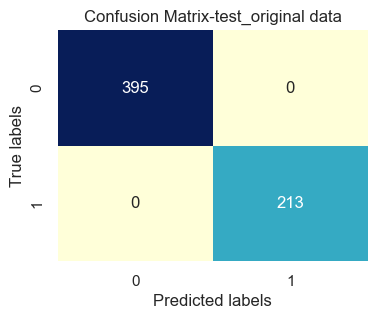

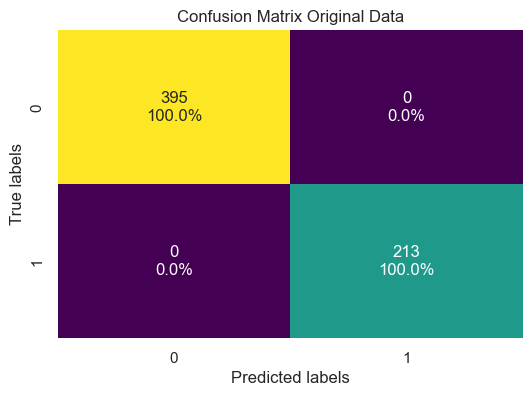

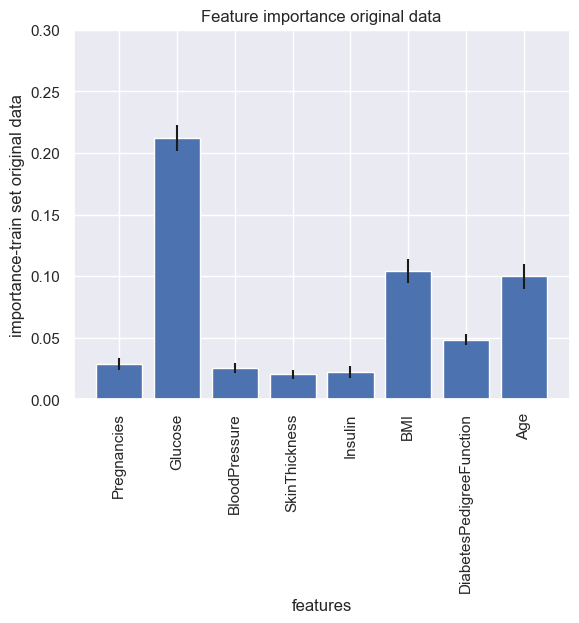

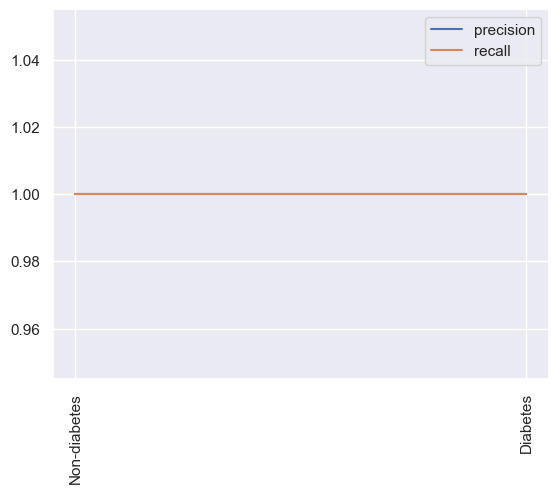

 estimator: 500 depth: 16 test score:0.7647058823529411
 estimator: 500 depth: 16 train score:1.0
Accuracy train: 1.0
Classification Report-train:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       395
         1.0       1.00      1.00      1.00       213

    accuracy                           1.00       608
   macro avg       1.00      1.00      1.00       608
weighted avg       1.00      1.00      1.00       608



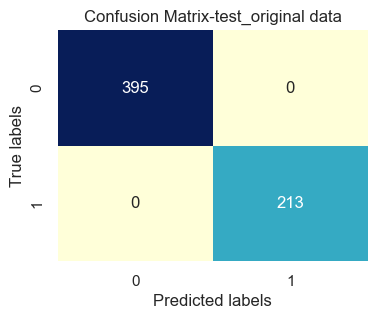

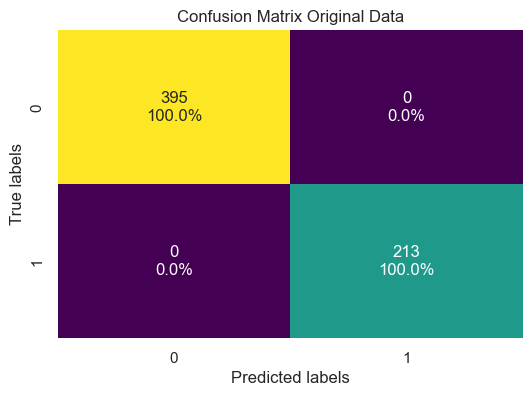

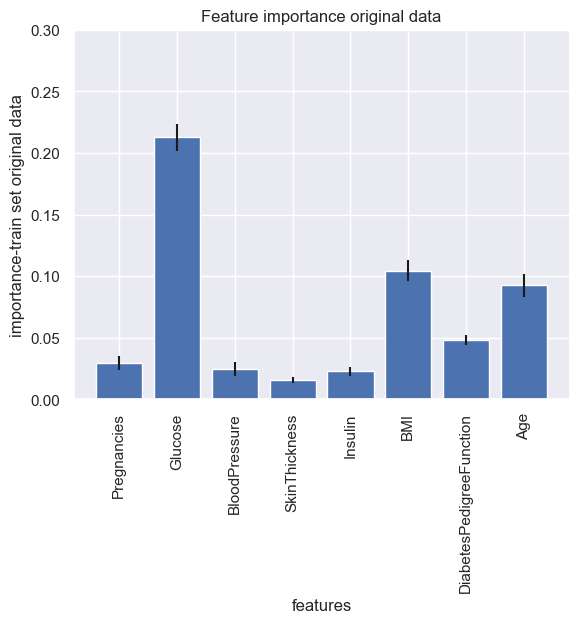

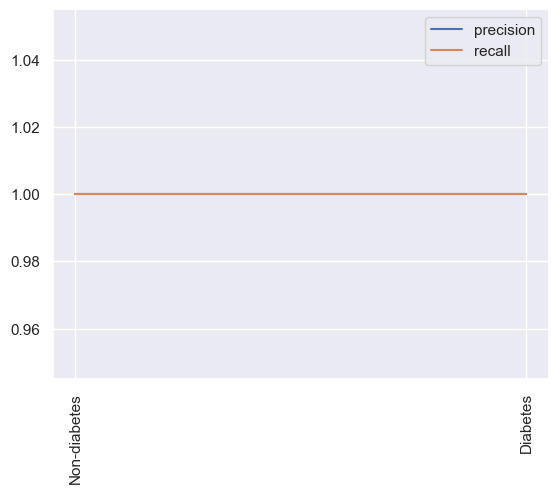

 estimator: 1 depth: 20 test score:0.6601307189542484
 estimator: 1 depth: 20 train score:0.881578947368421
Accuracy train: 0.881578947368421
Classification Report-train:
              precision    recall  f1-score   support

         0.0       0.91      0.90      0.91       395
         1.0       0.82      0.84      0.83       213

    accuracy                           0.88       608
   macro avg       0.87      0.87      0.87       608
weighted avg       0.88      0.88      0.88       608



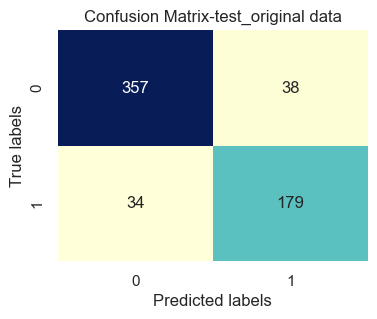

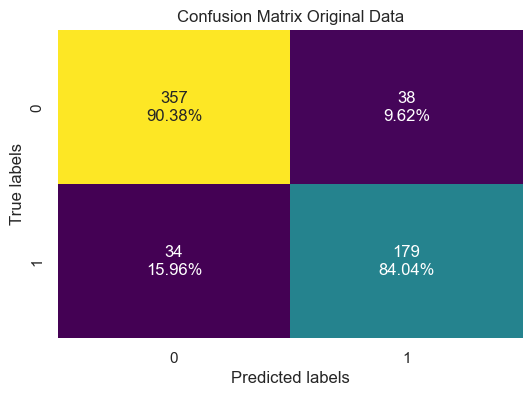

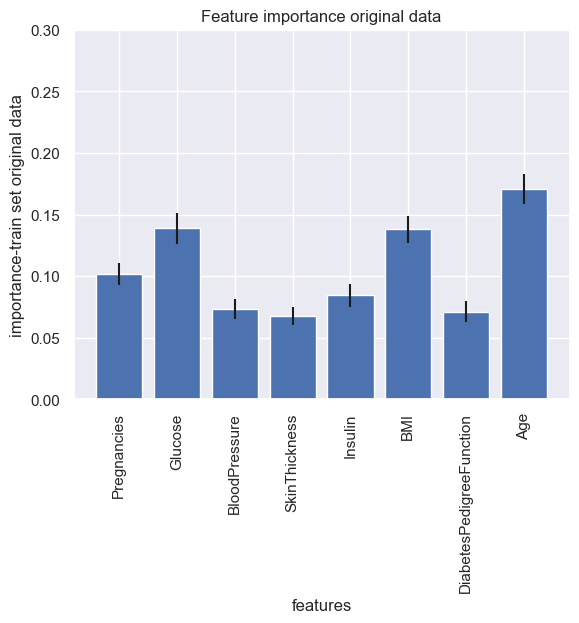

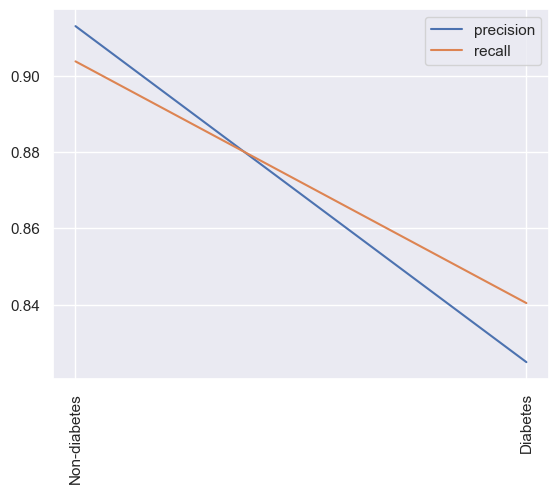

 estimator: 5 depth: 20 test score:0.7189542483660131
 estimator: 5 depth: 20 train score:0.975328947368421
Accuracy train: 0.975328947368421
Classification Report-train:
              precision    recall  f1-score   support

         0.0       0.97      0.99      0.98       395
         1.0       0.99      0.94      0.96       213

    accuracy                           0.98       608
   macro avg       0.98      0.97      0.97       608
weighted avg       0.98      0.98      0.98       608



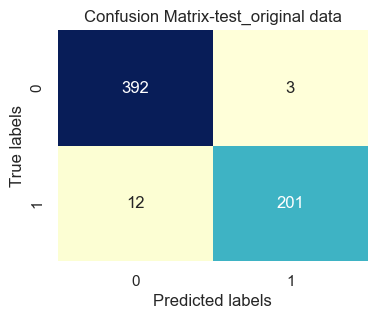

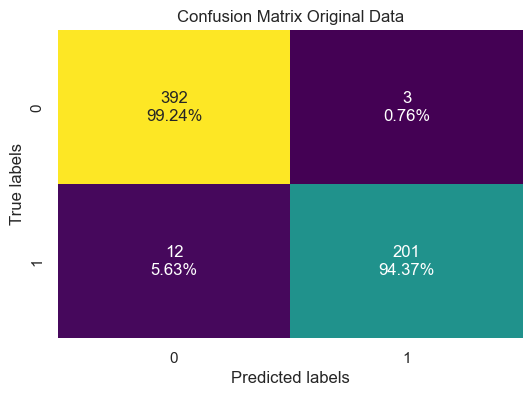

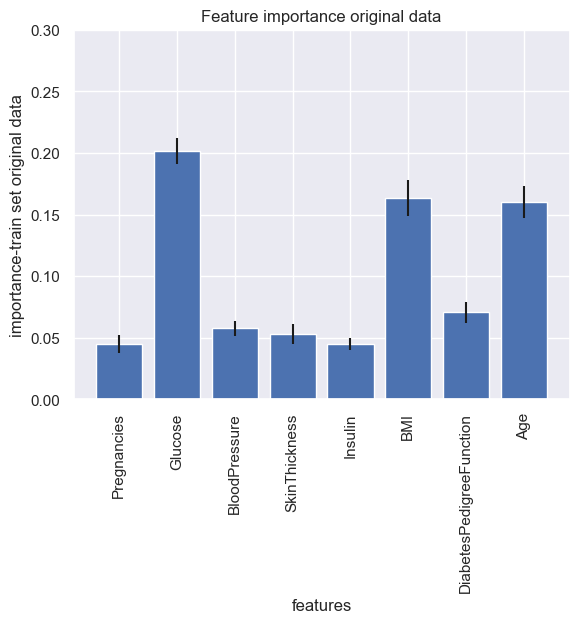

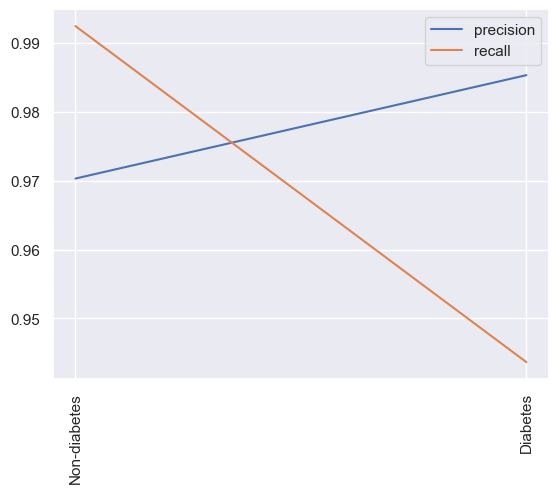

 estimator: 10 depth: 20 test score:0.7320261437908496
 estimator: 10 depth: 20 train score:0.9901315789473685
Accuracy train: 0.9901315789473685
Classification Report-train:
              precision    recall  f1-score   support

         0.0       0.99      1.00      0.99       395
         1.0       1.00      0.97      0.99       213

    accuracy                           0.99       608
   macro avg       0.99      0.99      0.99       608
weighted avg       0.99      0.99      0.99       608



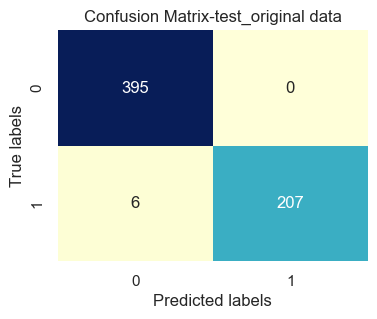

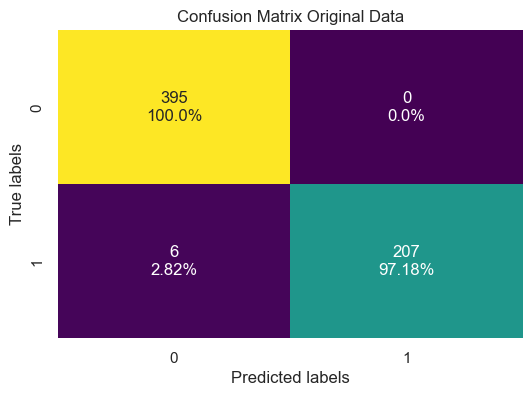

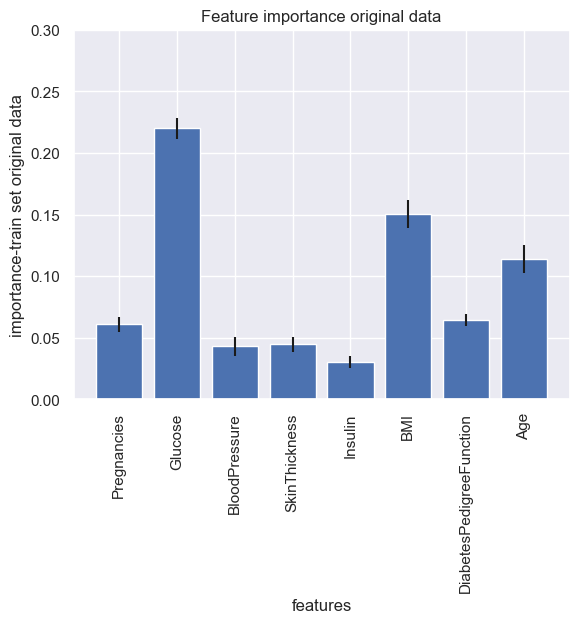

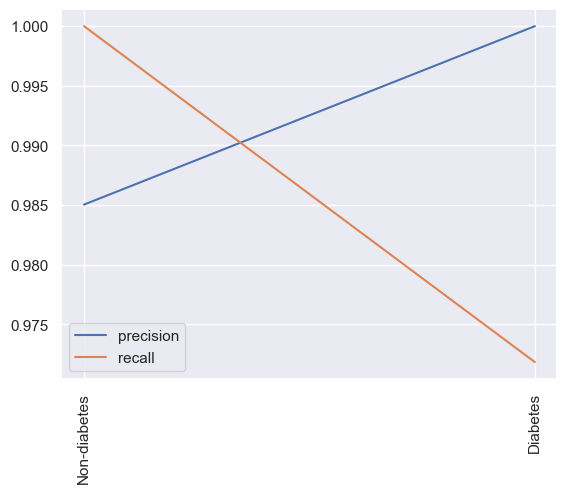

 estimator: 20 depth: 20 test score:0.7516339869281046
 estimator: 20 depth: 20 train score:1.0
Accuracy train: 1.0
Classification Report-train:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       395
         1.0       1.00      1.00      1.00       213

    accuracy                           1.00       608
   macro avg       1.00      1.00      1.00       608
weighted avg       1.00      1.00      1.00       608



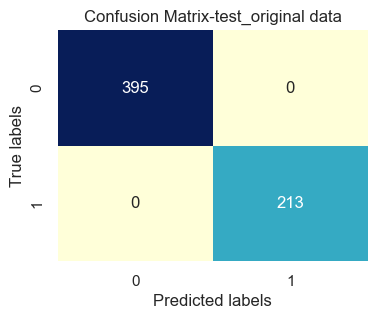

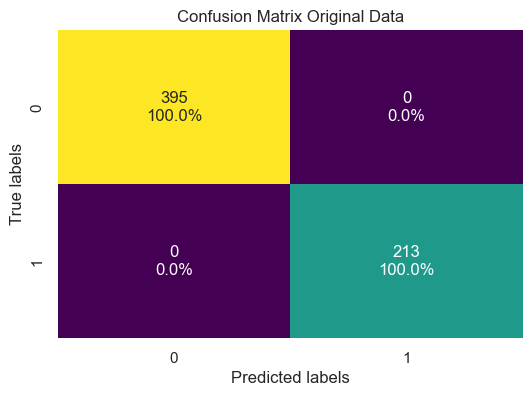

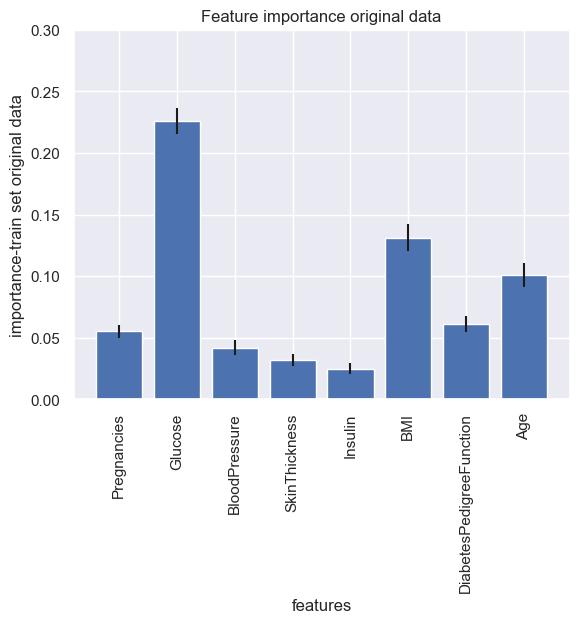

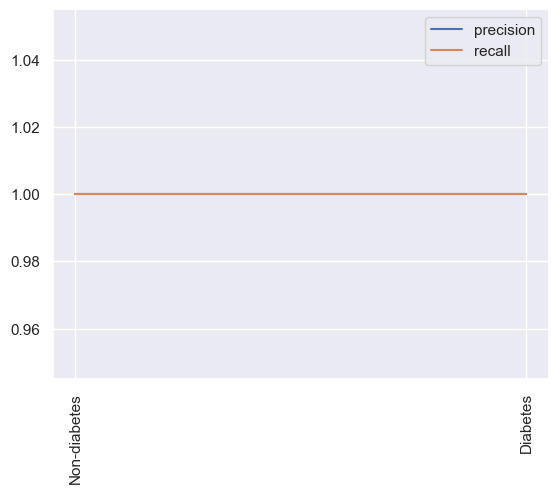

 estimator: 50 depth: 20 test score:0.7581699346405228
 estimator: 50 depth: 20 train score:1.0
Accuracy train: 1.0
Classification Report-train:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       395
         1.0       1.00      1.00      1.00       213

    accuracy                           1.00       608
   macro avg       1.00      1.00      1.00       608
weighted avg       1.00      1.00      1.00       608



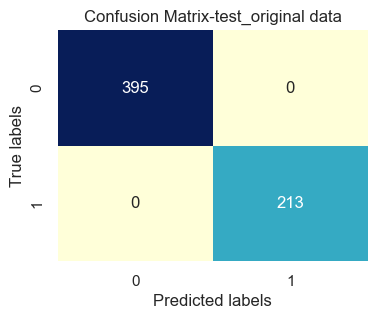

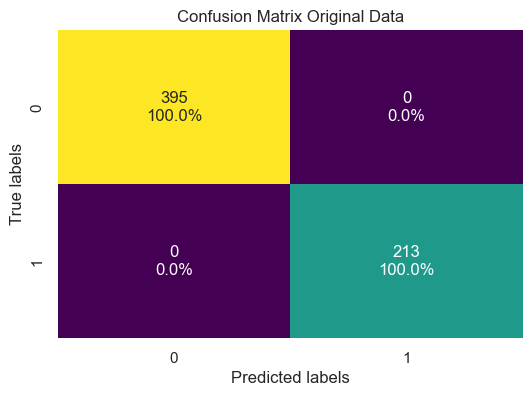

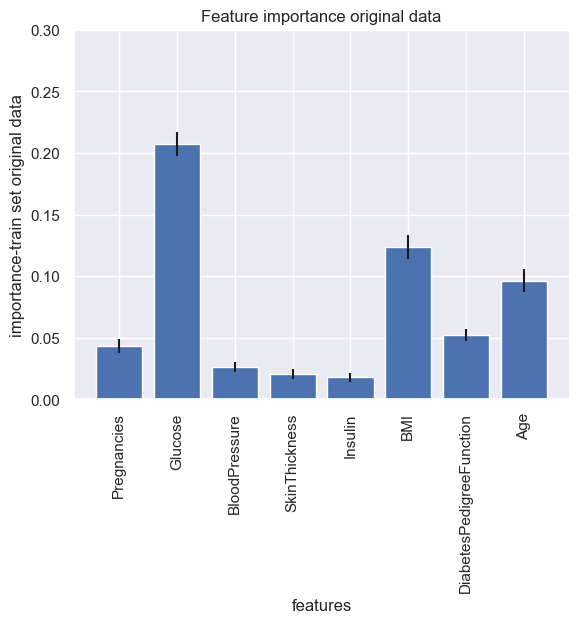

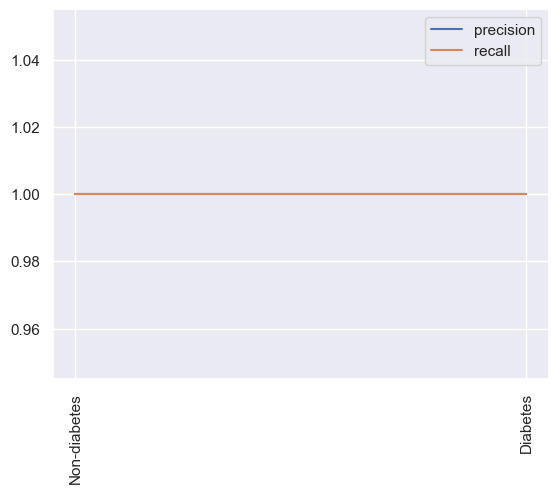

 estimator: 100 depth: 20 test score:0.7581699346405228
 estimator: 100 depth: 20 train score:1.0
Accuracy train: 1.0
Classification Report-train:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       395
         1.0       1.00      1.00      1.00       213

    accuracy                           1.00       608
   macro avg       1.00      1.00      1.00       608
weighted avg       1.00      1.00      1.00       608



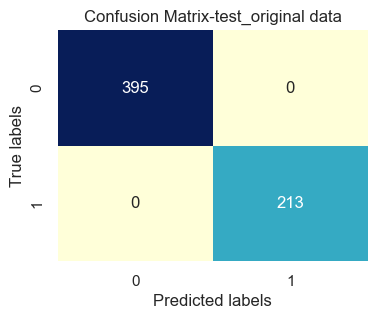

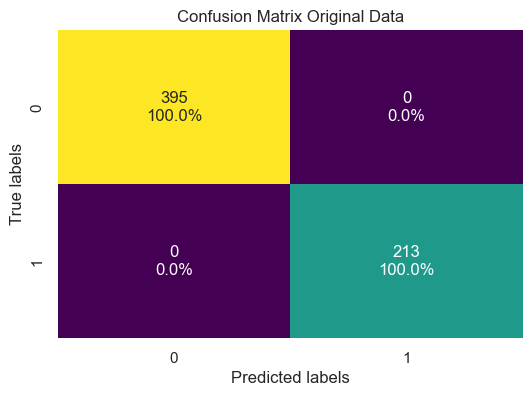

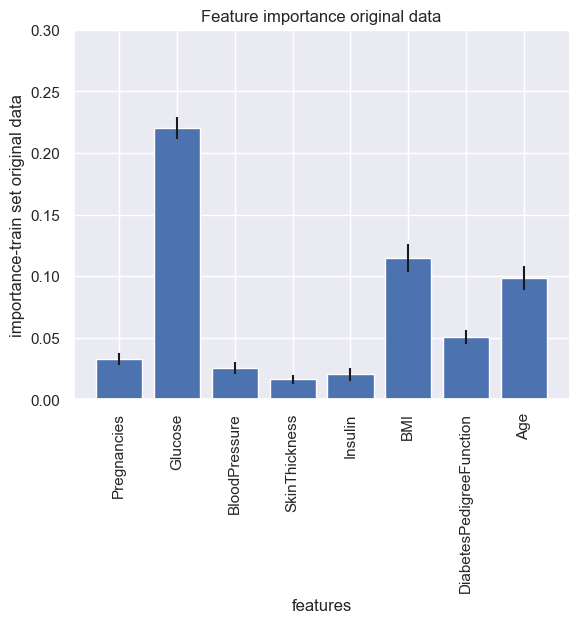

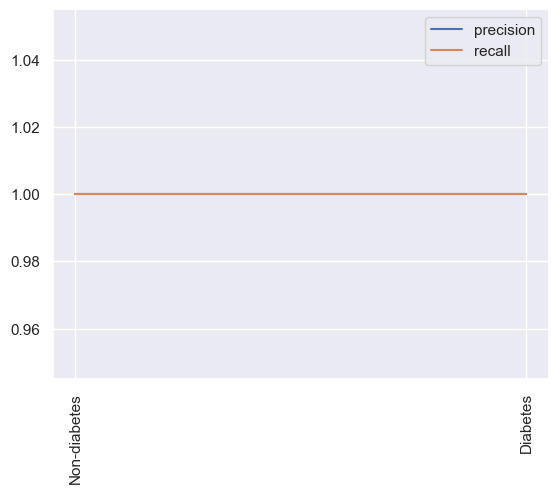

 estimator: 150 depth: 20 test score:0.7777777777777778
 estimator: 150 depth: 20 train score:1.0
Accuracy train: 1.0
Classification Report-train:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       395
         1.0       1.00      1.00      1.00       213

    accuracy                           1.00       608
   macro avg       1.00      1.00      1.00       608
weighted avg       1.00      1.00      1.00       608



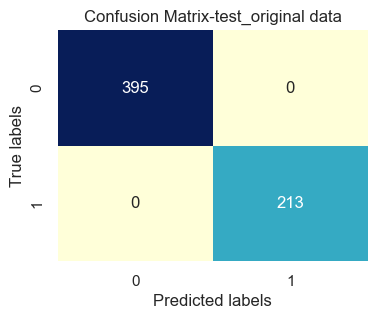

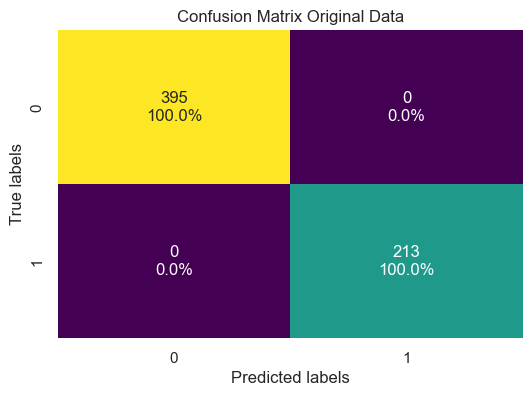

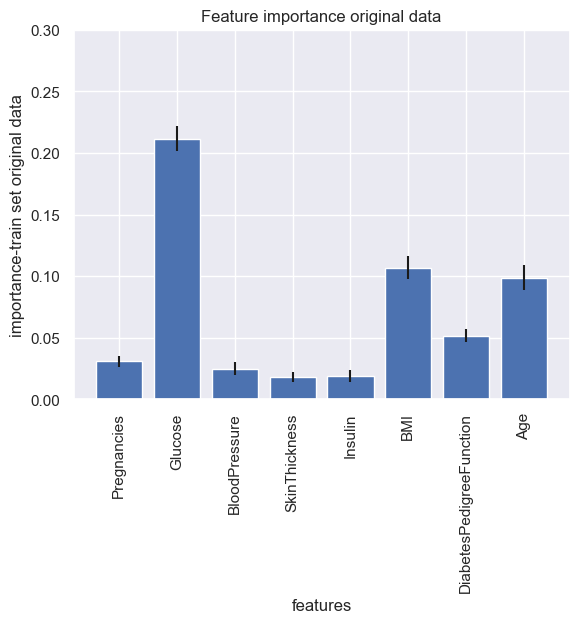

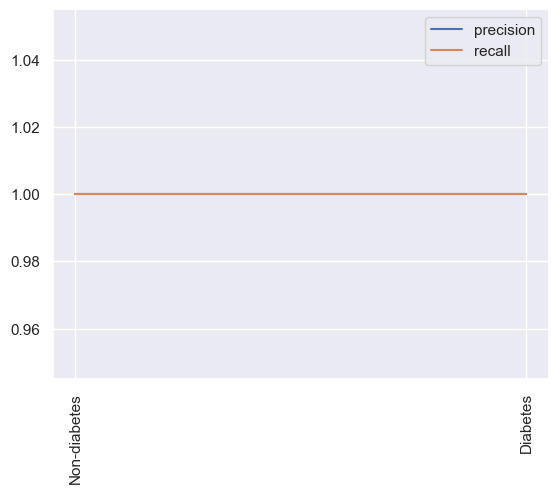

 estimator: 200 depth: 20 test score:0.7777777777777778
 estimator: 200 depth: 20 train score:1.0
Accuracy train: 1.0
Classification Report-train:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       395
         1.0       1.00      1.00      1.00       213

    accuracy                           1.00       608
   macro avg       1.00      1.00      1.00       608
weighted avg       1.00      1.00      1.00       608



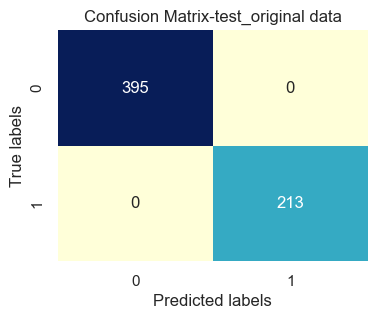

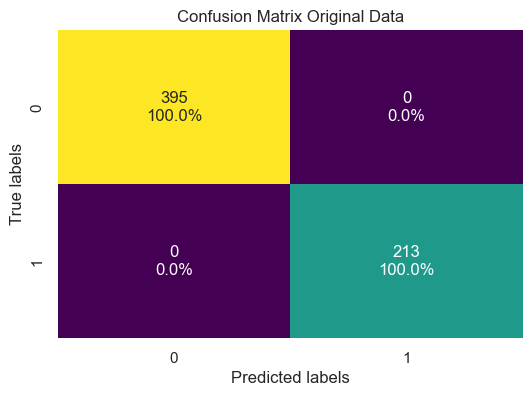

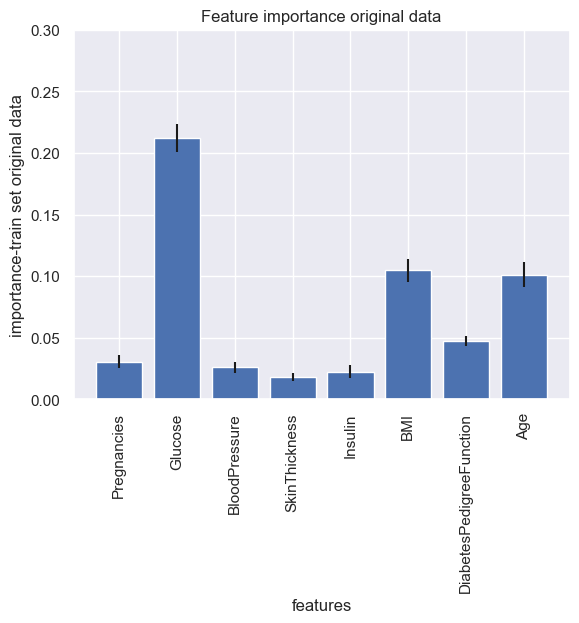

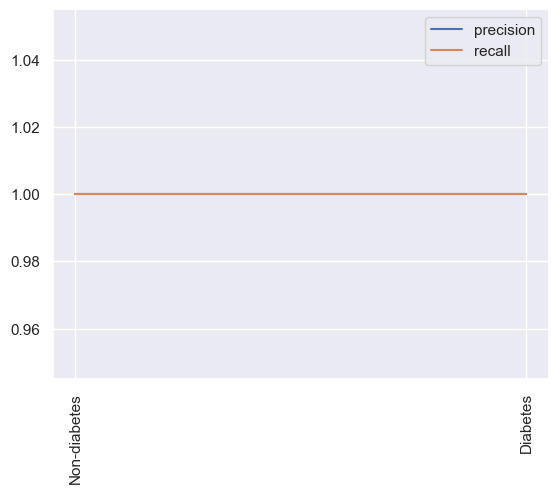

 estimator: 500 depth: 20 test score:0.7712418300653595
 estimator: 500 depth: 20 train score:1.0
Accuracy train: 1.0
Classification Report-train:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       395
         1.0       1.00      1.00      1.00       213

    accuracy                           1.00       608
   macro avg       1.00      1.00      1.00       608
weighted avg       1.00      1.00      1.00       608



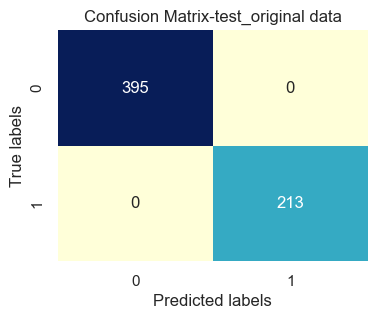

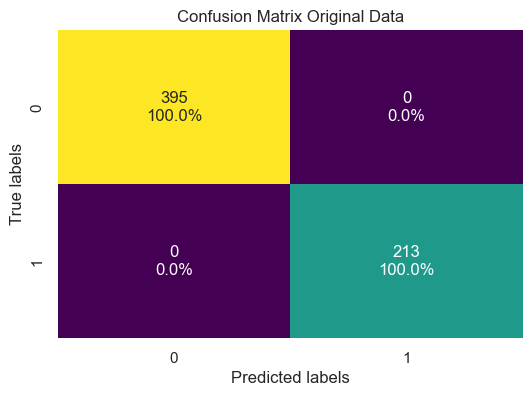

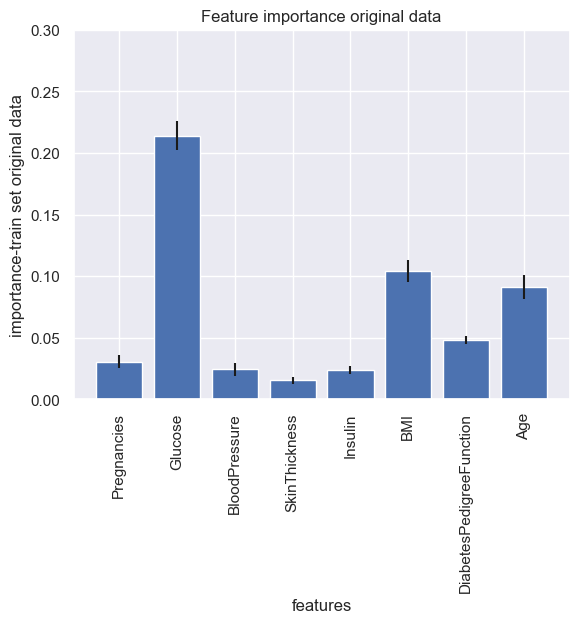

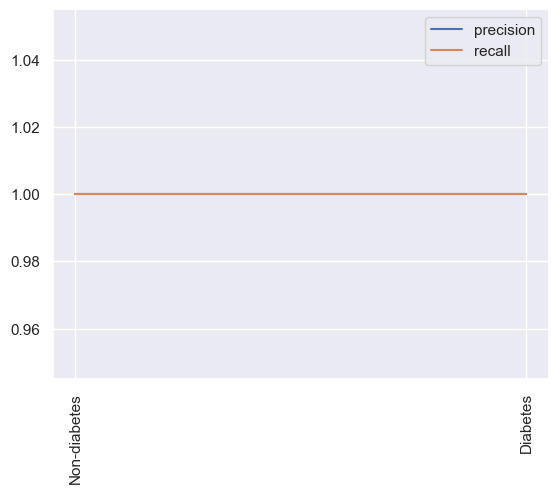

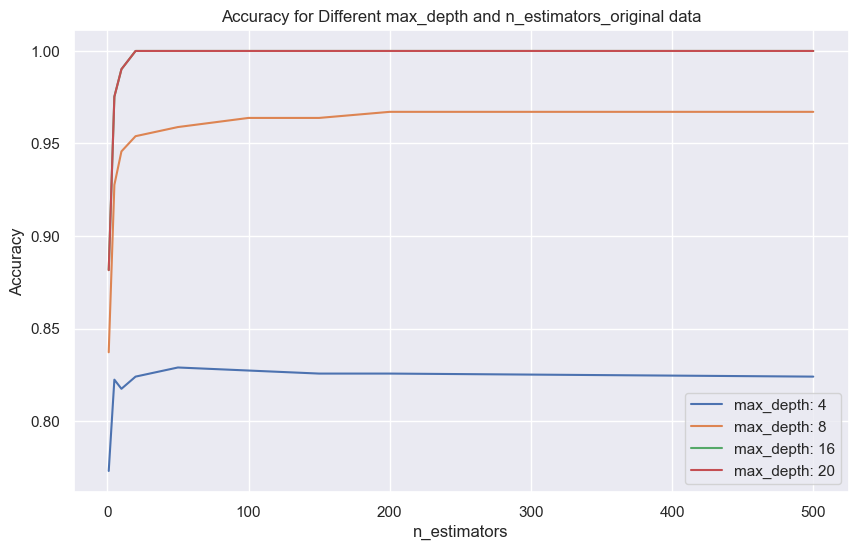

In [82]:
# confusion  matrixes train set

from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

accuracies =[]
for m_deph in (4,8,16,20):
    acc_row =[]
    for n_est in (1, 5, 10,20, 50,100,150,200,500): #we are changing the number of estimatores to check
#for n_est in [100]:
# do fit
      rfc= ensemble.RandomForestClassifier(max_depth=m_deph, n_estimators=n_est,random_state=42)
      rfc.fit(x_train, y_train)
   # test different paramethers and take the one that gives the best aqurancy at the end.
    # print the training scores
      print(f' estimator: {n_est} depth: {m_deph} test score:{(rfc.score(x_test, y_test))}')
      print(f' estimator: {n_est} depth: {m_deph} train score:{(rfc.score(x_train, y_train))}')
      y_pred_test = rfc.predict(x_test)
      y_pred_train = rfc.predict(x_train)
    #print(y_pred_test)
       #Evaluate the classifier
      accuracy = accuracy_score(y_train, y_pred_train)
      print(f'Accuracy train: {accuracy}')
      acc_row.append(accuracy) 
    
    # Print classification report and confusion matrix
      print("Classification Report-train:")
      print(classification_report(y_train, y_pred_train))

      #print("Confusion Matrix:")
      #print(confusion_matrix(y_test, y_pred_test))
    
      cm = confusion_matrix(y_train, y_pred_train)

    # Display the confusion matrix
      plt.figure(figsize=(4, 3))
      sns.heatmap(cm, annot=True, fmt='d', cmap='YlGnBu', cbar=False)
      plt.xlabel('Predicted labels')
      plt.ylabel('True labels')
      plt.title('Confusion Matrix-test_original data')
      plt.show()
    
    
    
    # Display the confusion matrix with values and percentages
      cm_sum = np.sum(cm, axis=1, keepdims=True)
      cm_percentages = cm / cm_sum.astype(float) * 100
      cm_with_percentages = np.round(cm_percentages, 2)

      plt.figure(figsize=(6, 4))
      sns.heatmap(
      cm,
      annot=np.array([f'{v1}\n{v2}%' for v1, v2 in zip(cm.flatten(), cm_with_percentages.flatten())]).reshape(cm.shape),
      fmt='',
      cmap='viridis',
      cbar=False
       )
      plt.xlabel('Predicted labels')
      plt.ylabel('True labels')
      plt.title('Confusion Matrix Original Data')
      plt.show()

     #calculate feature importance
      p_importances = permutation_importance(rfc, x_train, y_train, n_repeats=20, n_jobs=-1,random_state=42)

      plt.bar(features,
        p_importances.importances_mean,
        yerr=p_importances.importances_std)
      plt.xticks(rotation=90)
      plt.xlabel('features')
      plt.ylabel('importance-train set original data')
      plt.title('Feature importance original data')
      plt.ylim(0, 0.3)
      plt.show()
     #calculate recall and pressicion

      #print(f'Check that you get the same accuracy from the score method: {np.sum([confusion_test[i,i] for i in range(2)])/np.sum(confusion_test)}')
    #sums the diagonal and divide the whole matrix
      precisions=[]
      recalls=[]
    #precision
      for i in range(2):
        precisions.append(cm[i,i]/np.sum(cm[:,i])) #take the diagonal divided by the whole column
#percentage of positive identified??
#recall
      for i in range(2):
        recalls.append(cm[i,i]/np.sum(cm[i,:])) #take the diagonal and divide by the whole row

      plt.plot(Output_names,precisions, label='precision')
      plt.plot(Output_names,recalls, label='recall')
      plt.xticks(rotation=90)
      plt.legend()
      plt.show()
    
    accuracies.append(acc_row)
    
    
plt.figure(figsize=(10, 6))
for i, m_deph in enumerate((4, 8, 16, 20)):
    plt.plot((1, 5, 10,20, 50,100,150,200,500), accuracies[i], label=f"max_depth: {m_deph}")

plt.xlabel("n_estimators")
plt.ylabel("Accuracy")
plt.title("Accuracy for Different max_depth and n_estimators_original data")
plt.legend()
plt.show()
    



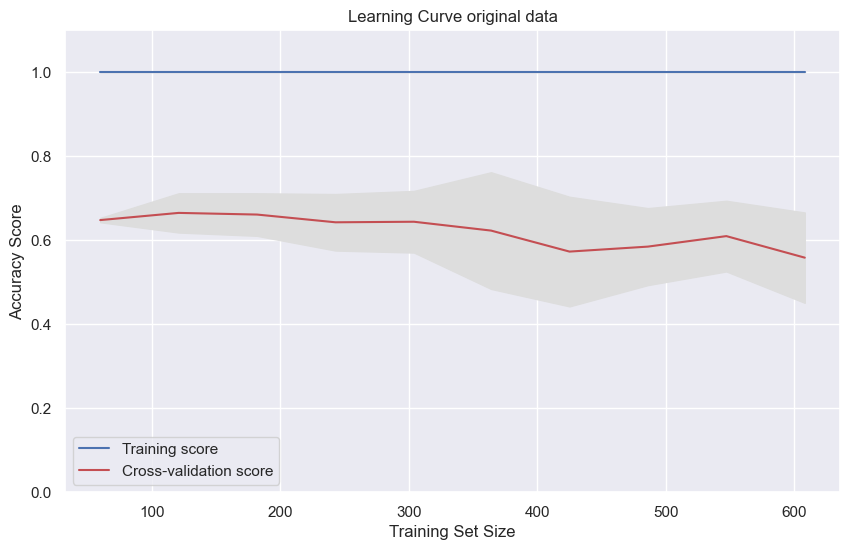

In [39]:


import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import learning_curve

rfc= ensemble.RandomForestClassifier(max_depth=m_deph, n_estimators=n_est)

train_sizes, train_scores, test_scores = learning_curve(
    rfc, x, y, cv=5, n_jobs=-1, train_sizes=np.linspace(0.1, 1.0, 10))

# Calculate mean and standard deviation for training scores and test scores
train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)

# Plot the learning curve
plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_mean, label='Training score', color='b')
plt.plot(train_sizes, test_mean, label='Cross-validation score', color='r')

# Draw standard deviation
plt.fill_between(train_sizes, train_mean - train_std, train_mean + train_std, color='#DDDDDD')
plt.fill_between(train_sizes, test_mean - test_std, test_mean + test_std, color='#DDDDDD')

# Create plot
plt.title('Learning Curve original data')
plt.xlabel('Training Set Size')
plt.ylabel('Accuracy Score')
plt.legend(loc='best')
plt.ylim(0, 1.1)
plt.show()


    Precision: Precision is the ratio of correctly predicted positive observations to the total predicted positive observations. In other words, it measures the accuracy of the positive predictions. It is calculated as:

    Precision = TP / (TP + FP)

    where TP is the number of true positives and FP is the number of false positives.

    Recall: Recall, also known as sensitivity or true positive rate, is the ratio of correctly predicted positive observations to the all observations in the actual class. It measures the model's ability to identify all relevant instances. It is calculated as:

    Recall = TP / (TP + FN)

    where TP is the number of true positives and FN is the number of false negatives.

    F1 Score: The F1 score is the harmonic mean of precision and recall. It provides a single score that balances both precision and recall. It is calculated as:

    F1 Score = 2 * (Precision * Recall) / (Precision + Recall)

The F1 score gives equal weight to both precision and recall. It is helpful when you want to find an optimal balance between precision and recall.

In summary, precision focuses on the positive predictions' accuracy, recall emphasizes the model's ability to find all relevant instances, and the F1 score provides a balance between precision and recall.


 estimator: 1 depth: 4 test score:0.7058823529411765
 estimator: 1 depth: 4 train score:0.7730263157894737
Accuracy: 0.7058823529411765
Classification Report:
              precision    recall  f1-score   support

         0.0       0.76      0.79      0.78        99
         1.0       0.59      0.56      0.57        54

    accuracy                           0.71       153
   macro avg       0.68      0.67      0.67       153
weighted avg       0.70      0.71      0.70       153



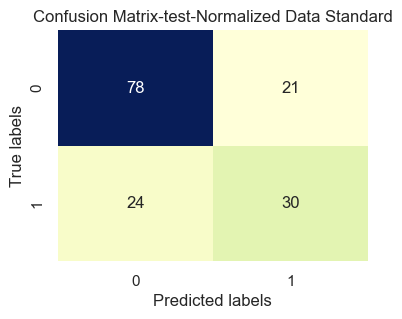

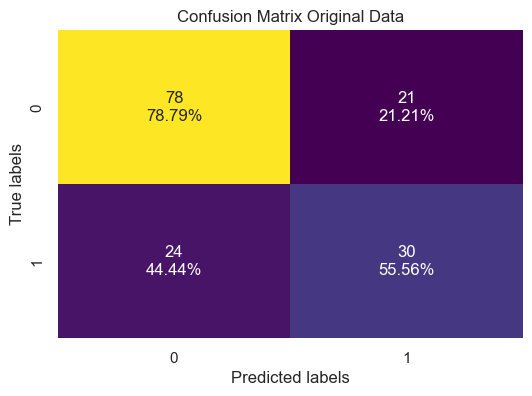

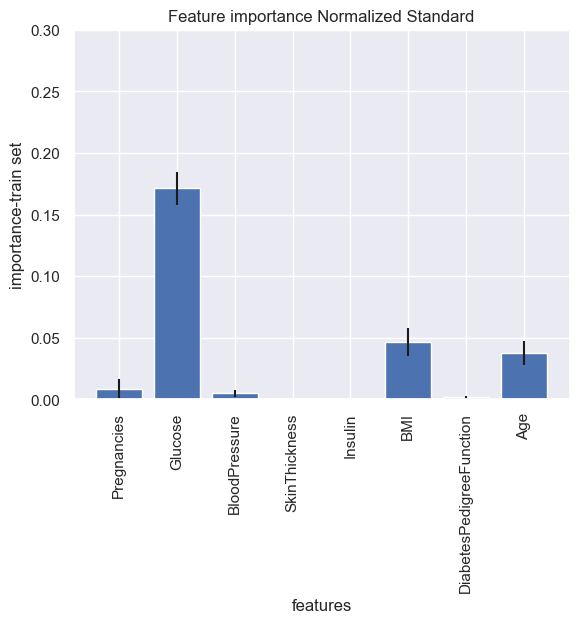

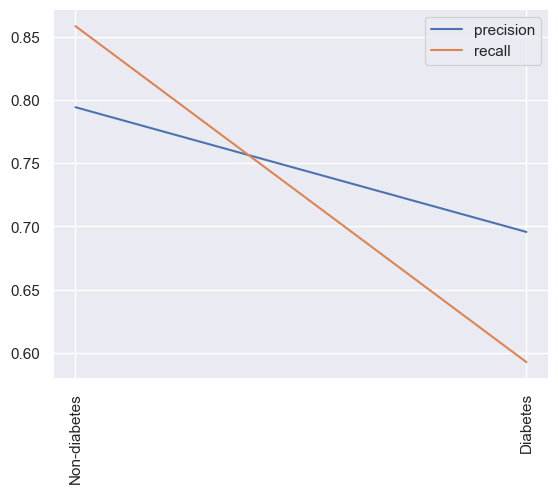

 estimator: 5 depth: 4 test score:0.7124183006535948
 estimator: 5 depth: 4 train score:0.8223684210526315
Accuracy: 0.7124183006535948
Classification Report:
              precision    recall  f1-score   support

         0.0       0.76      0.81      0.78        99
         1.0       0.60      0.54      0.57        54

    accuracy                           0.71       153
   macro avg       0.68      0.67      0.68       153
weighted avg       0.71      0.71      0.71       153



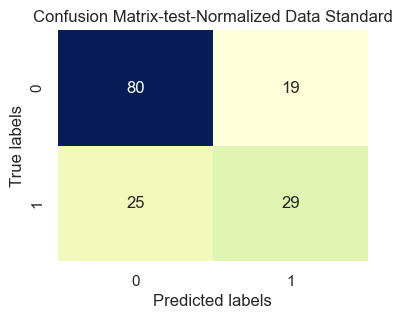

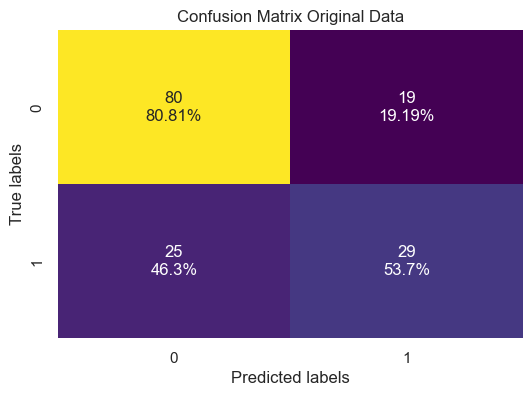

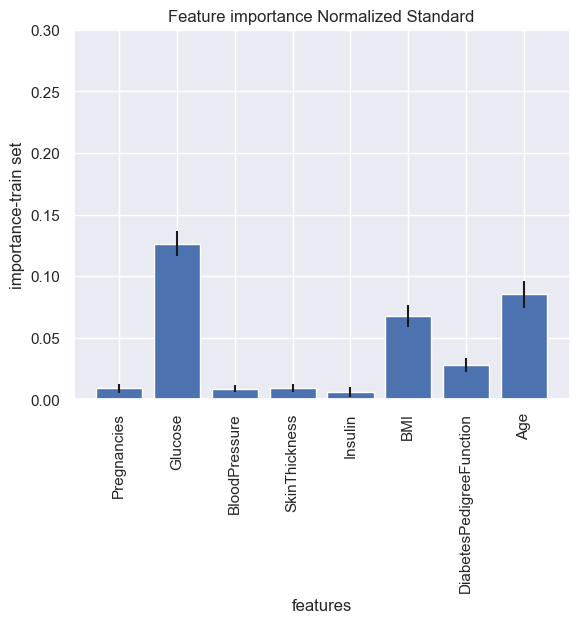

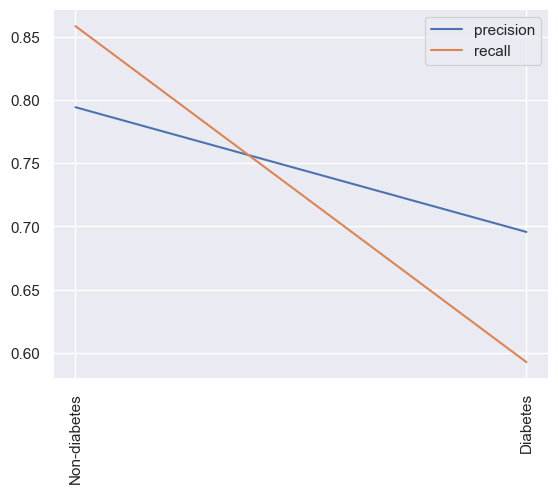

 estimator: 10 depth: 4 test score:0.6993464052287581
 estimator: 10 depth: 4 train score:0.8174342105263158
Accuracy: 0.6993464052287581
Classification Report:
              precision    recall  f1-score   support

         0.0       0.74      0.83      0.78        99
         1.0       0.60      0.46      0.52        54

    accuracy                           0.70       153
   macro avg       0.67      0.65      0.65       153
weighted avg       0.69      0.70      0.69       153



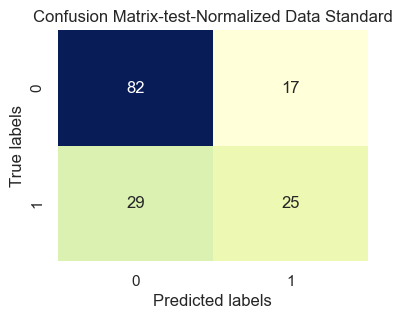

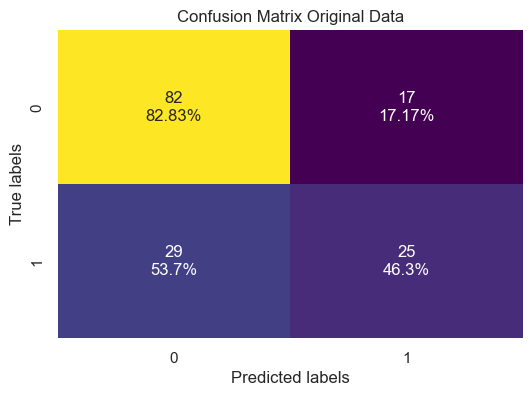

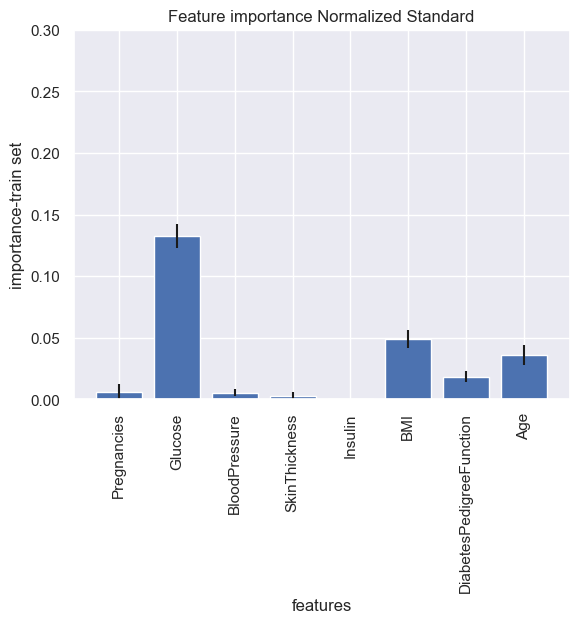

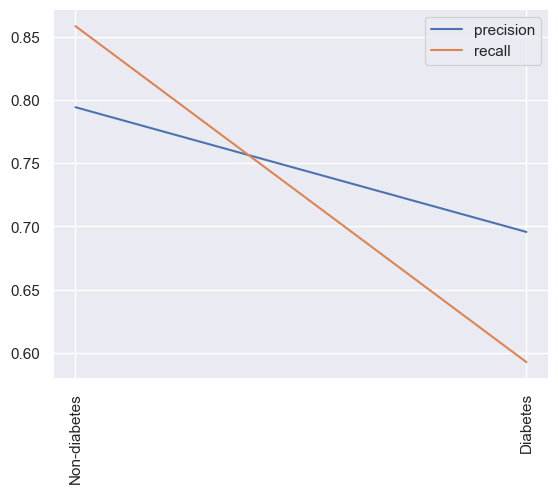

 estimator: 20 depth: 4 test score:0.7189542483660131
 estimator: 20 depth: 4 train score:0.8240131578947368
Accuracy: 0.7189542483660131
Classification Report:
              precision    recall  f1-score   support

         0.0       0.75      0.85      0.80        99
         1.0       0.63      0.48      0.55        54

    accuracy                           0.72       153
   macro avg       0.69      0.66      0.67       153
weighted avg       0.71      0.72      0.71       153



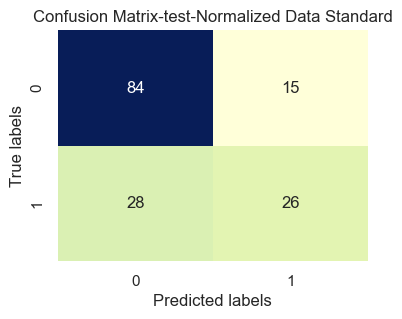

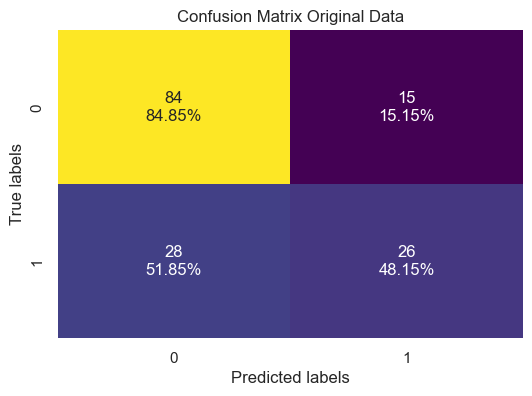

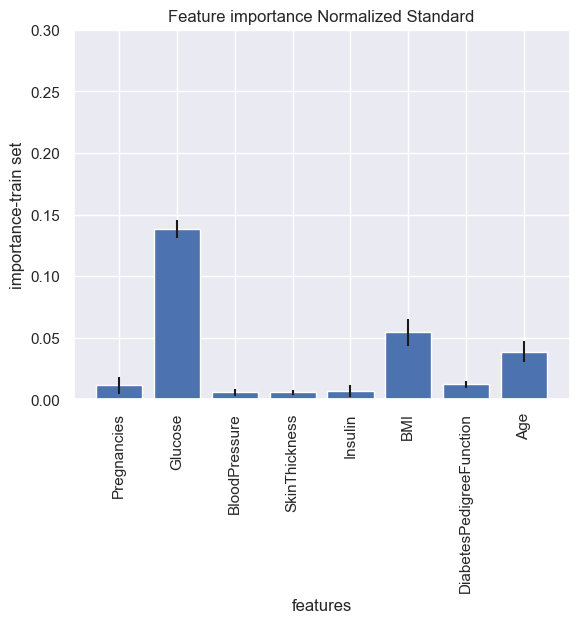

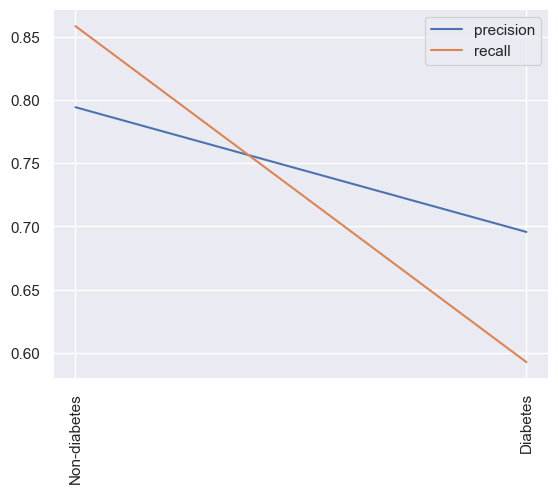

 estimator: 50 depth: 4 test score:0.7254901960784313
 estimator: 50 depth: 4 train score:0.8289473684210527
Accuracy: 0.7254901960784313
Classification Report:
              precision    recall  f1-score   support

         0.0       0.76      0.85      0.80        99
         1.0       0.64      0.50      0.56        54

    accuracy                           0.73       153
   macro avg       0.70      0.67      0.68       153
weighted avg       0.72      0.73      0.72       153



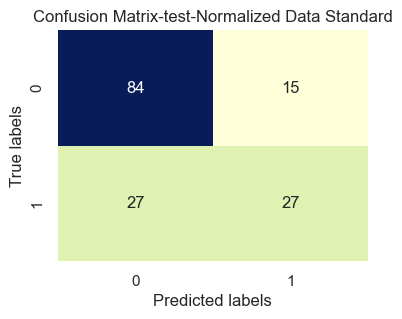

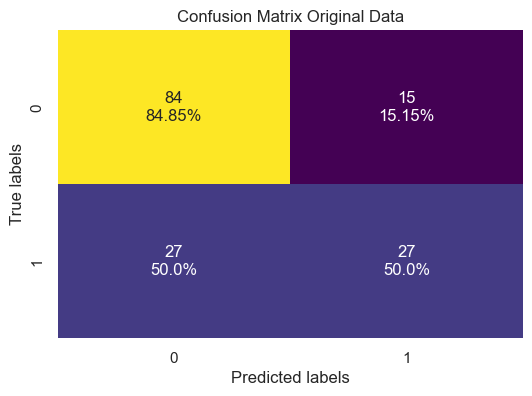

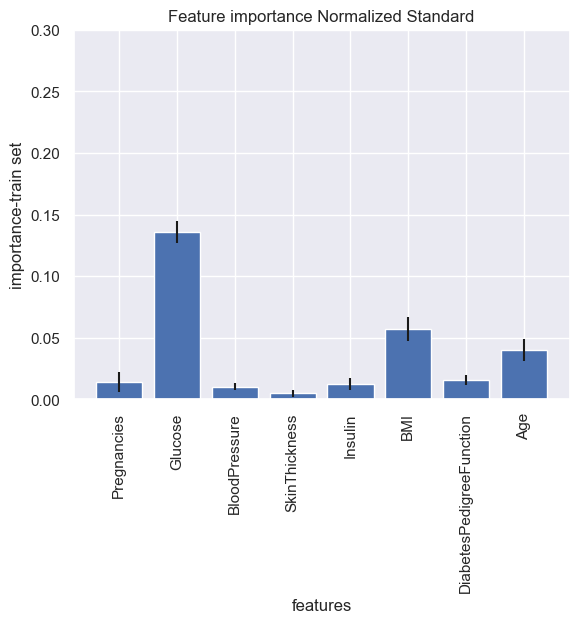

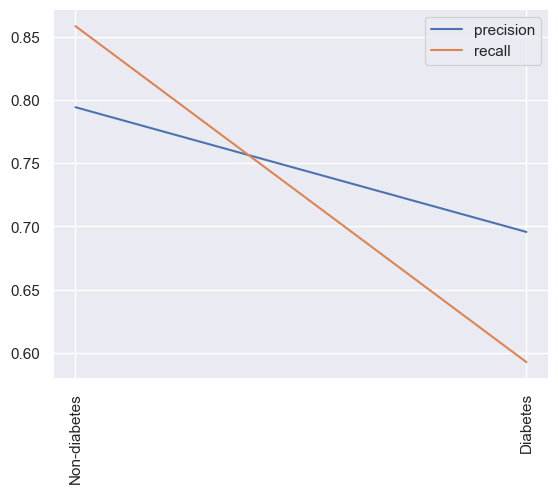

 estimator: 100 depth: 4 test score:0.7254901960784313
 estimator: 100 depth: 4 train score:0.8273026315789473
Accuracy: 0.7254901960784313
Classification Report:
              precision    recall  f1-score   support

         0.0       0.77      0.83      0.80        99
         1.0       0.63      0.54      0.58        54

    accuracy                           0.73       153
   macro avg       0.70      0.68      0.69       153
weighted avg       0.72      0.73      0.72       153



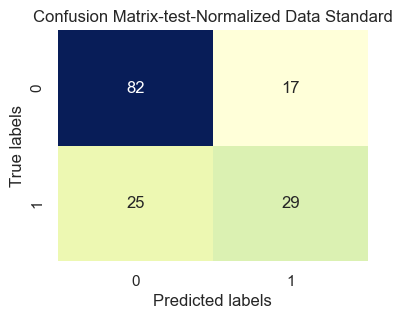

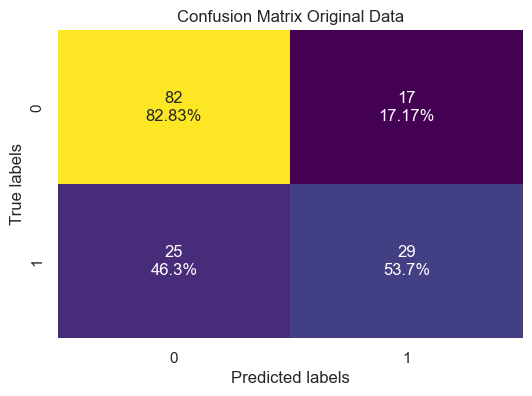

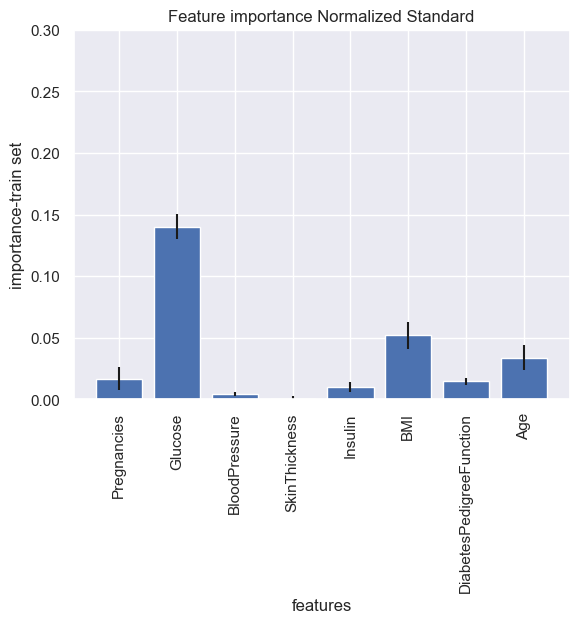

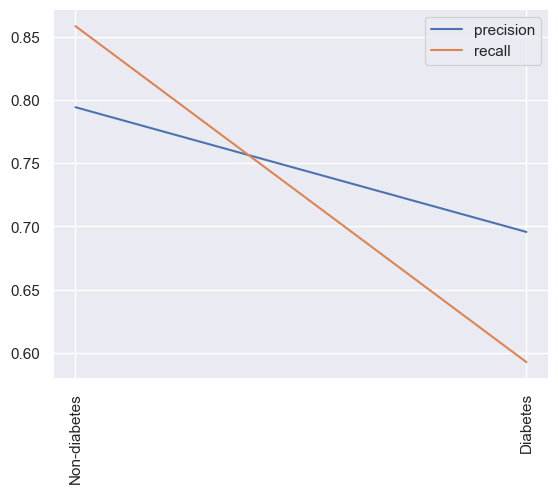

 estimator: 150 depth: 4 test score:0.7254901960784313
 estimator: 150 depth: 4 train score:0.8256578947368421
Accuracy: 0.7254901960784313
Classification Report:
              precision    recall  f1-score   support

         0.0       0.77      0.83      0.80        99
         1.0       0.63      0.54      0.58        54

    accuracy                           0.73       153
   macro avg       0.70      0.68      0.69       153
weighted avg       0.72      0.73      0.72       153



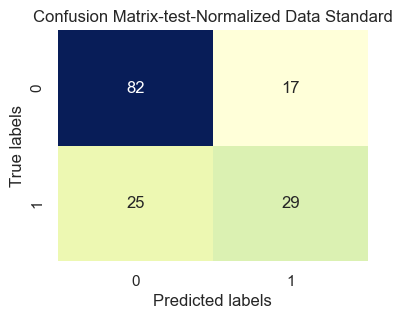

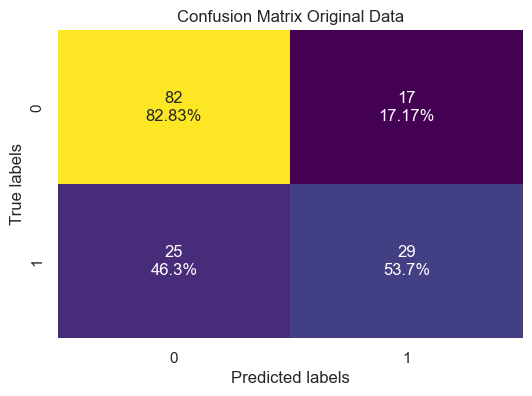

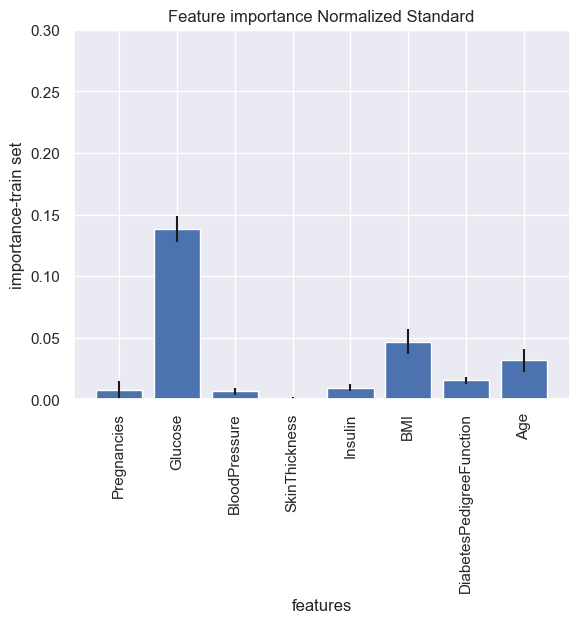

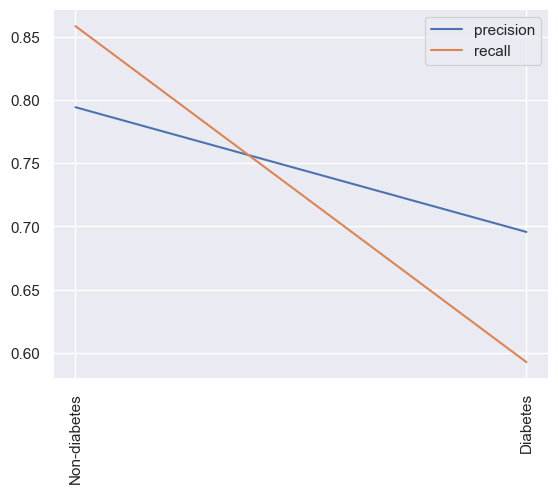

 estimator: 200 depth: 4 test score:0.7254901960784313
 estimator: 200 depth: 4 train score:0.8256578947368421
Accuracy: 0.7254901960784313
Classification Report:
              precision    recall  f1-score   support

         0.0       0.77      0.83      0.80        99
         1.0       0.63      0.54      0.58        54

    accuracy                           0.73       153
   macro avg       0.70      0.68      0.69       153
weighted avg       0.72      0.73      0.72       153



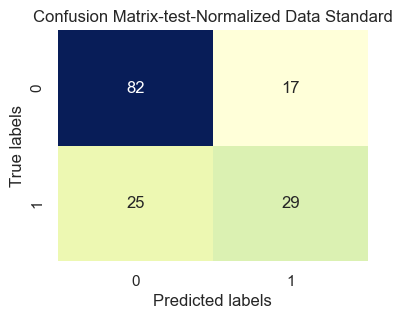

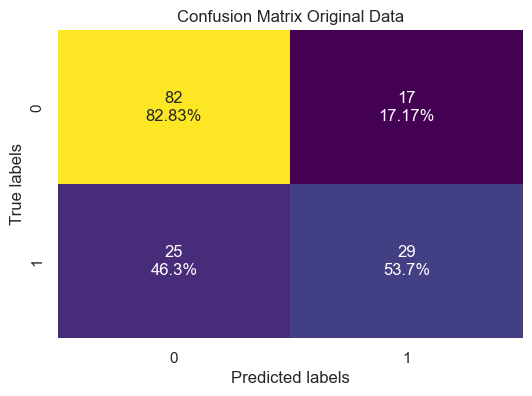

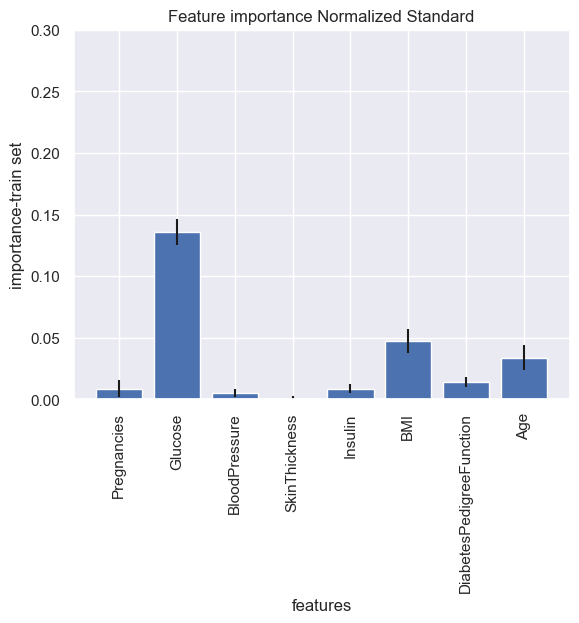

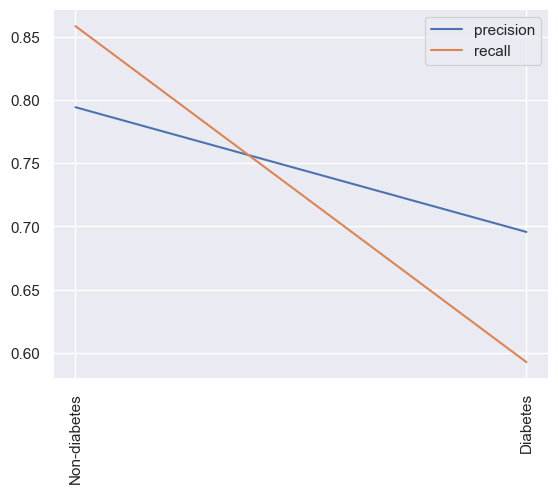

 estimator: 500 depth: 4 test score:0.7254901960784313
 estimator: 500 depth: 4 train score:0.8256578947368421
Accuracy: 0.7254901960784313
Classification Report:
              precision    recall  f1-score   support

         0.0       0.77      0.83      0.80        99
         1.0       0.63      0.54      0.58        54

    accuracy                           0.73       153
   macro avg       0.70      0.68      0.69       153
weighted avg       0.72      0.73      0.72       153



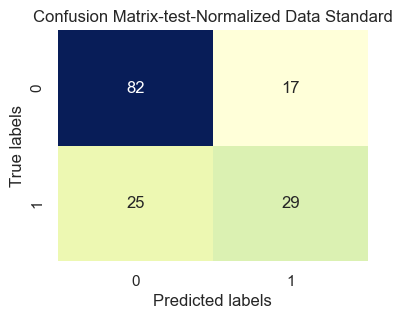

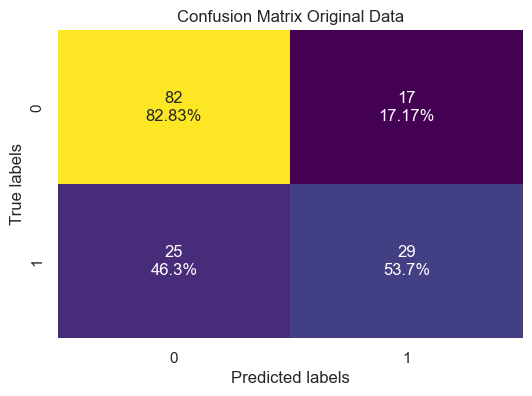

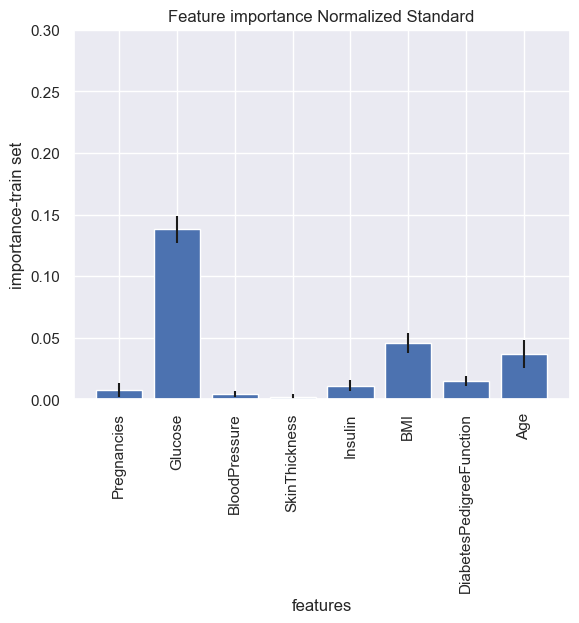

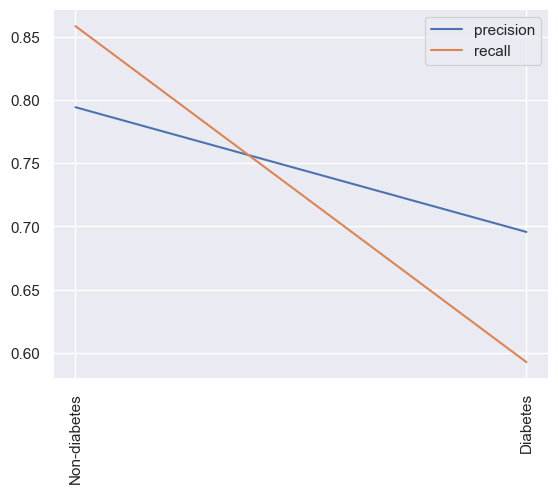

 estimator: 1 depth: 8 test score:0.6797385620915033
 estimator: 1 depth: 8 train score:0.837171052631579
Accuracy: 0.6797385620915033
Classification Report:
              precision    recall  f1-score   support

         0.0       0.73      0.80      0.76        99
         1.0       0.56      0.46      0.51        54

    accuracy                           0.68       153
   macro avg       0.64      0.63      0.63       153
weighted avg       0.67      0.68      0.67       153



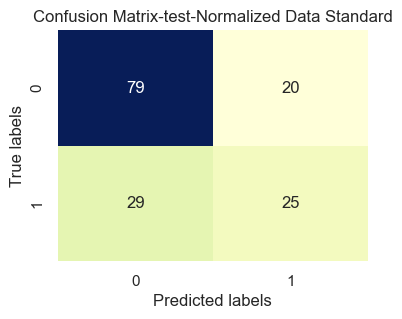

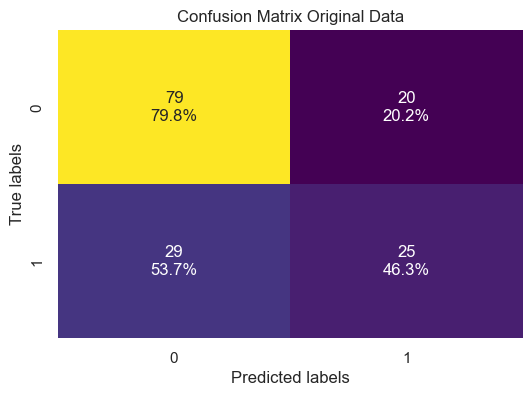

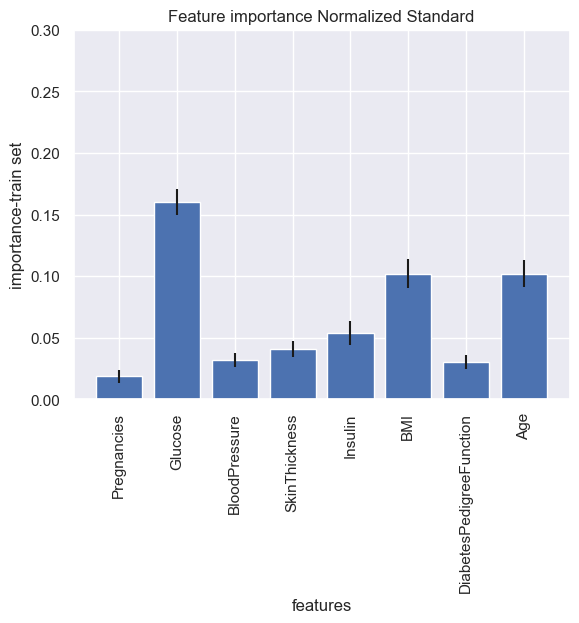

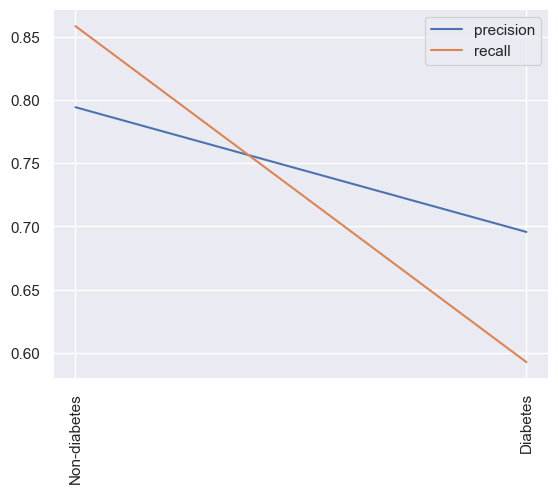

 estimator: 5 depth: 8 test score:0.7254901960784313
 estimator: 5 depth: 8 train score:0.9276315789473685
Accuracy: 0.7254901960784313
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.77      0.78        99
         1.0       0.60      0.65      0.62        54

    accuracy                           0.73       153
   macro avg       0.70      0.71      0.70       153
weighted avg       0.73      0.73      0.73       153



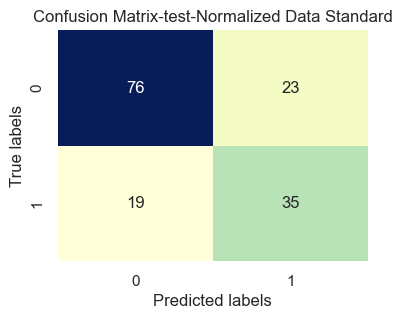

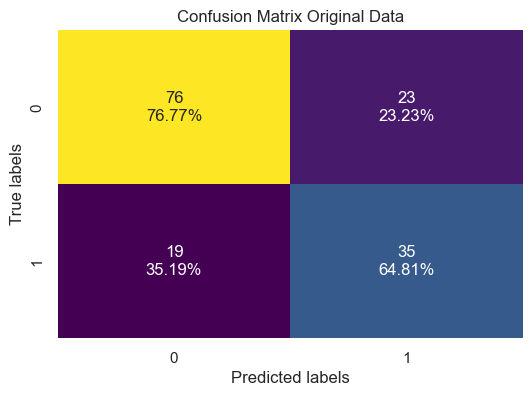

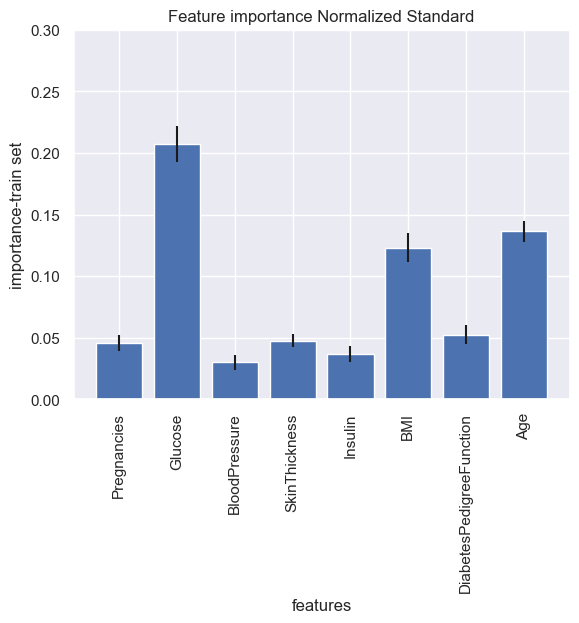

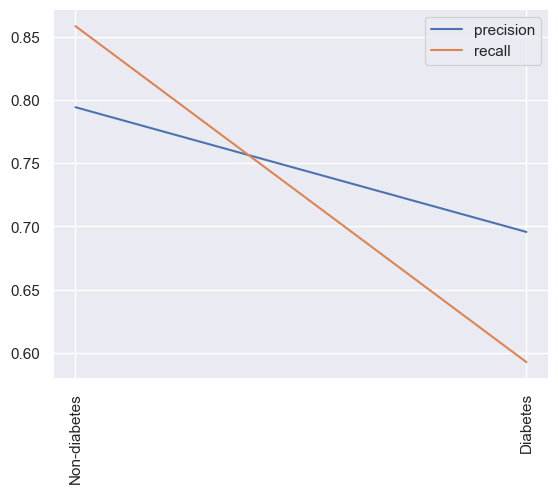

 estimator: 10 depth: 8 test score:0.738562091503268
 estimator: 10 depth: 8 train score:0.9457236842105263
Accuracy: 0.738562091503268
Classification Report:
              precision    recall  f1-score   support

         0.0       0.78      0.83      0.80        99
         1.0       0.65      0.57      0.61        54

    accuracy                           0.74       153
   macro avg       0.71      0.70      0.71       153
weighted avg       0.73      0.74      0.73       153



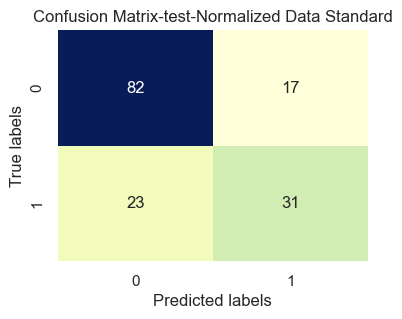

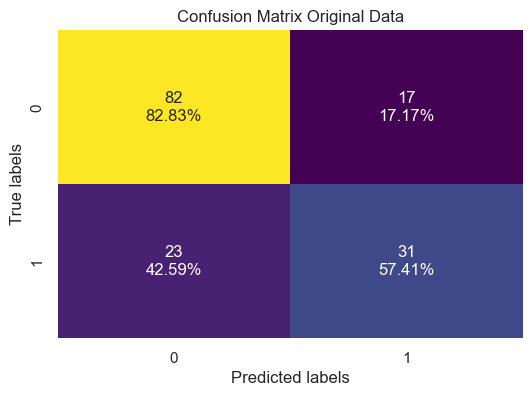

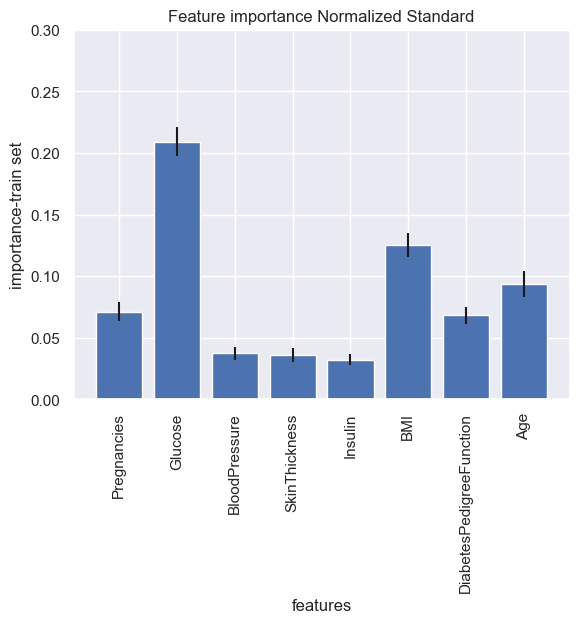

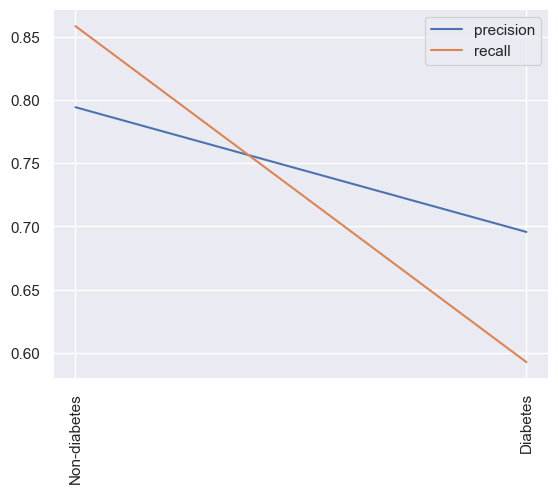

 estimator: 20 depth: 8 test score:0.7712418300653595
 estimator: 20 depth: 8 train score:0.9523026315789473
Accuracy: 0.7712418300653595
Classification Report:
              precision    recall  f1-score   support

         0.0       0.81      0.85      0.83        99
         1.0       0.69      0.63      0.66        54

    accuracy                           0.77       153
   macro avg       0.75      0.74      0.74       153
weighted avg       0.77      0.77      0.77       153



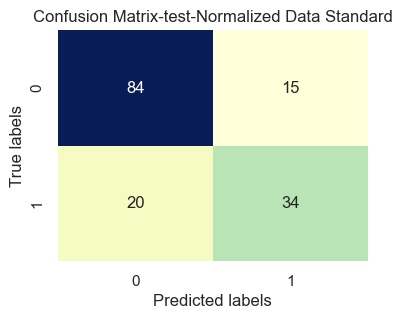

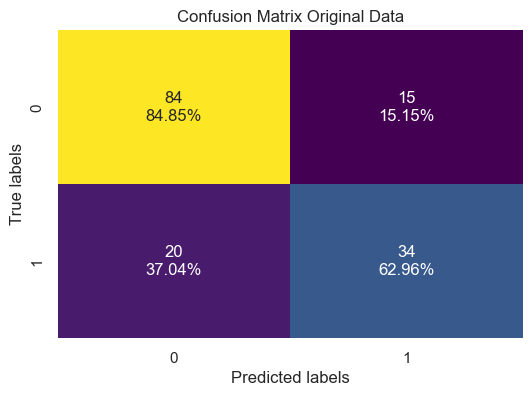

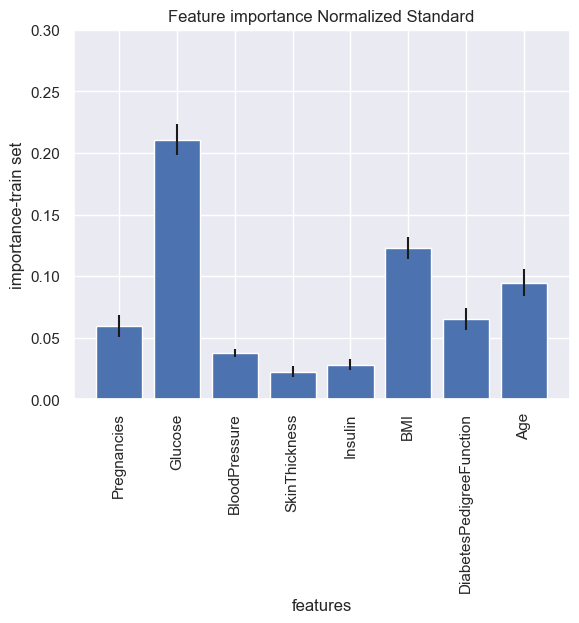

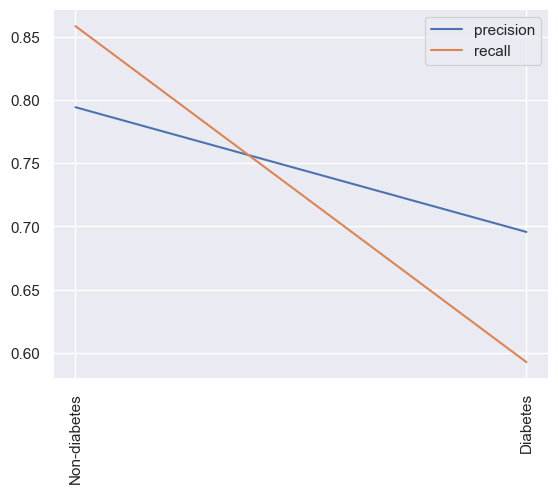

 estimator: 50 depth: 8 test score:0.7450980392156863
 estimator: 50 depth: 8 train score:0.9588815789473685
Accuracy: 0.7450980392156863
Classification Report:
              precision    recall  f1-score   support

         0.0       0.78      0.84      0.81        99
         1.0       0.66      0.57      0.61        54

    accuracy                           0.75       153
   macro avg       0.72      0.71      0.71       153
weighted avg       0.74      0.75      0.74       153



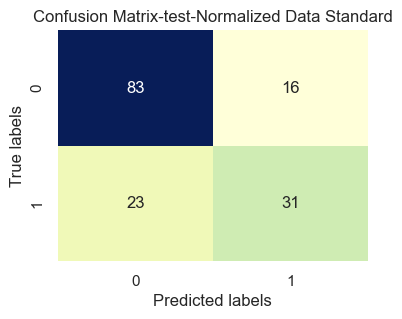

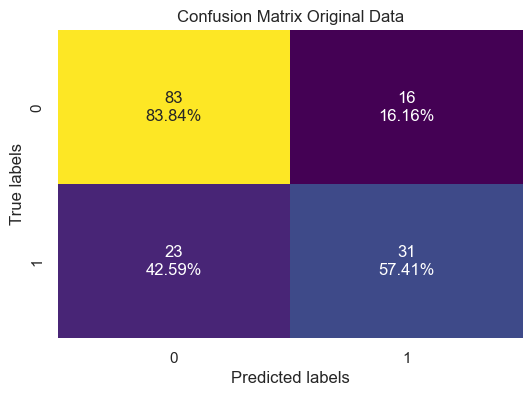

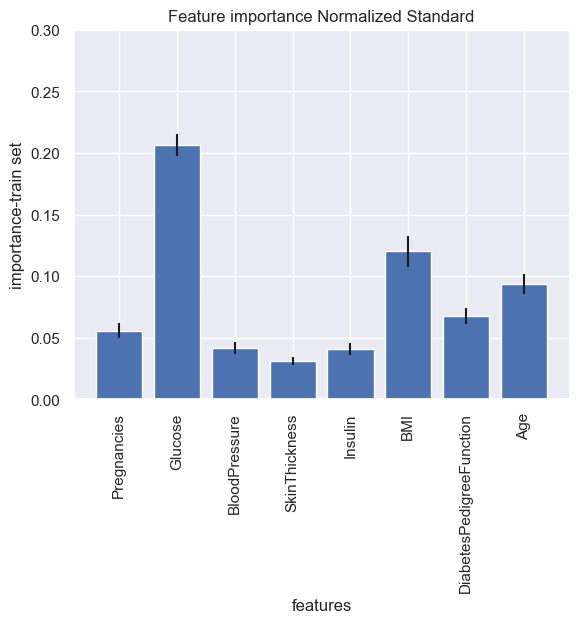

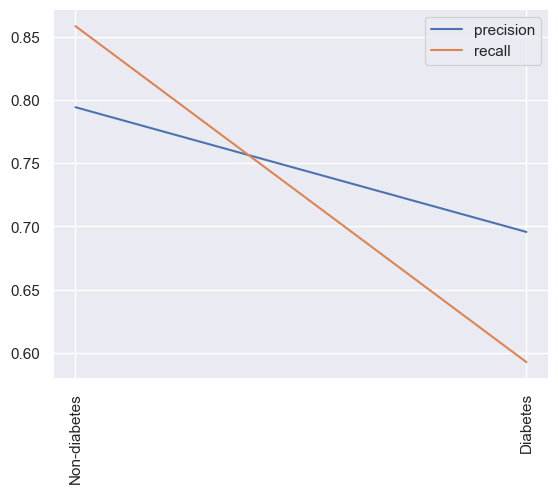

 estimator: 100 depth: 8 test score:0.7647058823529411
 estimator: 100 depth: 8 train score:0.9605263157894737
Accuracy: 0.7647058823529411
Classification Report:
              precision    recall  f1-score   support

         0.0       0.82      0.82      0.82        99
         1.0       0.67      0.67      0.67        54

    accuracy                           0.76       153
   macro avg       0.74      0.74      0.74       153
weighted avg       0.76      0.76      0.76       153



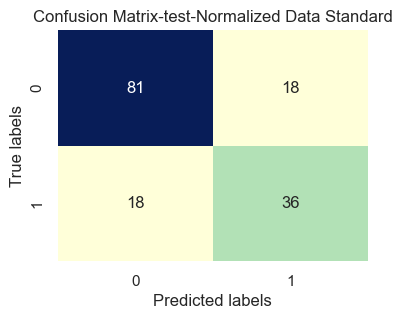

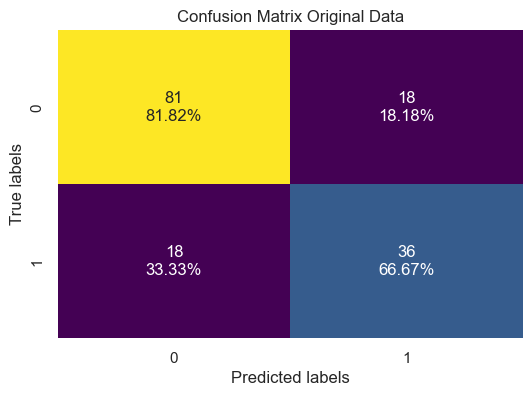

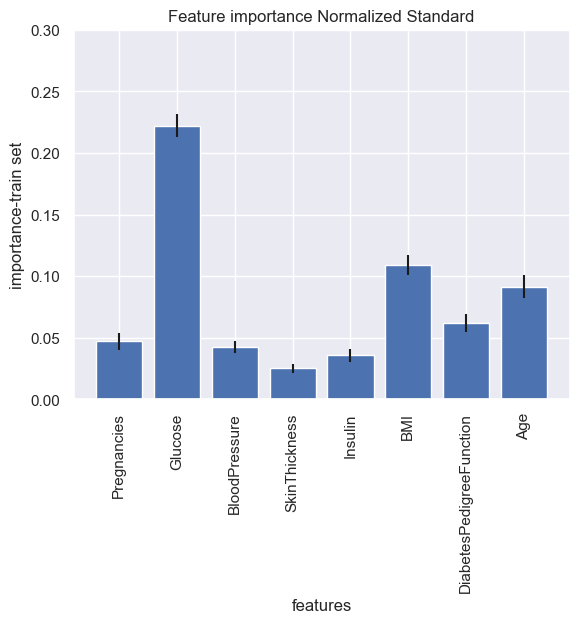

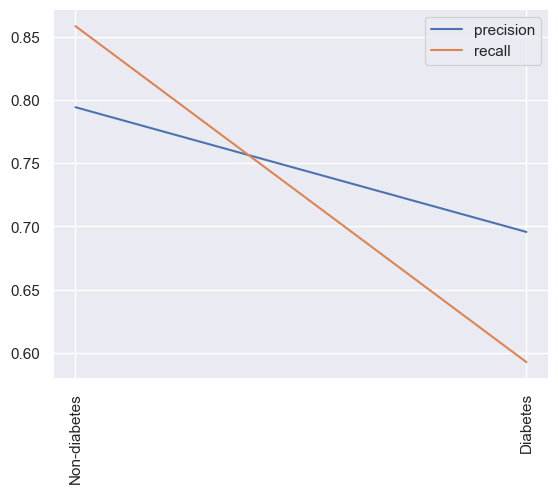

 estimator: 150 depth: 8 test score:0.7712418300653595
 estimator: 150 depth: 8 train score:0.9638157894736842
Accuracy: 0.7712418300653595
Classification Report:
              precision    recall  f1-score   support

         0.0       0.82      0.83      0.82        99
         1.0       0.68      0.67      0.67        54

    accuracy                           0.77       153
   macro avg       0.75      0.75      0.75       153
weighted avg       0.77      0.77      0.77       153



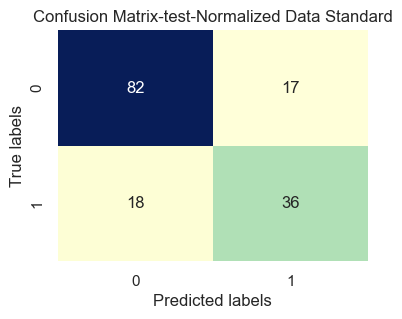

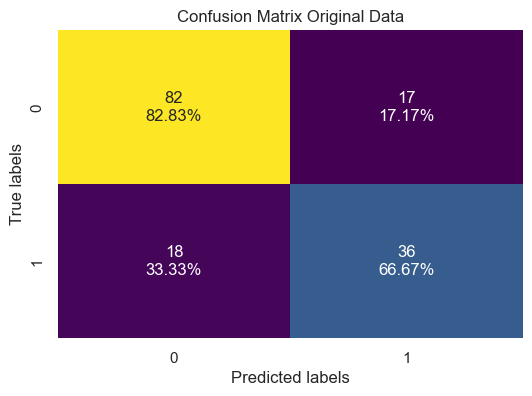

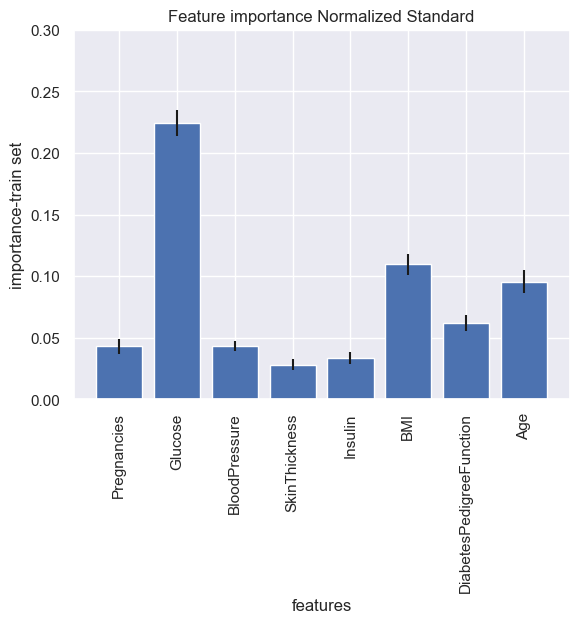

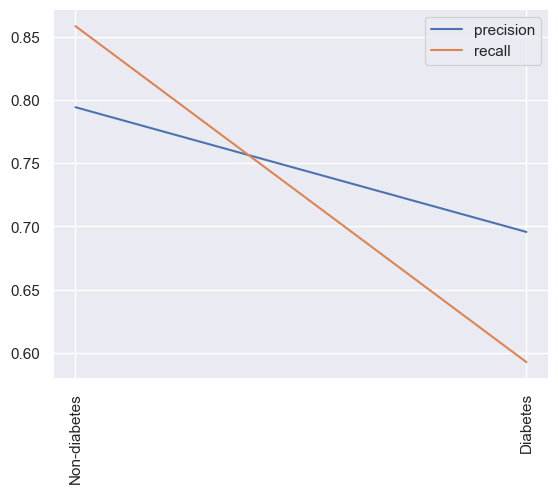

 estimator: 200 depth: 8 test score:0.7712418300653595
 estimator: 200 depth: 8 train score:0.9671052631578947
Accuracy: 0.7712418300653595
Classification Report:
              precision    recall  f1-score   support

         0.0       0.82      0.83      0.82        99
         1.0       0.68      0.67      0.67        54

    accuracy                           0.77       153
   macro avg       0.75      0.75      0.75       153
weighted avg       0.77      0.77      0.77       153



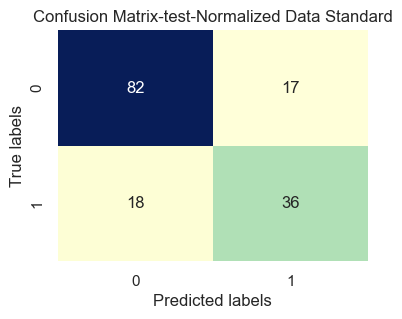

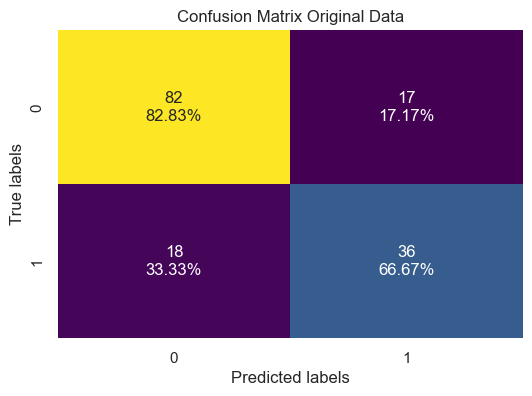

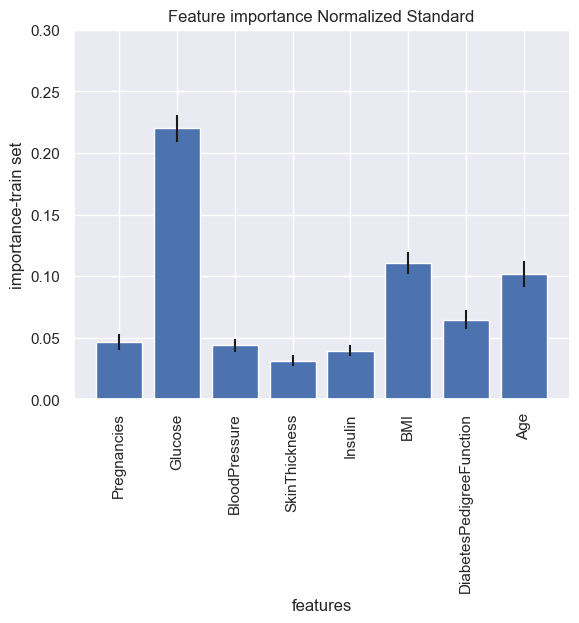

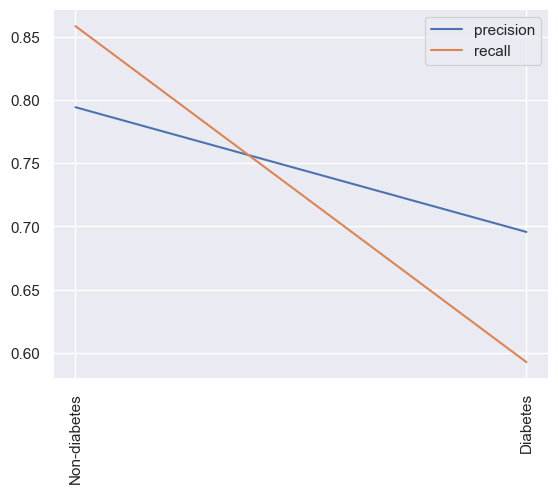

 estimator: 500 depth: 8 test score:0.7516339869281046
 estimator: 500 depth: 8 train score:0.9671052631578947
Accuracy: 0.7516339869281046
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.83      0.81        99
         1.0       0.66      0.61      0.63        54

    accuracy                           0.75       153
   macro avg       0.73      0.72      0.72       153
weighted avg       0.75      0.75      0.75       153



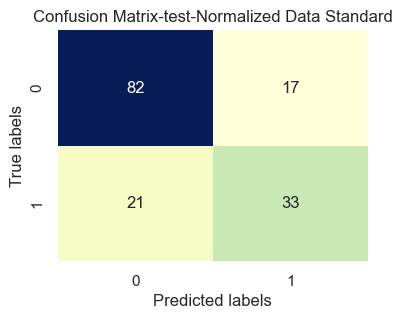

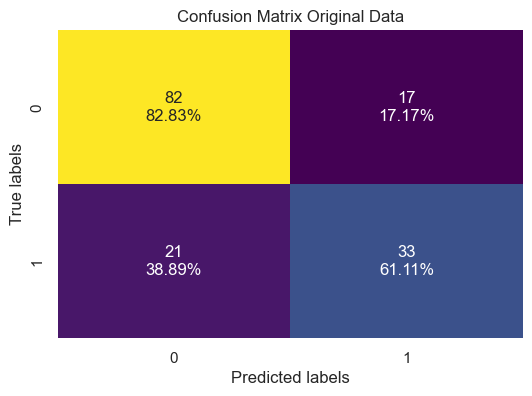

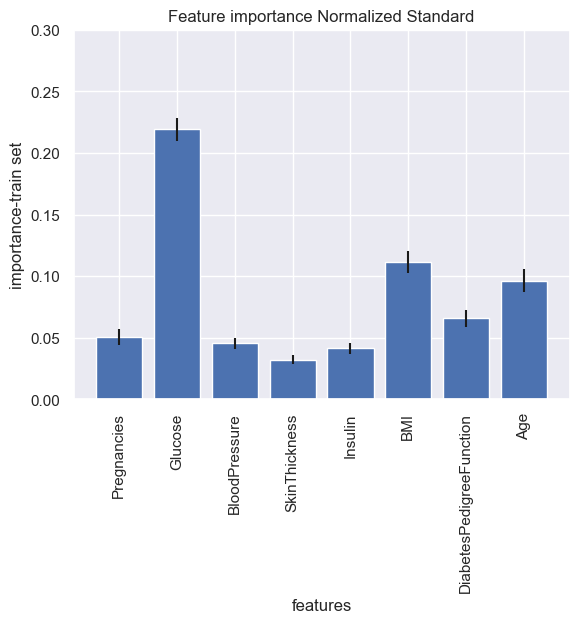

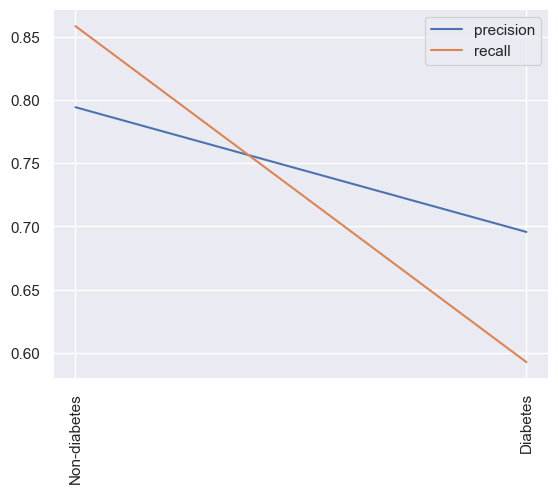

 estimator: 1 depth: 16 test score:0.6666666666666666
 estimator: 1 depth: 16 train score:0.8848684210526315
Accuracy: 0.6666666666666666
Classification Report:
              precision    recall  f1-score   support

         0.0       0.74      0.75      0.74        99
         1.0       0.53      0.52      0.52        54

    accuracy                           0.67       153
   macro avg       0.63      0.63      0.63       153
weighted avg       0.67      0.67      0.67       153



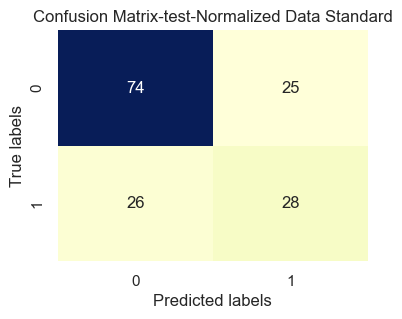

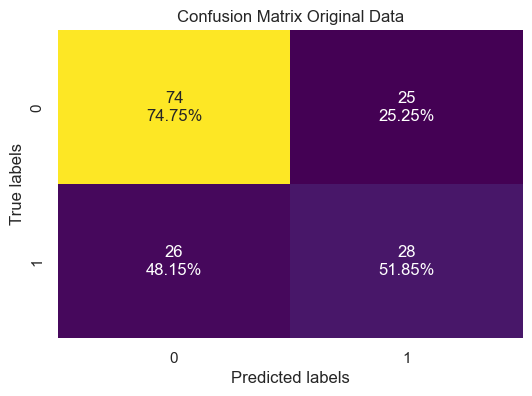

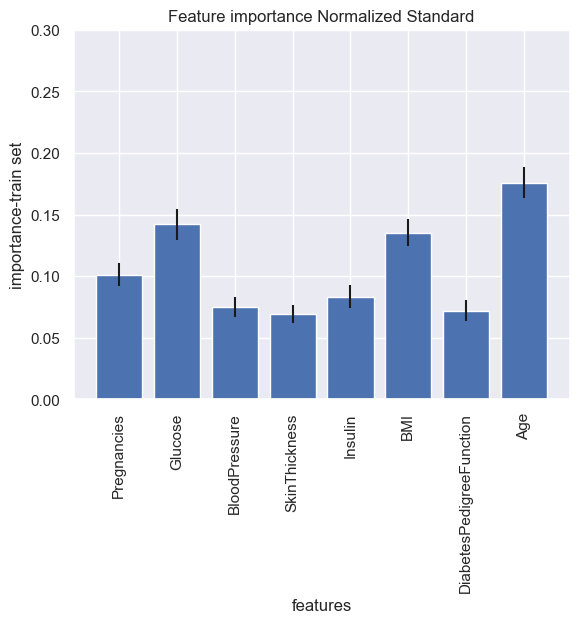

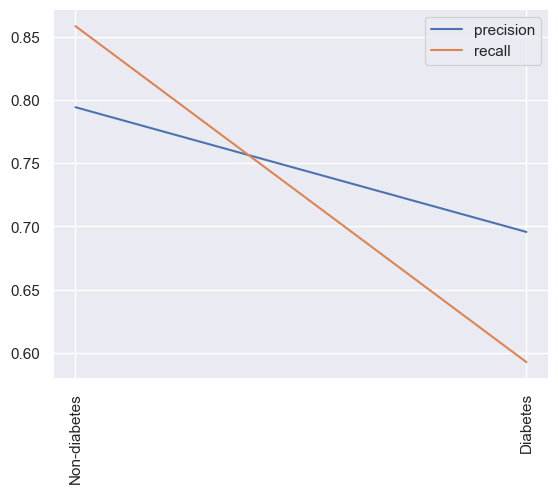

 estimator: 5 depth: 16 test score:0.7189542483660131
 estimator: 5 depth: 16 train score:0.9769736842105263
Accuracy: 0.7189542483660131
Classification Report:
              precision    recall  f1-score   support

         0.0       0.78      0.79      0.78        99
         1.0       0.60      0.59      0.60        54

    accuracy                           0.72       153
   macro avg       0.69      0.69      0.69       153
weighted avg       0.72      0.72      0.72       153



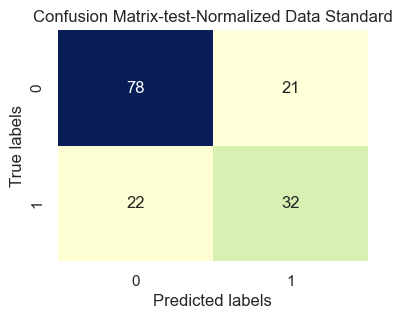

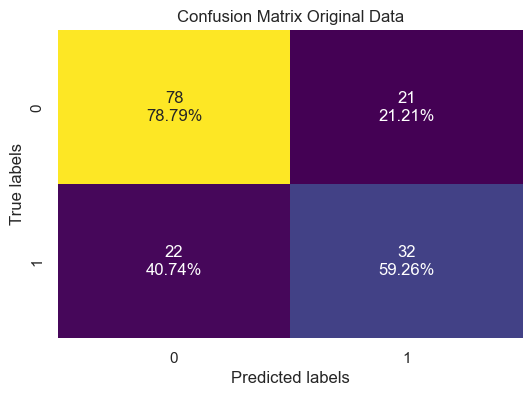

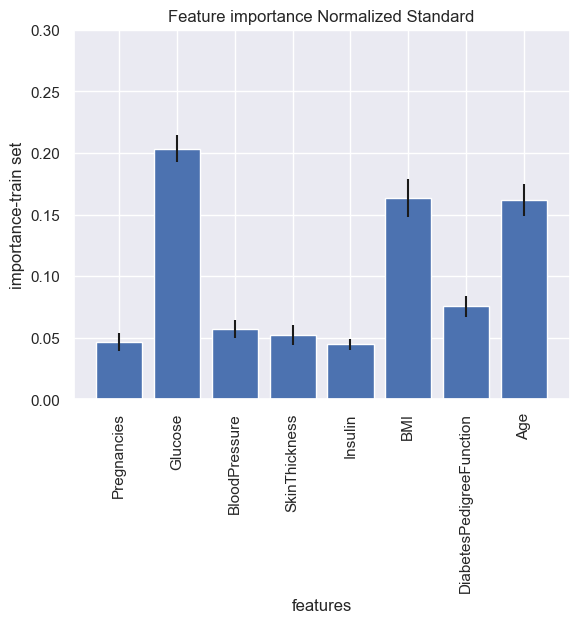

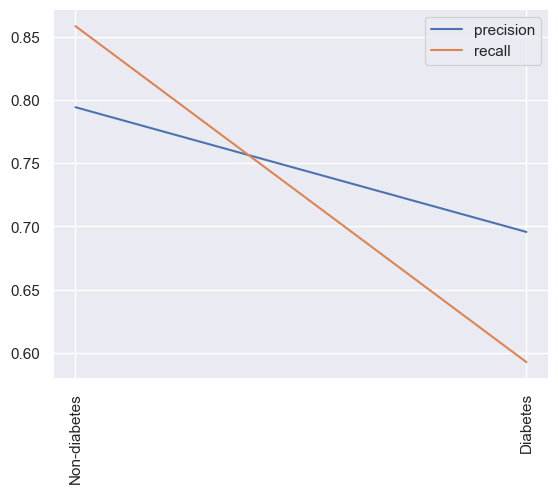

 estimator: 10 depth: 16 test score:0.738562091503268
 estimator: 10 depth: 16 train score:0.9901315789473685
Accuracy: 0.738562091503268
Classification Report:
              precision    recall  f1-score   support

         0.0       0.78      0.83      0.80        99
         1.0       0.65      0.57      0.61        54

    accuracy                           0.74       153
   macro avg       0.71      0.70      0.71       153
weighted avg       0.73      0.74      0.73       153



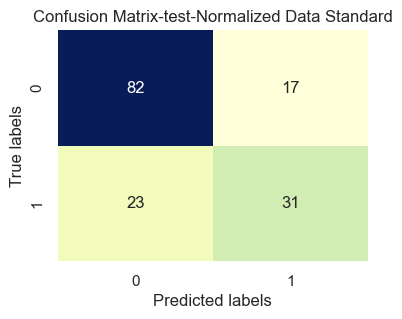

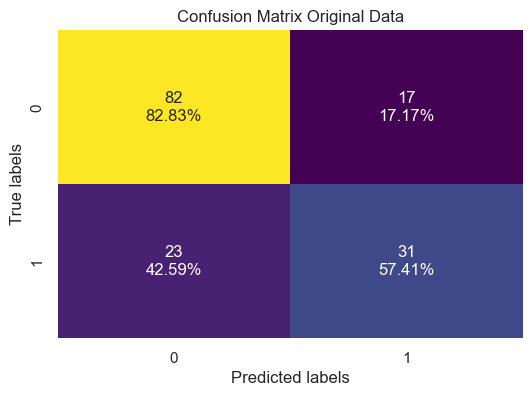

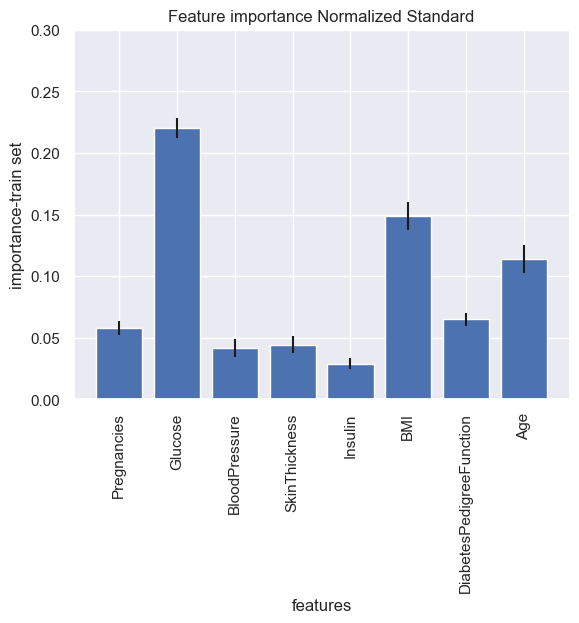

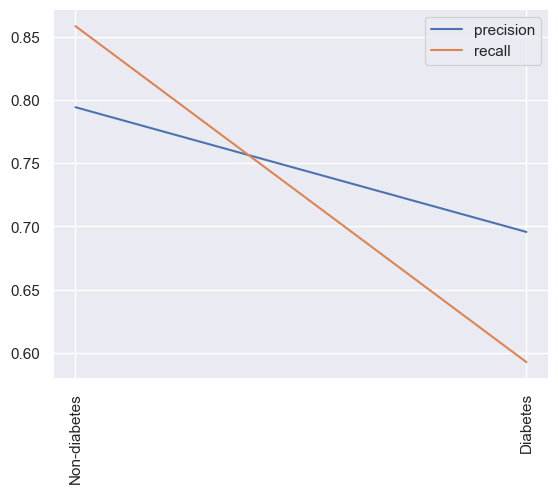

 estimator: 20 depth: 16 test score:0.7581699346405228
 estimator: 20 depth: 16 train score:1.0
Accuracy: 0.7581699346405228
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.83      0.82        99
         1.0       0.67      0.63      0.65        54

    accuracy                           0.76       153
   macro avg       0.74      0.73      0.73       153
weighted avg       0.76      0.76      0.76       153



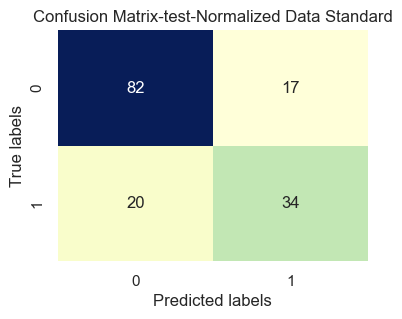

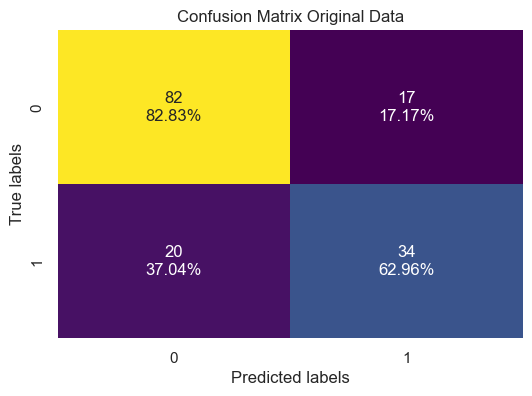

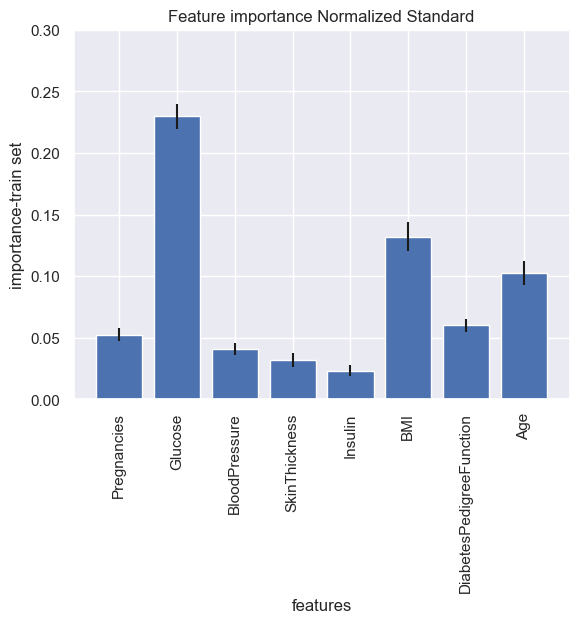

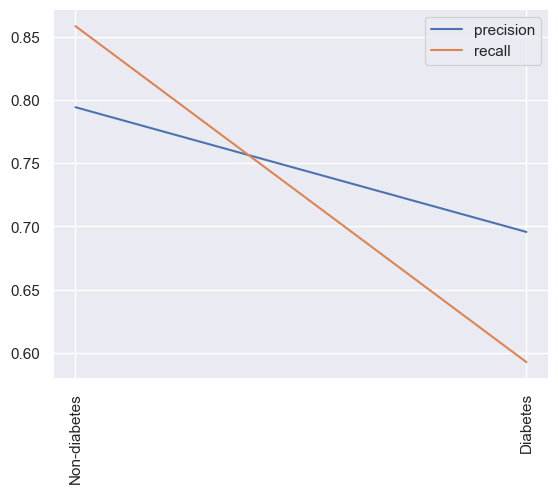

 estimator: 50 depth: 16 test score:0.7581699346405228
 estimator: 50 depth: 16 train score:1.0
Accuracy: 0.7581699346405228
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.83      0.82        99
         1.0       0.67      0.63      0.65        54

    accuracy                           0.76       153
   macro avg       0.74      0.73      0.73       153
weighted avg       0.76      0.76      0.76       153



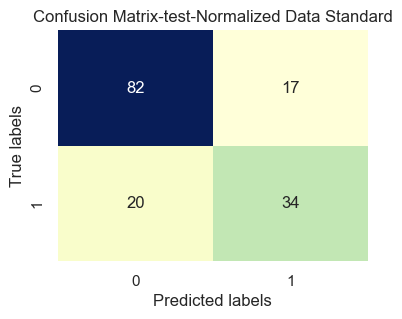

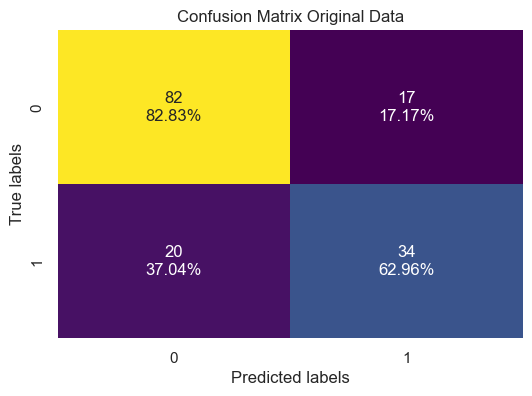

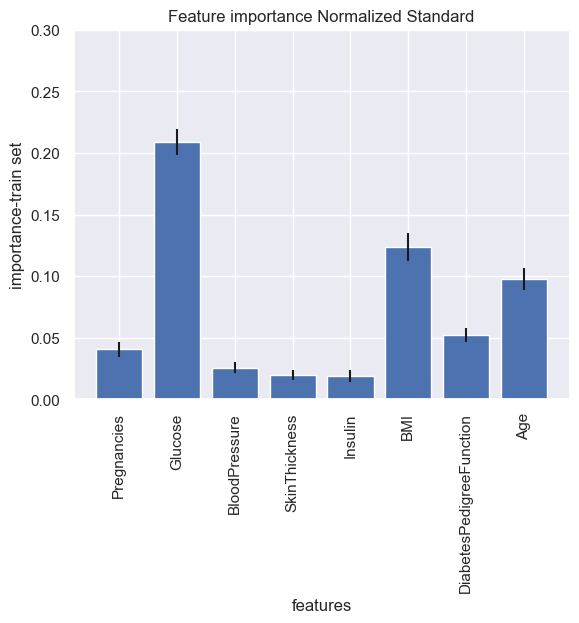

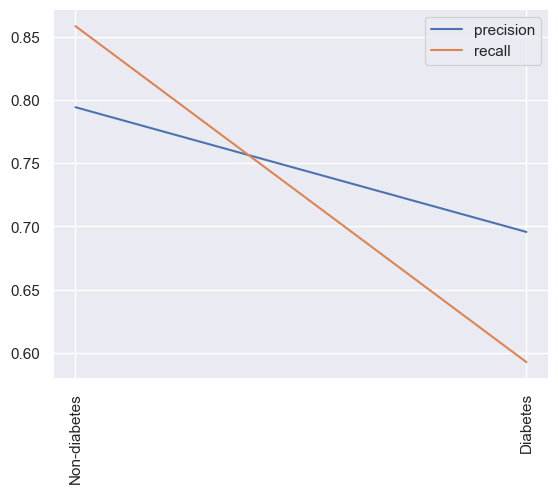

 estimator: 100 depth: 16 test score:0.7647058823529411
 estimator: 100 depth: 16 train score:1.0
Accuracy: 0.7647058823529411
Classification Report:
              precision    recall  f1-score   support

         0.0       0.82      0.82      0.82        99
         1.0       0.67      0.67      0.67        54

    accuracy                           0.76       153
   macro avg       0.74      0.74      0.74       153
weighted avg       0.76      0.76      0.76       153



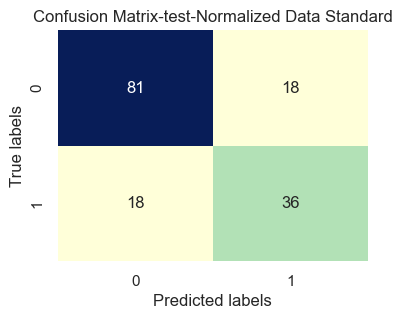

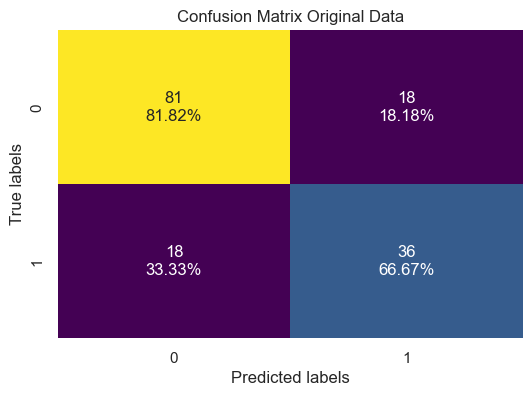

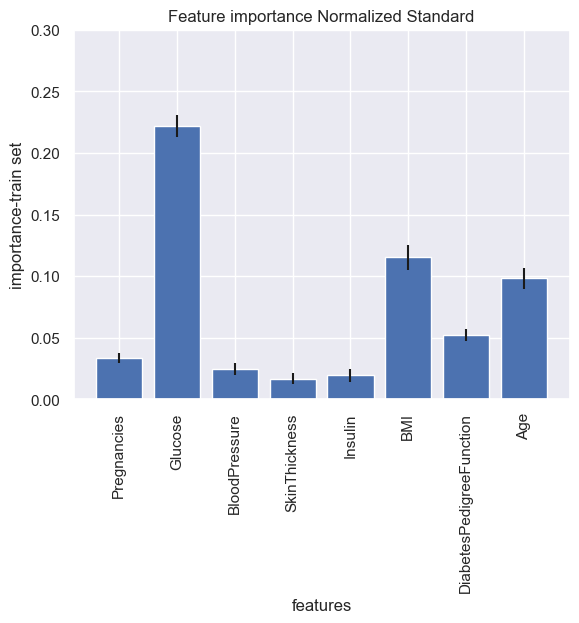

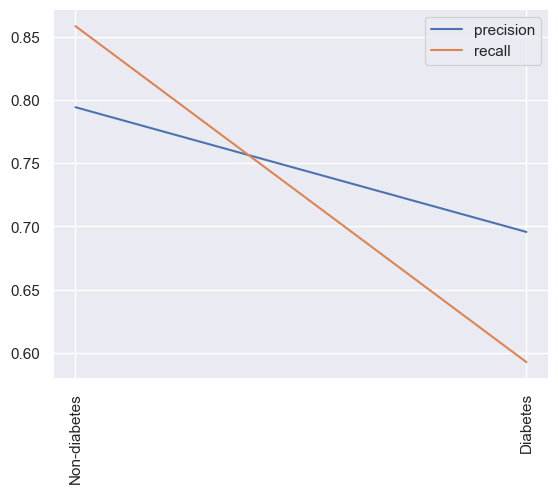

 estimator: 150 depth: 16 test score:0.7712418300653595
 estimator: 150 depth: 16 train score:1.0
Accuracy: 0.7712418300653595
Classification Report:
              precision    recall  f1-score   support

         0.0       0.82      0.83      0.82        99
         1.0       0.68      0.67      0.67        54

    accuracy                           0.77       153
   macro avg       0.75      0.75      0.75       153
weighted avg       0.77      0.77      0.77       153



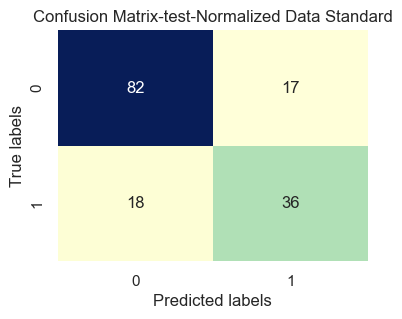

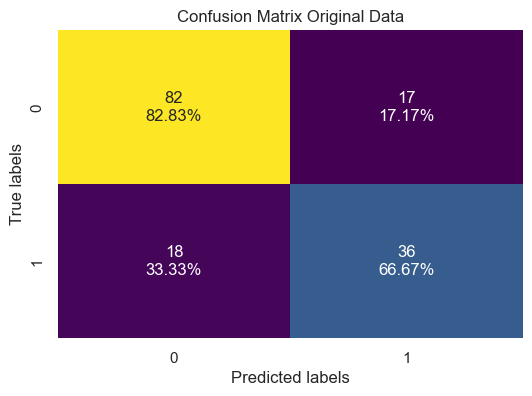

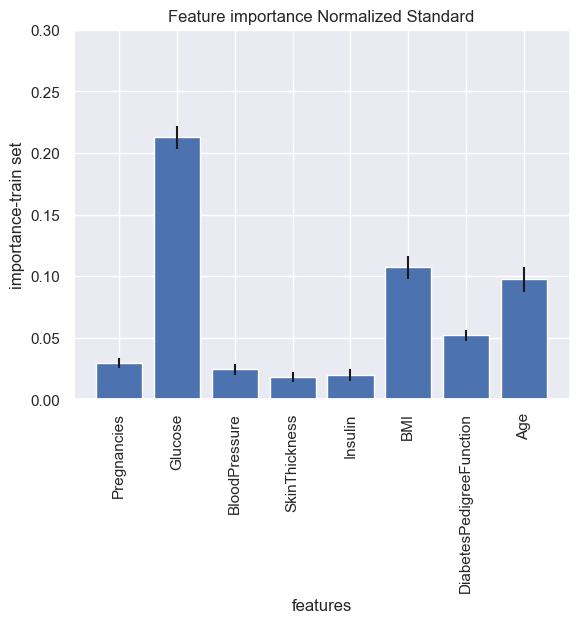

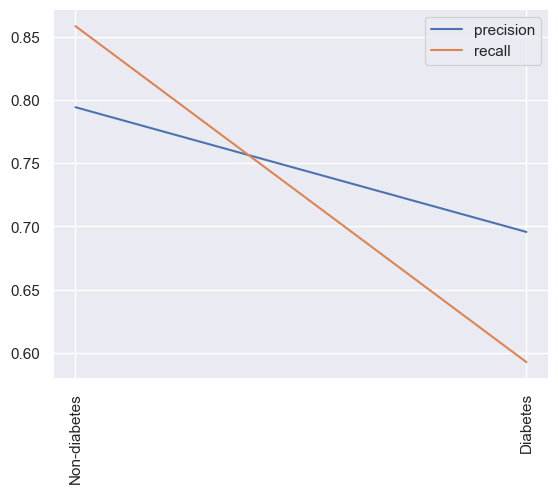

 estimator: 200 depth: 16 test score:0.7777777777777778
 estimator: 200 depth: 16 train score:1.0
Accuracy: 0.7777777777777778
Classification Report:
              precision    recall  f1-score   support

         0.0       0.84      0.82      0.83        99
         1.0       0.68      0.70      0.69        54

    accuracy                           0.78       153
   macro avg       0.76      0.76      0.76       153
weighted avg       0.78      0.78      0.78       153



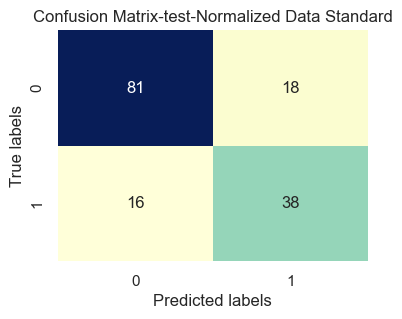

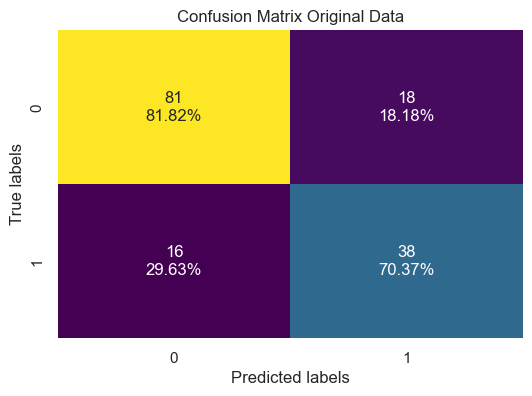

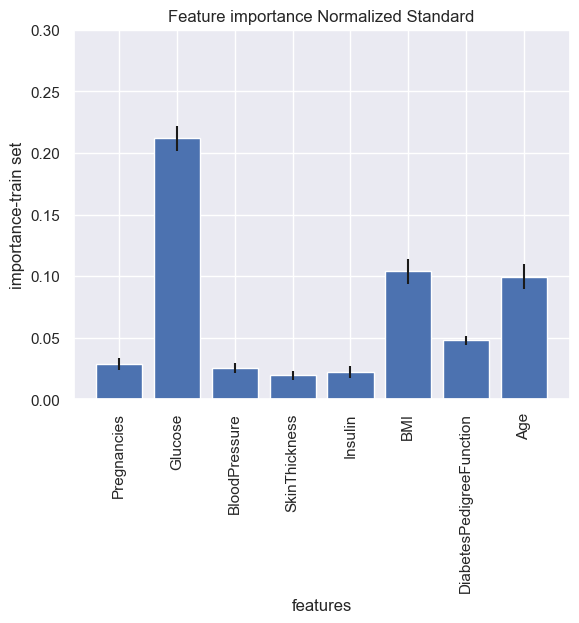

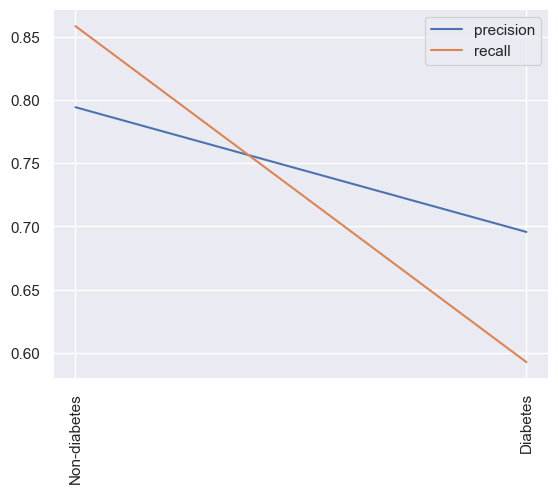

 estimator: 500 depth: 16 test score:0.7647058823529411
 estimator: 500 depth: 16 train score:1.0
Accuracy: 0.7647058823529411
Classification Report:
              precision    recall  f1-score   support

         0.0       0.82      0.81      0.82        99
         1.0       0.66      0.69      0.67        54

    accuracy                           0.76       153
   macro avg       0.74      0.75      0.74       153
weighted avg       0.77      0.76      0.77       153



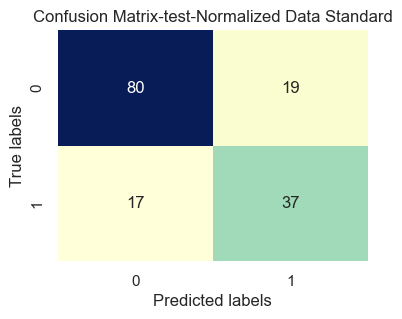

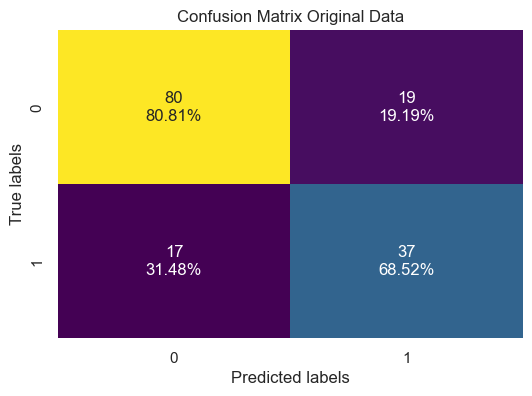

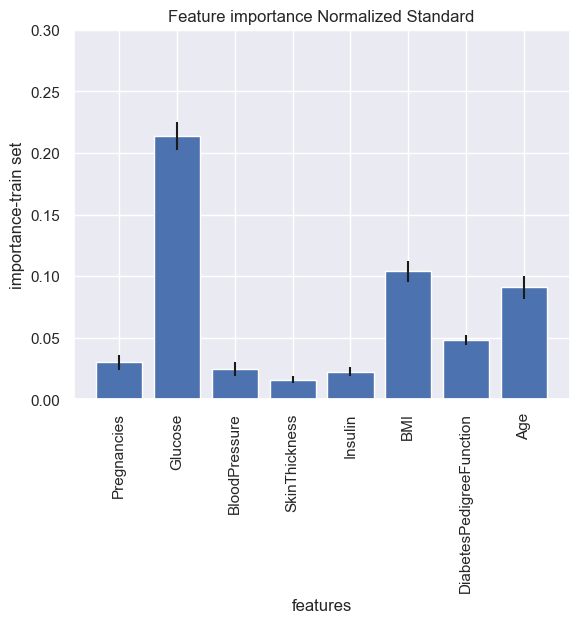

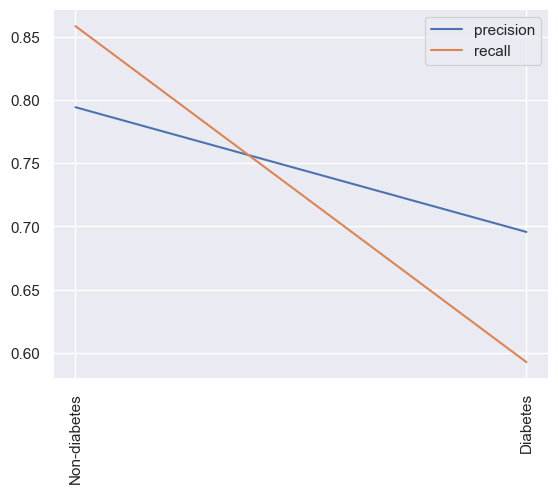

 estimator: 1 depth: 20 test score:0.6666666666666666
 estimator: 1 depth: 20 train score:0.8848684210526315
Accuracy: 0.6666666666666666
Classification Report:
              precision    recall  f1-score   support

         0.0       0.74      0.75      0.74        99
         1.0       0.53      0.52      0.52        54

    accuracy                           0.67       153
   macro avg       0.63      0.63      0.63       153
weighted avg       0.67      0.67      0.67       153



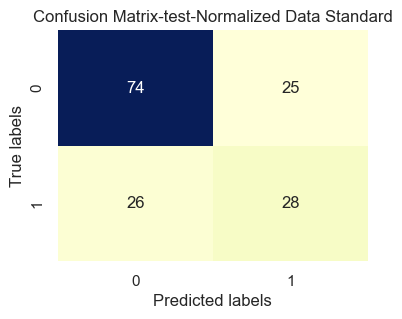

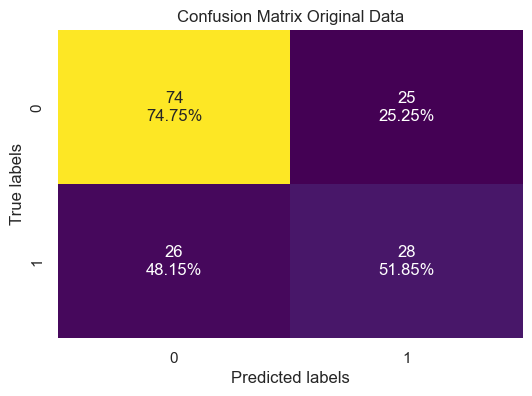

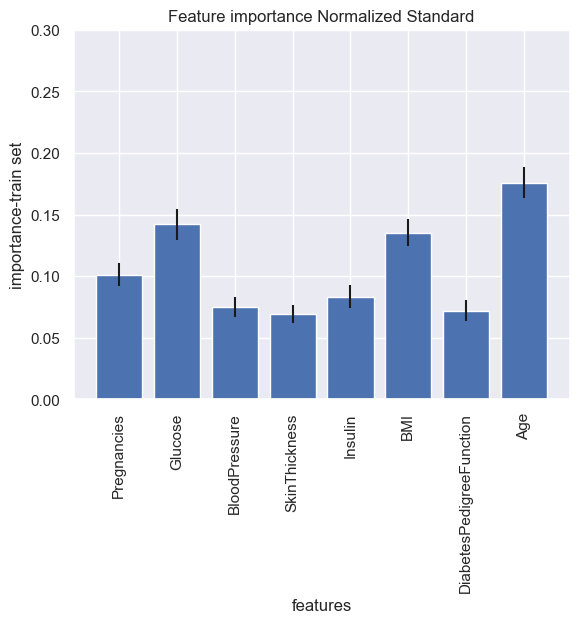

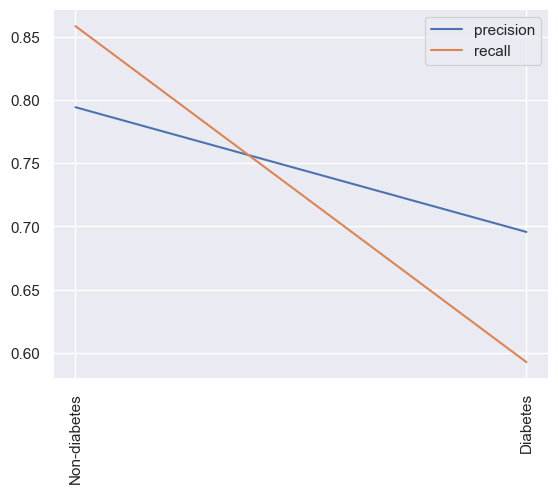

 estimator: 5 depth: 20 test score:0.7189542483660131
 estimator: 5 depth: 20 train score:0.9769736842105263
Accuracy: 0.7189542483660131
Classification Report:
              precision    recall  f1-score   support

         0.0       0.78      0.79      0.78        99
         1.0       0.60      0.59      0.60        54

    accuracy                           0.72       153
   macro avg       0.69      0.69      0.69       153
weighted avg       0.72      0.72      0.72       153



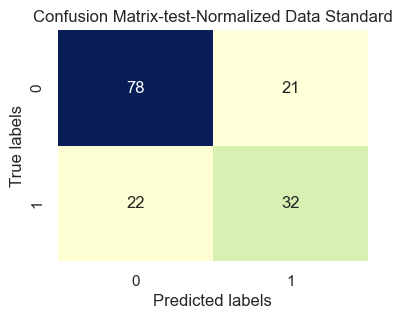

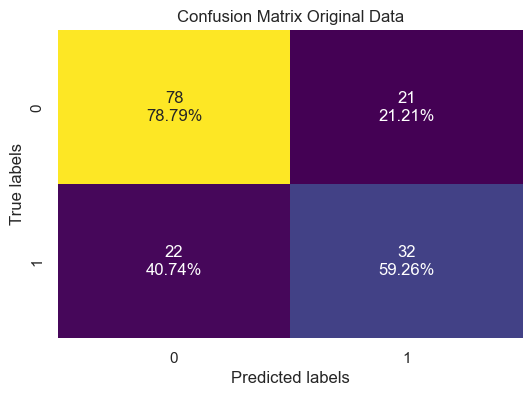

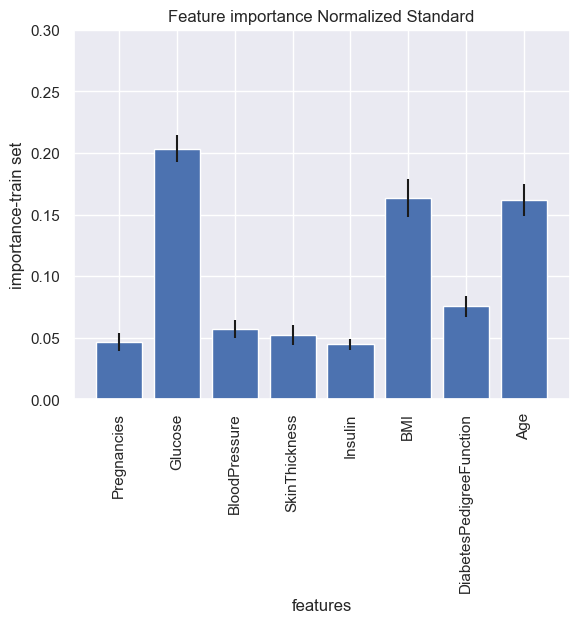

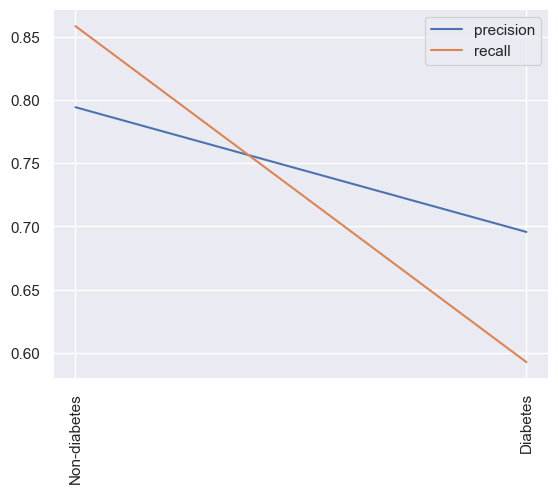

 estimator: 10 depth: 20 test score:0.738562091503268
 estimator: 10 depth: 20 train score:0.9901315789473685
Accuracy: 0.738562091503268
Classification Report:
              precision    recall  f1-score   support

         0.0       0.78      0.83      0.80        99
         1.0       0.65      0.57      0.61        54

    accuracy                           0.74       153
   macro avg       0.71      0.70      0.71       153
weighted avg       0.73      0.74      0.73       153



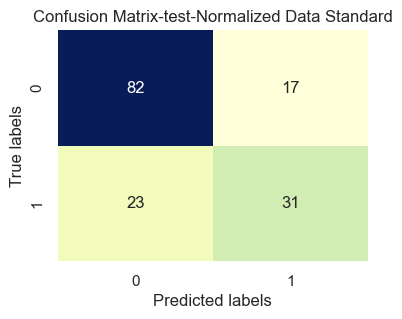

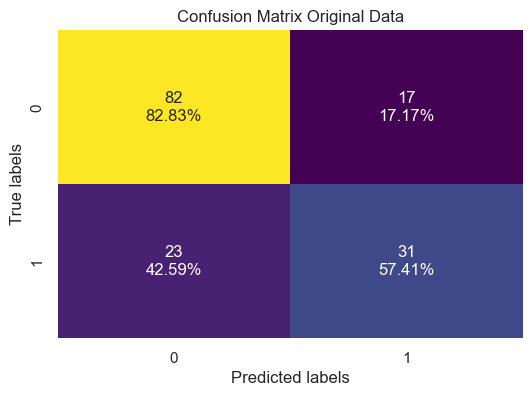

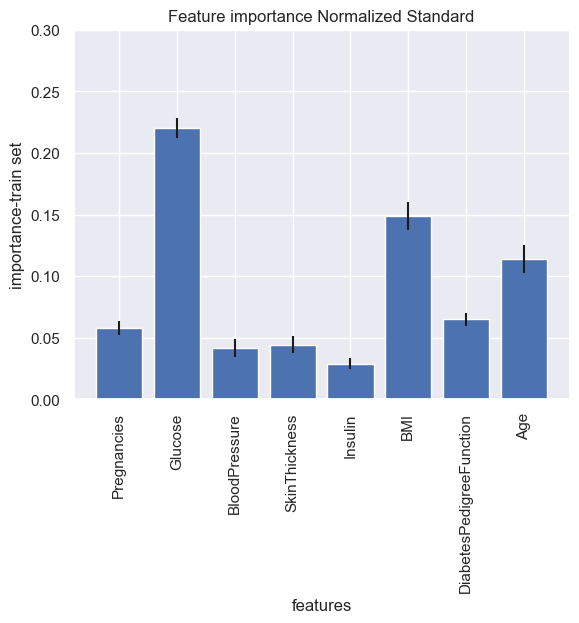

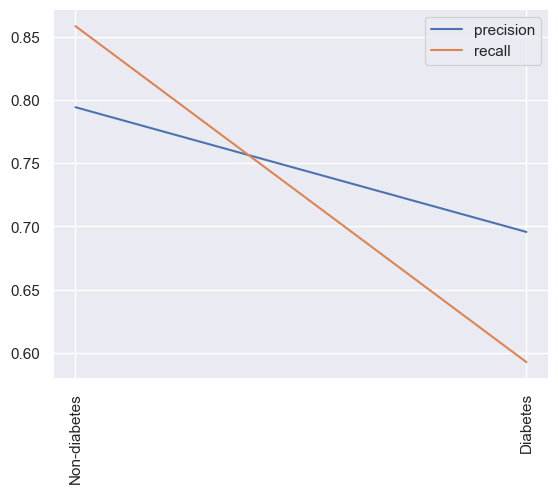

 estimator: 20 depth: 20 test score:0.7516339869281046
 estimator: 20 depth: 20 train score:1.0
Accuracy: 0.7516339869281046
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.83      0.81        99
         1.0       0.66      0.61      0.63        54

    accuracy                           0.75       153
   macro avg       0.73      0.72      0.72       153
weighted avg       0.75      0.75      0.75       153



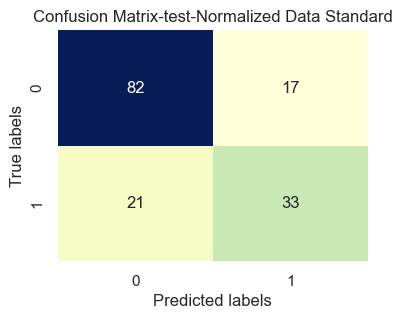

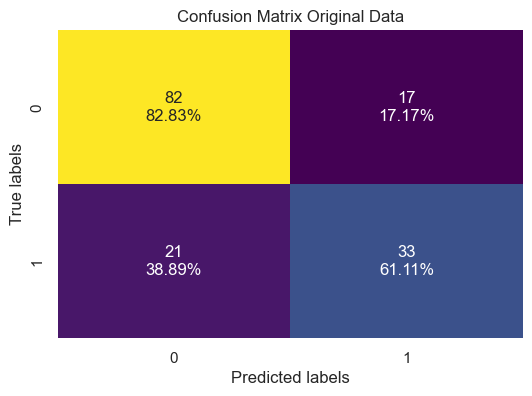

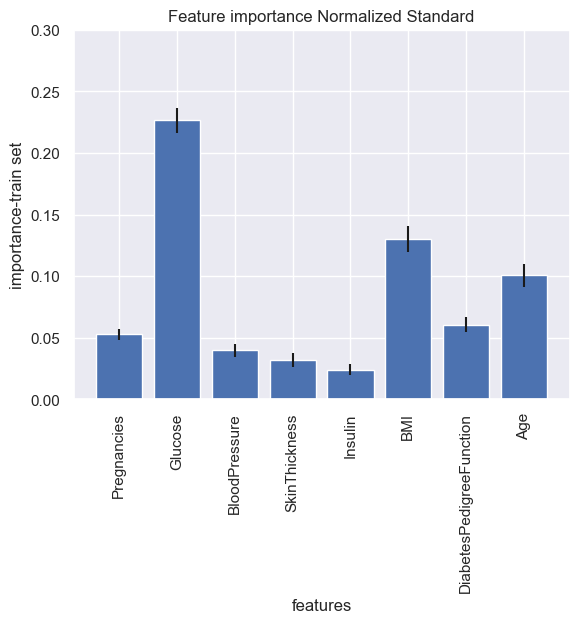

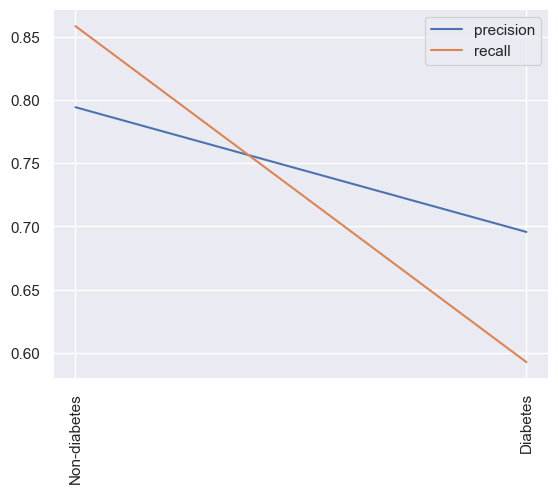

 estimator: 50 depth: 20 test score:0.7647058823529411
 estimator: 50 depth: 20 train score:1.0
Accuracy: 0.7647058823529411
Classification Report:
              precision    recall  f1-score   support

         0.0       0.82      0.82      0.82        99
         1.0       0.67      0.67      0.67        54

    accuracy                           0.76       153
   macro avg       0.74      0.74      0.74       153
weighted avg       0.76      0.76      0.76       153



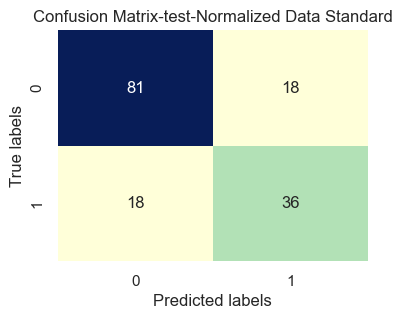

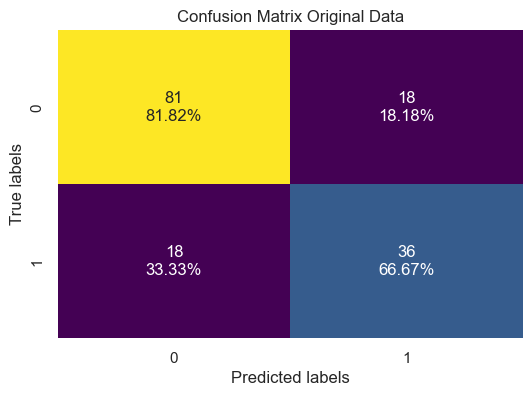

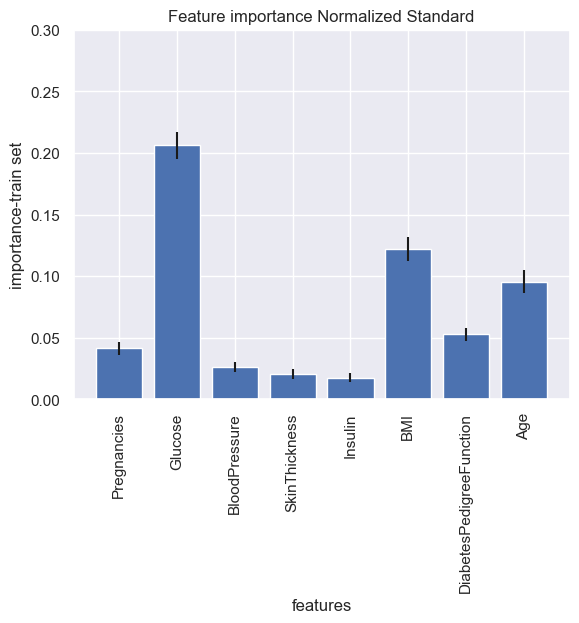

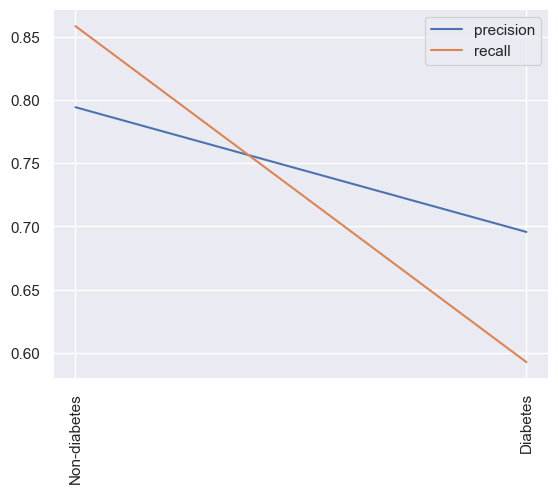

 estimator: 100 depth: 20 test score:0.7516339869281046
 estimator: 100 depth: 20 train score:1.0
Accuracy: 0.7516339869281046
Classification Report:
              precision    recall  f1-score   support

         0.0       0.81      0.81      0.81        99
         1.0       0.65      0.65      0.65        54

    accuracy                           0.75       153
   macro avg       0.73      0.73      0.73       153
weighted avg       0.75      0.75      0.75       153



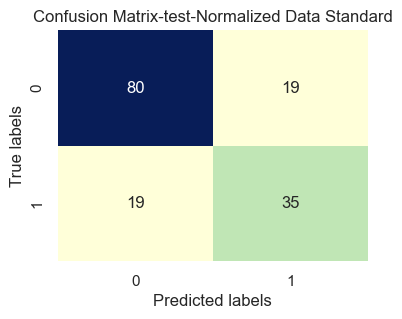

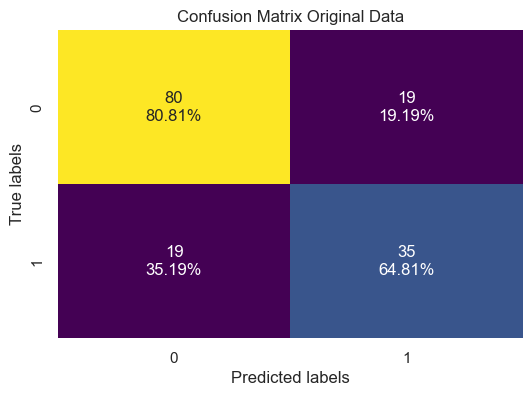

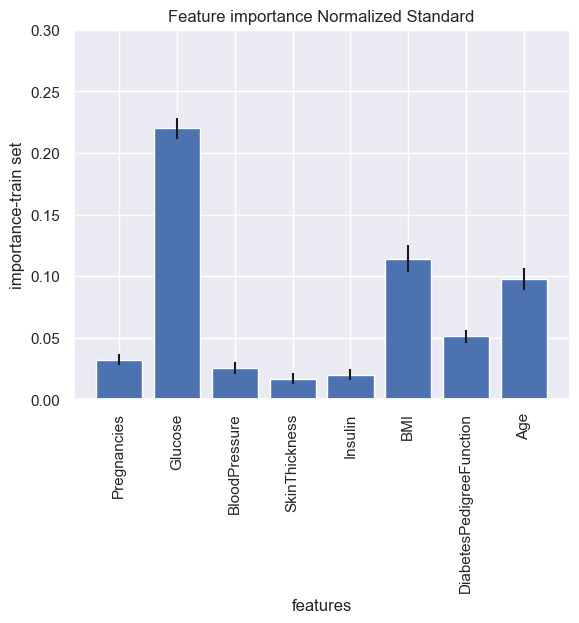

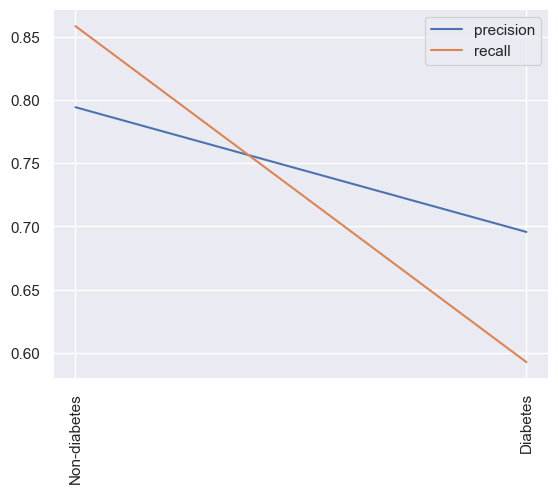

 estimator: 150 depth: 20 test score:0.7843137254901961
 estimator: 150 depth: 20 train score:1.0
Accuracy: 0.7843137254901961
Classification Report:
              precision    recall  f1-score   support

         0.0       0.84      0.83      0.83        99
         1.0       0.69      0.70      0.70        54

    accuracy                           0.78       153
   macro avg       0.76      0.77      0.76       153
weighted avg       0.79      0.78      0.78       153



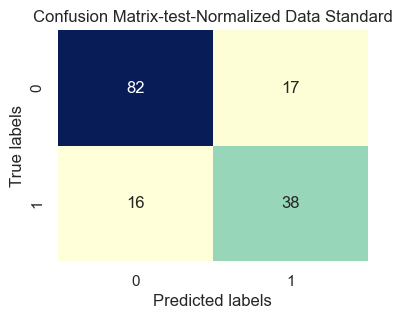

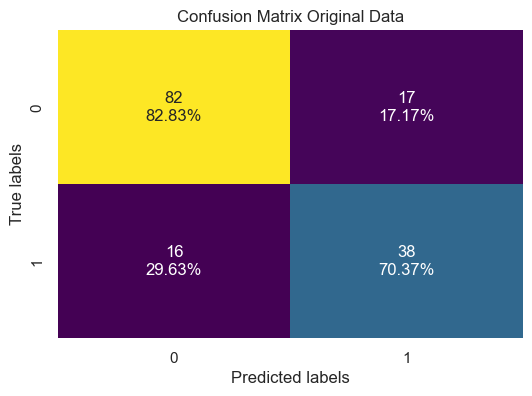

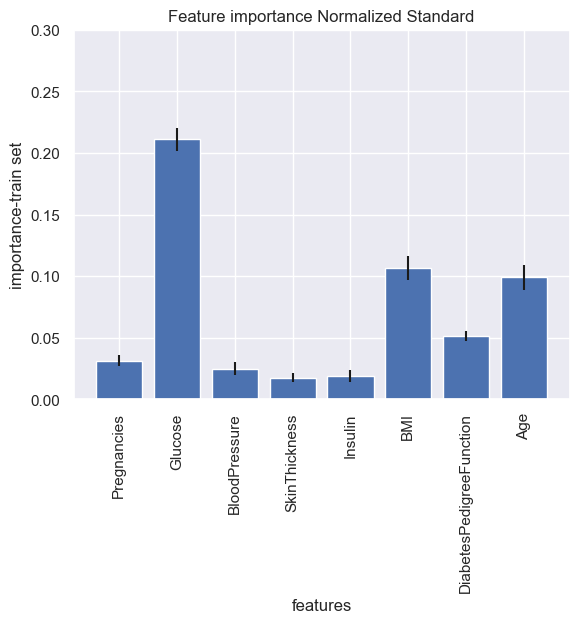

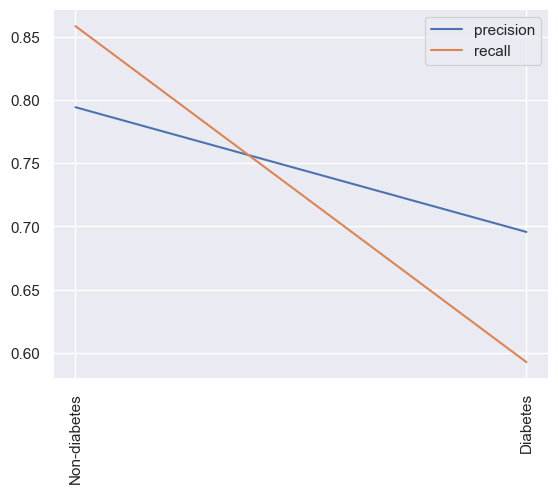

 estimator: 200 depth: 20 test score:0.7777777777777778
 estimator: 200 depth: 20 train score:1.0
Accuracy: 0.7777777777777778
Classification Report:
              precision    recall  f1-score   support

         0.0       0.84      0.82      0.83        99
         1.0       0.68      0.70      0.69        54

    accuracy                           0.78       153
   macro avg       0.76      0.76      0.76       153
weighted avg       0.78      0.78      0.78       153



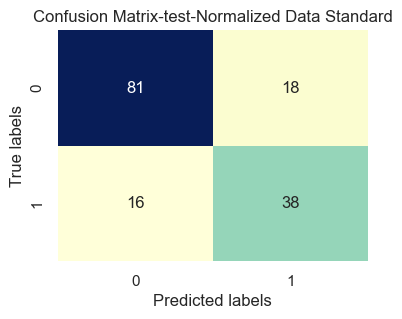

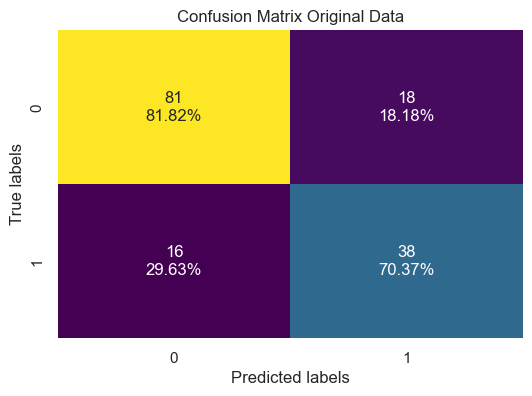

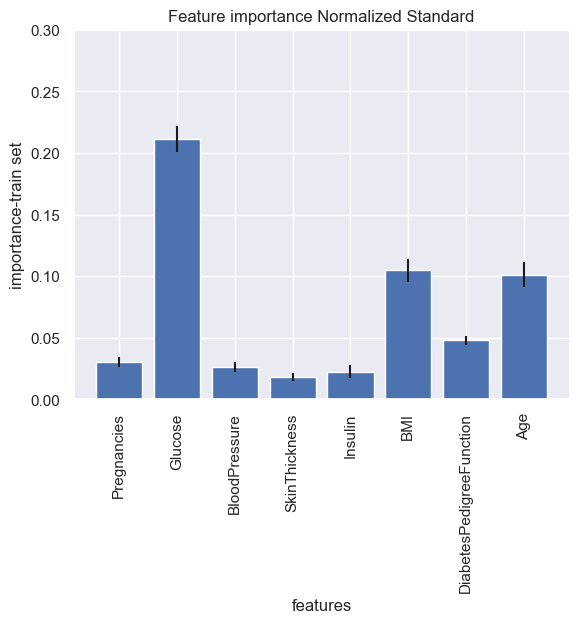

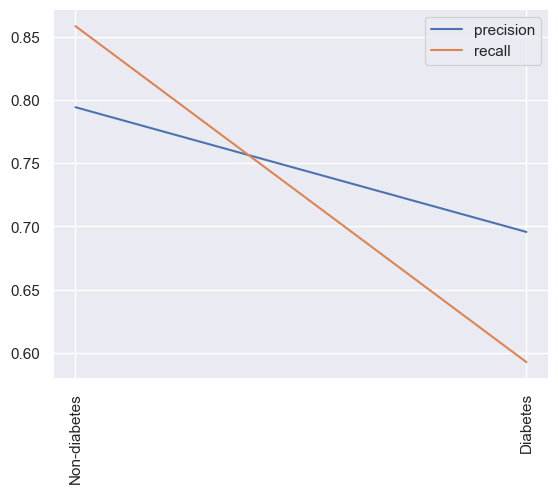

 estimator: 500 depth: 20 test score:0.7712418300653595
 estimator: 500 depth: 20 train score:1.0
Accuracy: 0.7712418300653595
Classification Report:
              precision    recall  f1-score   support

         0.0       0.83      0.82      0.82        99
         1.0       0.67      0.69      0.68        54

    accuracy                           0.77       153
   macro avg       0.75      0.75      0.75       153
weighted avg       0.77      0.77      0.77       153



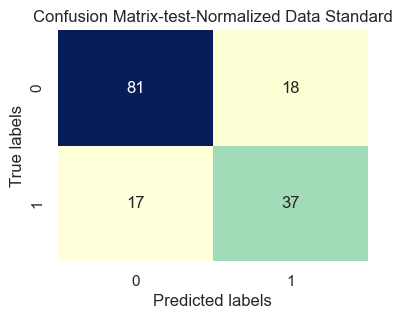

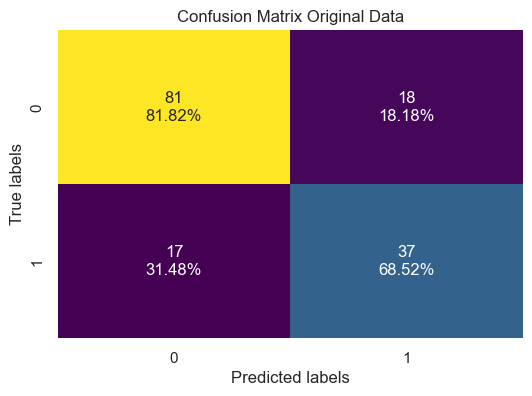

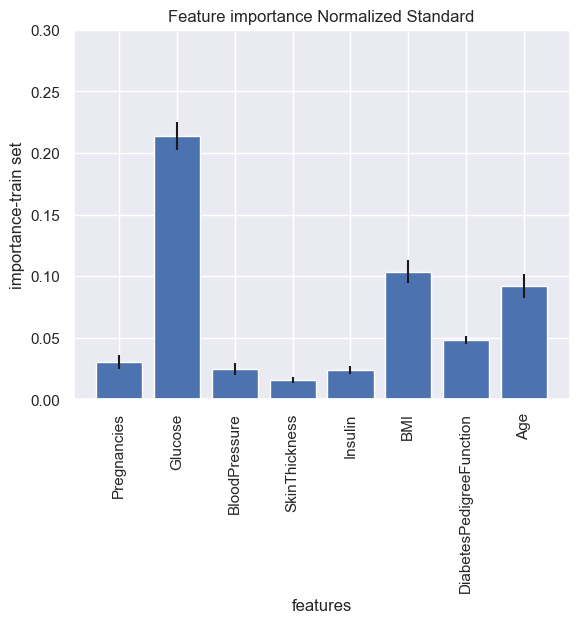

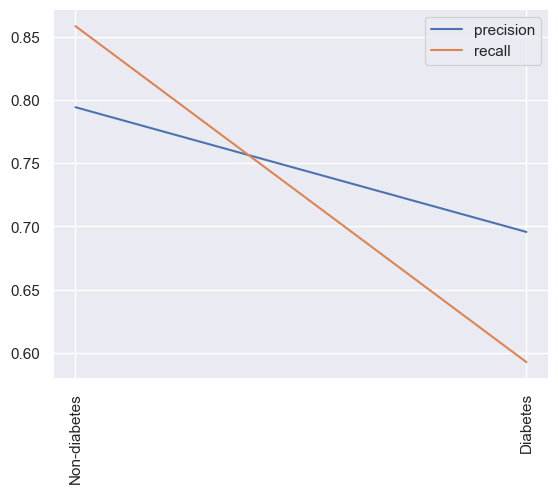

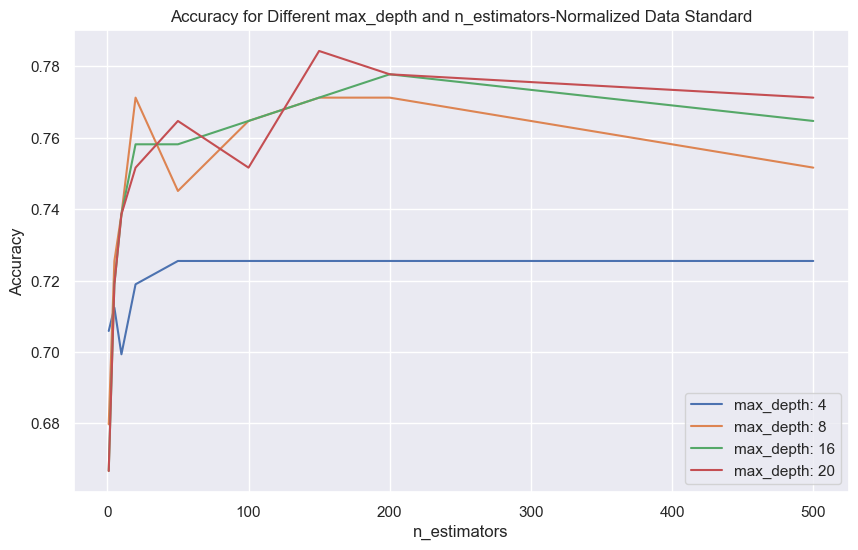

In [35]:
# random forest with normalized values standard:

# split the normalized data set:

x_train, x_test, y_train, y_test = train_test_split(x_scaled_standar, y, test_size=0.2,random_state=42)

from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

accuracies =[]
for m_deph in (4,8,16,20):
    acc_row =[]
    for n_est in (1, 5, 10,20, 50,100,150,200,500): #we are changing the number of estimatores to check
#for n_est in [100]:
# do fit
      rfc= ensemble.RandomForestClassifier(max_depth=m_deph, n_estimators=n_est,random_state=42)
      rfc.fit(x_train, y_train)
   # test different paramethers and take the one that gives the best aqurancy at the end.
    # print the training scores
      print(f' estimator: {n_est} depth: {m_deph} test score:{(rfc.score(x_test, y_test))}')
      print(f' estimator: {n_est} depth: {m_deph} train score:{(rfc.score(x_train, y_train))}')
      y_pred_test = rfc.predict(x_test)
      y_pred_train = rfc.predict(x_train)
    #print(y_pred_test)
       #Evaluate the classifier
      accuracy = accuracy_score(y_test, y_pred_test)
      print(f'Accuracy: {accuracy}')
      acc_row.append(accuracy) 
    
    # Print classification report and confusion matrix
      print("Classification Report:")
      print(classification_report(y_test, y_pred_test))

      #print("Confusion Matrix:")
      #print(confusion_matrix(y_test, y_pred_test))
    
      cm = confusion_matrix(y_test, y_pred_test)

    # Display the confusion matrix
      plt.figure(figsize=(4, 3))
      sns.heatmap(cm, annot=True, fmt='d', cmap='YlGnBu', cbar=False)
      plt.xlabel('Predicted labels')
      plt.ylabel('True labels')
      plt.title('Confusion Matrix-test-Normalized Data Standard')
      plt.show()
    
    
     # Display the confusion matrix with values and percentages
      cm_sum = np.sum(cm, axis=1, keepdims=True)
      cm_percentages = cm / cm_sum.astype(float) * 100
      cm_with_percentages = np.round(cm_percentages, 2)

      plt.figure(figsize=(6, 4))
      sns.heatmap(
      cm,
      annot=np.array([f'{v1}\n{v2}%' for v1, v2 in zip(cm.flatten(), cm_with_percentages.flatten())]).reshape(cm.shape),
      fmt='',
      cmap='viridis',
      cbar=False
       )
      plt.xlabel('Predicted labels')
      plt.ylabel('True labels')
      plt.title('Confusion Matrix Original Data')
      plt.show()
    
    # display important features
      p_importances = permutation_importance(rfc, x_train, y_train, n_repeats=20, n_jobs=-1,random_state=42)

      plt.bar(features,
        p_importances.importances_mean,
        yerr=p_importances.importances_std)
      plt.xticks(rotation=90)
      plt.xlabel('features')
      plt.ylabel('importance-train set')
      plt.title('Feature importance Normalized Standard')
      plt.ylim(0, 0.3)
      plt.show()  


      #print(f'Check that you get the same accuracy from the score method: {np.sum([confusion_test[i,i] for i in range(2)])/np.sum(confusion_test)}')
    #sums the diagonal and divide the whole matrix
      precisions=[]
      recalls=[]
    #precision
      for i in range(2):
        precisions.append(confusion_test[i,i]/np.sum(confusion_test[:,i])) #take the diagonal divided by the whole column
#percentage of positive identified??
#recall
      for i in range(2):
        recalls.append(confusion_test[i,i]/np.sum(confusion_test[i,:])) #take the diagonal and divide by the whole row

      plt.plot(Output_names,precisions, label='precision')
      plt.plot(Output_names,recalls, label='recall')
      plt.xticks(rotation=90)
      plt.legend()
      plt.show()
    
    accuracies.append(acc_row)

    
plt.figure(figsize=(10, 6))
for i, m_deph in enumerate((4, 8, 16, 20)):
    plt.plot((1, 5, 10,20, 50,100,150, 200,500), accuracies[i], label=f"max_depth: {m_deph}")

plt.xlabel("n_estimators")
plt.ylabel("Accuracy")
plt.title("Accuracy for Different max_depth and n_estimators-Normalized Data Standard")
plt.legend()
plt.show()

 
    
    

In [41]:
print(x_train)

[[ 0.34409332  0.5622093   0.626615   ... -0.1240339  -0.34101954
  -0.707055  ]
 [-0.24968223 -0.35837442 -1.1849526  ... -0.42828363 -0.13301855
  -0.9619029 ]
 [ 0.64098114  1.3184031  -0.8555767  ... -1.1816638  -0.89267427
   1.4166775 ]
 ...
 [ 0.9378689  -0.48988637  0.13255109 ... -0.4137955  -0.6635717
  -0.19735922]
 [-0.84345776 -0.12822849 -1.1849526  ...  0.12226328 -0.6424702
  -0.8769536 ]
 [-0.24968223 -0.85154426 -1.3496406  ... -1.1237113   1.4164379
   0.4822352 ]]


 estimator: 1 depth: 4 test score:0.7058823529411765
 estimator: 1 depth: 4 train score:0.7730263157894737
Accuracy: 0.7058823529411765
Classification Report:
              precision    recall  f1-score   support

         0.0       0.76      0.79      0.78        99
         1.0       0.59      0.56      0.57        54

    accuracy                           0.71       153
   macro avg       0.68      0.67      0.67       153
weighted avg       0.70      0.71      0.70       153



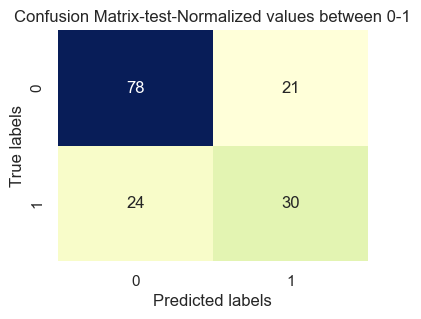

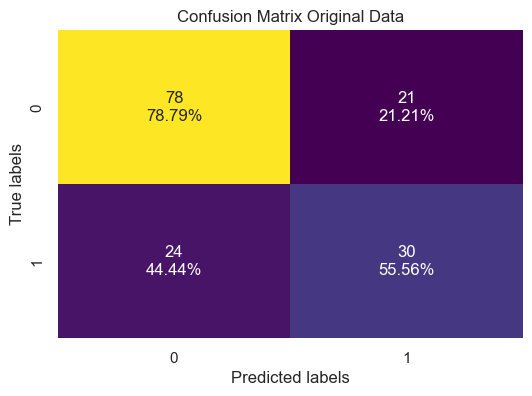

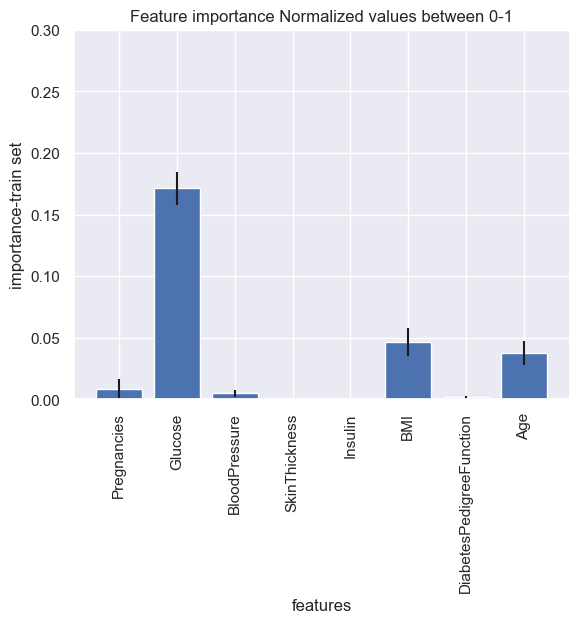

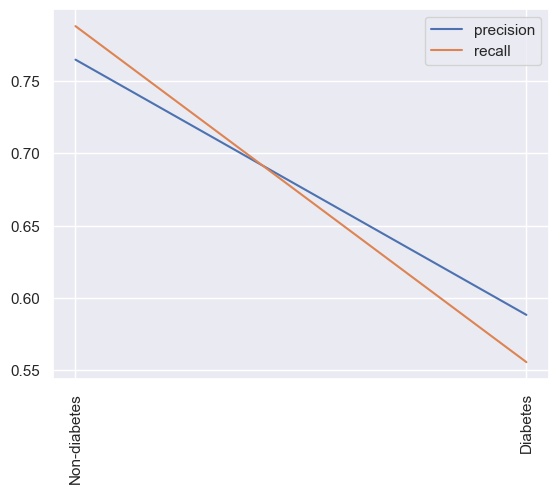

 estimator: 5 depth: 4 test score:0.7124183006535948
 estimator: 5 depth: 4 train score:0.8223684210526315
Accuracy: 0.7124183006535948
Classification Report:
              precision    recall  f1-score   support

         0.0       0.76      0.81      0.78        99
         1.0       0.60      0.54      0.57        54

    accuracy                           0.71       153
   macro avg       0.68      0.67      0.68       153
weighted avg       0.71      0.71      0.71       153



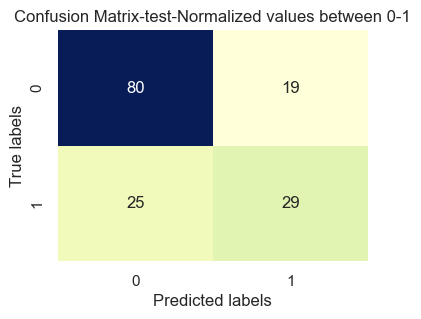

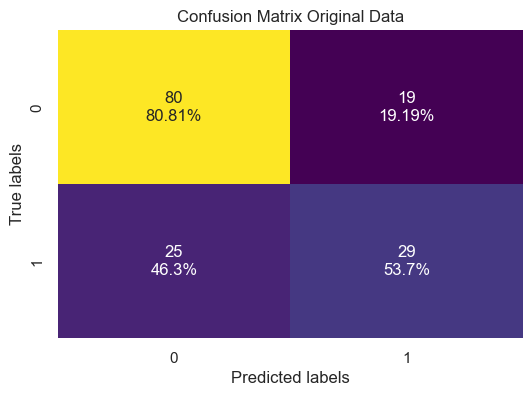

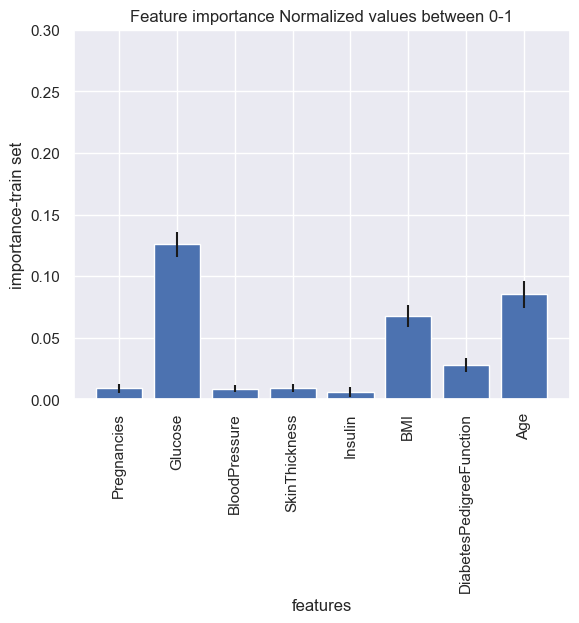

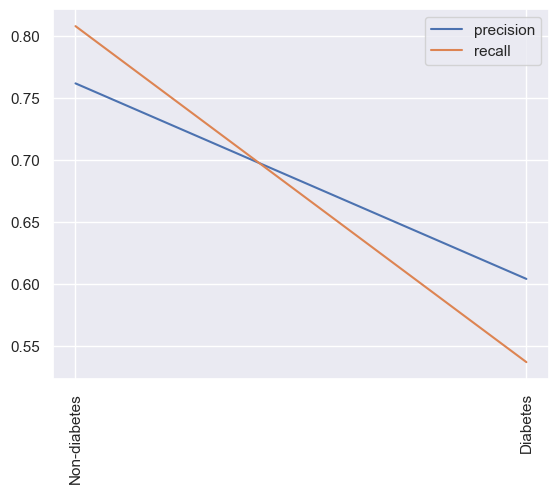

 estimator: 10 depth: 4 test score:0.6993464052287581
 estimator: 10 depth: 4 train score:0.8174342105263158
Accuracy: 0.6993464052287581
Classification Report:
              precision    recall  f1-score   support

         0.0       0.74      0.83      0.78        99
         1.0       0.60      0.46      0.52        54

    accuracy                           0.70       153
   macro avg       0.67      0.65      0.65       153
weighted avg       0.69      0.70      0.69       153



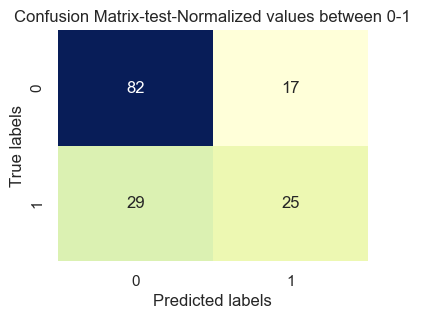

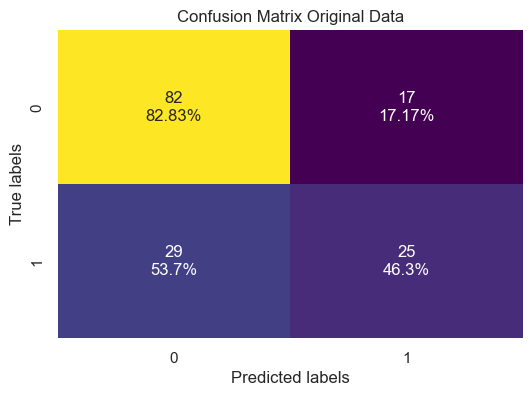

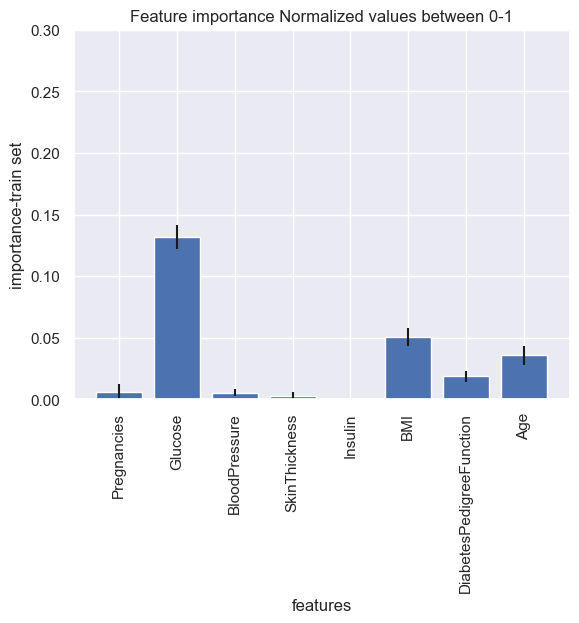

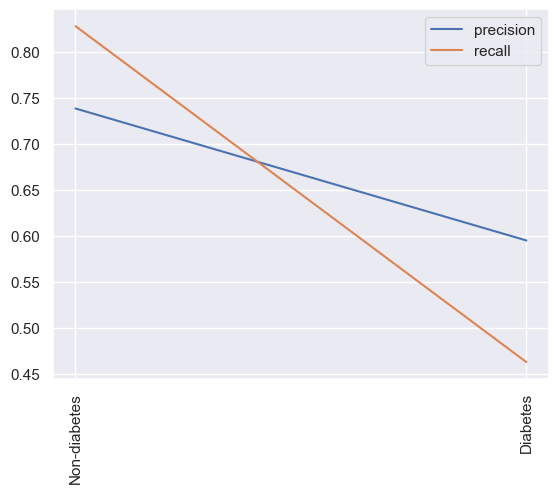

 estimator: 20 depth: 4 test score:0.7189542483660131
 estimator: 20 depth: 4 train score:0.8223684210526315
Accuracy: 0.7189542483660131
Classification Report:
              precision    recall  f1-score   support

         0.0       0.75      0.85      0.80        99
         1.0       0.63      0.48      0.55        54

    accuracy                           0.72       153
   macro avg       0.69      0.66      0.67       153
weighted avg       0.71      0.72      0.71       153



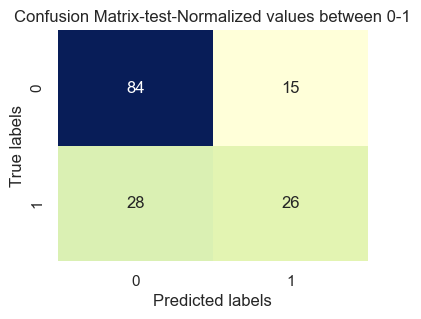

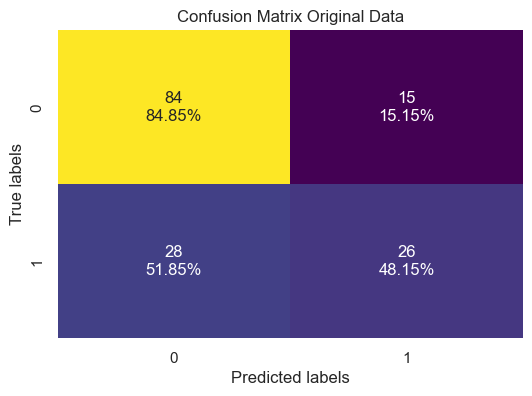

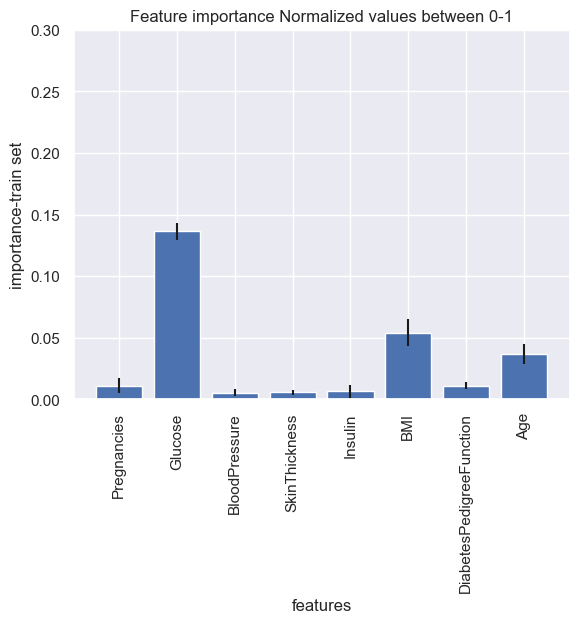

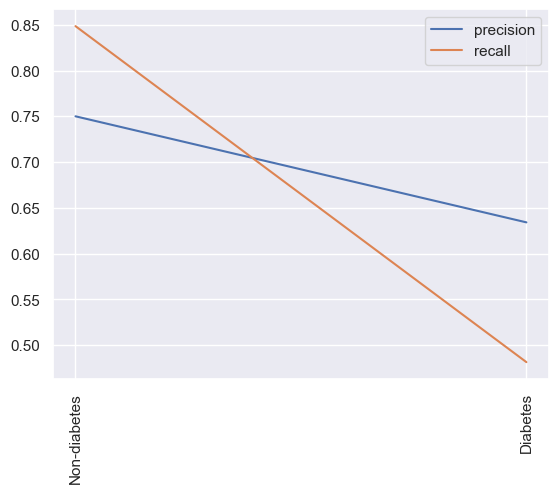

 estimator: 50 depth: 4 test score:0.7254901960784313
 estimator: 50 depth: 4 train score:0.8289473684210527
Accuracy: 0.7254901960784313
Classification Report:
              precision    recall  f1-score   support

         0.0       0.76      0.85      0.80        99
         1.0       0.64      0.50      0.56        54

    accuracy                           0.73       153
   macro avg       0.70      0.67      0.68       153
weighted avg       0.72      0.73      0.72       153



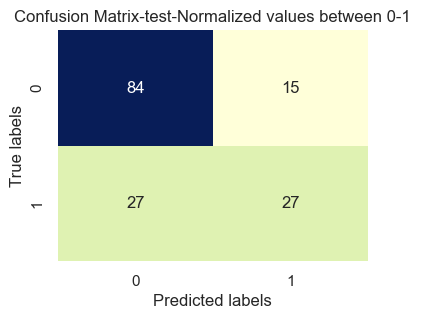

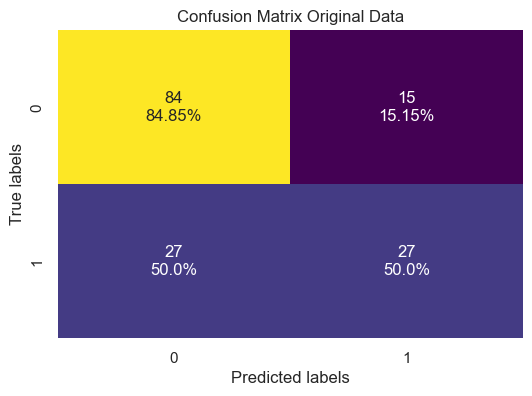

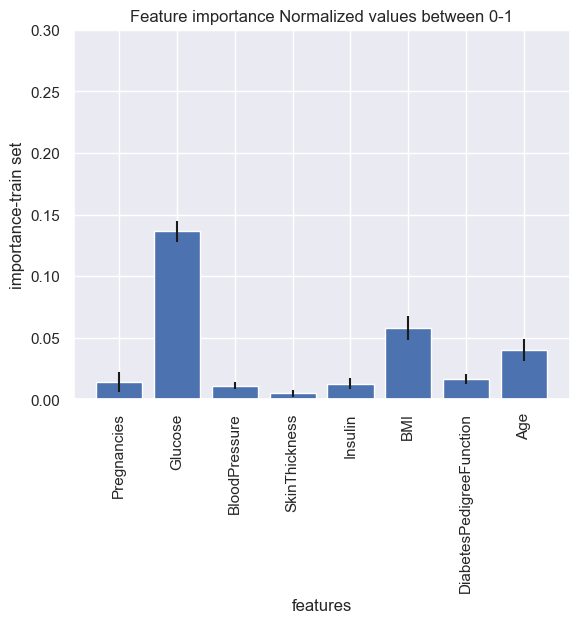

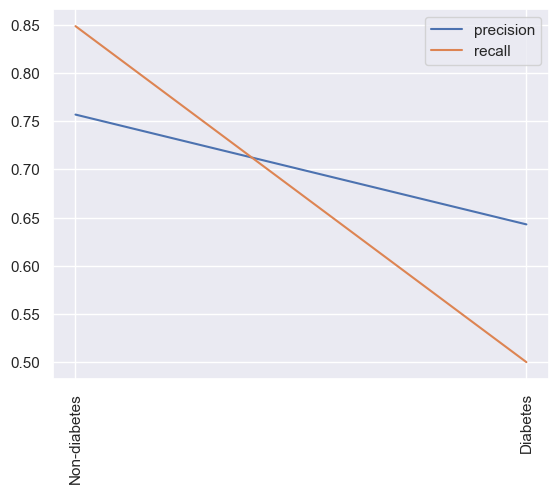

 estimator: 100 depth: 4 test score:0.7254901960784313
 estimator: 100 depth: 4 train score:0.8256578947368421
Accuracy: 0.7254901960784313
Classification Report:
              precision    recall  f1-score   support

         0.0       0.77      0.83      0.80        99
         1.0       0.63      0.54      0.58        54

    accuracy                           0.73       153
   macro avg       0.70      0.68      0.69       153
weighted avg       0.72      0.73      0.72       153



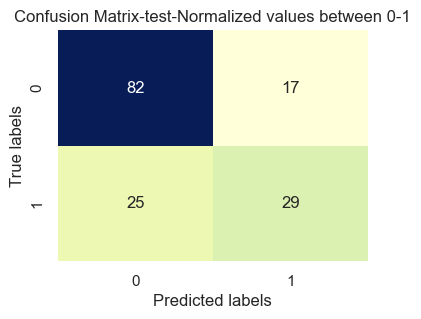

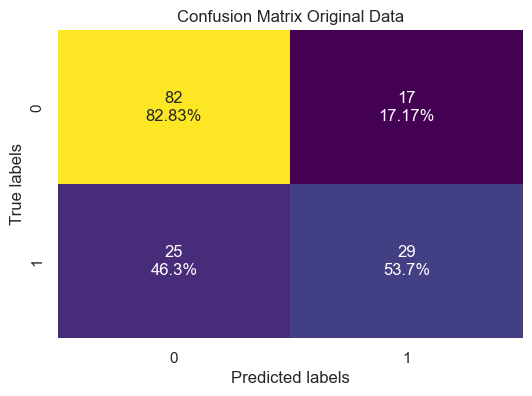

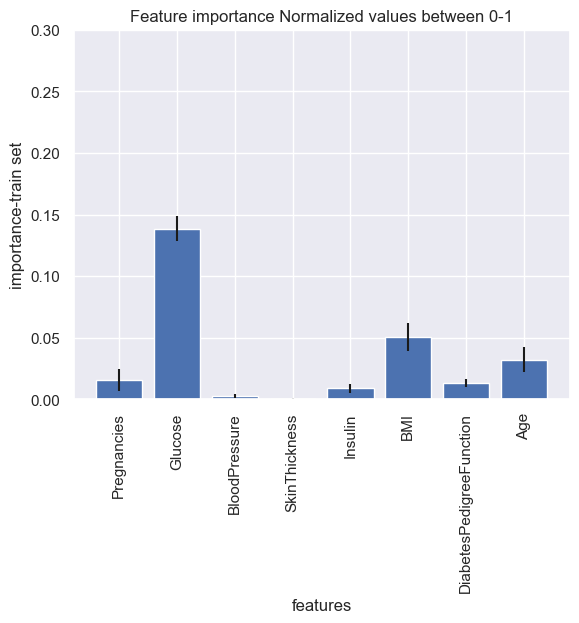

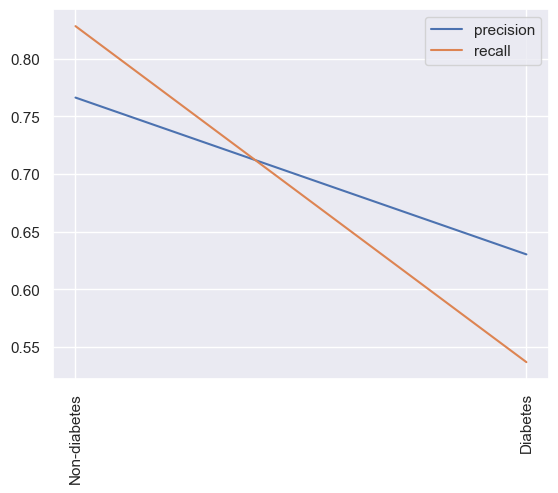

 estimator: 150 depth: 4 test score:0.7254901960784313
 estimator: 150 depth: 4 train score:0.8256578947368421
Accuracy: 0.7254901960784313
Classification Report:
              precision    recall  f1-score   support

         0.0       0.77      0.83      0.80        99
         1.0       0.63      0.54      0.58        54

    accuracy                           0.73       153
   macro avg       0.70      0.68      0.69       153
weighted avg       0.72      0.73      0.72       153



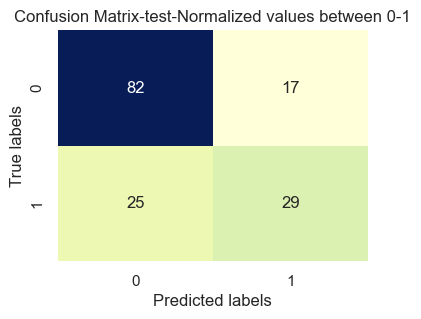

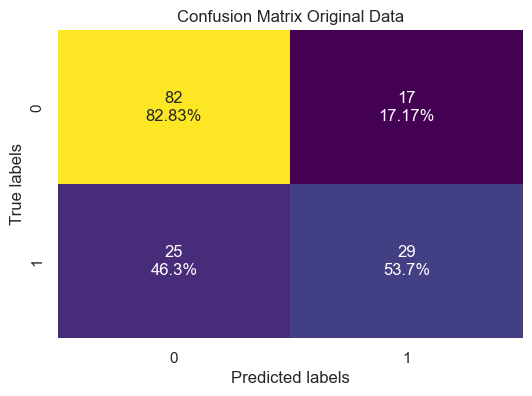

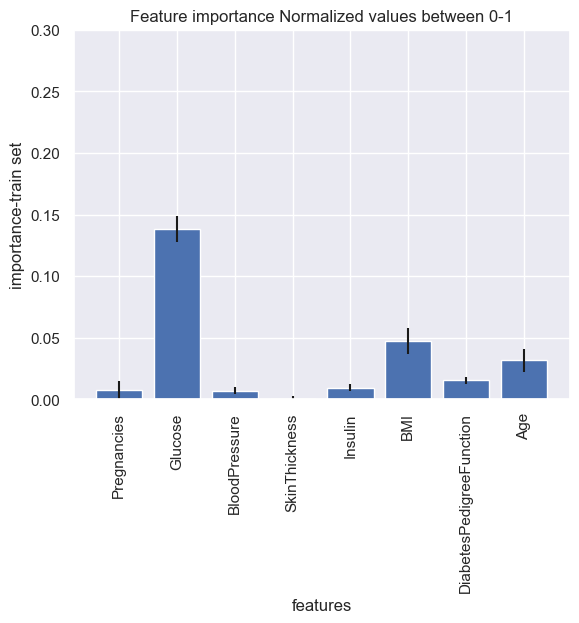

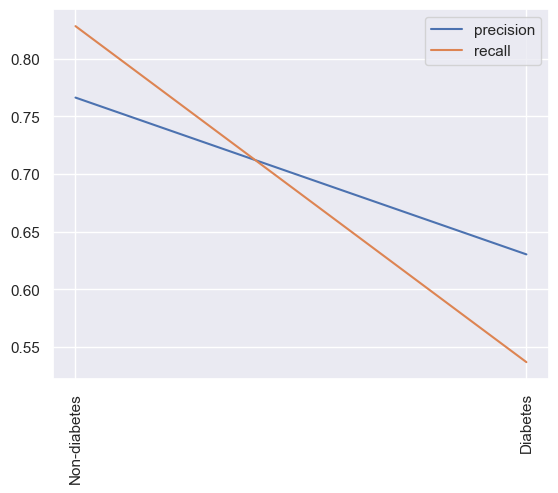

 estimator: 200 depth: 4 test score:0.7254901960784313
 estimator: 200 depth: 4 train score:0.8256578947368421
Accuracy: 0.7254901960784313
Classification Report:
              precision    recall  f1-score   support

         0.0       0.77      0.83      0.80        99
         1.0       0.63      0.54      0.58        54

    accuracy                           0.73       153
   macro avg       0.70      0.68      0.69       153
weighted avg       0.72      0.73      0.72       153



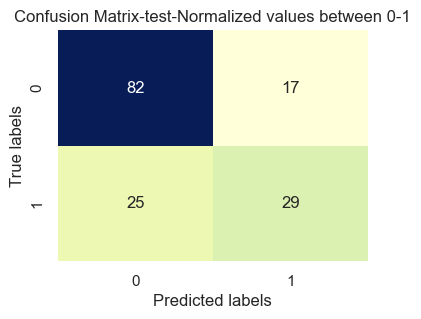

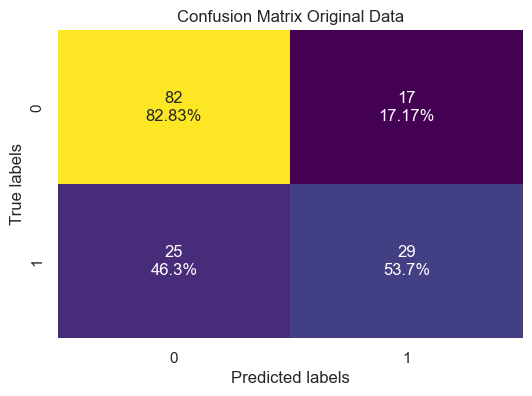

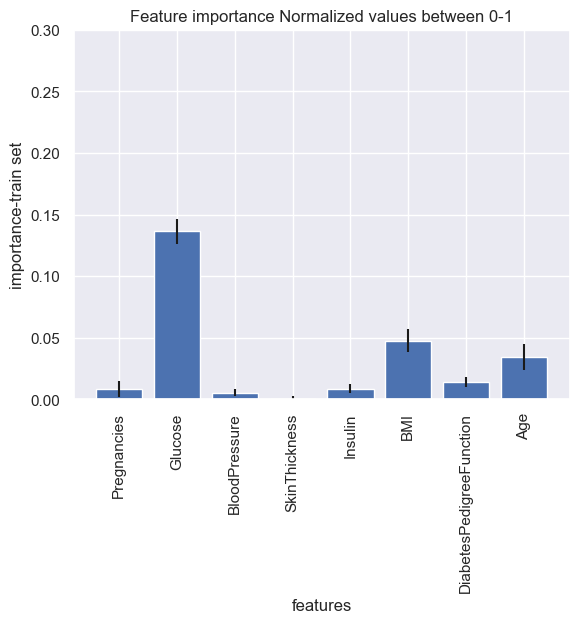

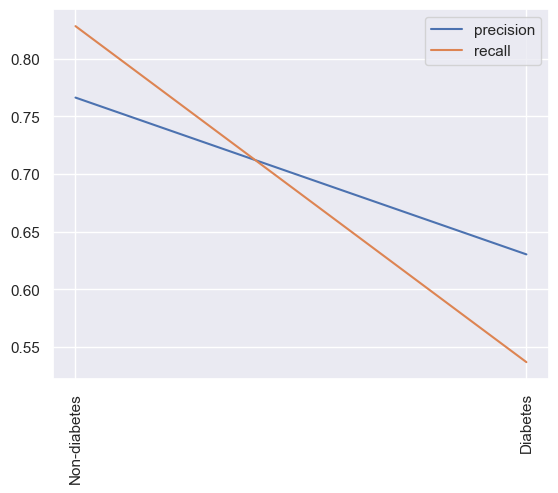

 estimator: 500 depth: 4 test score:0.7254901960784313
 estimator: 500 depth: 4 train score:0.8256578947368421
Accuracy: 0.7254901960784313
Classification Report:
              precision    recall  f1-score   support

         0.0       0.77      0.83      0.80        99
         1.0       0.63      0.54      0.58        54

    accuracy                           0.73       153
   macro avg       0.70      0.68      0.69       153
weighted avg       0.72      0.73      0.72       153



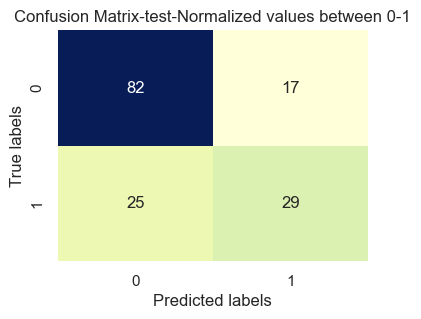

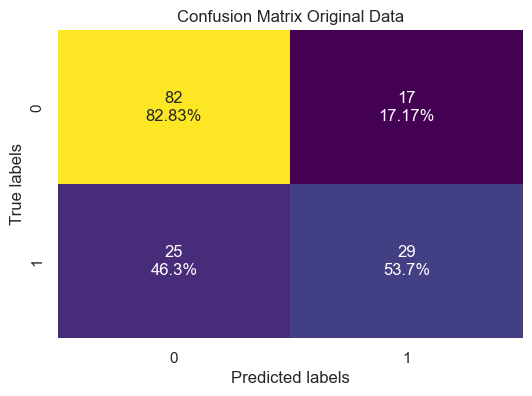

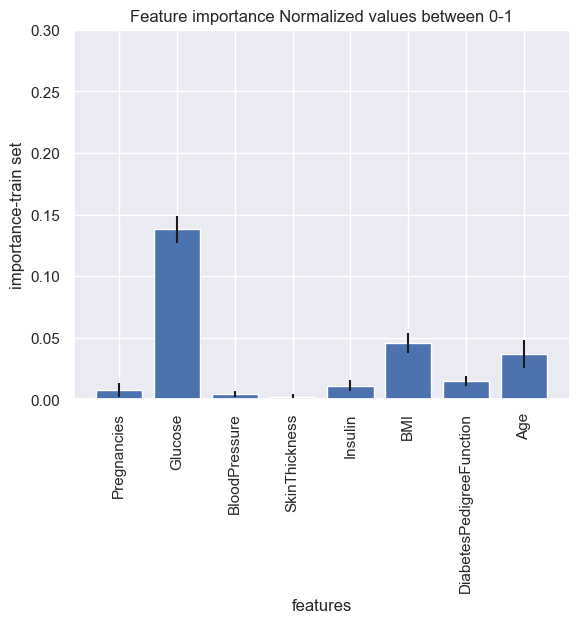

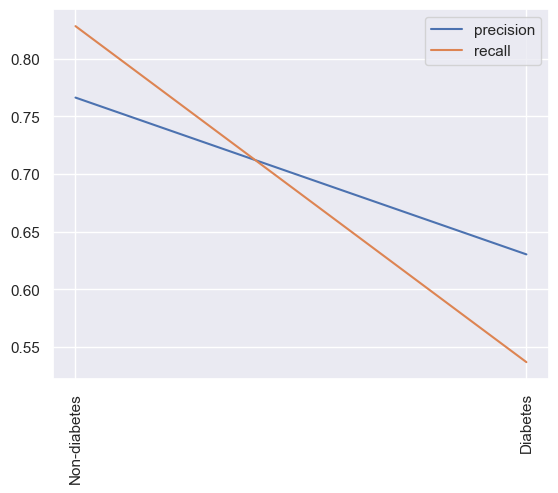

 estimator: 1 depth: 8 test score:0.673202614379085
 estimator: 1 depth: 8 train score:0.837171052631579
Accuracy: 0.673202614379085
Classification Report:
              precision    recall  f1-score   support

         0.0       0.73      0.79      0.76        99
         1.0       0.54      0.46      0.50        54

    accuracy                           0.67       153
   macro avg       0.64      0.63      0.63       153
weighted avg       0.66      0.67      0.67       153



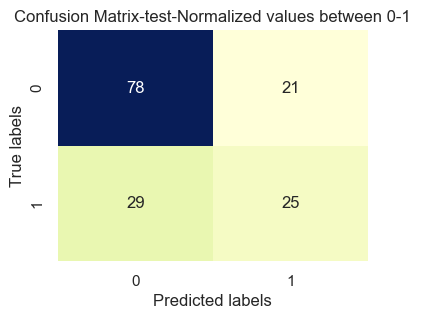

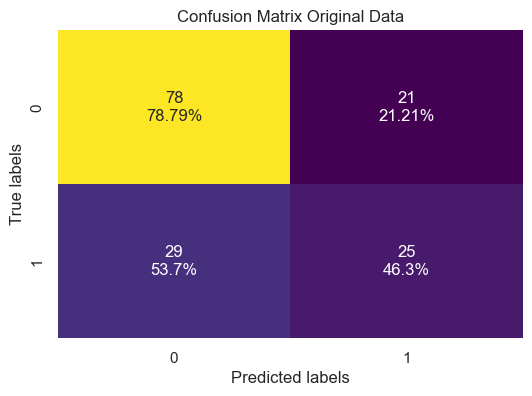

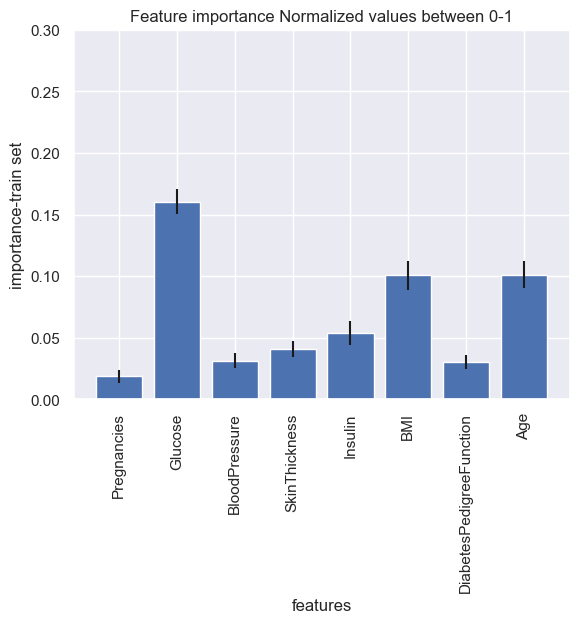

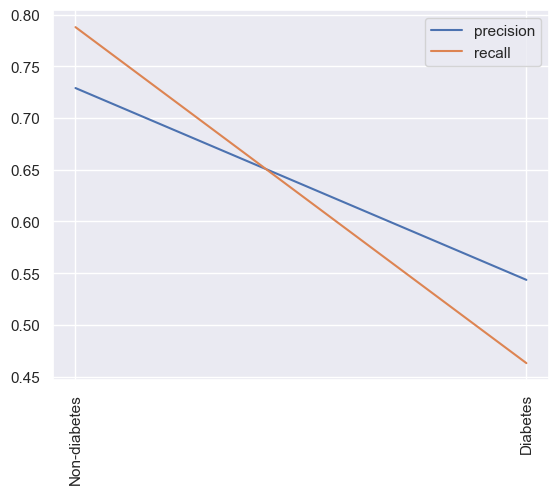

 estimator: 5 depth: 8 test score:0.7254901960784313
 estimator: 5 depth: 8 train score:0.9276315789473685
Accuracy: 0.7254901960784313
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.77      0.78        99
         1.0       0.60      0.65      0.62        54

    accuracy                           0.73       153
   macro avg       0.70      0.71      0.70       153
weighted avg       0.73      0.73      0.73       153



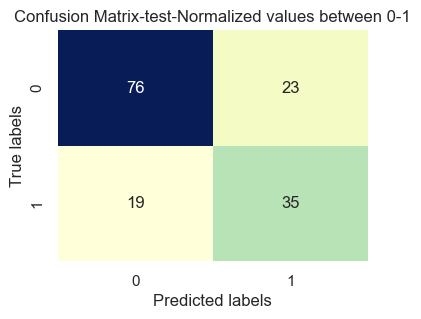

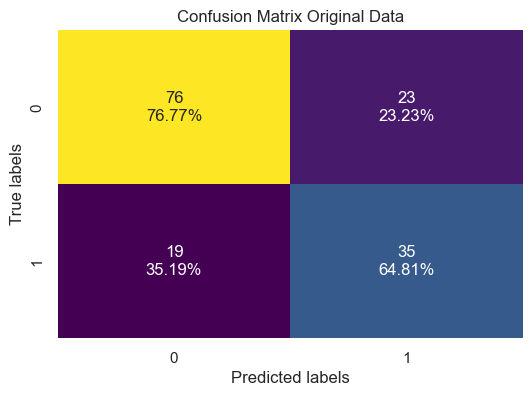

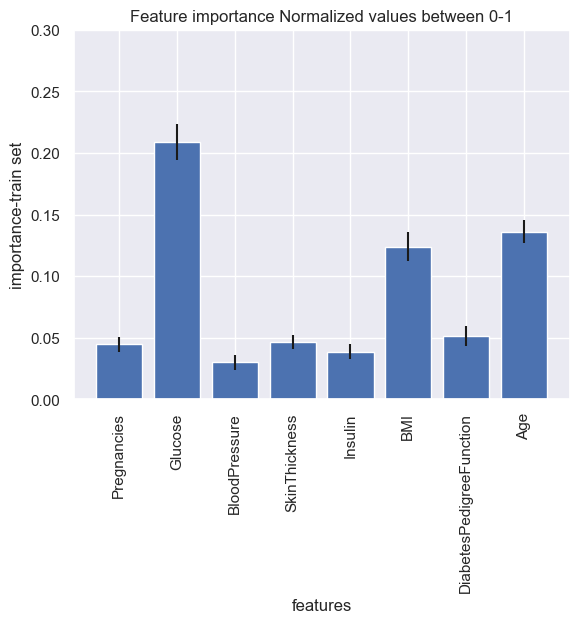

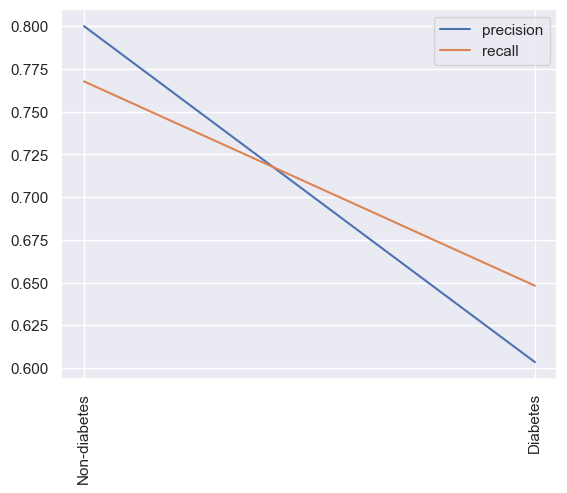

 estimator: 10 depth: 8 test score:0.738562091503268
 estimator: 10 depth: 8 train score:0.944078947368421
Accuracy: 0.738562091503268
Classification Report:
              precision    recall  f1-score   support

         0.0       0.78      0.83      0.80        99
         1.0       0.65      0.57      0.61        54

    accuracy                           0.74       153
   macro avg       0.71      0.70      0.71       153
weighted avg       0.73      0.74      0.73       153



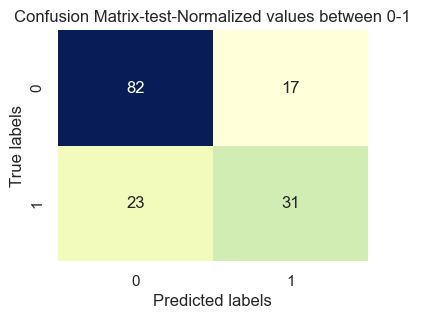

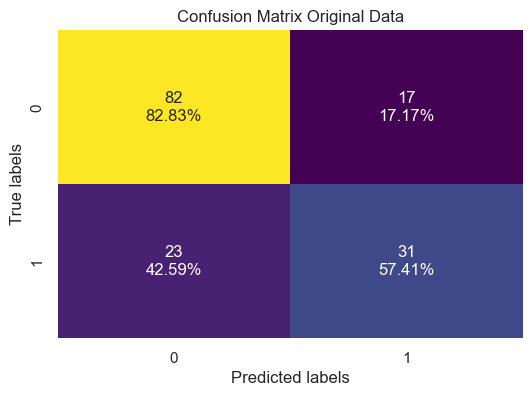

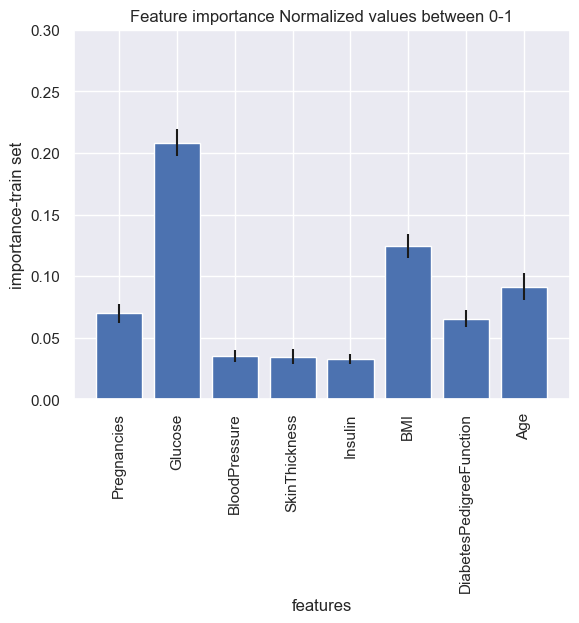

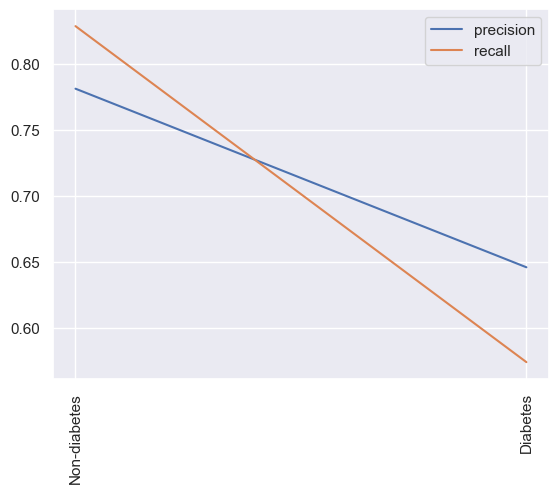

 estimator: 20 depth: 8 test score:0.7712418300653595
 estimator: 20 depth: 8 train score:0.9555921052631579
Accuracy: 0.7712418300653595
Classification Report:
              precision    recall  f1-score   support

         0.0       0.81      0.85      0.83        99
         1.0       0.69      0.63      0.66        54

    accuracy                           0.77       153
   macro avg       0.75      0.74      0.74       153
weighted avg       0.77      0.77      0.77       153



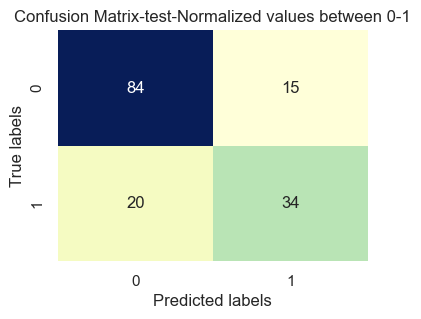

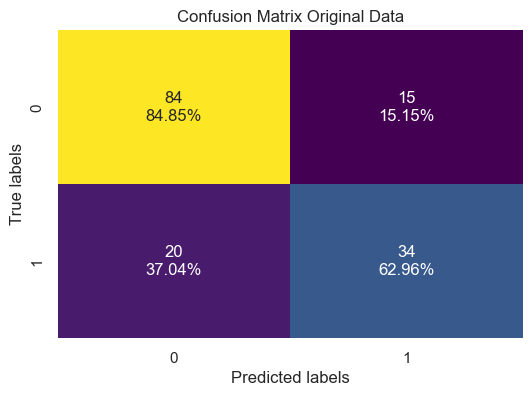

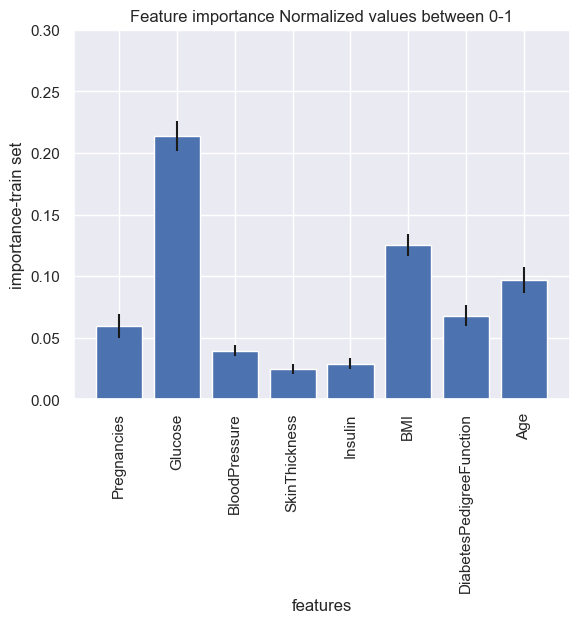

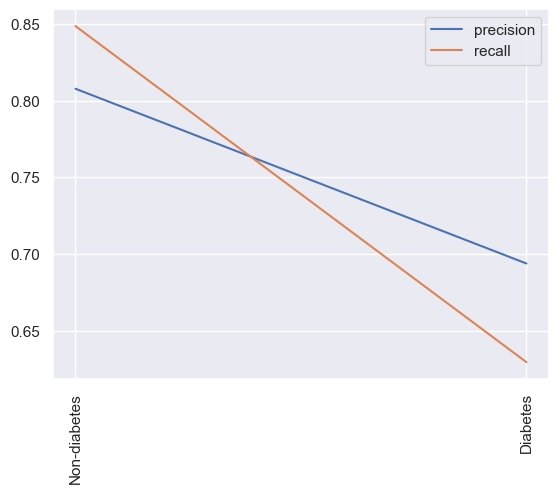

 estimator: 50 depth: 8 test score:0.7450980392156863
 estimator: 50 depth: 8 train score:0.9588815789473685
Accuracy: 0.7450980392156863
Classification Report:
              precision    recall  f1-score   support

         0.0       0.78      0.84      0.81        99
         1.0       0.66      0.57      0.61        54

    accuracy                           0.75       153
   macro avg       0.72      0.71      0.71       153
weighted avg       0.74      0.75      0.74       153



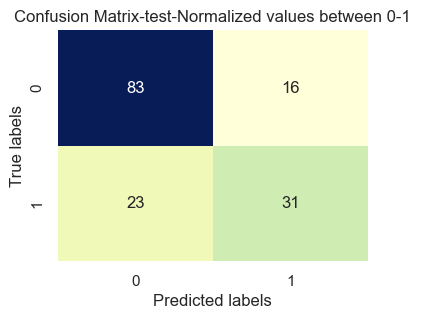

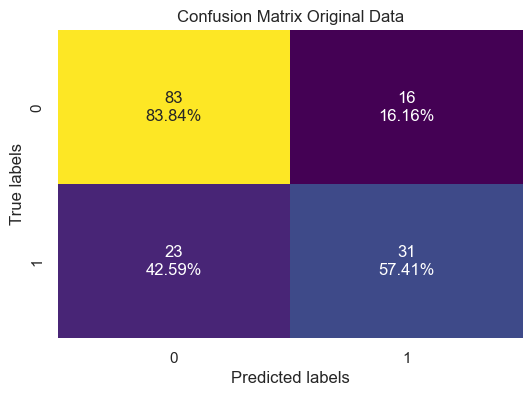

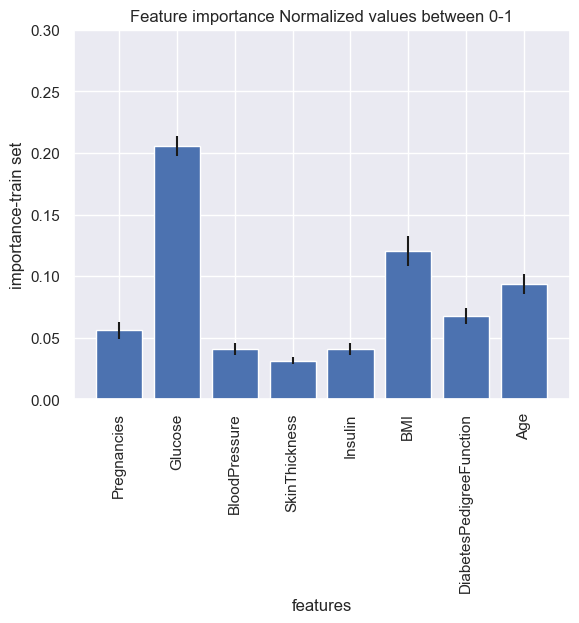

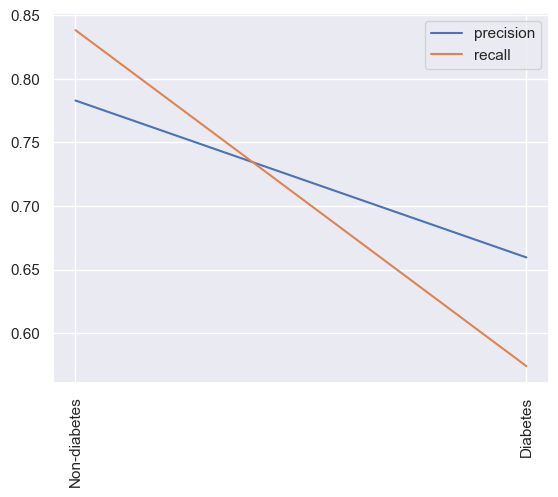

 estimator: 100 depth: 8 test score:0.7647058823529411
 estimator: 100 depth: 8 train score:0.9638157894736842
Accuracy: 0.7647058823529411
Classification Report:
              precision    recall  f1-score   support

         0.0       0.81      0.83      0.82        99
         1.0       0.67      0.65      0.66        54

    accuracy                           0.76       153
   macro avg       0.74      0.74      0.74       153
weighted avg       0.76      0.76      0.76       153



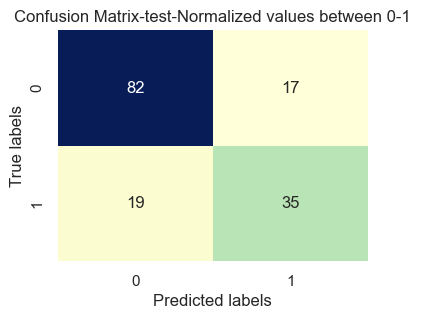

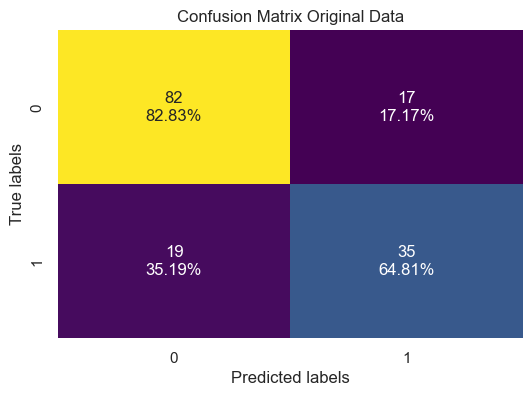

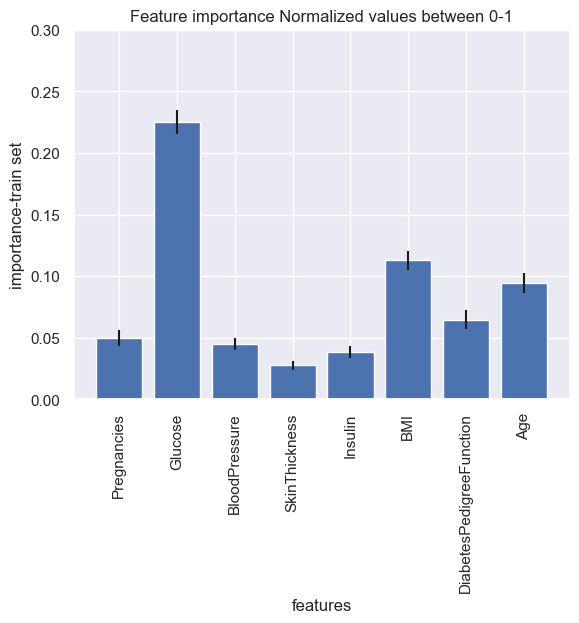

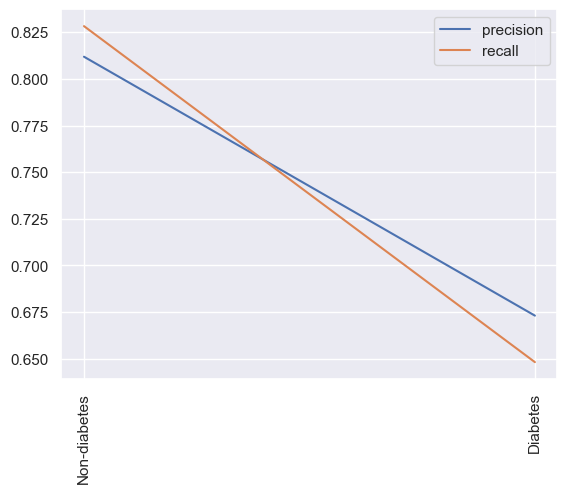

 estimator: 150 depth: 8 test score:0.7777777777777778
 estimator: 150 depth: 8 train score:0.9638157894736842
Accuracy: 0.7777777777777778
Classification Report:
              precision    recall  f1-score   support

         0.0       0.83      0.83      0.83        99
         1.0       0.69      0.69      0.69        54

    accuracy                           0.78       153
   macro avg       0.76      0.76      0.76       153
weighted avg       0.78      0.78      0.78       153



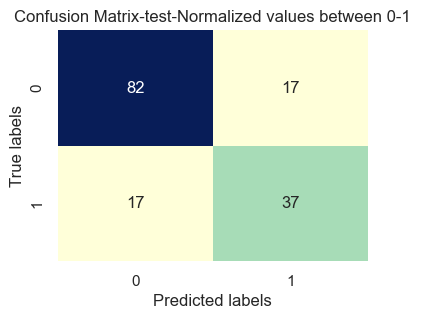

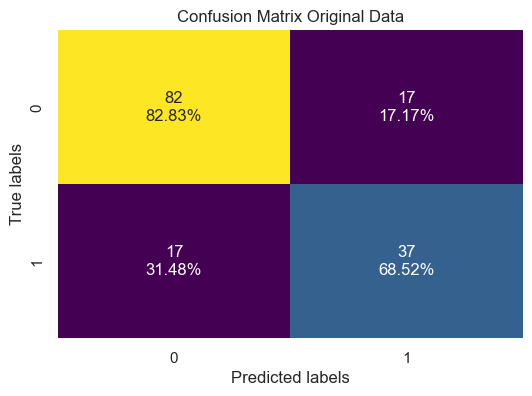

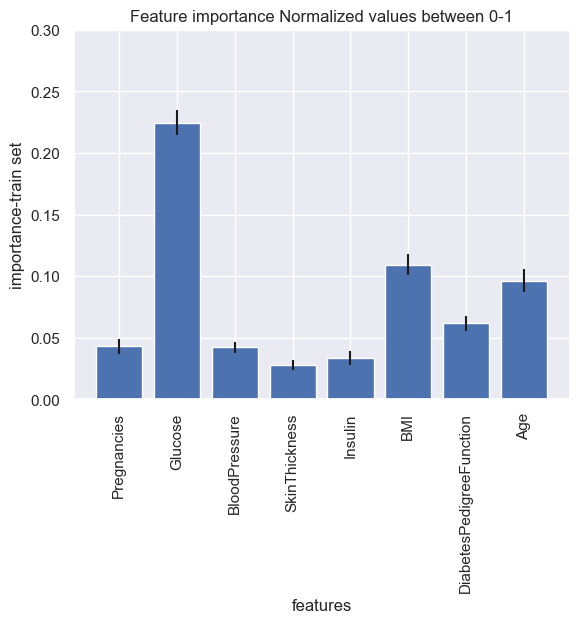

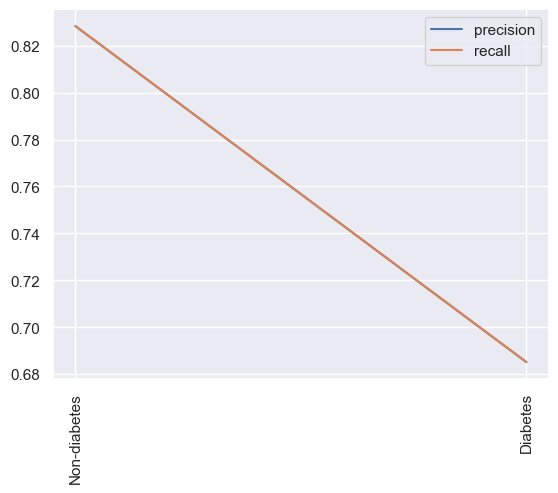

 estimator: 200 depth: 8 test score:0.7777777777777778
 estimator: 200 depth: 8 train score:0.9671052631578947
Accuracy: 0.7777777777777778
Classification Report:
              precision    recall  f1-score   support

         0.0       0.83      0.83      0.83        99
         1.0       0.69      0.69      0.69        54

    accuracy                           0.78       153
   macro avg       0.76      0.76      0.76       153
weighted avg       0.78      0.78      0.78       153



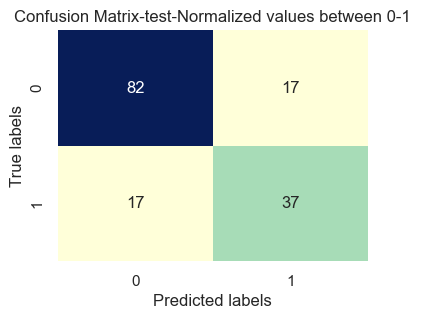

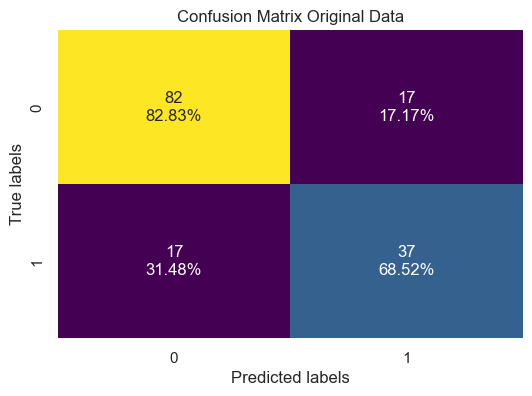

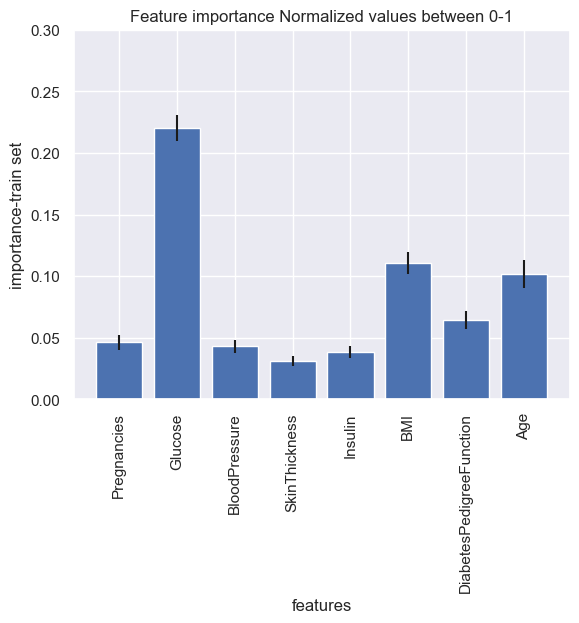

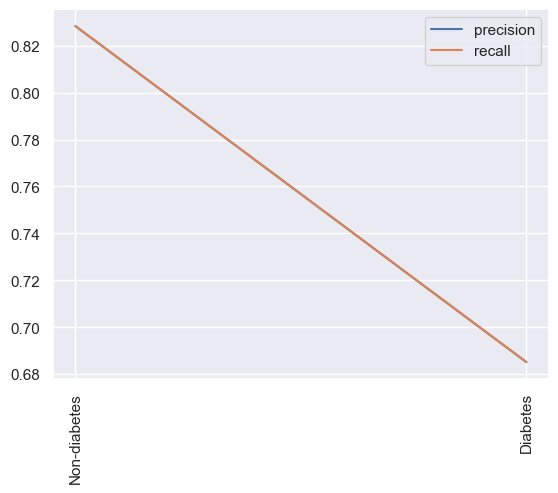

 estimator: 500 depth: 8 test score:0.7516339869281046
 estimator: 500 depth: 8 train score:0.9654605263157895
Accuracy: 0.7516339869281046
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.83      0.81        99
         1.0       0.66      0.61      0.63        54

    accuracy                           0.75       153
   macro avg       0.73      0.72      0.72       153
weighted avg       0.75      0.75      0.75       153



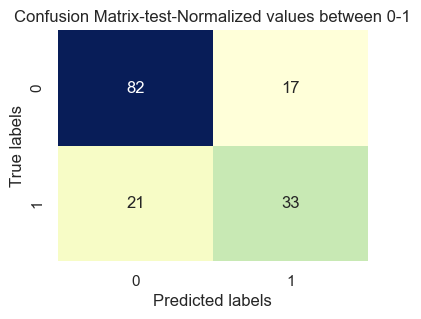

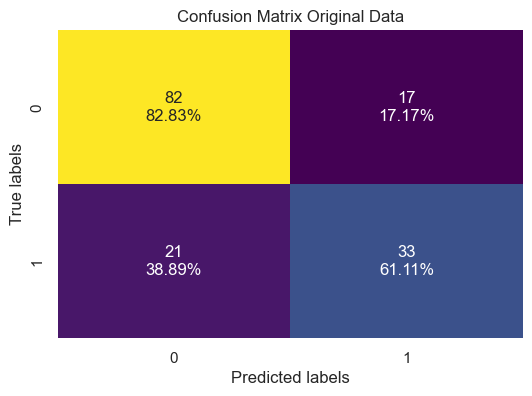

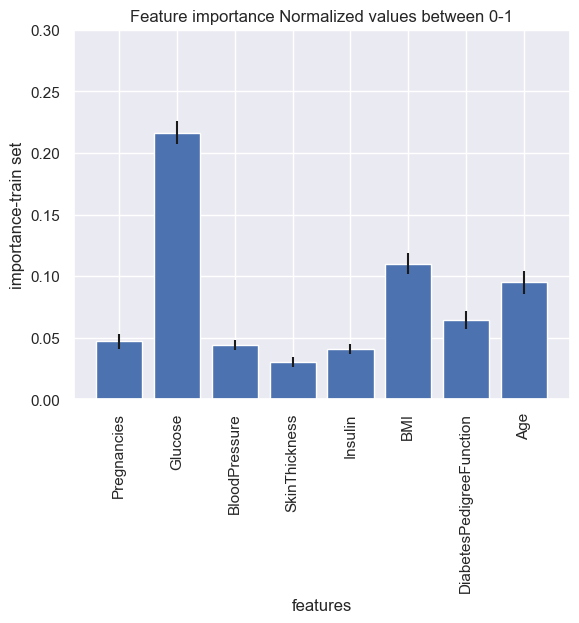

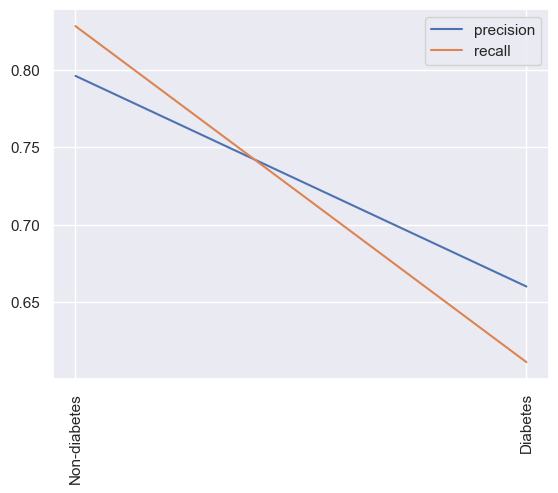

 estimator: 1 depth: 16 test score:0.6601307189542484
 estimator: 1 depth: 16 train score:0.881578947368421
Accuracy: 0.6601307189542484
Classification Report:
              precision    recall  f1-score   support

         0.0       0.74      0.74      0.74        99
         1.0       0.52      0.52      0.52        54

    accuracy                           0.66       153
   macro avg       0.63      0.63      0.63       153
weighted avg       0.66      0.66      0.66       153



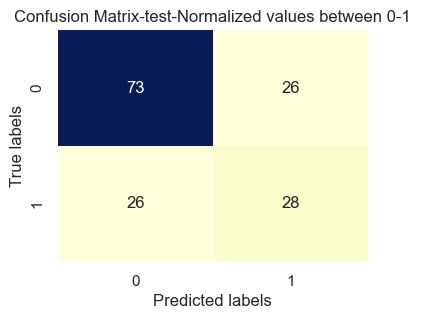

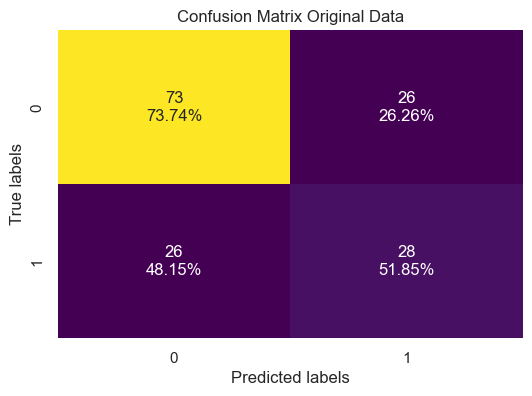

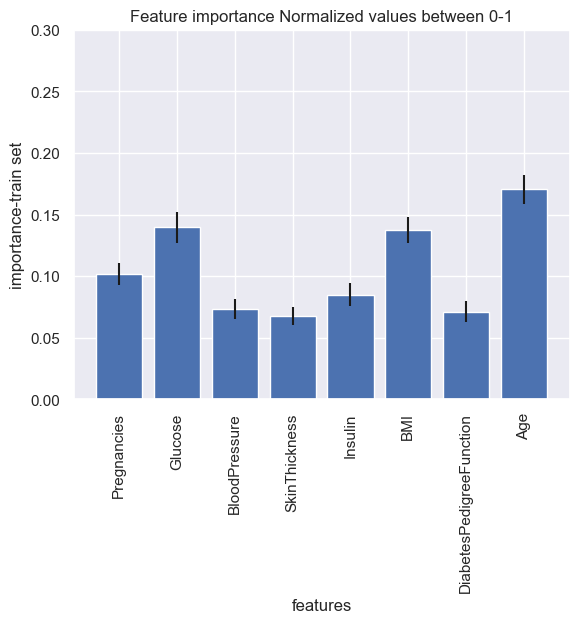

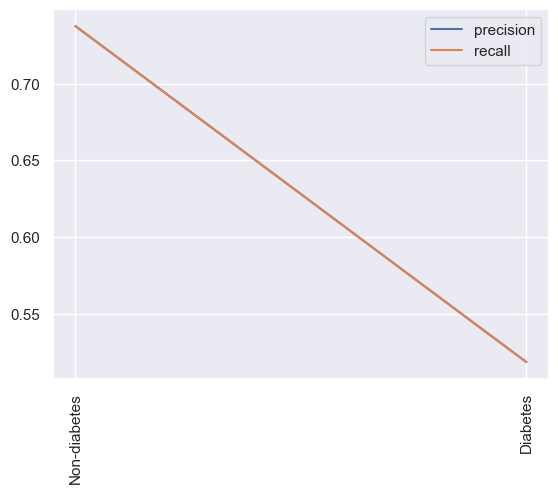

 estimator: 5 depth: 16 test score:0.7189542483660131
 estimator: 5 depth: 16 train score:0.975328947368421
Accuracy: 0.7189542483660131
Classification Report:
              precision    recall  f1-score   support

         0.0       0.78      0.79      0.78        99
         1.0       0.60      0.59      0.60        54

    accuracy                           0.72       153
   macro avg       0.69      0.69      0.69       153
weighted avg       0.72      0.72      0.72       153



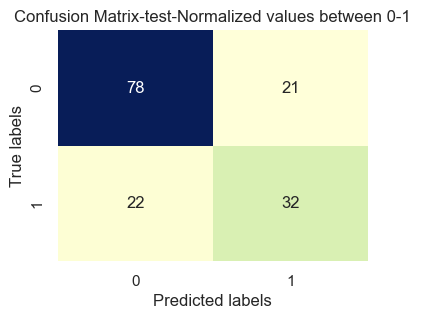

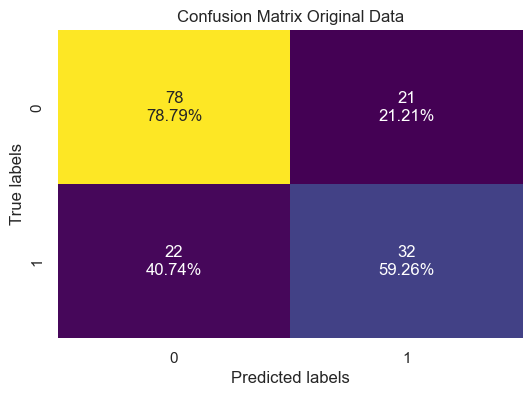

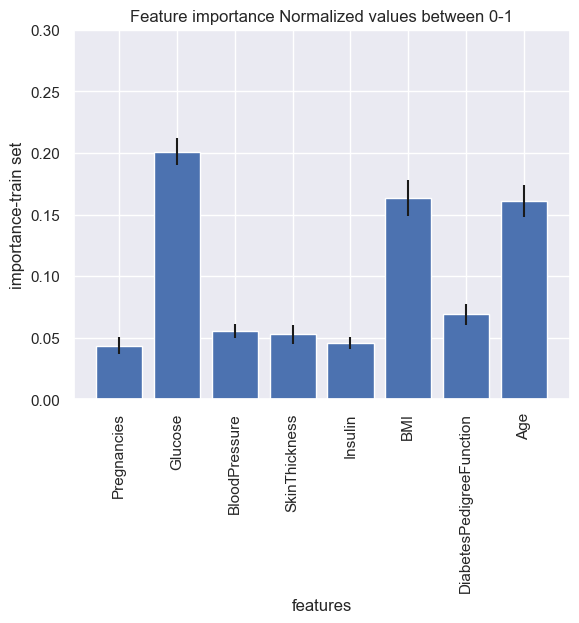

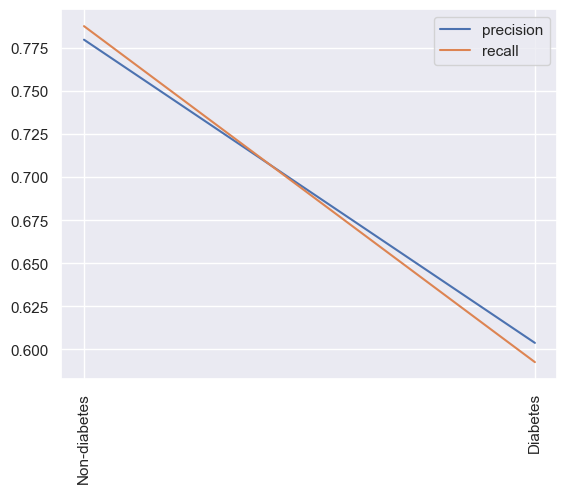

 estimator: 10 depth: 16 test score:0.7320261437908496
 estimator: 10 depth: 16 train score:0.9901315789473685
Accuracy: 0.7320261437908496
Classification Report:
              precision    recall  f1-score   support

         0.0       0.78      0.82      0.80        99
         1.0       0.63      0.57      0.60        54

    accuracy                           0.73       153
   macro avg       0.71      0.70      0.70       153
weighted avg       0.73      0.73      0.73       153



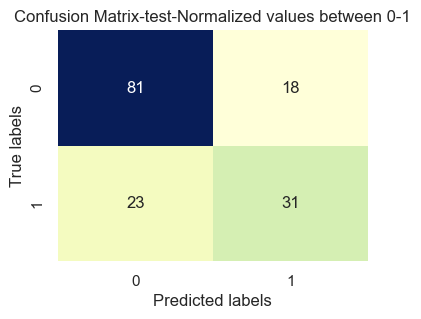

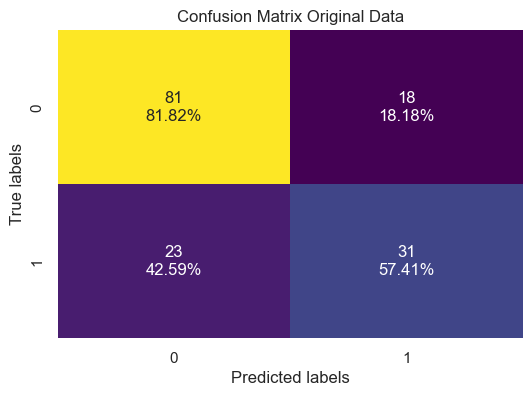

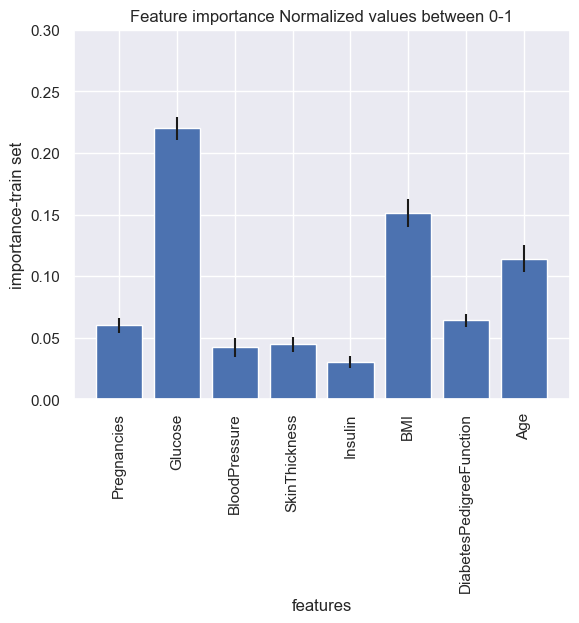

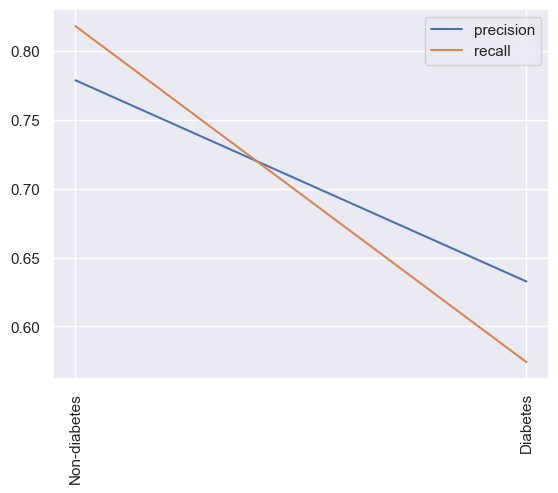

 estimator: 20 depth: 16 test score:0.7450980392156863
 estimator: 20 depth: 16 train score:1.0
Accuracy: 0.7450980392156863
Classification Report:
              precision    recall  f1-score   support

         0.0       0.79      0.83      0.81        99
         1.0       0.65      0.59      0.62        54

    accuracy                           0.75       153
   macro avg       0.72      0.71      0.71       153
weighted avg       0.74      0.75      0.74       153



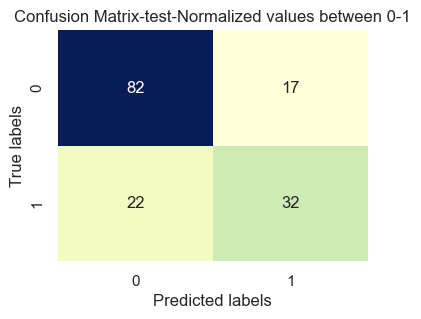

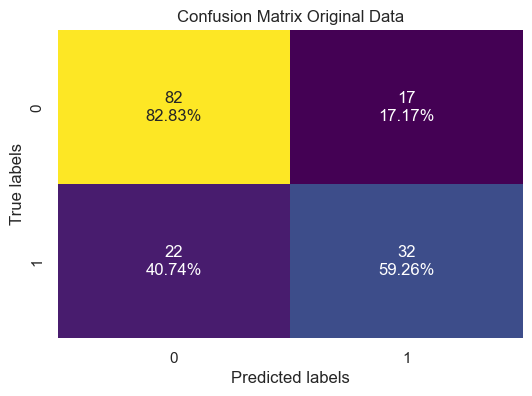

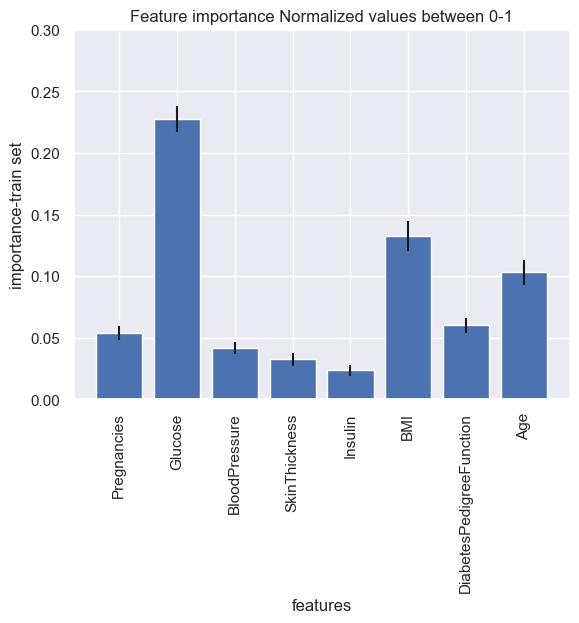

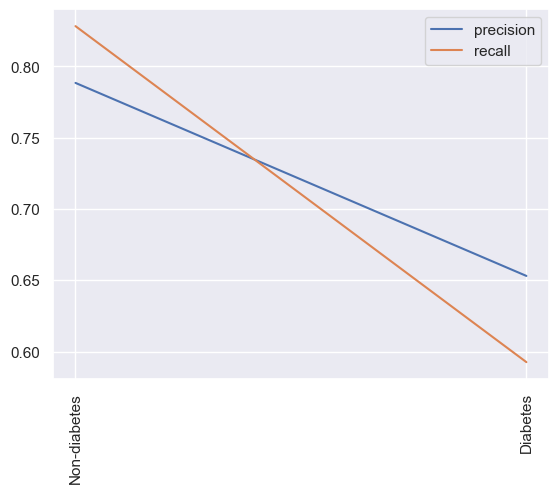

 estimator: 50 depth: 16 test score:0.7581699346405228
 estimator: 50 depth: 16 train score:1.0
Accuracy: 0.7581699346405228
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.83      0.82        99
         1.0       0.67      0.63      0.65        54

    accuracy                           0.76       153
   macro avg       0.74      0.73      0.73       153
weighted avg       0.76      0.76      0.76       153



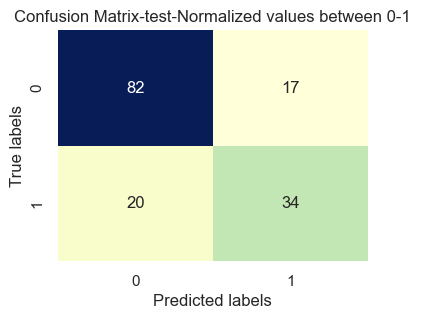

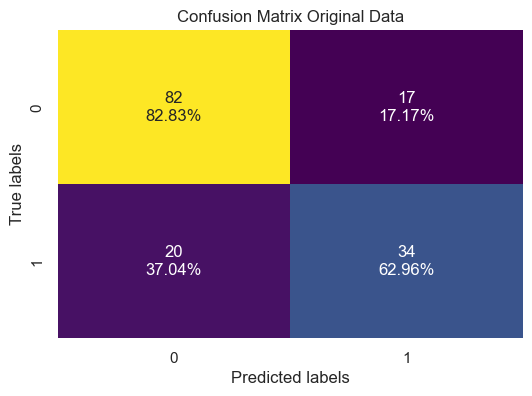

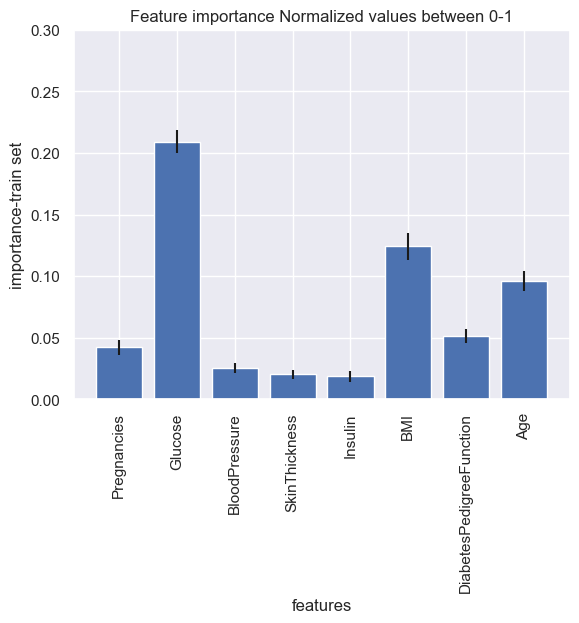

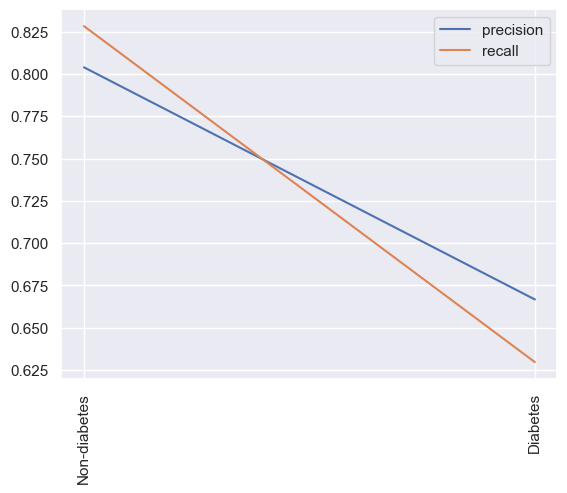

 estimator: 100 depth: 16 test score:0.7647058823529411
 estimator: 100 depth: 16 train score:1.0
Accuracy: 0.7647058823529411
Classification Report:
              precision    recall  f1-score   support

         0.0       0.82      0.82      0.82        99
         1.0       0.67      0.67      0.67        54

    accuracy                           0.76       153
   macro avg       0.74      0.74      0.74       153
weighted avg       0.76      0.76      0.76       153



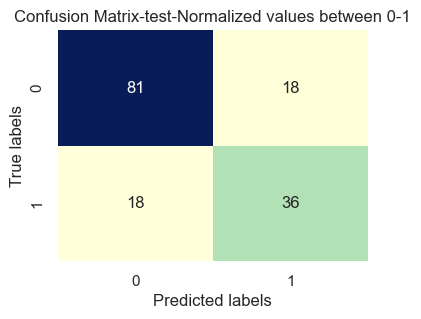

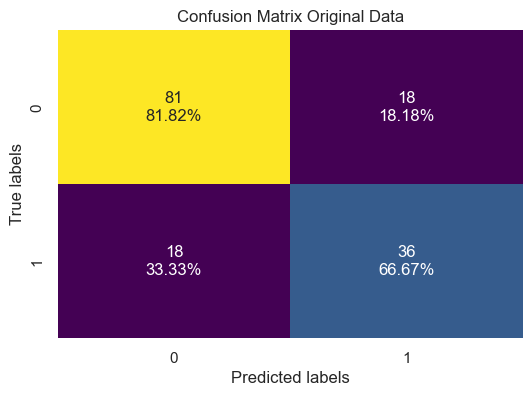

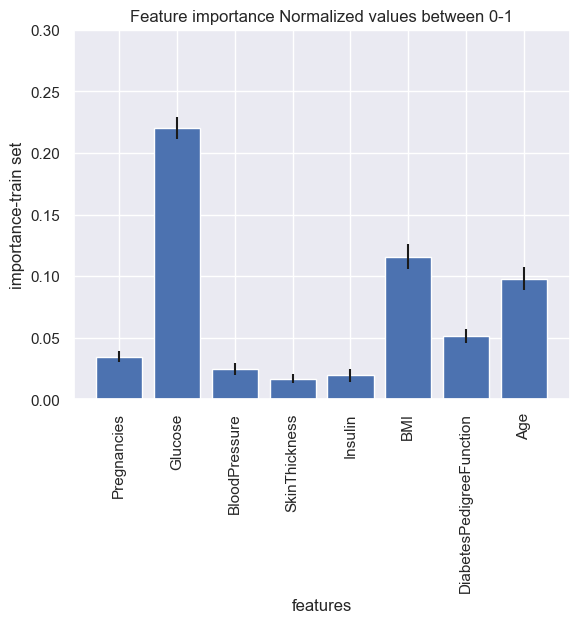

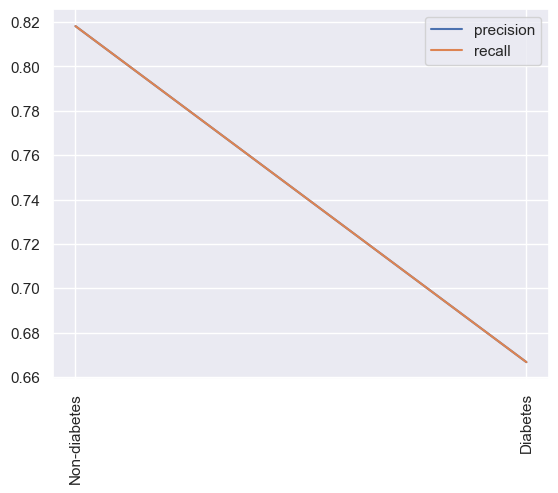

 estimator: 150 depth: 16 test score:0.7712418300653595
 estimator: 150 depth: 16 train score:1.0
Accuracy: 0.7712418300653595
Classification Report:
              precision    recall  f1-score   support

         0.0       0.83      0.82      0.82        99
         1.0       0.67      0.69      0.68        54

    accuracy                           0.77       153
   macro avg       0.75      0.75      0.75       153
weighted avg       0.77      0.77      0.77       153



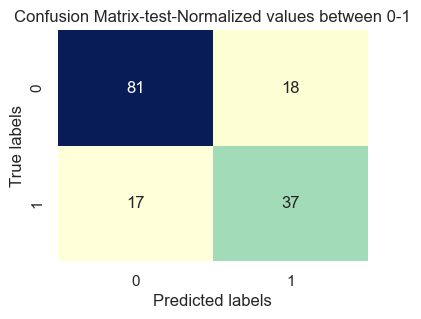

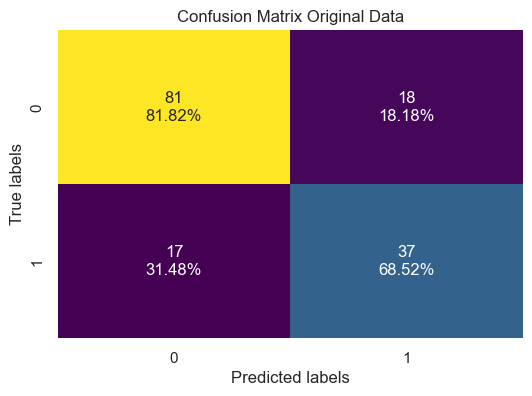

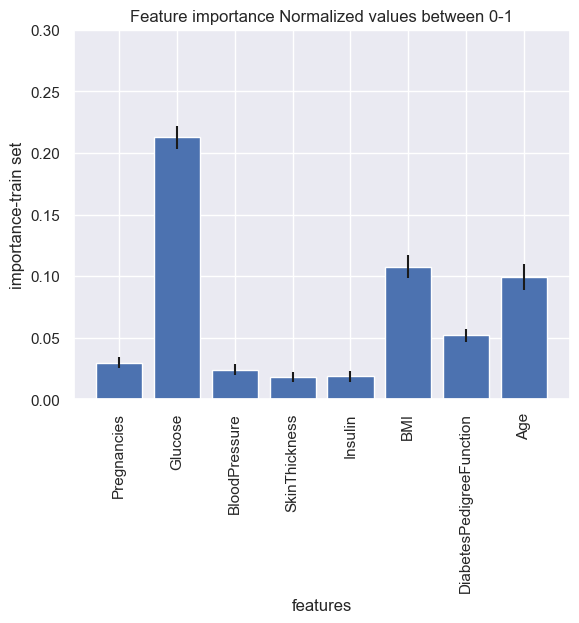

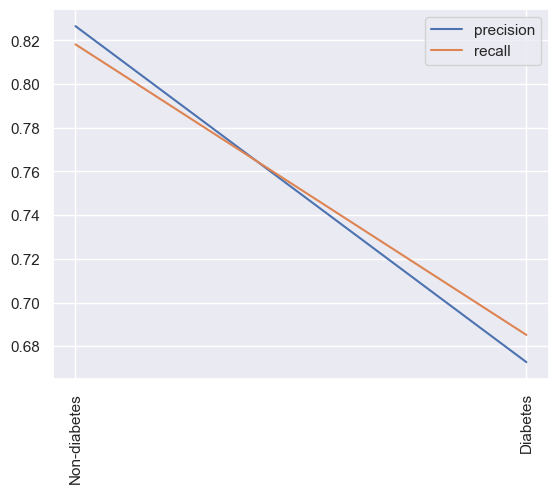

 estimator: 200 depth: 16 test score:0.7777777777777778
 estimator: 200 depth: 16 train score:1.0
Accuracy: 0.7777777777777778
Classification Report:
              precision    recall  f1-score   support

         0.0       0.84      0.82      0.83        99
         1.0       0.68      0.70      0.69        54

    accuracy                           0.78       153
   macro avg       0.76      0.76      0.76       153
weighted avg       0.78      0.78      0.78       153



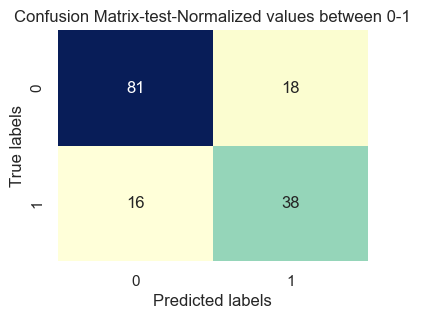

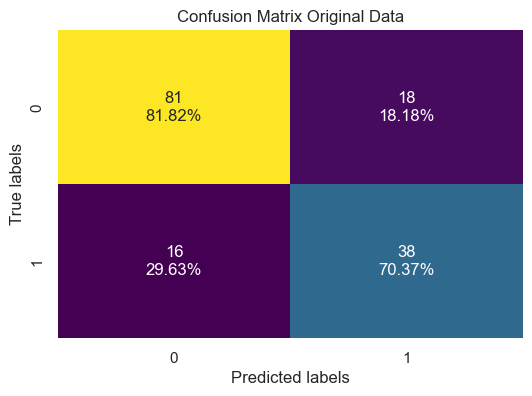

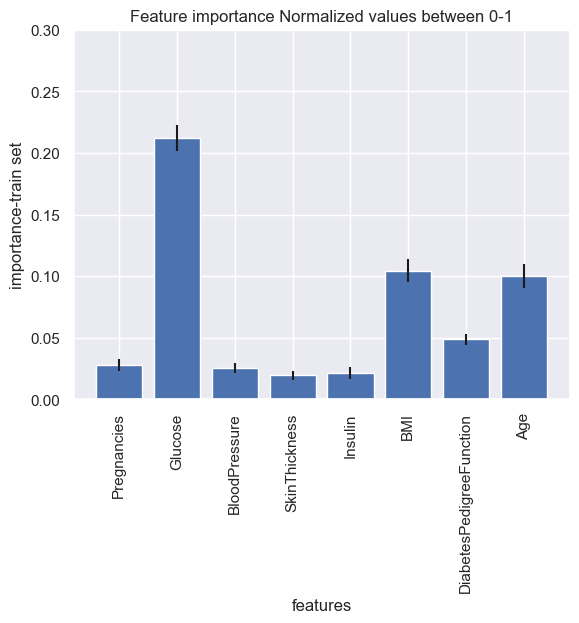

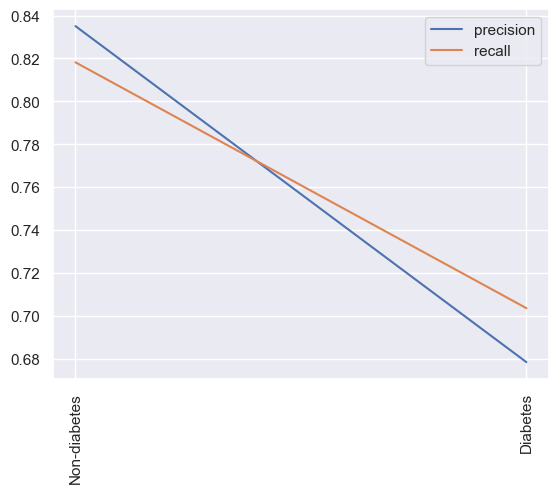

 estimator: 500 depth: 16 test score:0.7647058823529411
 estimator: 500 depth: 16 train score:1.0
Accuracy: 0.7647058823529411
Classification Report:
              precision    recall  f1-score   support

         0.0       0.82      0.81      0.82        99
         1.0       0.66      0.69      0.67        54

    accuracy                           0.76       153
   macro avg       0.74      0.75      0.74       153
weighted avg       0.77      0.76      0.77       153



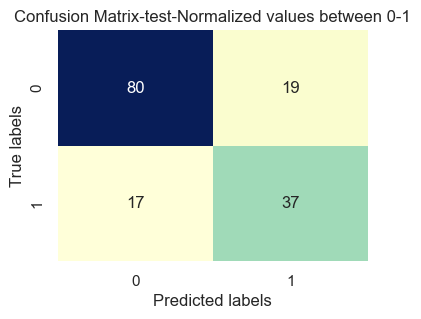

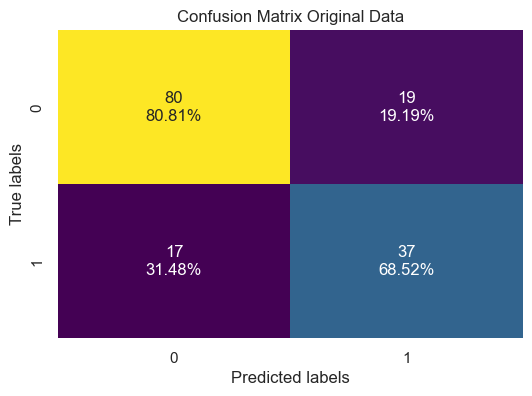

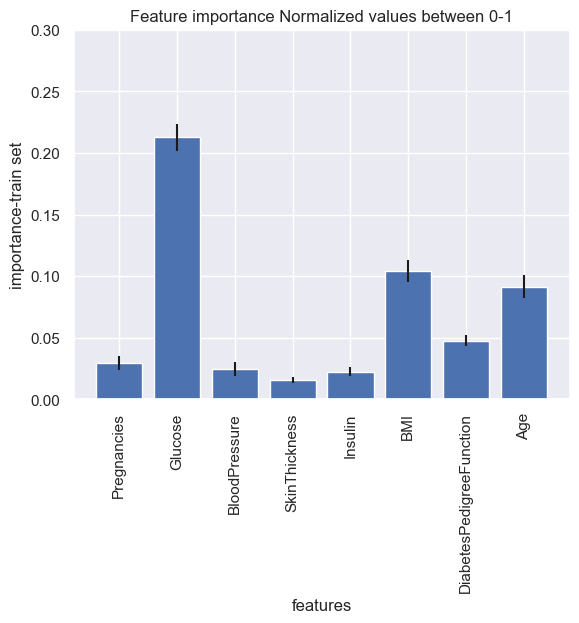

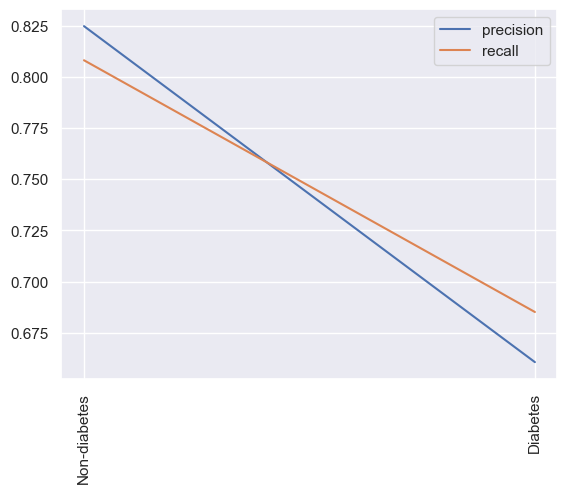

 estimator: 1 depth: 20 test score:0.6601307189542484
 estimator: 1 depth: 20 train score:0.881578947368421
Accuracy: 0.6601307189542484
Classification Report:
              precision    recall  f1-score   support

         0.0       0.74      0.74      0.74        99
         1.0       0.52      0.52      0.52        54

    accuracy                           0.66       153
   macro avg       0.63      0.63      0.63       153
weighted avg       0.66      0.66      0.66       153



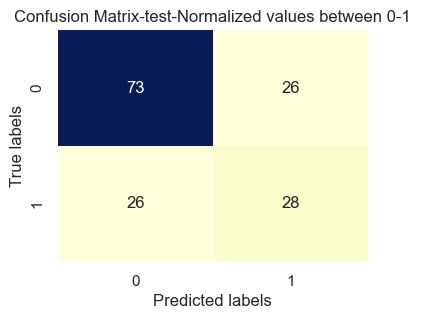

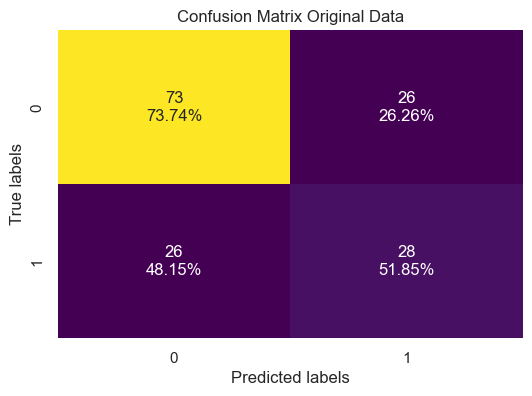

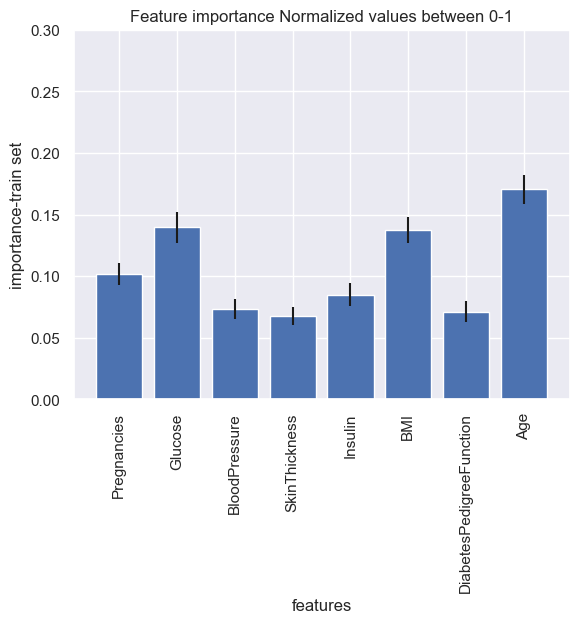

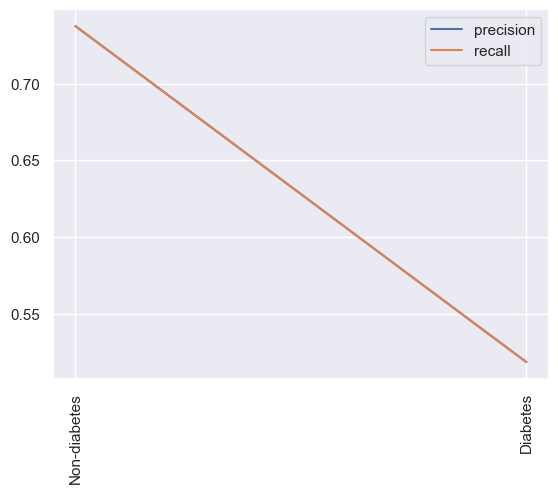

 estimator: 5 depth: 20 test score:0.7189542483660131
 estimator: 5 depth: 20 train score:0.975328947368421
Accuracy: 0.7189542483660131
Classification Report:
              precision    recall  f1-score   support

         0.0       0.78      0.79      0.78        99
         1.0       0.60      0.59      0.60        54

    accuracy                           0.72       153
   macro avg       0.69      0.69      0.69       153
weighted avg       0.72      0.72      0.72       153



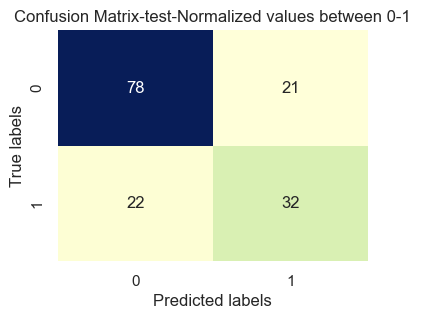

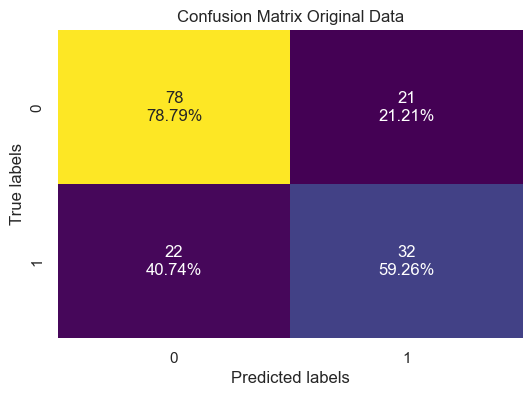

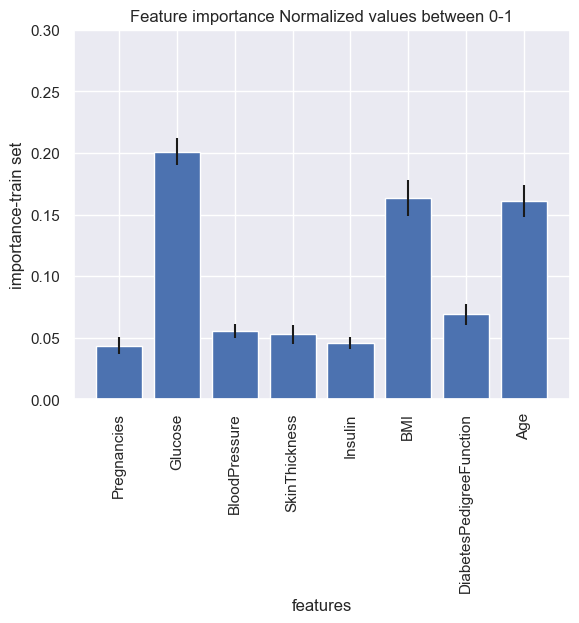

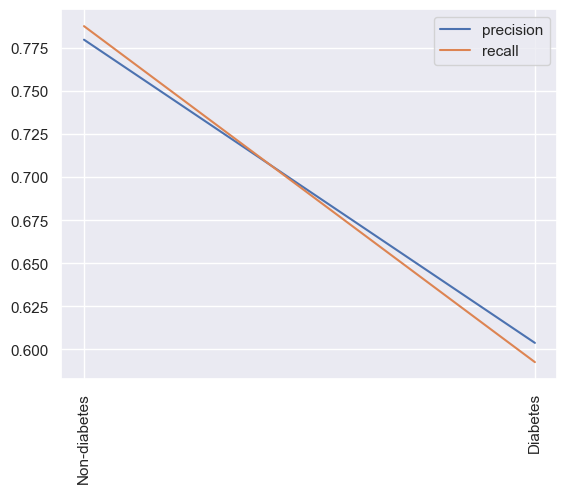

 estimator: 10 depth: 20 test score:0.7320261437908496
 estimator: 10 depth: 20 train score:0.9901315789473685
Accuracy: 0.7320261437908496
Classification Report:
              precision    recall  f1-score   support

         0.0       0.78      0.82      0.80        99
         1.0       0.63      0.57      0.60        54

    accuracy                           0.73       153
   macro avg       0.71      0.70      0.70       153
weighted avg       0.73      0.73      0.73       153



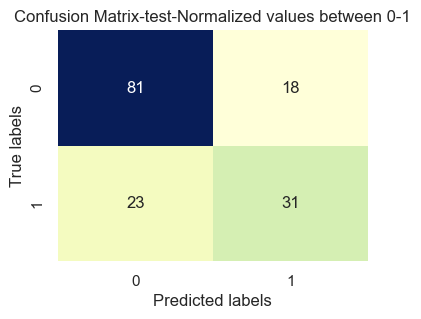

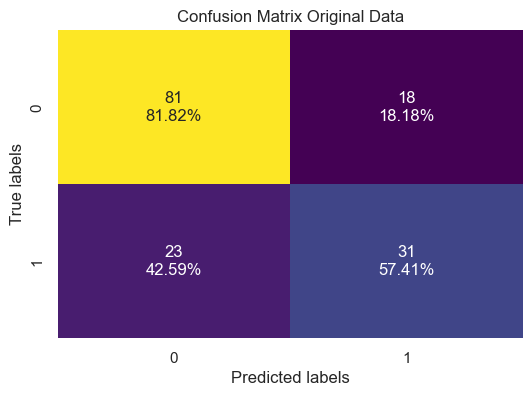

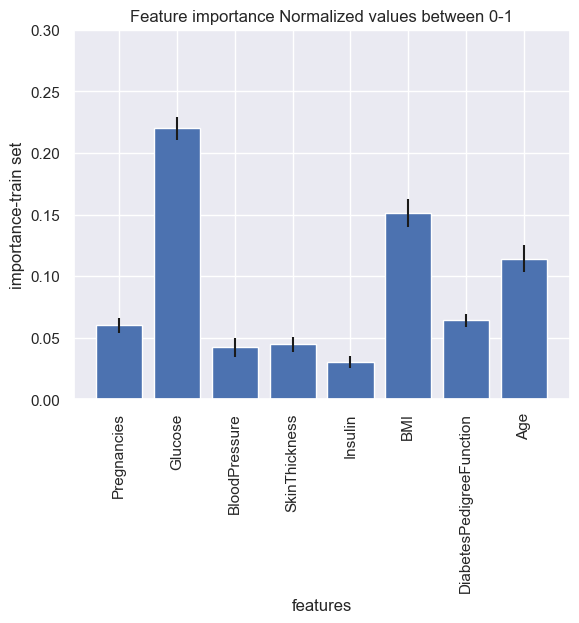

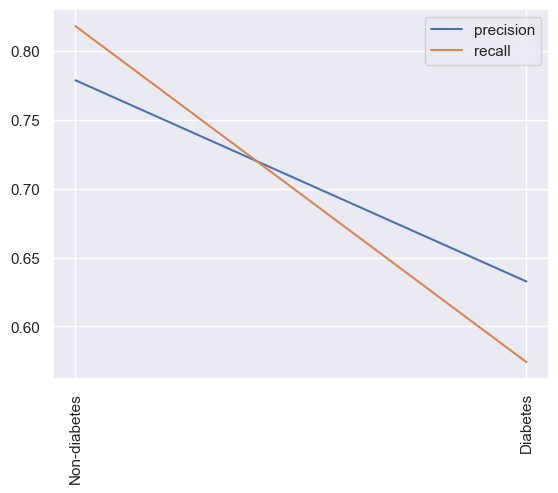

 estimator: 20 depth: 20 test score:0.7516339869281046
 estimator: 20 depth: 20 train score:1.0
Accuracy: 0.7516339869281046
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.83      0.81        99
         1.0       0.66      0.61      0.63        54

    accuracy                           0.75       153
   macro avg       0.73      0.72      0.72       153
weighted avg       0.75      0.75      0.75       153



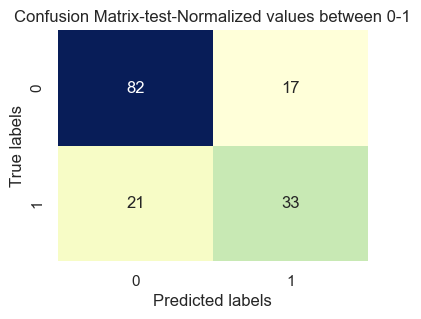

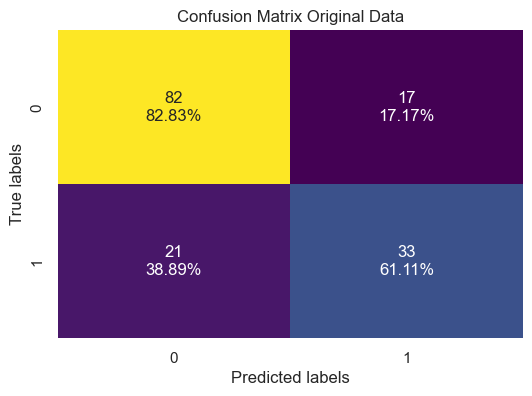

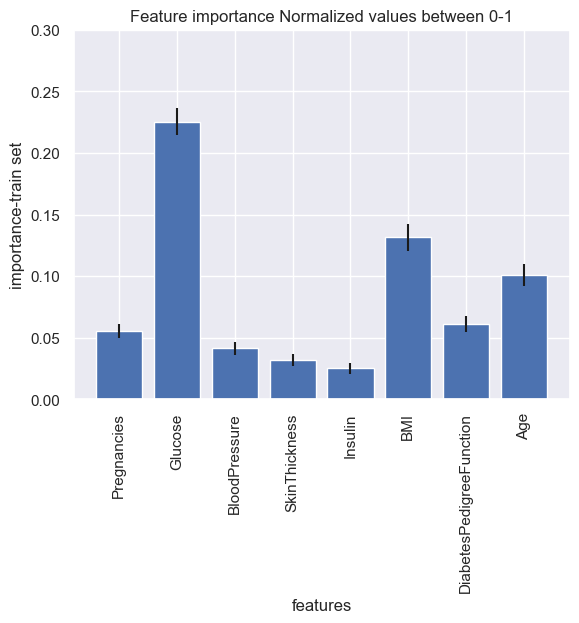

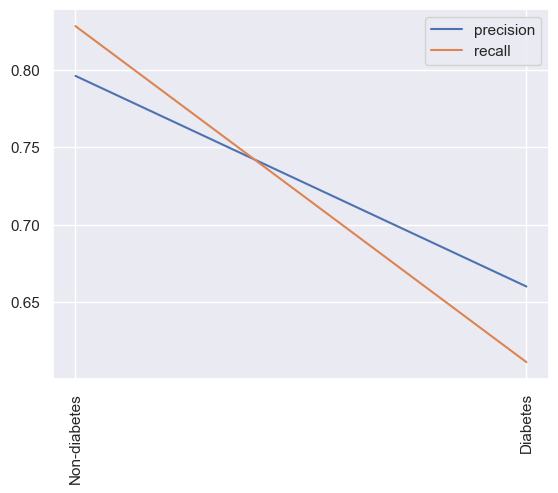

 estimator: 50 depth: 20 test score:0.7581699346405228
 estimator: 50 depth: 20 train score:1.0
Accuracy: 0.7581699346405228
Classification Report:
              precision    recall  f1-score   support

         0.0       0.81      0.82      0.81        99
         1.0       0.66      0.65      0.65        54

    accuracy                           0.76       153
   macro avg       0.74      0.73      0.73       153
weighted avg       0.76      0.76      0.76       153



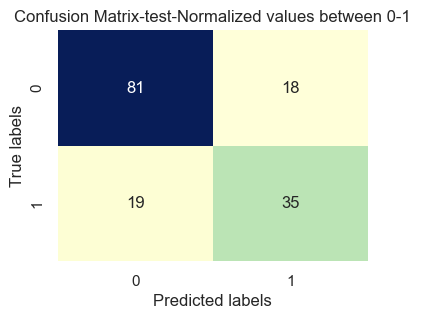

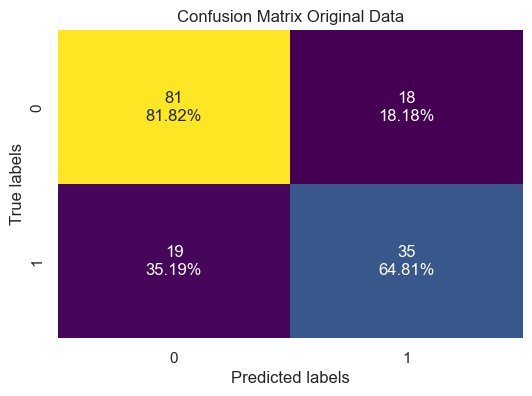

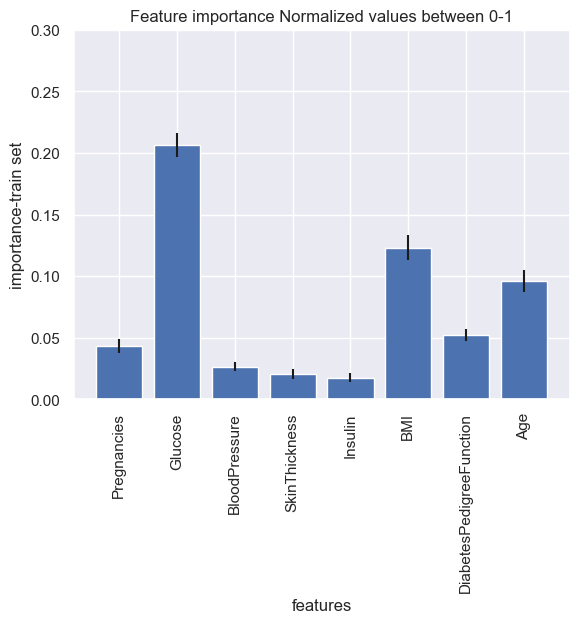

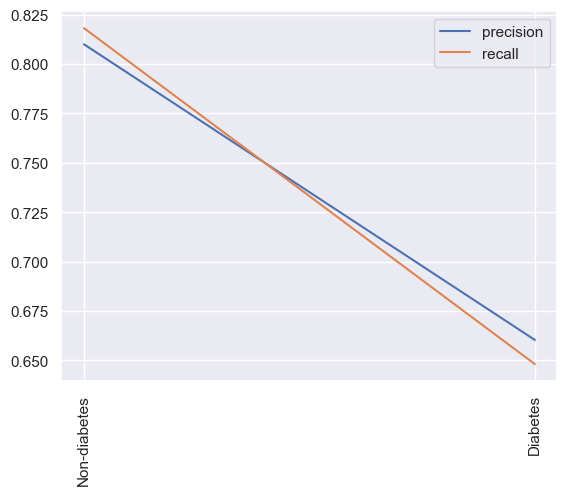

 estimator: 100 depth: 20 test score:0.7581699346405228
 estimator: 100 depth: 20 train score:1.0
Accuracy: 0.7581699346405228
Classification Report:
              precision    recall  f1-score   support

         0.0       0.81      0.82      0.81        99
         1.0       0.66      0.65      0.65        54

    accuracy                           0.76       153
   macro avg       0.74      0.73      0.73       153
weighted avg       0.76      0.76      0.76       153



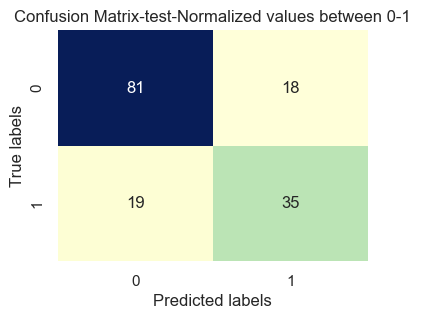

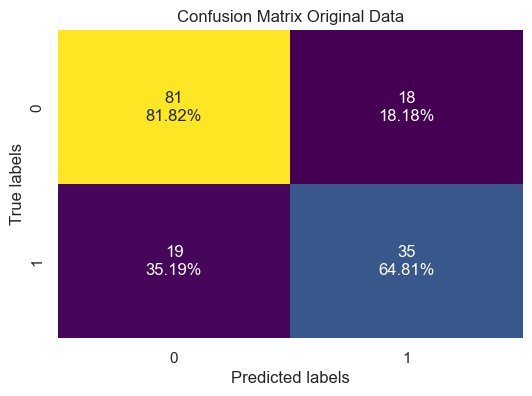

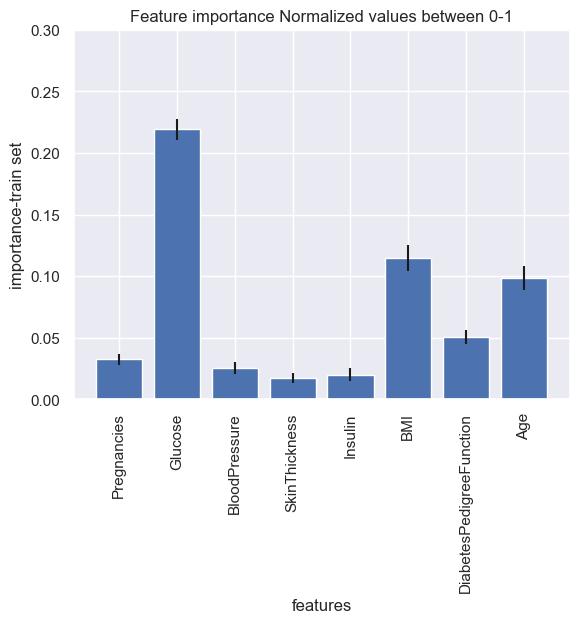

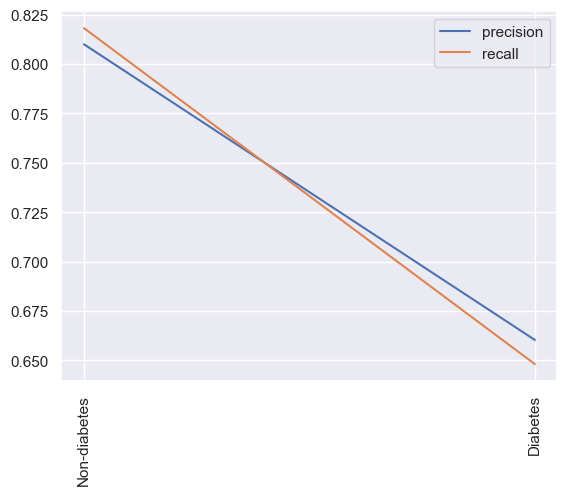

 estimator: 150 depth: 20 test score:0.7777777777777778
 estimator: 150 depth: 20 train score:1.0
Accuracy: 0.7777777777777778
Classification Report:
              precision    recall  f1-score   support

         0.0       0.84      0.82      0.83        99
         1.0       0.68      0.70      0.69        54

    accuracy                           0.78       153
   macro avg       0.76      0.76      0.76       153
weighted avg       0.78      0.78      0.78       153



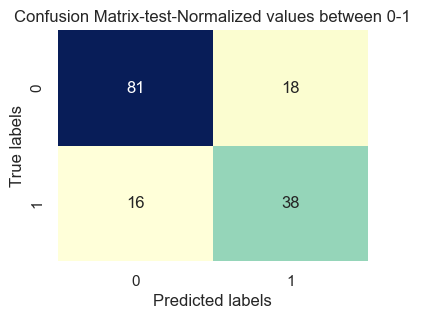

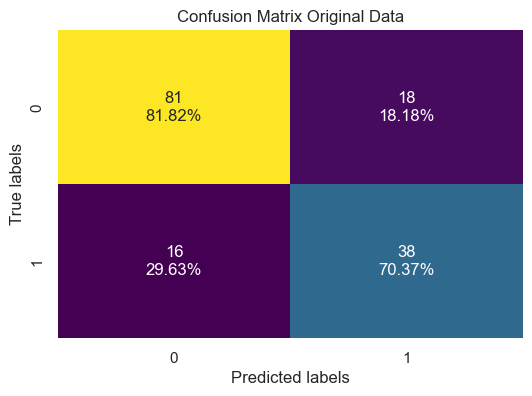

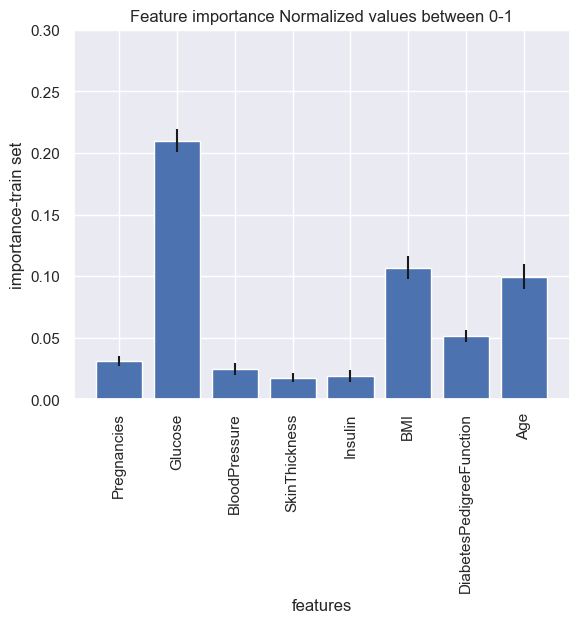

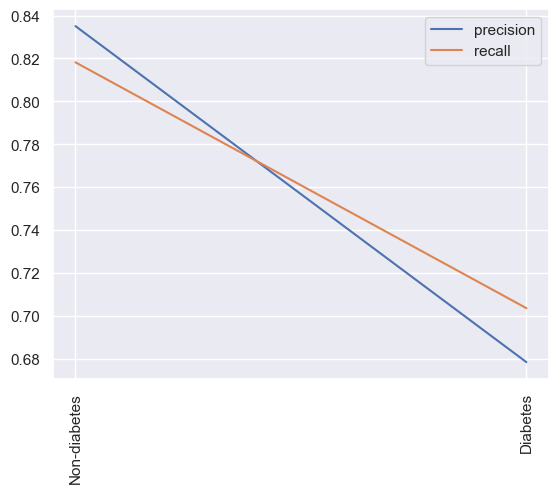

 estimator: 200 depth: 20 test score:0.7777777777777778
 estimator: 200 depth: 20 train score:1.0
Accuracy: 0.7777777777777778
Classification Report:
              precision    recall  f1-score   support

         0.0       0.84      0.82      0.83        99
         1.0       0.68      0.70      0.69        54

    accuracy                           0.78       153
   macro avg       0.76      0.76      0.76       153
weighted avg       0.78      0.78      0.78       153



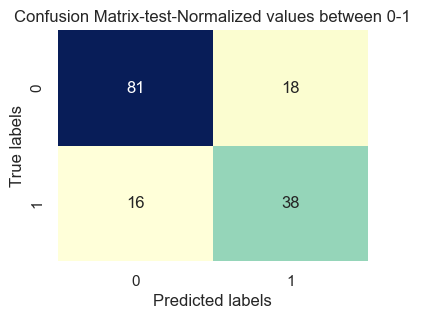

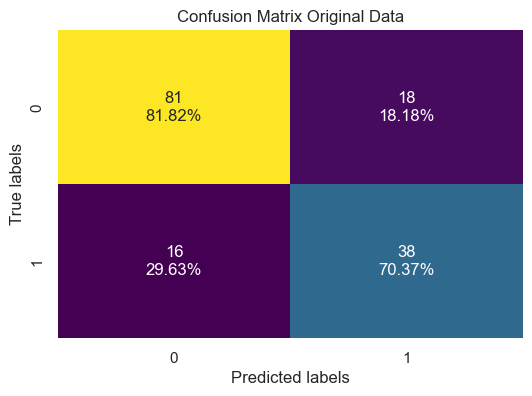

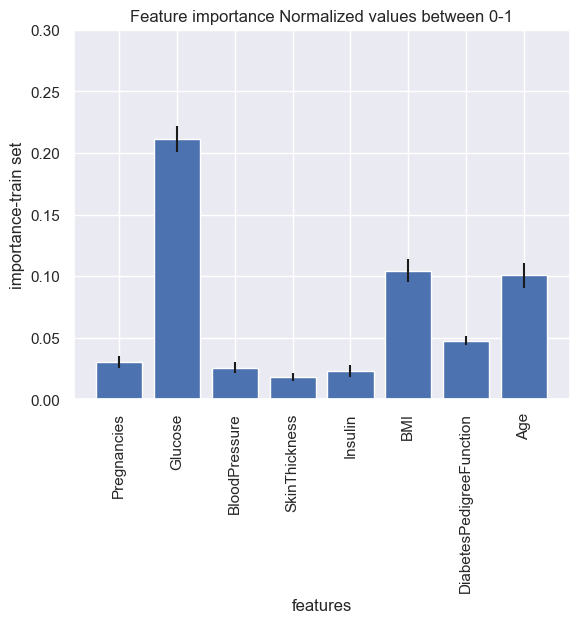

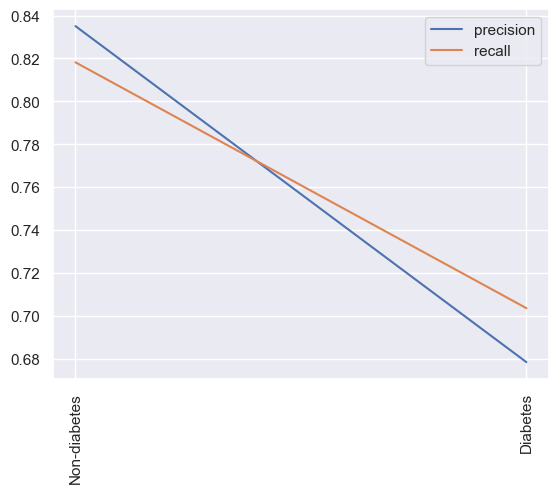

 estimator: 500 depth: 20 test score:0.7712418300653595
 estimator: 500 depth: 20 train score:1.0
Accuracy: 0.7712418300653595
Classification Report:
              precision    recall  f1-score   support

         0.0       0.83      0.82      0.82        99
         1.0       0.67      0.69      0.68        54

    accuracy                           0.77       153
   macro avg       0.75      0.75      0.75       153
weighted avg       0.77      0.77      0.77       153



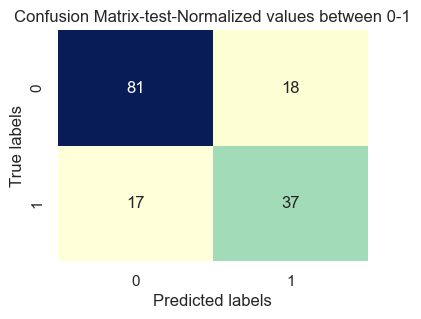

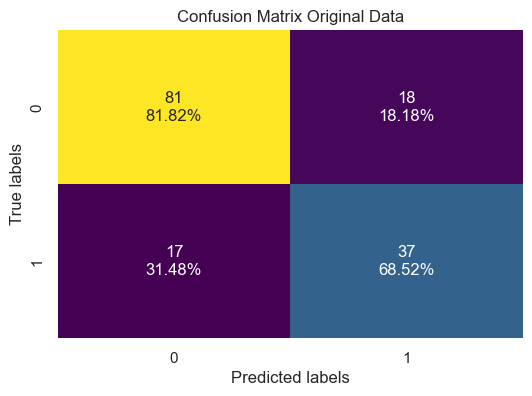

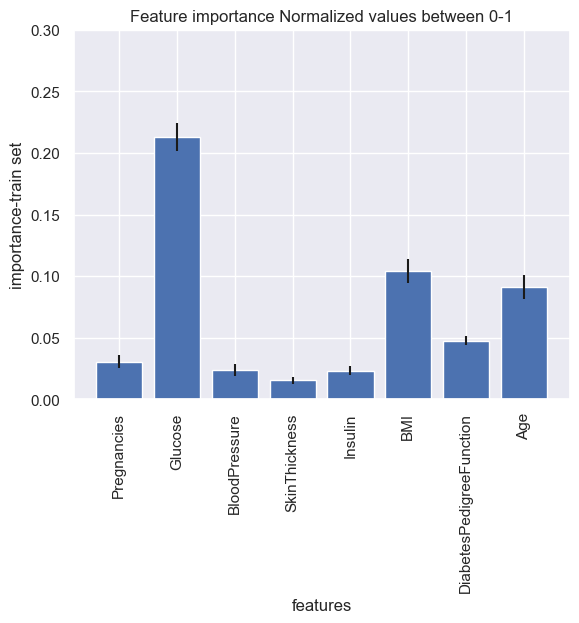

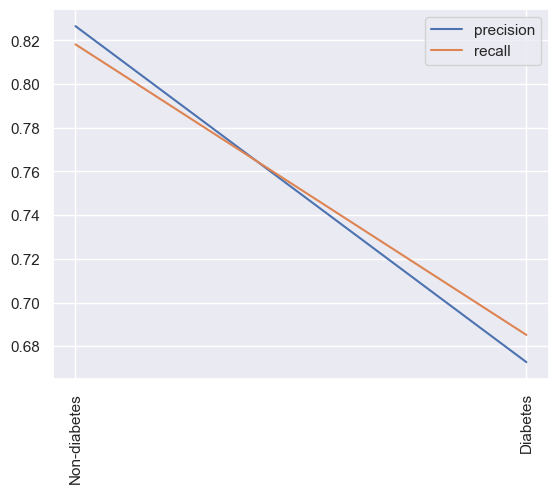

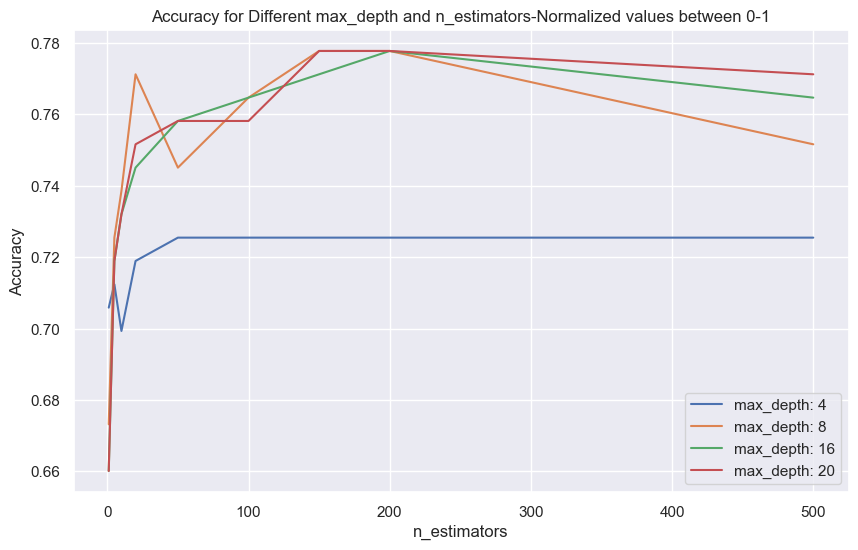

In [42]:
# random forest with normalized values between 0-1:

# split the normalized data set:

x_train, x_test, y_train, y_test = train_test_split(x_scaled_minmax, y, test_size=0.2,random_state=42)

from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

accuracies =[]
for m_deph in (4,8,16,20):
    acc_row =[]
    for n_est in (1, 5, 10,20, 50,100,150,200,500): #we are changing the number of estimatores to check
#for n_est in [100]:
# do fit
      rfc= ensemble.RandomForestClassifier(max_depth=m_deph, n_estimators=n_est,random_state=42)
      rfc.fit(x_train, y_train)
   # test different paramethers and take the one that gives the best aqurancy at the end.
    # print the training scores
      print(f' estimator: {n_est} depth: {m_deph} test score:{(rfc.score(x_test, y_test))}')
      print(f' estimator: {n_est} depth: {m_deph} train score:{(rfc.score(x_train, y_train))}')
      y_pred_test = rfc.predict(x_test)
      y_pred_train = rfc.predict(x_train)
    #print(y_pred_test)
       #Evaluate the classifier
      accuracy = accuracy_score(y_test, y_pred_test)
      print(f'Accuracy: {accuracy}')
      acc_row.append(accuracy) 
    
    # Print classification report and confusion matrix
      print("Classification Report:")
      print(classification_report(y_test, y_pred_test))

      #print("Confusion Matrix:")
      #print(confusion_matrix(y_test, y_pred_test))
    
      cm = confusion_matrix(y_test, y_pred_test)

    # Display the confusion matrix
      plt.figure(figsize=(4, 3))
      sns.heatmap(cm, annot=True, fmt='d', cmap='YlGnBu', cbar=False)
      plt.xlabel('Predicted labels')
      plt.ylabel('True labels')
      plt.title('Confusion Matrix-test-Normalized values between 0-1')
      plt.show()
    
    # Display the confusion matrix with values and percentages
      cm_sum = np.sum(cm, axis=1, keepdims=True)
      cm_percentages = cm / cm_sum.astype(float) * 100
      cm_with_percentages = np.round(cm_percentages, 2)

      plt.figure(figsize=(6, 4))
      sns.heatmap(
      cm,
      annot=np.array([f'{v1}\n{v2}%' for v1, v2 in zip(cm.flatten(), cm_with_percentages.flatten())]).reshape(cm.shape),
      fmt='',
      cmap='viridis',
      cbar=False
       )
      plt.xlabel('Predicted labels')
      plt.ylabel('True labels')
      plt.title('Confusion Matrix Original Data')
      plt.show()
    

    
    # display important features
      p_importances = permutation_importance(rfc, x_train, y_train, n_repeats=20, n_jobs=-1,random_state=42)

      plt.bar(features,
        p_importances.importances_mean,
        yerr=p_importances.importances_std)
      plt.xticks(rotation=90)
      plt.xlabel('features')
      plt.ylabel('importance-train set')
      plt.title('Feature importance Normalized values between 0-1')
      plt.ylim(0, 0.3)
      plt.show()  

      #print(f'Check that you get the same accuracy from the score method: {np.sum([confusion_test[i,i] for i in range(2)])/np.sum(confusion_test)}')
    #sums the diagonal and divide the whole matrix
      precisions=[]
      recalls=[]
    #precision
      for i in range(2):
        precisions.append(cm[i,i]/np.sum(cm[:,i])) #take the diagonal divided by the whole column

        #percentage of positive identified??
#recall
      for i in range(2):
        recalls.append(cm[i,i]/np.sum(cm[i,:])) #take the diagonal and divide by the whole row

      plt.plot(Output_names,precisions, label='precision')
      plt.plot(Output_names,recalls, label='recall')
      plt.xticks(rotation=90)
      plt.legend()
      plt.show()
    
    accuracies.append(acc_row)

    
plt.figure(figsize=(10, 6))
for i, m_deph in enumerate((4, 8, 16, 20)):
    plt.plot((1, 5, 10,20, 50,100,150, 200,500), accuracies[i], label=f"max_depth: {m_deph}")

plt.xlabel("n_estimators")
plt.ylabel("Accuracy")
plt.title("Accuracy for Different max_depth and n_estimators-Normalized values between 0-1")
plt.legend()
plt.show()
    



[[  5.    139.     80.    ...  31.6     0.361  25.   ]
 [  3.    111.     58.    ...  29.5     0.43   22.   ]
 [  6.    162.     62.    ...  24.3     0.178  50.   ]
 ...
 [  7.    107.     74.    ...  29.6     0.254  31.   ]
 [  1.    118.     58.    ...  33.3     0.261  23.   ]
 [  3.     96.     56.    ...  24.7     0.944  39.   ]]
[0]	validation_0-error:0.35294
[1]	validation_0-error:0.35294
[2]	validation_0-error:0.30719
[3]	validation_0-error:0.30065
[4]	validation_0-error:0.28105
[5]	validation_0-error:0.28758
[6]	validation_0-error:0.29412
[7]	validation_0-error:0.25490
[8]	validation_0-error:0.24183
[9]	validation_0-error:0.22876
[10]	validation_0-error:0.24183
[11]	validation_0-error:0.24183
[12]	validation_0-error:0.23529
[13]	validation_0-error:0.24837
[14]	validation_0-error:0.24183
[15]	validation_0-error:0.23529
[16]	validation_0-error:0.23529
[17]	validation_0-error:0.24183
[18]	validation_0-error:0.24837
[19]	validation_0-error:0.23529
Accuracy: 0.7712418300653595
     

/Users/paula/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:885: UserWarning: `eval_metric` in `fit` method is deprecated for better compatibility with scikit-learn, use `eval_metric` in constructor or`set_params` instead.
  warnings.warn(
/Users/paula/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


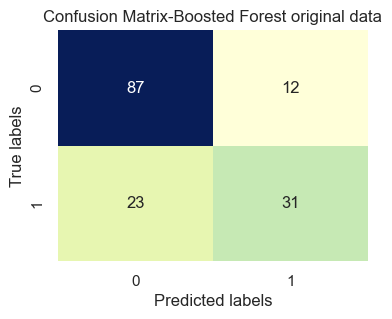

In [371]:
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, classification_report,confusion_matrix

# boosted forest for normalized for original data:
#reload the original data: 

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42) #add random state for splitting allways the same to compare results
print(x_train)
# Initialize the XGBClassifier
xgb_clf = XGBClassifier(learning_rate=0.1, n_estimators=50, max_depth=8, random_state=42)


# Fit the model with early stopping
xgb_clf.fit(x_train, y_train, early_stopping_rounds=10, eval_metric="error", eval_set=[(x_test, y_test)])


# Make predictions
y_pred_test = xgb_clf.predict(x_test)

# Evaluate the model
print("Accuracy:", accuracy_score(y_test, y_pred_test))
print(classification_report(y_test, y_pred_test))



cm = confusion_matrix(y_test, y_pred_test)

# Display the confusion matrix
plt.figure(figsize=(4, 3))
sns.heatmap(cm, annot=True, fmt='d', cmap='YlGnBu', cbar=False)
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix-Boosted Forest original data')
plt.show()

from sklearn.metrics import plot_precision_recall_curve

# Assuming xgb_clf is your trained XGBoost model and X_test is your test data
#plot_precision_recall_curve(xgb_clf, x_test, y_test)
#plt.title('2-class Precision-Recall curve original data ')
#plt.show()


[[0.29411766 0.61290324 0.57142854 ... 0.27402863 0.12083688 0.06666666]
 [0.1764706  0.43225804 0.3469388  ... 0.23108384 0.1502989  0.01666665]
 [0.3529412  0.7612903  0.3877551  ... 0.12474436 0.04269855 0.48333335]
 ...
 [0.4117647  0.4064516  0.5102041  ... 0.23312882 0.07514945 0.16666669]
 [0.05882353 0.47741935 0.3469388  ... 0.30879346 0.07813835 0.03333333]
 [0.1764706  0.33548388 0.32653058 ... 0.13292435 0.36976942 0.3       ]]
[0]	validation_0-error:0.35294
[1]	validation_0-error:0.35294
[2]	validation_0-error:0.30719
[3]	validation_0-error:0.30065
[4]	validation_0-error:0.28105
[5]	validation_0-error:0.28758
[6]	validation_0-error:0.29412
[7]	validation_0-error:0.25490
[8]	validation_0-error:0.24183
[9]	validation_0-error:0.22876
[10]	validation_0-error:0.24183
[11]	validation_0-error:0.24183
[12]	validation_0-error:0.23529
[13]	validation_0-error:0.24837
[14]	validation_0-error:0.24183
[15]	validation_0-error:0.23529
[16]	validation_0-error:0.23529
[17]	validation_0-erro

/Users/paula/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:885: UserWarning: `eval_metric` in `fit` method is deprecated for better compatibility with scikit-learn, use `eval_metric` in constructor or`set_params` instead.
  warnings.warn(
/Users/paula/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


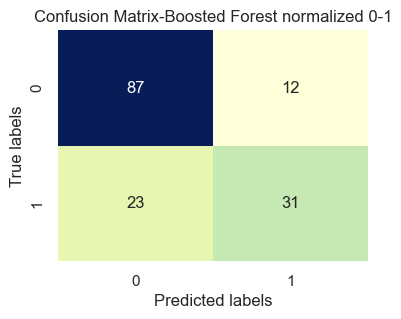

In [372]:
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, classification_report,confusion_matrix

# boosted forest for normalized for normalized data 0-1:
#reload the original data: 

x_train, x_test, y_train, y_test = train_test_split(x_scaled_minmax, y, test_size=0.2, random_state=42) #add random state for splitting allways the same to compare results
print(x_train)
# Initialize the XGBClassifier
xgb_clf = XGBClassifier(learning_rate=0.1, n_estimators=50, max_depth=8, random_state=42)


# Fit the model with early stopping
xgb_clf.fit(x_train, y_train, early_stopping_rounds=10, eval_metric="error", eval_set=[(x_test, y_test)])


# Make predictions
y_pred_test = xgb_clf.predict(x_test)

# Evaluate the model
print("Accuracy:", accuracy_score(y_test, y_pred_test))
print(classification_report(y_test, y_pred_test))



cm = confusion_matrix(y_test, y_pred_test)

# Display the confusion matrix
plt.figure(figsize=(4, 3))
sns.heatmap(cm, annot=True, fmt='d', cmap='YlGnBu', cbar=False)
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix-Boosted Forest normalized 0-1')
plt.show()

from sklearn.metrics import plot_precision_recall_curve

# Assuming xgb_clf is your trained XGBoost model and X_test is your test data
#plot_precision_recall_curve(xgb_clf, x_test, y_test)
#plt.title('2-class Precision-Recall curve original data ')
#plt.show()




[[ 0.34409332  0.5622093   0.626615   ... -0.1240339  -0.34101954
  -0.707055  ]
 [-0.24968223 -0.35837442 -1.1849526  ... -0.42828363 -0.13301855
  -0.9619029 ]
 [ 0.64098114  1.3184031  -0.8555767  ... -1.1816638  -0.89267427
   1.4166775 ]
 ...
 [ 0.9378689  -0.48988637  0.13255109 ... -0.4137955  -0.6635717
  -0.19735922]
 [-0.84345776 -0.12822849 -1.1849526  ...  0.12226328 -0.6424702
  -0.8769536 ]
 [-0.24968223 -0.85154426 -1.3496406  ... -1.1237113   1.4164379
   0.4822352 ]]
[0]	validation_0-error:0.35294
[1]	validation_0-error:0.35294
[2]	validation_0-error:0.30719
[3]	validation_0-error:0.30065
[4]	validation_0-error:0.28105
[5]	validation_0-error:0.28758
[6]	validation_0-error:0.29412
[7]	validation_0-error:0.25490
[8]	validation_0-error:0.24183
[9]	validation_0-error:0.22876
[10]	validation_0-error:0.24183
[11]	validation_0-error:0.24183
[12]	validation_0-error:0.23529
[13]	validation_0-error:0.24837
[14]	validation_0-error:0.24183
[15]	validation_0-error:0.23529
[16]	vali

/Users/paula/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:885: UserWarning: `eval_metric` in `fit` method is deprecated for better compatibility with scikit-learn, use `eval_metric` in constructor or`set_params` instead.
  warnings.warn(
/Users/paula/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:885: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


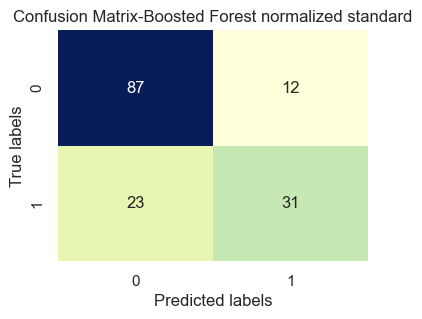

In [373]:
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, classification_report,confusion_matrix

# boosted forest for normalized for normalized standar:
#reload the original data: 

x_train, x_test, y_train, y_test = train_test_split(x_scaled_standar, y, test_size=0.2, random_state=42) #add random state for splitting allways the same to compare results
print(x_train)
# Initialize the XGBClassifier
xgb_clf = XGBClassifier(learning_rate=0.1, n_estimators=50, max_depth=8, random_state=42)


# Fit the model with early stopping
xgb_clf.fit(x_train, y_train, early_stopping_rounds=10, eval_metric="error", eval_set=[(x_test, y_test)])


# Make predictions
y_pred_test = xgb_clf.predict(x_test)

# Evaluate the model
print("Accuracy:", accuracy_score(y_test, y_pred_test))
print(classification_report(y_test, y_pred_test))



cm = confusion_matrix(y_test, y_pred_test)

# Display the confusion matrix
plt.figure(figsize=(4, 3))
sns.heatmap(cm, annot=True, fmt='d', cmap='YlGnBu', cbar=False)
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix-Boosted Forest normalized standard')
plt.show()

from sklearn.metrics import plot_precision_recall_curve

# Assuming xgb_clf is your trained XGBoost model and X_test is your test data
#plot_precision_recall_curve(xgb_clf, x_test, y_test)
#plt.title('2-class Precision-Recall curve original data ')
#plt.show()




In [374]:
from xgboost import XGBClassifier
from sklearn.model_selection import RandomizedSearchCV, train_test_split
from scipy.stats import uniform, randint

# Assuming X is your feature matrix and y is your target variable
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

# Set the parameters to search over
param_dist = {
    'learning_rate': uniform(0.01, 0.3),
    'max_depth': randint(3, 10),
    'n_estimators': randint(100, 1000)
}

# Initialize the XGBClassifier
xgb_clf = XGBClassifier(random_state=42)

# Set up RandomizedSearchCV
random_search = RandomizedSearchCV(xgb_clf, param_distributions=param_dist, n_iter=100, cv=3, random_state=42)

# Perform the random search
random_search.fit(X_train, y_train)

# Get the best parameters
best_params = random_search.best_params_
print("Best parameters:", best_params)

# Make predictions using the best model
best_model = random_search.best_estimator_
y_pred = best_model.predict(X_test)

# Evaluate the model
from sklearn.metrics import accuracy_score, classification_report
print("Accuracy-Original data:", accuracy_score(y_test, y_pred))
print(classification_report(y_test, y_pred))


Best parameters: {'learning_rate': 0.01165663513708072, 'max_depth': 5, 'n_estimators': 598}
Accuracy-Original data: 0.7254901960784313
              precision    recall  f1-score   support

         0.0       0.79      0.78      0.79        99
         1.0       0.61      0.63      0.62        54

    accuracy                           0.73       153
   macro avg       0.70      0.70      0.70       153
weighted avg       0.73      0.73      0.73       153



Best parameters: {'learning_rate': 0.01208563915935721, 'max_depth': 5, 'n_estimators': 698}
Accuracy normalized scaled standard: 0.7254901960784313
              precision    recall  f1-score   support

         0.0       0.79      0.78      0.79        99
         1.0       0.61      0.63      0.62        54

    accuracy                           0.73       153
   macro avg       0.70      0.70      0.70       153
weighted avg       0.73      0.73      0.73       153



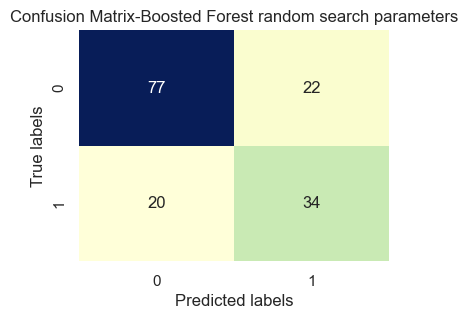

In [375]:
from xgboost import XGBClassifier
from sklearn.model_selection import RandomizedSearchCV, train_test_split
from scipy.stats import uniform, randint

# Assuming X is your feature matrix and y is your target variable
X_train, X_test, y_train, y_test = train_test_split(x_scaled_standar, y, test_size=0.2, random_state=42)

# Set the parameters to search over
param_dist = {
    'learning_rate': uniform(0.01, 0.3),
    'max_depth': randint(3, 10),
    'n_estimators': randint(50, 1000)
}

# Initialize the XGBClassifier
xgb_clf = XGBClassifier(random_state=42)

# Set up RandomizedSearchCV
random_search = RandomizedSearchCV(xgb_clf, param_distributions=param_dist, n_iter=100, cv=3, random_state=42)

# Perform the random search
random_search.fit(X_train, y_train)

# Get the best parameters
best_params = random_search.best_params_
print("Best parameters:", best_params)

# Make predictions using the best model
best_model = random_search.best_estimator_
y_pred = best_model.predict(X_test)

# Evaluate the model
from sklearn.metrics import accuracy_score, classification_report
print("Accuracy normalized scaled standard:", accuracy_score(y_test, y_pred))
print(classification_report(y_test, y_pred))

cm = confusion_matrix(y_test, y_pred)

# Display the confusion matrix
plt.figure(figsize=(4, 3))
sns.heatmap(cm, annot=True, fmt='d', cmap='YlGnBu', cbar=False)
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix-Boosted Forest random search parameters')
plt.show()


In [376]:
from xgboost import XGBClassifier
from sklearn.model_selection import RandomizedSearchCV, train_test_split
from scipy.stats import uniform, randint

# Assuming X is your feature matrix and y is your target variable
X_train, X_test, y_train, y_test = train_test_split(x_scaled_minmax, y, test_size=0.2, random_state=42)

# Set the parameters to search over
param_dist = {
    'learning_rate': uniform(0.01, 0.3),
    'max_depth': randint(3, 10),
    'n_estimators': randint(100, 1000)
}

# Initialize the XGBClassifier
xgb_clf = XGBClassifier(random_state=42)

# Set up RandomizedSearchCV
random_search = RandomizedSearchCV(xgb_clf, param_distributions=param_dist, n_iter=100, cv=3, random_state=42)

# Perform the random search
random_search.fit(X_train, y_train)

# Get the best parameters
best_params = random_search.best_params_
print("Best parameters:", best_params)

# Make predictions using the best model
best_model = random_search.best_estimator_
y_pred = best_model.predict(X_test)

# Evaluate the model
from sklearn.metrics import accuracy_score, classification_report
print("Accuracy normalized  0-1 values:", accuracy_score(y_test, y_pred))
print(classification_report(y_test, y_pred))


Best parameters: {'learning_rate': 0.01165663513708072, 'max_depth': 5, 'n_estimators': 598}
Accuracy normalized  0-1 values: 0.7254901960784313
              precision    recall  f1-score   support

         0.0       0.79      0.78      0.79        99
         1.0       0.61      0.63      0.62        54

    accuracy                           0.73       153
   macro avg       0.70      0.70      0.70       153
weighted avg       0.73      0.73      0.73       153



The DataFrame does not have a separate index column.
8
9


/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/sklearn/utils/validation.py:767: FutureWarning:

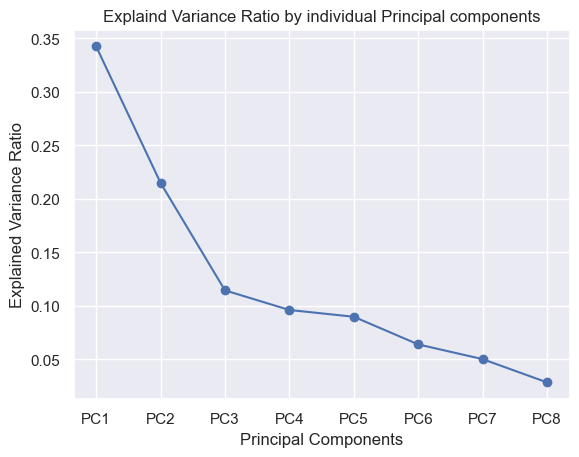

In [13]:
# try PCA analyis
# select data frame to use:
df_diabetes_preprocessed=pd.DataFrame(pd.read_csv('sample_data/diabetes_preprocessed_correct.csv'))
#df = df_diabetes_preprocessed_insulin # data with all insulin 0 lines removed
df = df_diabetes_preprocessed # the file df_diabetes_preprocessed corrected


if df.index.equals(pd.RangeIndex(start=0, stop=len(df))):
    print("The DataFrame does not have a separate index column.")
else:
    print("The DataFrame has a separate index column.")



df_x = df.iloc[:, :8]

scaler = MinMaxScaler()

df_x_norm = scaler.fit_transform(df_x)


from sklearn.decomposition import PCA
pca=PCA()
pca.fit(df_x_norm)
#pca.fit_transform(df_x_norm)

plt.plot(pca.explained_variance_ratio_,'-o')
num_components = df.shape[1]-1
print(num_components)
print(len(df.columns))
plt.xticks(np.arange(num_components), ['PC{}'.format(i+1) for i in range(num_components)])
plt.xlabel('Principal Components')
plt.ylabel('Explained Variance Ratio')
plt.title('Explaind Variance Ratio by individual Principal components')
plt.show()


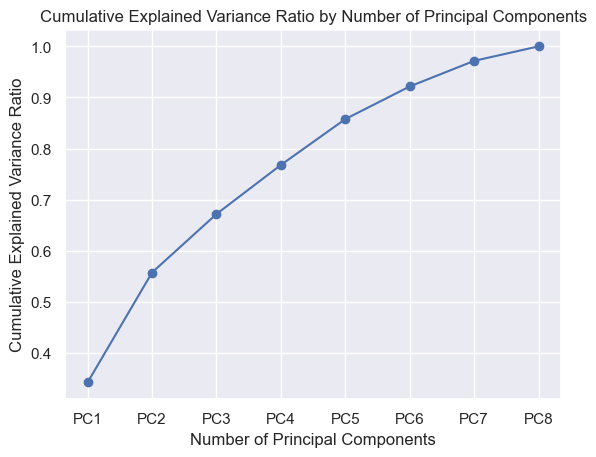

In [14]:
import numpy as np

# Calculate cumulative explained variance ratio
cumulative_variance_ratio = np.cumsum(pca.explained_variance_ratio_)

# Plot the cumulative explained variance ratio
plt.plot(cumulative_variance_ratio, '-o')
plt.xticks(np.arange(num_components), ['PC{}'.format(i+1) for i in range(num_components)])
plt.xlabel('Number of Principal Components')
plt.ylabel('Cumulative Explained Variance Ratio')
plt.title('Cumulative Explained Variance Ratio by Number of Principal Components')
plt.show()

Loadings to see the importance of each feature in each principal component
For each principal component, the loadings indicate the weight or importance of each feature in that component's direction in the feature space.

When you access pca.components_, it returns a matrix where each row corresponds to a principal component, and each column corresponds to an original feature. The values in this matrix represent the weights or coefficients of the original features in the construction of the principal components.
By analyzing these loadings, you can interpret which features have the most influence or contribute the most variance to each principal component. High absolute values in the loadings signify stronger contributions of those features to the respective principal components. This information is valuable in understanding the relationship between the original features and the derived principal components.

In PCA, the direction of the loading (positive or negative) signifies the direction in which that feature contributes to the variation captured by the principal component. While the sign (positive/negative) indicates the direction of the relationship, the magnitude signifies the strength or importance of that relationship.

Therefore, high negative loading values can indeed indicate strong features' importance, just as high positive values do, but in the inverse direction relative to the principal component.

[[ 5.90234385e-01  4.18379900e-01  2.10305735e-01  6.94512622e-02
   6.47176979e-02  1.13784103e-01  4.55253076e-02  6.39000700e-01]
 [-4.09911769e-01  6.83566241e-01  6.11008853e-02  1.84655953e-01
   3.36322502e-01  3.35711420e-01  2.30111626e-01 -2.19344601e-01]
 [ 1.52920724e-01 -4.78378458e-01  2.21443284e-01  3.71714159e-01
  -2.51525866e-02  6.77299756e-01  3.07548148e-01 -8.12852000e-02]
 [ 3.92183705e-02 -1.02656814e-01 -3.14274149e-01 -1.01603690e-01
   1.50809912e-01 -2.96809743e-01  8.67929294e-01  1.21206580e-01]
 [-6.62153257e-01 -1.29392488e-01  3.23828958e-01 -3.02620061e-02
  -2.39547255e-01 -4.27564362e-03  8.30035501e-02  6.12159218e-01]
 [-1.32242657e-01 -2.58859309e-01 -4.27484805e-01  2.23816845e-01
   6.84299998e-01  6.64676220e-02 -2.98015414e-01  3.48093207e-01]
 [ 5.23237033e-02 -1.81187099e-01  7.11853227e-01 -1.68307685e-01
   5.63855159e-01 -2.94375860e-01  3.69868014e-02 -1.53013595e-01]
 [ 2.43592424e-04  4.16144295e-02  9.94451671e-02  8.56298271e-01
  -

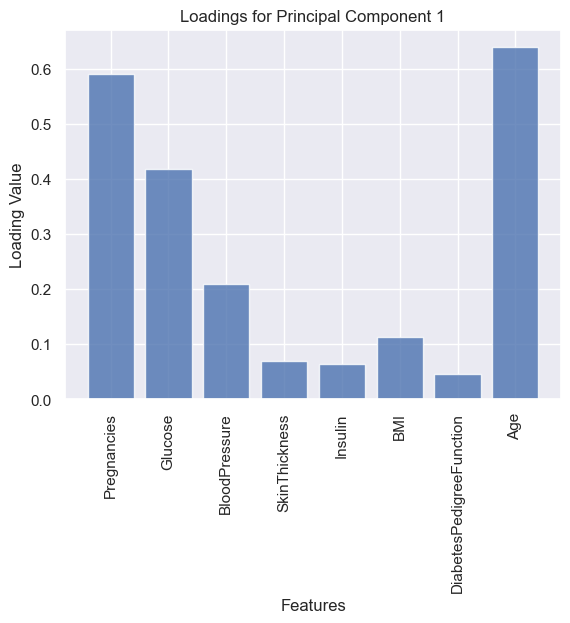

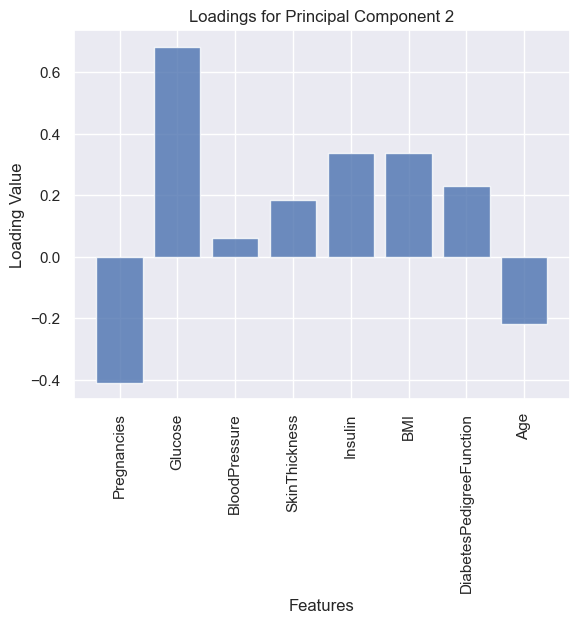

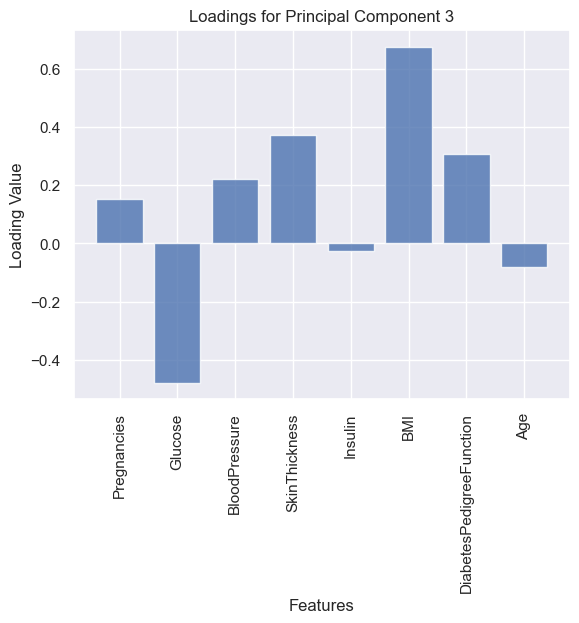

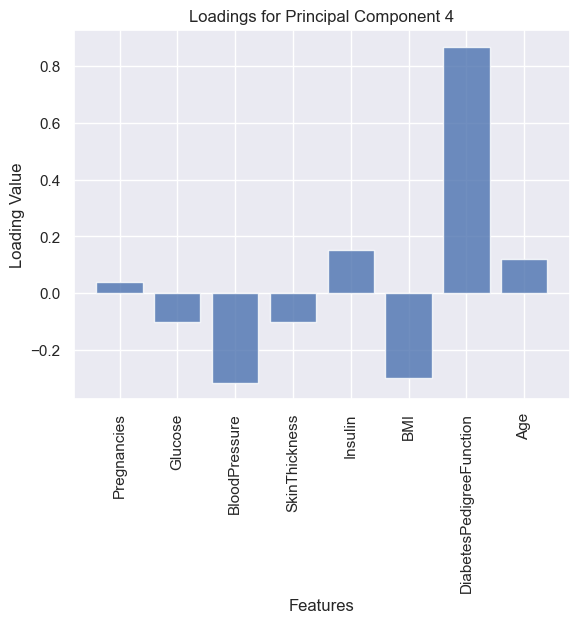

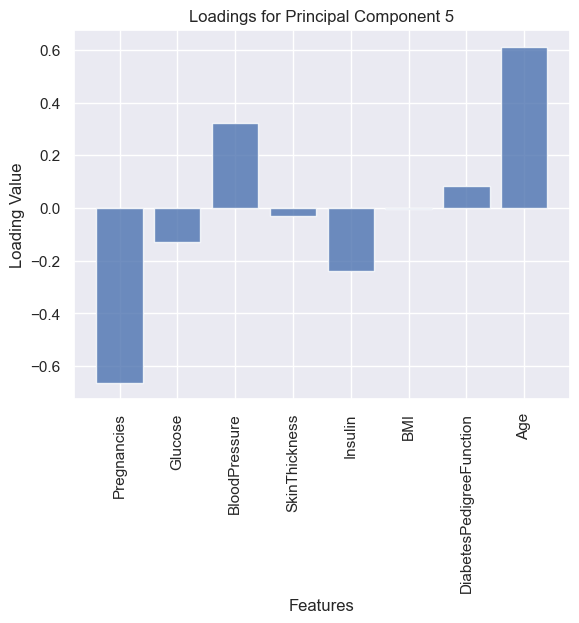

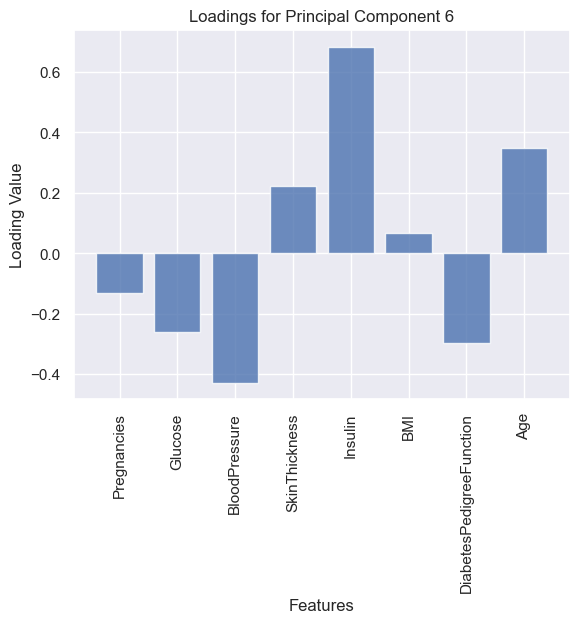

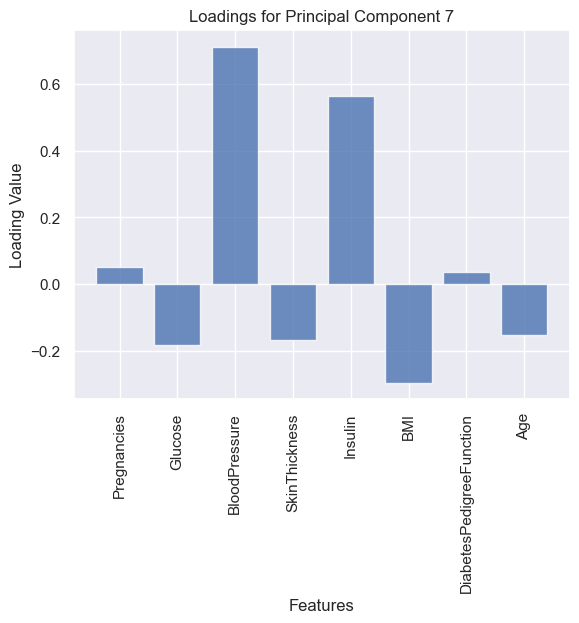

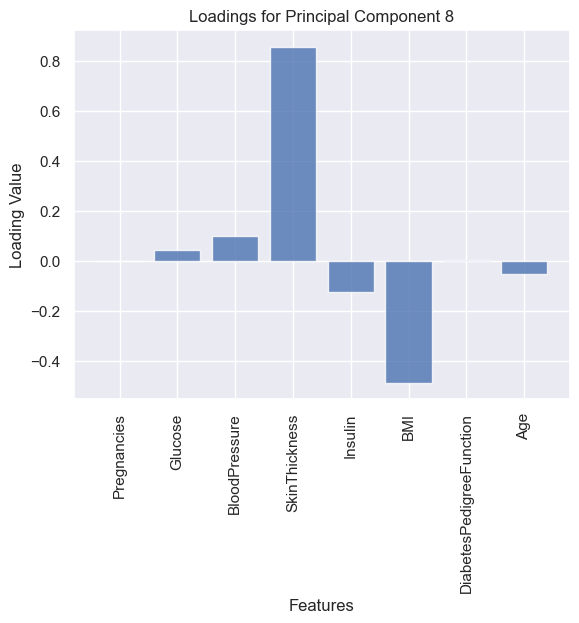

In [85]:
loadings = pca.components_
print(loadings)
# Print the loadings for each principal component
for i, component in enumerate(loadings):
    print(f"Loadings for Principal Component {i + 1}: {component}")



# Plotting the loadings for each principal component
num_components = len(loadings)
num_features = loadings.shape[1]


for i in range(num_components):
    plt.figure()
    plt.bar(features, loadings[i], alpha=0.8)
    plt.xlabel('Features')
    plt.ylabel('Loading Value')
    plt.title(f'Loadings for Principal Component {i + 1}')
    plt.xticks(rotation=90)
    plt.show()


          PC1       PC2       PC3       PC4       PC5       PC6       PC7  \
0   -0.273292  0.224595  0.119320  0.466297  0.047976 -0.176744 -0.013415   
1   -0.319526  0.025590  0.042961  0.002493  0.071864 -0.094116  0.030967   
2    0.473390 -0.109459 -0.057278  0.091227  0.363999  0.049494 -0.063878   
3    0.410220 -0.206830  0.002035 -0.120966  0.135092 -0.051648  0.091717   
4   -0.359233 -0.139802 -0.204780  0.039947 -0.019640 -0.001750  0.078448   
..        ...       ...       ...       ...       ...       ...       ...   
756 -0.030437  0.530847  0.301442 -0.115379  0.041402 -0.037806 -0.182570   
757 -0.295095  0.106064  0.367386 -0.007636 -0.082158  0.285488 -0.419731   
758 -0.005065  0.366926  0.490686 -0.097129 -0.023666 -0.063872  0.164761   
759  0.067750  0.796527  0.585284  0.420890  0.113769 -0.333227 -0.271265   
760 -0.017323  0.447107  0.572196 -0.431485  0.169344 -0.049974  0.048424   

          PC8  
0   -0.033008  
1   -0.020258  
2   -0.047259  
3   -0.0231

<Figure size 640x480 with 0 Axes>

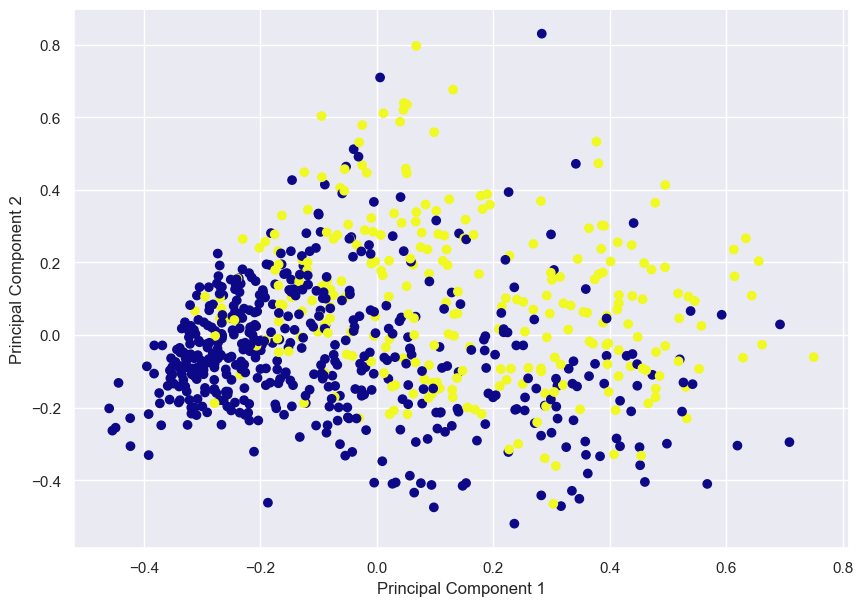

<Figure size 640x480 with 0 Axes>

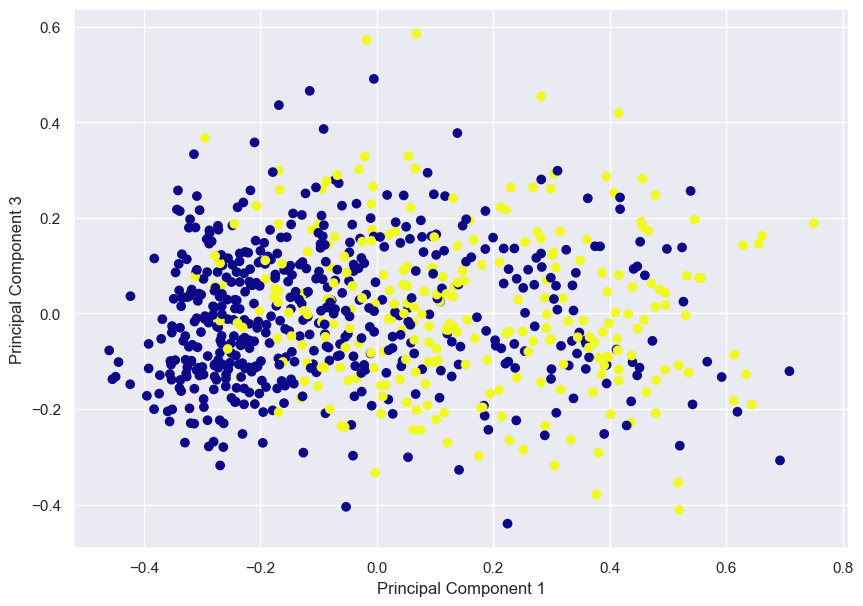

<Figure size 640x480 with 0 Axes>

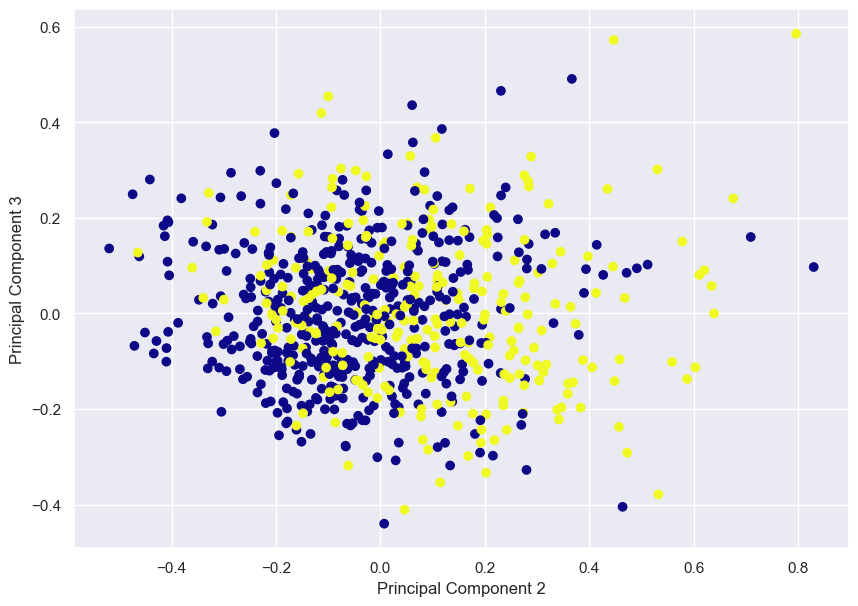

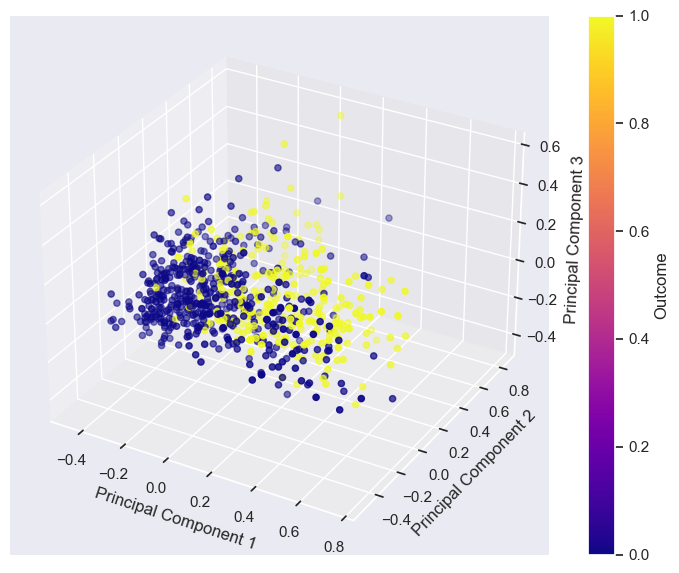

In [15]:


#3. Perform PCA 
pca = PCA(n_components=8)  
principal_components = pca.fit_transform(df_x_norm) #it can be performed with transformation for feature reduction
#principal_components = pca.fit(df_x_norm)
principal_df = pd.DataFrame(data=principal_components, columns=['PC1', 'PC2','PC3','PC4','PC5','PC6', 'PC7','PC8'])
print(principal_df)




# 4. Visualize the Results
# Create plots to visualize the results
plt.figure()
plt.figure(figsize=(10, 7))
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.scatter(principal_df['PC1'], principal_df['PC2'], c=df['Outcome'], marker='o',cmap='plasma',label='Outcome')
plt.show()

plt.figure()
plt.figure(figsize=(10, 7))
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 3')
plt.scatter(principal_df['PC1'], principal_df['PC3'], c=df['Outcome'], marker='o',cmap='plasma',label='Outcome')
plt.show()

plt.figure()
plt.figure(figsize=(10, 7))
plt.xlabel('Principal Component 2')
plt.ylabel('Principal Component 3')
plt.scatter(principal_df['PC2'], principal_df['PC3'], c=df['Outcome'], marker='o',cmap='plasma',label='Outcome')
plt.show()


#%matplotlib notebook
from mpl_toolkits.mplot3d import Axes3D

# Create a new figure and set it up for 3D projection
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')

# Plot the data points in 3D
scatter = ax.scatter(principal_df['PC1'], principal_df['PC2'], principal_df['PC3'], c=df['Outcome'], cmap='plasma')
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')

# Create a colorbar for the points
plt.colorbar(scatter, label='Outcome')

# Show the plot
plt.show()



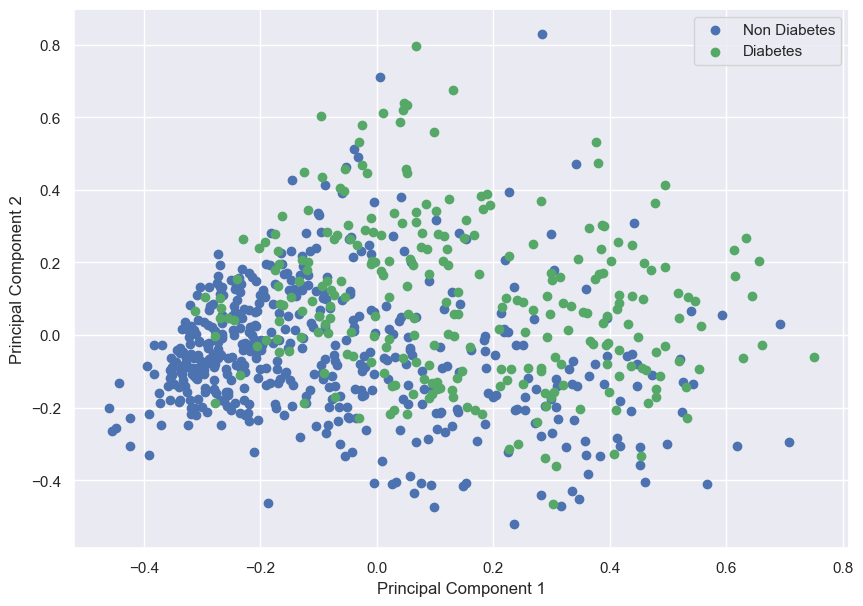

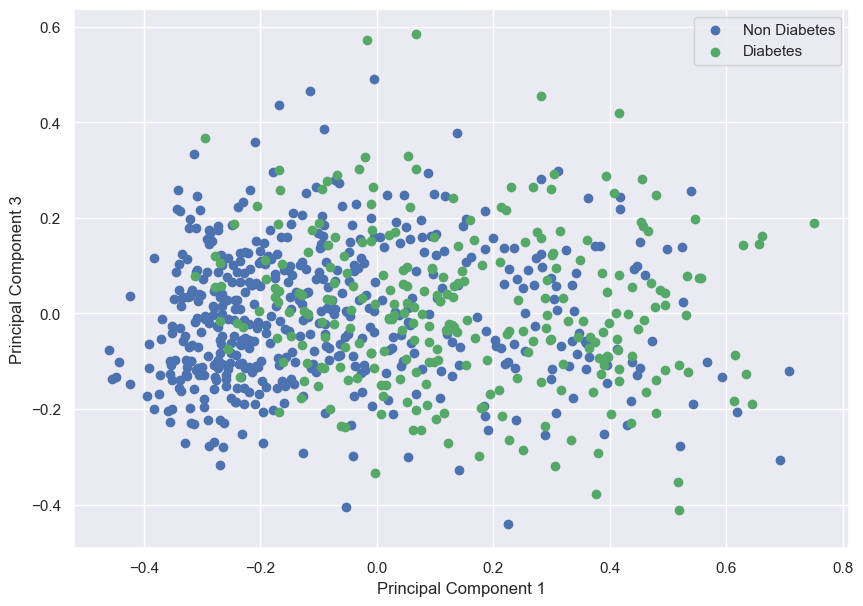

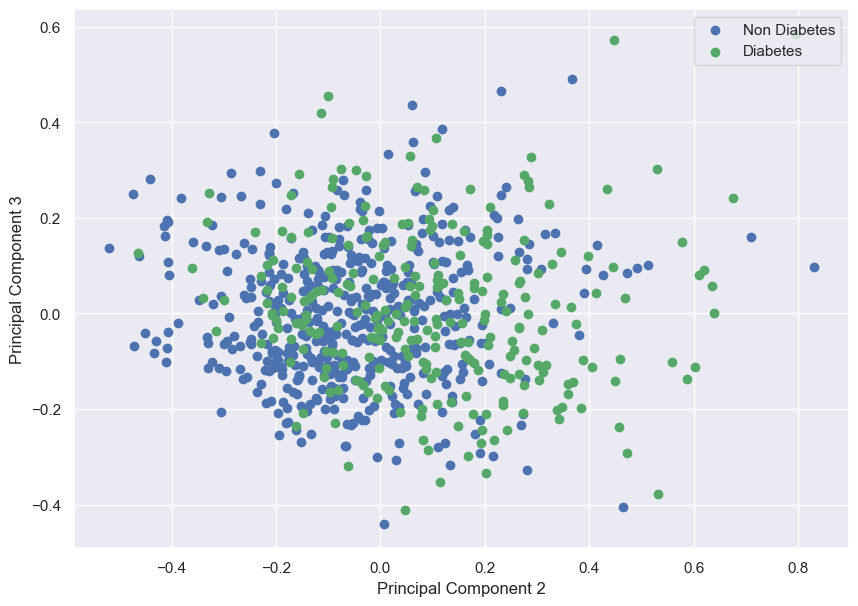

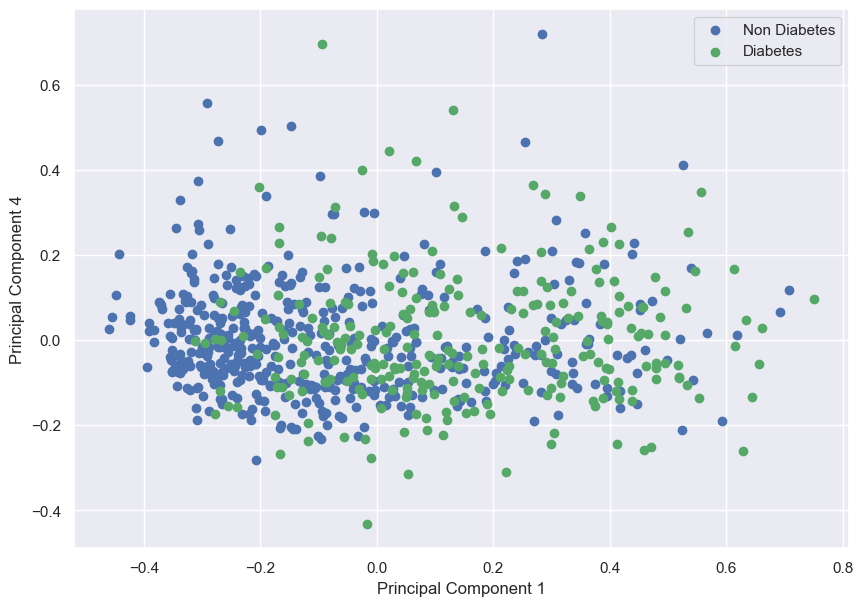

In [87]:



plt.figure(figsize=(10, 7))
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.scatter(principal_df.loc[df['Outcome'] == 0, 'PC1'], 
            principal_df.loc[df['Outcome'] == 0, 'PC2'], 
            c='b', marker='o', label='Non Diabetes')
plt.scatter(principal_df.loc[df['Outcome'] == 1, 'PC1'], 
            principal_df.loc[df['Outcome'] == 1, 'PC2'], 
            c='g', marker='o', label='Diabetes')
plt.legend(loc='upper right')
plt.show()

plt.figure(figsize=(10, 7))
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 3')
plt.scatter(principal_df.loc[df['Outcome'] == 0, 'PC1'], 
            principal_df.loc[df['Outcome'] == 0, 'PC3'], 
            c='b', marker='o', label='Non Diabetes')
plt.scatter(principal_df.loc[df['Outcome'] == 1, 'PC1'], 
            principal_df.loc[df['Outcome'] == 1, 'PC3'], 
            c='g', marker='o', label='Diabetes')
plt.legend(loc='upper right')
plt.show()

plt.figure(figsize=(10, 7))
plt.xlabel('Principal Component 2')
plt.ylabel('Principal Component 3')
plt.scatter(principal_df.loc[df['Outcome'] == 0, 'PC2'], 
            principal_df.loc[df['Outcome'] == 0, 'PC3'], 
            c='b', marker='o', label='Non Diabetes')
plt.scatter(principal_df.loc[df['Outcome'] == 1, 'PC2'], 
            principal_df.loc[df['Outcome'] == 1, 'PC3'], 
            c='g', marker='o', label='Diabetes')
plt.legend(loc='upper right')
plt.show()



plt.figure(figsize=(10, 7))
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 4')
plt.scatter(principal_df.loc[df['Outcome'] == 0, 'PC1'], 
            principal_df.loc[df['Outcome'] == 0, 'PC4'], 
            c='b', marker='o', label='Non Diabetes')
plt.scatter(principal_df.loc[df['Outcome'] == 1, 'PC1'], 
            principal_df.loc[df['Outcome'] == 1, 'PC4'], 
            c='g', marker='o', label='Diabetes')
plt.legend(loc='upper right')
plt.show()

/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/sklearn/utils/validation.py:767: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if not hasattr(array, "sparse") and array.dtypes.apply(is_sparse).any():
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/sklearn/utils/validation.py:605: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype):
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/sklearn/utils/validation.py:614: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(pd_dtype) or not is_extension_array_dtype(pd_dtype):
/Users/paula/opt/anaconda3/envs/Env_3_10_13/lib/python3.10/site-packages/sklearn/utils/validation.py:767: FutureWarning:

training time: 0.0s in 10 iterations
training score : 0.750 in 10 iterations
test score : 0.739 in 10 iterations
training time: 0.0s in 20 iterations
training score : 0.750 in 20 iterations
test score : 0.739 in 20 iterations
training time: 0.0s in 30 iterations
training score : 0.750 in 30 iterations
test score : 0.739 in 30 iterations
training time: 0.0s in 50 iterations
training score : 0.750 in 50 iterations
test score : 0.739 in 50 iterations
training time: 0.0s in 100 iterations
training score : 0.750 in 100 iterations
test score : 0.739 in 100 iterations
training time: 0.0s in 10000 iterations
training score : 0.750 in 10000 iterations
test score : 0.739 in 10000 iterations


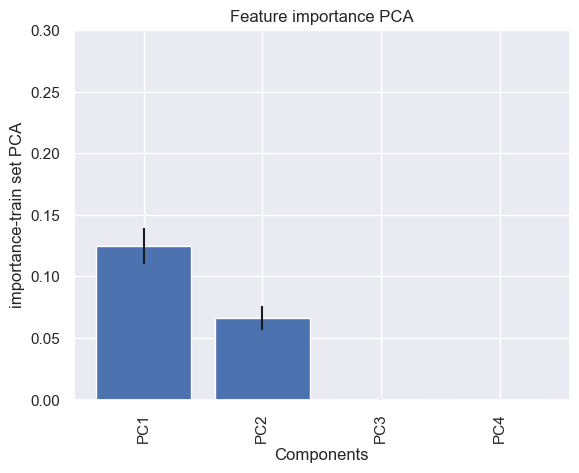

Confusion Matrix test:
[[87 12]
 [28 26]]
Confusion Matrix train:
[[349  46]
 [106 107]]


NameError: name 'ConfusionMatrixDisplay' is not defined

In [19]:
# make a logistic regression witht the principal components 
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

# 1. Combine Principal Components with Outcome Variable

df_final = pd.concat([principal_df, df['Outcome']], axis=1)

# 2. Split Data into Training and Testing Sets
# choose the principal components to use in the regression
#Components = ['PC1', 'PC2','PC3','PC4','PC5','PC6','PC7','PC8']
#Components = ['PC1', 'PC2','PC3','PC4','PC5']
#Components =['PC1', 'PC2','PC3']
Components =['PC1', 'PC2','PC3','PC4']
#Components = ['PC1', 'PC2']
X = df_final[Components]  # Use the principal components as feature
scaler = MinMaxScaler()

X_norm = scaler.fit_transform(X)

Y = df_final['Outcome']  # Use the outcome variable
# transform to np arrays


y= Y.to_numpy().astype(np.float32)

x_train, x_test, y_train, y_test = train_test_split(X_norm, y, test_size=0.2, random_state=42)

for n_iter in (10, 20, 30,50, 100, 10000):
  clf = linear_model.LogisticRegression(solver='liblinear', max_iter= n_iter,
                                      multi_class='ovr')
#logreg = LogisticRegression(multi_class='ovr', solver='liblinear')

# 2. fit the model
  t1 = timer()
  clf.fit(x_train, y_train)
  t2 = timer()
  print ('training time: %.1fs'%(t2-t1),'in', n_iter, 'iterations')

# 3. evaluate accuracy on train and test datasets
  print("training score : %.3f" % (clf.score(x_train, y_train)),'in', n_iter, 'iterations')
  print("test score : %.3f" % (clf.score(x_test, y_test)),'in', n_iter, 'iterations')


# feature importance

p_importances = permutation_importance(clf, x_train, y_train, n_repeats=20, n_jobs=-1,random_state=42)

plt.bar(Components,
        p_importances.importances_mean,
        yerr=p_importances.importances_std)
plt.xticks(rotation=90)
plt.xlabel('Components')
plt.ylabel('importance-train set PCA')
plt.title('Feature importance PCA')
plt.ylim(0, 0.3)
plt.show()

# 4. evaluate the confusion matrix on the test set using, from sklearn import metrics the metrics.confusion_matrix method (check documentation)


y_pred_test = clf.predict(x_test)
#y_pred_test_proba= clf.predict_proba(x_test)
#np.sum(_pred_test_proba[0])
sklearn.metrics.confusion_matrix(y_test, y_pred_test, labels=None, sample_weight=None, normalize=None)
y_pred_train=clf.predict(x_train)
sklearn.metrics.confusion_matrix(y_train,y_pred_train)



# Calculate the confusion matrix
confusion_test = confusion_matrix(y_test, y_pred_test)

print("Confusion Matrix test:")
print(confusion_test)

confusion_train = confusion_matrix(y_train, y_pred_train)

print("Confusion Matrix train:")
print(confusion_train)

cm_display = ConfusionMatrixDisplay(confusion_test).plot()
plt.title('Confusion Matrix Test PCA')
cm_display = ConfusionMatrixDisplay(confusion_train).plot()
plt.title('Confusion Matrix Train PCA')
plt.show()

Output_names = ['Non-diabetes', 'Diabetes']

print(f'Check that you get the same accuracy from the score method: {np.sum([confusion_test[i,i] for i in range(2)])/np.sum(confusion_test)}')
#sums the diagonal and divide the whole matrix
precisions=[]
recalls=[]
#precision
for i in range(2):
    precisions.append(confusion_test[i,i]/np.sum(confusion_test[:,i])) #take the diagonal divided by the whole column
#percentage of positive identified??
#recall
for i in range(2):
    recalls.append(confusion_test[i,i]/np.sum(confusion_test[i,:])) #take the diagonal and divide by the whole row

plt.plot(Output_names,precisions, label='precision')
plt.plot(Output_names,recalls, label='recall')
plt.title('PCA-Regression')
plt.xticks(rotation=90)
plt.legend()

plt.show()

print(classification_report(y_test, y_pred_test))
print(classification_report(y_train,y_pred_train))

# Display the confusion matrix with values and percentages
cm_sum = np.sum(confusion_test, axis=1, keepdims=True)
cm_percentages = confusion_test / cm_sum.astype(float) * 100
cm_with_percentages = np.round(cm_percentages, 2)

plt.figure(figsize=(6, 4))
sns.heatmap(
    confusion_test,
    annot=np.array([f'{v1}\n{v2}%' for v1, v2 in zip(confusion_test.flatten(), cm_with_percentages.flatten())]).reshape(confusion_test.shape),
    fmt='',
    cmap='viridis',
    cbar=False
)
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix Test')
plt.show()


cm_sum = np.sum(confusion_train, axis=1, keepdims=True)
cm_percentages = confusion_train / cm_sum.astype(float) * 100
cm_with_percentages = np.round(cm_percentages, 2)

# Display the confusion matrix with values and percentages
plt.figure(figsize=(6, 4))
sns.heatmap(
    confusion_train,
    annot=np.array([f'{v1}\n{v2}%' for v1, v2 in zip(confusion_train.flatten(), cm_with_percentages.flatten())]).reshape(confusion_train.shape),
    fmt='',
    cmap='viridis',
    cbar=False
)
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix Train')
plt.show()

 estimator: 1 depth: 4 test score:0.6339869281045751
 estimator: 1 depth: 4 train score:0.7450657894736842
Accuracy test: 0.6339869281045751
Accuracy test: 0.7450657894736842
Classification Report:
              precision    recall  f1-score   support

         0.0       0.72      0.72      0.72        99
         1.0       0.48      0.48      0.48        54

    accuracy                           0.63       153
   macro avg       0.60      0.60      0.60       153
weighted avg       0.63      0.63      0.63       153



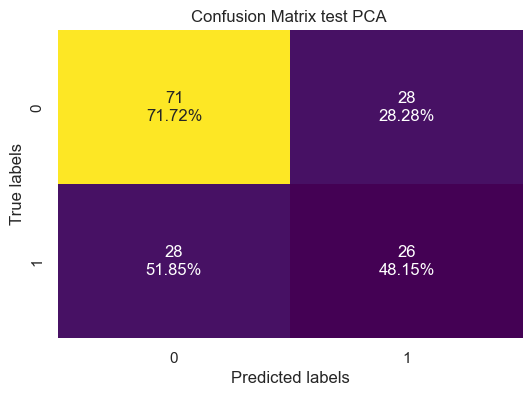

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.82      0.78      0.80       395
         1.0       0.62      0.69      0.65       213

    accuracy                           0.75       608
   macro avg       0.72      0.73      0.73       608
weighted avg       0.75      0.75      0.75       608



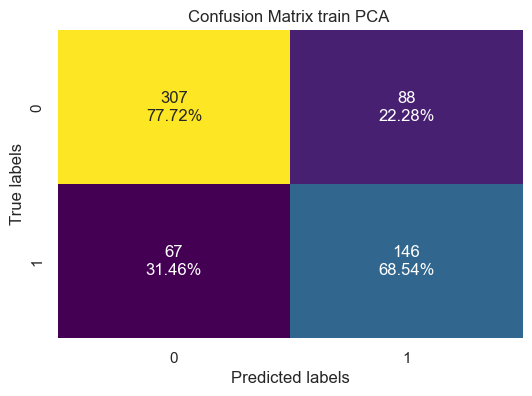

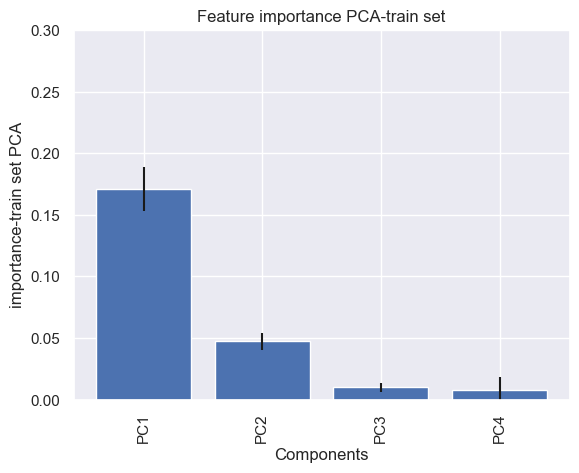

 estimator: 5 depth: 4 test score:0.7320261437908496
 estimator: 5 depth: 4 train score:0.8125
Accuracy test: 0.7320261437908496
Accuracy test: 0.8125
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.78      0.79        99
         1.0       0.61      0.65      0.63        54

    accuracy                           0.73       153
   macro avg       0.71      0.71      0.71       153
weighted avg       0.74      0.73      0.73       153



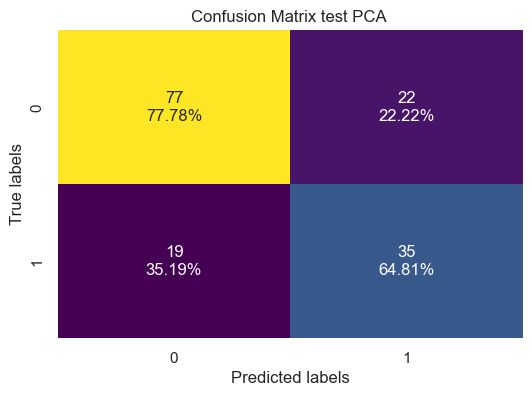

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.83      0.89      0.86       395
         1.0       0.77      0.67      0.71       213

    accuracy                           0.81       608
   macro avg       0.80      0.78      0.79       608
weighted avg       0.81      0.81      0.81       608



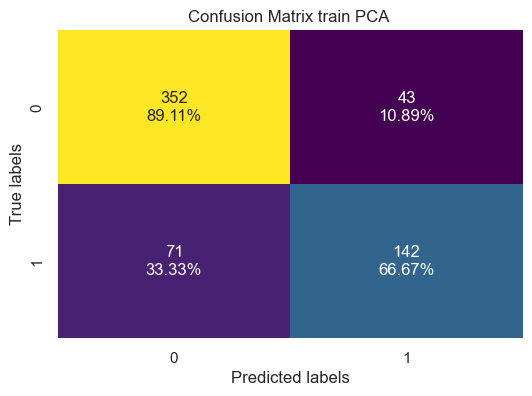

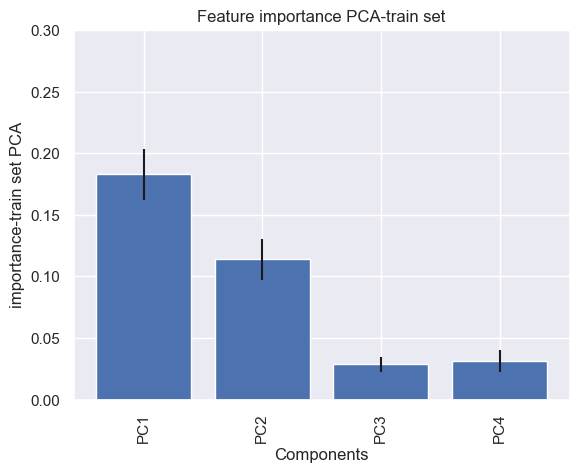

 estimator: 10 depth: 4 test score:0.7254901960784313
 estimator: 10 depth: 4 train score:0.819078947368421
Accuracy test: 0.7254901960784313
Accuracy test: 0.819078947368421
Classification Report:
              precision    recall  f1-score   support

         0.0       0.81      0.76      0.78        99
         1.0       0.60      0.67      0.63        54

    accuracy                           0.73       153
   macro avg       0.70      0.71      0.71       153
weighted avg       0.73      0.73      0.73       153



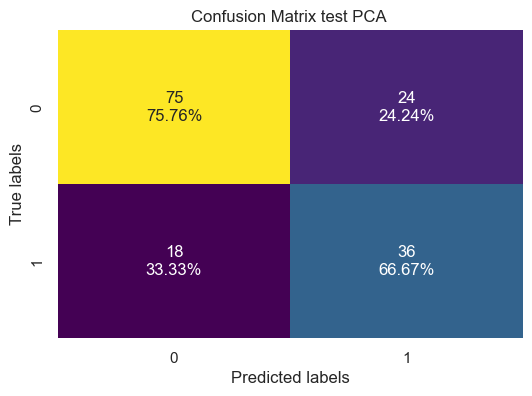

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.86      0.86      0.86       395
         1.0       0.74      0.74      0.74       213

    accuracy                           0.82       608
   macro avg       0.80      0.80      0.80       608
weighted avg       0.82      0.82      0.82       608



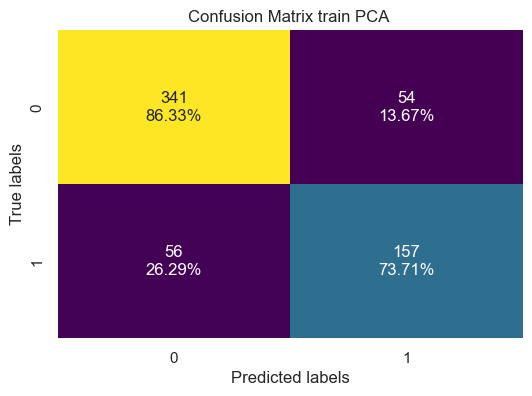

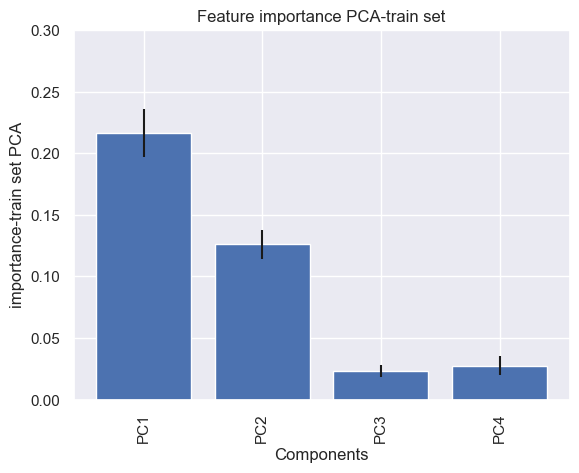

 estimator: 20 depth: 4 test score:0.7516339869281046
 estimator: 20 depth: 4 train score:0.8157894736842105
Accuracy test: 0.7516339869281046
Accuracy test: 0.8157894736842105
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.83      0.81        99
         1.0       0.66      0.61      0.63        54

    accuracy                           0.75       153
   macro avg       0.73      0.72      0.72       153
weighted avg       0.75      0.75      0.75       153



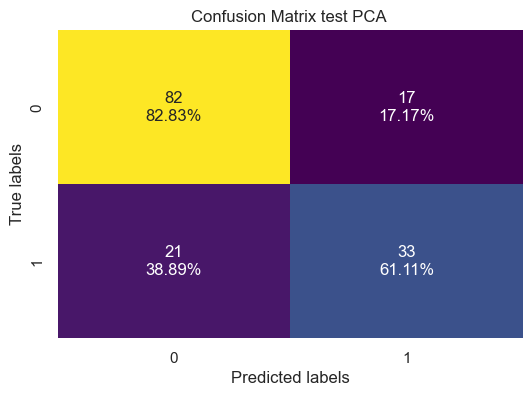

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.83      0.90      0.86       395
         1.0       0.78      0.66      0.72       213

    accuracy                           0.82       608
   macro avg       0.81      0.78      0.79       608
weighted avg       0.81      0.82      0.81       608



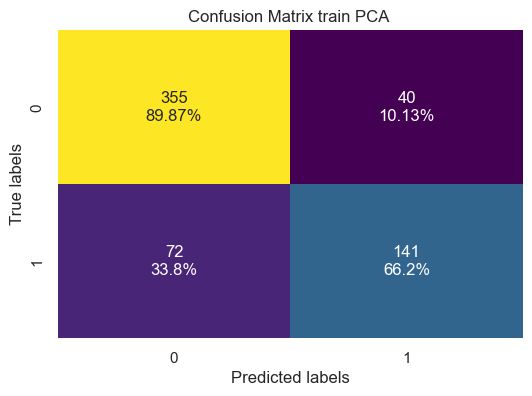

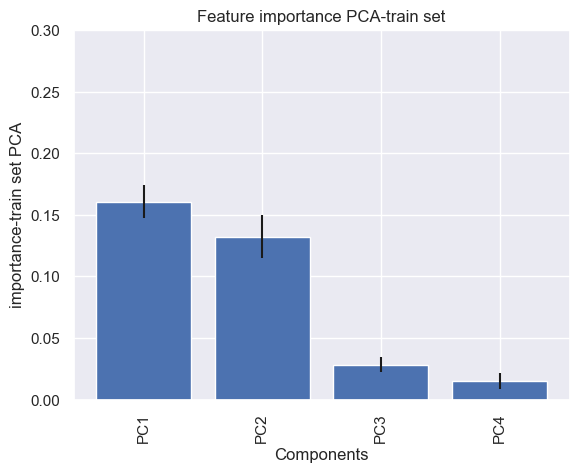

 estimator: 50 depth: 4 test score:0.738562091503268
 estimator: 50 depth: 4 train score:0.8240131578947368
Accuracy test: 0.738562091503268
Accuracy test: 0.8240131578947368
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.80      0.80        99
         1.0       0.63      0.63      0.63        54

    accuracy                           0.74       153
   macro avg       0.71      0.71      0.71       153
weighted avg       0.74      0.74      0.74       153



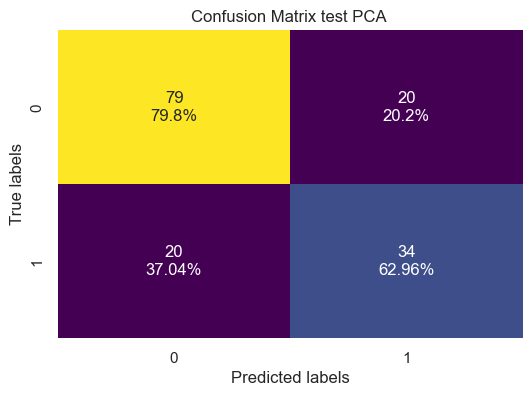

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.84      0.90      0.87       395
         1.0       0.79      0.68      0.73       213

    accuracy                           0.82       608
   macro avg       0.81      0.79      0.80       608
weighted avg       0.82      0.82      0.82       608



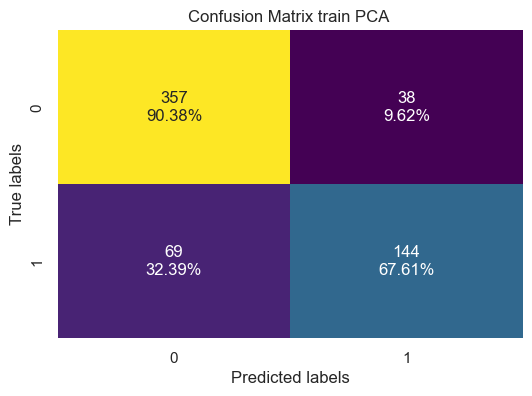

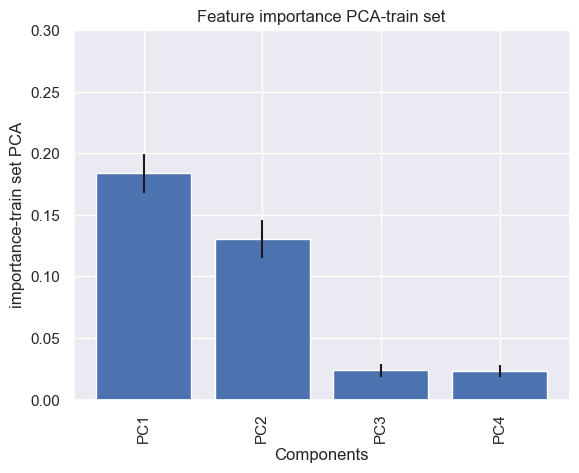

 estimator: 100 depth: 4 test score:0.7581699346405228
 estimator: 100 depth: 4 train score:0.8305921052631579
Accuracy test: 0.7581699346405228
Accuracy test: 0.8305921052631579
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.84      0.82        99
         1.0       0.67      0.61      0.64        54

    accuracy                           0.76       153
   macro avg       0.74      0.72      0.73       153
weighted avg       0.75      0.76      0.76       153



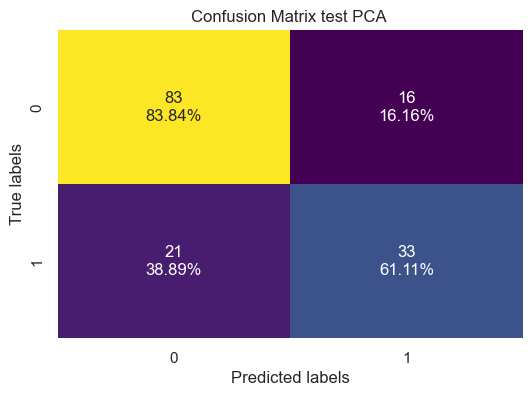

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.83      0.92      0.88       395
         1.0       0.82      0.66      0.73       213

    accuracy                           0.83       608
   macro avg       0.83      0.79      0.80       608
weighted avg       0.83      0.83      0.83       608



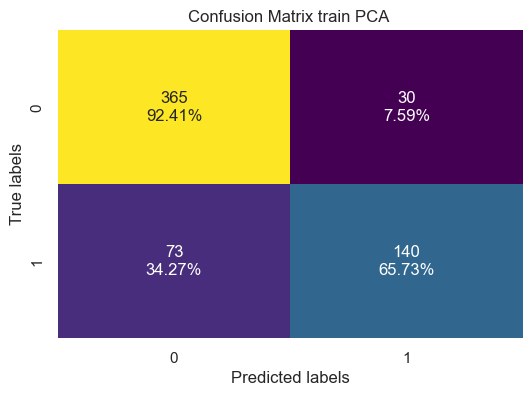

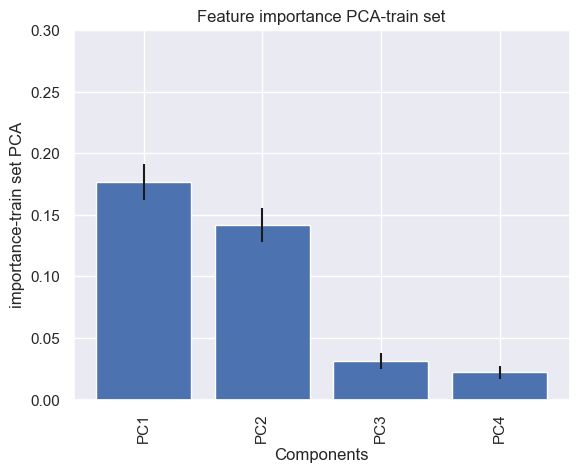

 estimator: 150 depth: 4 test score:0.7516339869281046
 estimator: 150 depth: 4 train score:0.8256578947368421
Accuracy test: 0.7516339869281046
Accuracy test: 0.8256578947368421
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.82      0.81        99
         1.0       0.65      0.63      0.64        54

    accuracy                           0.75       153
   macro avg       0.73      0.72      0.73       153
weighted avg       0.75      0.75      0.75       153



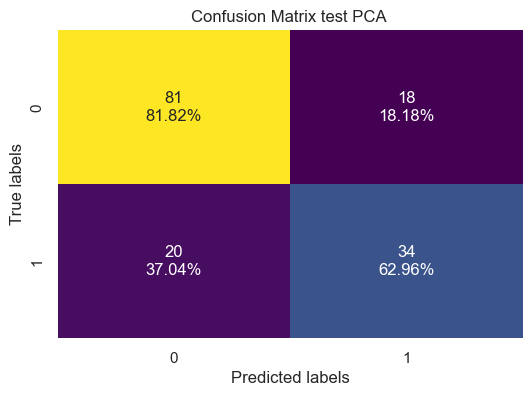

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.84      0.91      0.87       395
         1.0       0.80      0.68      0.73       213

    accuracy                           0.83       608
   macro avg       0.82      0.79      0.80       608
weighted avg       0.82      0.83      0.82       608



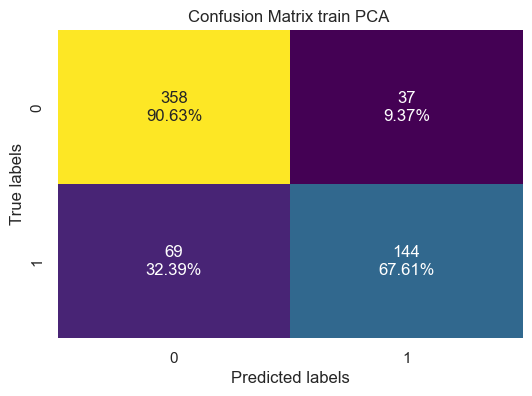

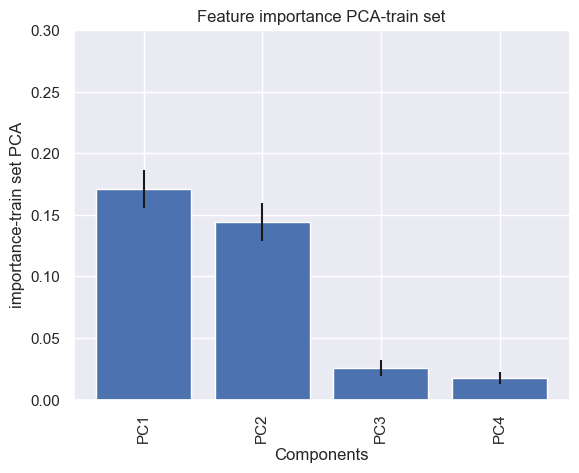

 estimator: 200 depth: 4 test score:0.7516339869281046
 estimator: 200 depth: 4 train score:0.8256578947368421
Accuracy test: 0.7516339869281046
Accuracy test: 0.8256578947368421
Classification Report:
              precision    recall  f1-score   support

         0.0       0.81      0.81      0.81        99
         1.0       0.65      0.65      0.65        54

    accuracy                           0.75       153
   macro avg       0.73      0.73      0.73       153
weighted avg       0.75      0.75      0.75       153



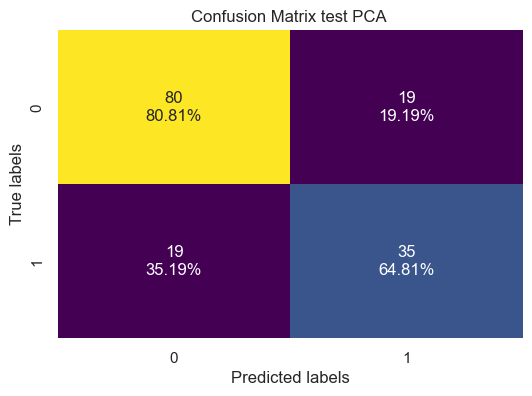

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.84      0.91      0.87       395
         1.0       0.80      0.68      0.73       213

    accuracy                           0.83       608
   macro avg       0.82      0.79      0.80       608
weighted avg       0.82      0.83      0.82       608



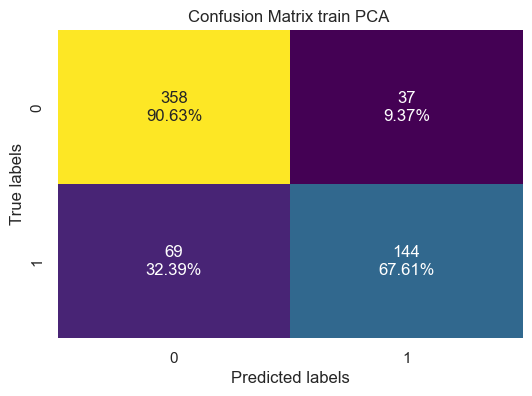

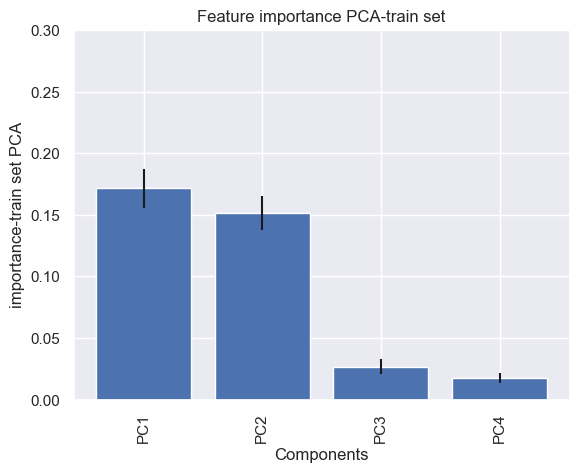

 estimator: 500 depth: 4 test score:0.7516339869281046
 estimator: 500 depth: 4 train score:0.8240131578947368
Accuracy test: 0.7516339869281046
Accuracy test: 0.8240131578947368
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.82      0.81        99
         1.0       0.65      0.63      0.64        54

    accuracy                           0.75       153
   macro avg       0.73      0.72      0.73       153
weighted avg       0.75      0.75      0.75       153



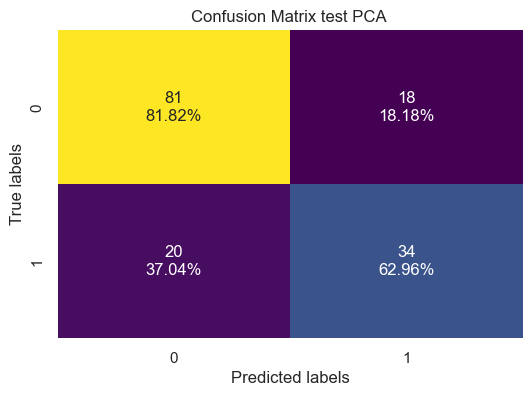

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.84      0.91      0.87       395
         1.0       0.79      0.67      0.73       213

    accuracy                           0.82       608
   macro avg       0.82      0.79      0.80       608
weighted avg       0.82      0.82      0.82       608



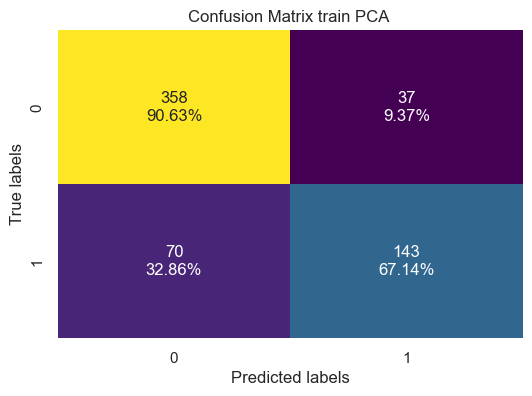

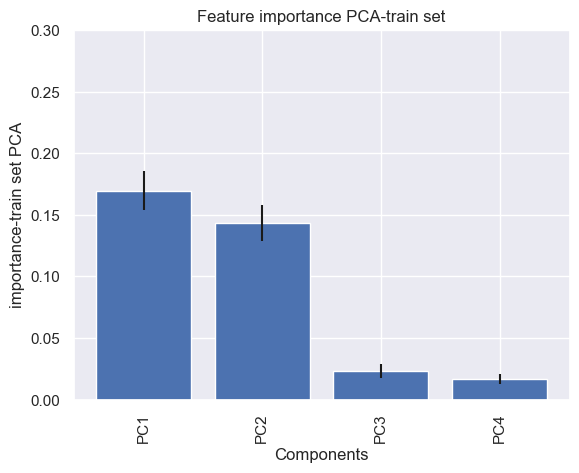

 estimator: 1 depth: 8 test score:0.7320261437908496
 estimator: 1 depth: 8 train score:0.8585526315789473
Accuracy test: 0.7320261437908496
Accuracy test: 0.8585526315789473
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.79      0.79        99
         1.0       0.62      0.63      0.62        54

    accuracy                           0.73       153
   macro avg       0.71      0.71      0.71       153
weighted avg       0.73      0.73      0.73       153



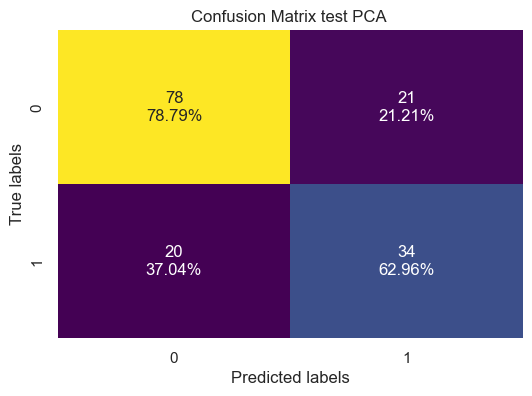

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.88      0.91      0.89       395
         1.0       0.82      0.77      0.79       213

    accuracy                           0.86       608
   macro avg       0.85      0.84      0.84       608
weighted avg       0.86      0.86      0.86       608



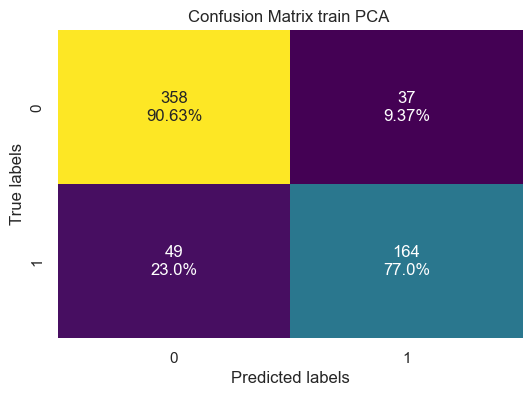

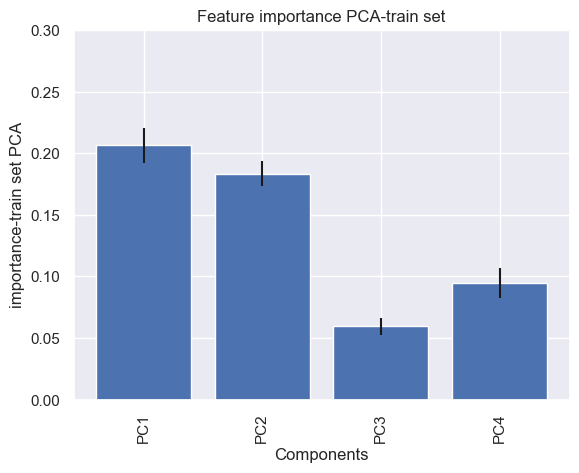

 estimator: 5 depth: 8 test score:0.7254901960784313
 estimator: 5 depth: 8 train score:0.9177631578947368
Accuracy test: 0.7254901960784313
Accuracy test: 0.9177631578947368
Classification Report:
              precision    recall  f1-score   support

         0.0       0.81      0.75      0.78        99
         1.0       0.60      0.69      0.64        54

    accuracy                           0.73       153
   macro avg       0.70      0.72      0.71       153
weighted avg       0.74      0.73      0.73       153



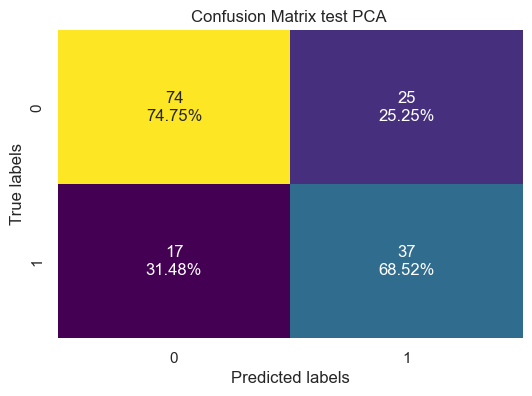

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.93      0.94      0.94       395
         1.0       0.89      0.87      0.88       213

    accuracy                           0.92       608
   macro avg       0.91      0.91      0.91       608
weighted avg       0.92      0.92      0.92       608



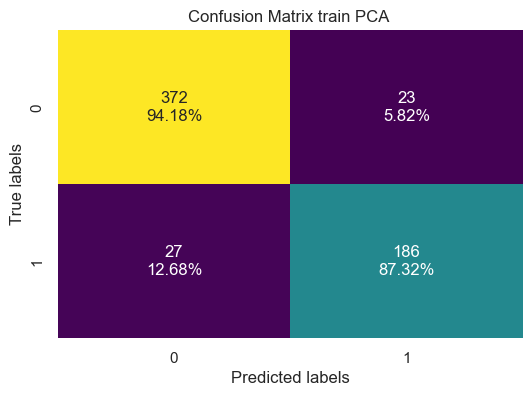

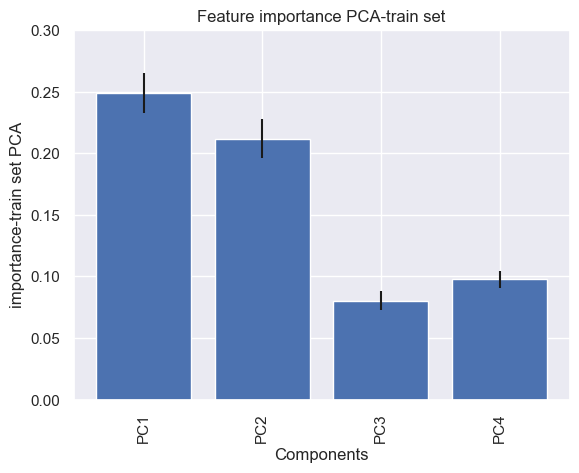

 estimator: 10 depth: 8 test score:0.7254901960784313
 estimator: 10 depth: 8 train score:0.944078947368421
Accuracy test: 0.7254901960784313
Accuracy test: 0.944078947368421
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.77      0.78        99
         1.0       0.60      0.65      0.62        54

    accuracy                           0.73       153
   macro avg       0.70      0.71      0.70       153
weighted avg       0.73      0.73      0.73       153



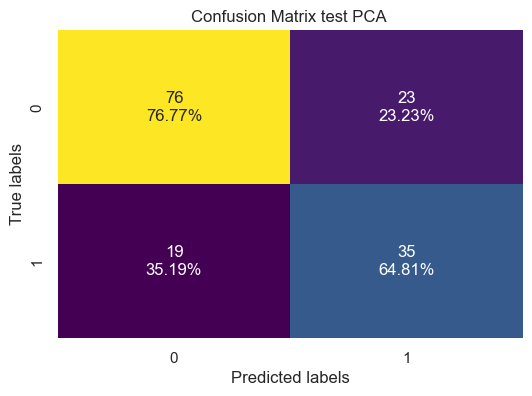

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.96      0.95      0.96       395
         1.0       0.91      0.93      0.92       213

    accuracy                           0.94       608
   macro avg       0.94      0.94      0.94       608
weighted avg       0.94      0.94      0.94       608



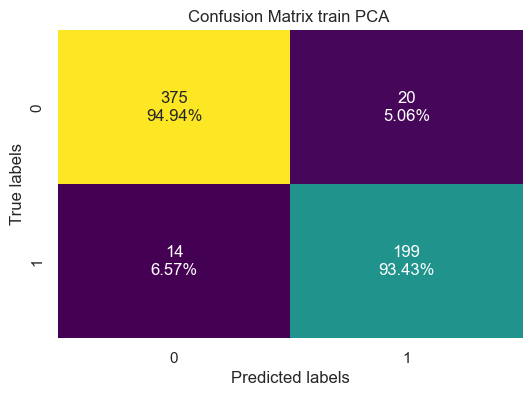

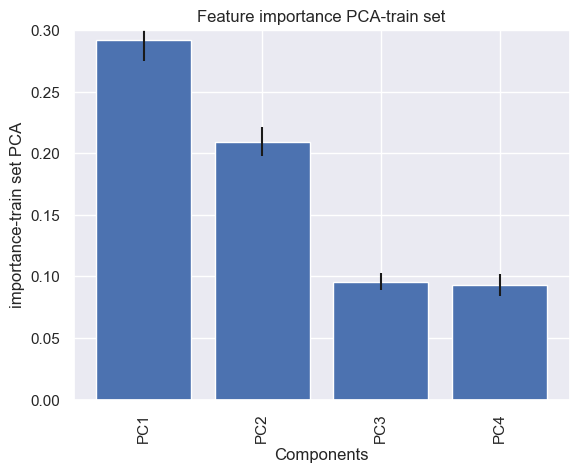

 estimator: 20 depth: 8 test score:0.7189542483660131
 estimator: 20 depth: 8 train score:0.9457236842105263
Accuracy test: 0.7189542483660131
Accuracy test: 0.9457236842105263
Classification Report:
              precision    recall  f1-score   support

         0.0       0.79      0.78      0.78        99
         1.0       0.60      0.61      0.61        54

    accuracy                           0.72       153
   macro avg       0.69      0.69      0.69       153
weighted avg       0.72      0.72      0.72       153



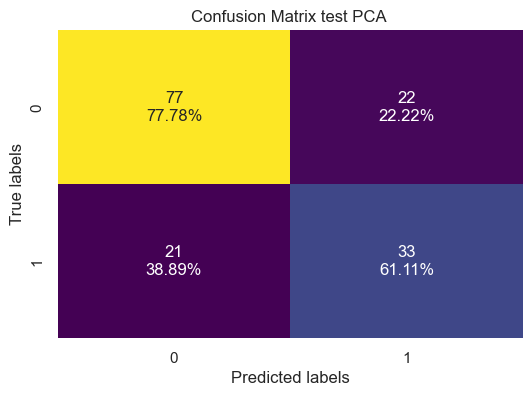

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.96      0.95      0.96       395
         1.0       0.92      0.93      0.92       213

    accuracy                           0.95       608
   macro avg       0.94      0.94      0.94       608
weighted avg       0.95      0.95      0.95       608



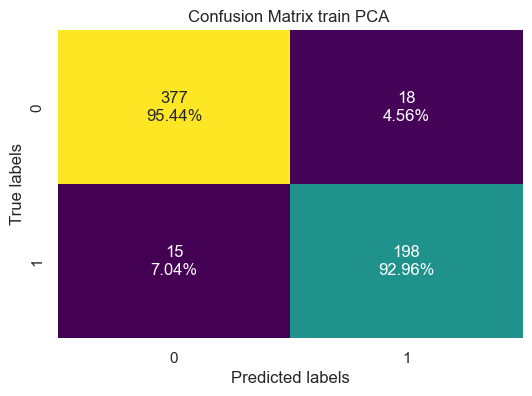

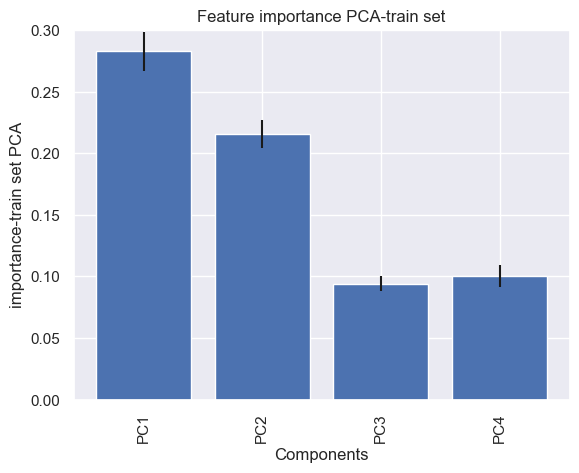

 estimator: 50 depth: 8 test score:0.7320261437908496
 estimator: 50 depth: 8 train score:0.962171052631579
Accuracy test: 0.7320261437908496
Accuracy test: 0.962171052631579
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.78      0.79        99
         1.0       0.61      0.65      0.63        54

    accuracy                           0.73       153
   macro avg       0.71      0.71      0.71       153
weighted avg       0.74      0.73      0.73       153



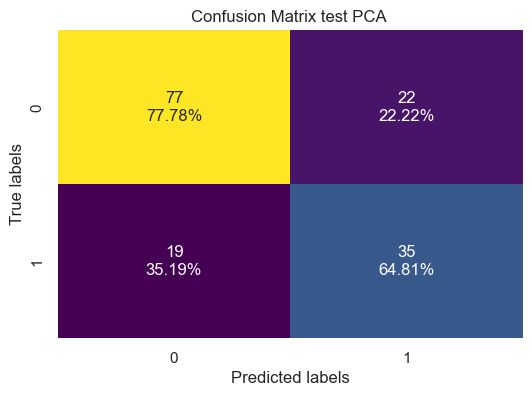

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.97      0.97      0.97       395
         1.0       0.94      0.95      0.95       213

    accuracy                           0.96       608
   macro avg       0.96      0.96      0.96       608
weighted avg       0.96      0.96      0.96       608



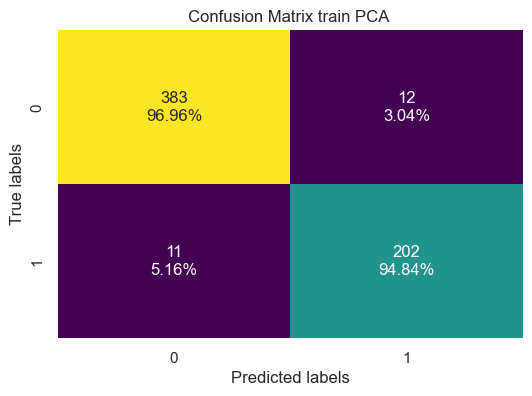

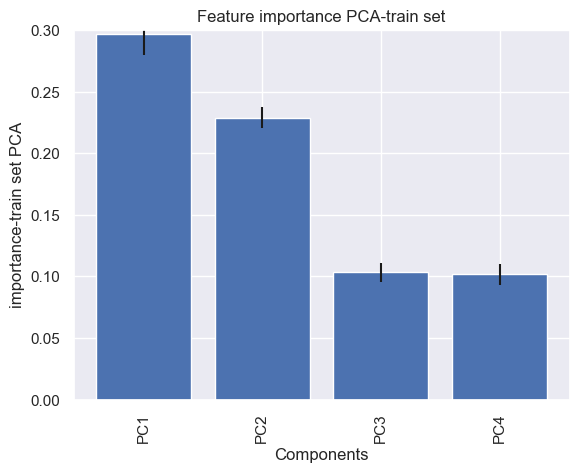

 estimator: 100 depth: 8 test score:0.6993464052287581
 estimator: 100 depth: 8 train score:0.9671052631578947
Accuracy test: 0.6993464052287581
Accuracy test: 0.9671052631578947
Classification Report:
              precision    recall  f1-score   support

         0.0       0.78      0.74      0.76        99
         1.0       0.57      0.63      0.60        54

    accuracy                           0.70       153
   macro avg       0.68      0.68      0.68       153
weighted avg       0.71      0.70      0.70       153



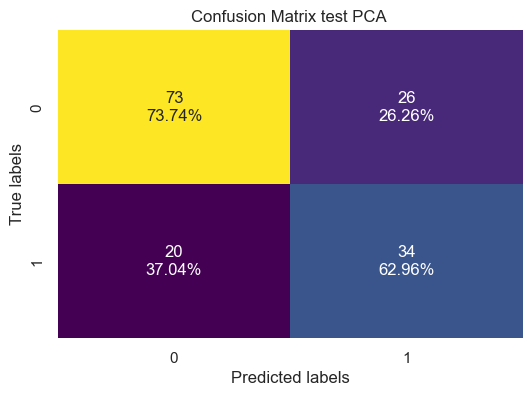

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.97      0.97      0.97       395
         1.0       0.95      0.95      0.95       213

    accuracy                           0.97       608
   macro avg       0.96      0.96      0.96       608
weighted avg       0.97      0.97      0.97       608



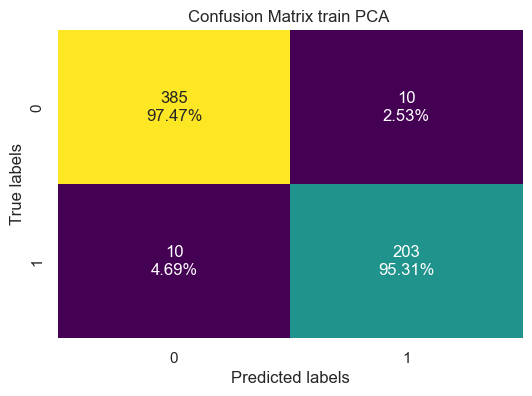

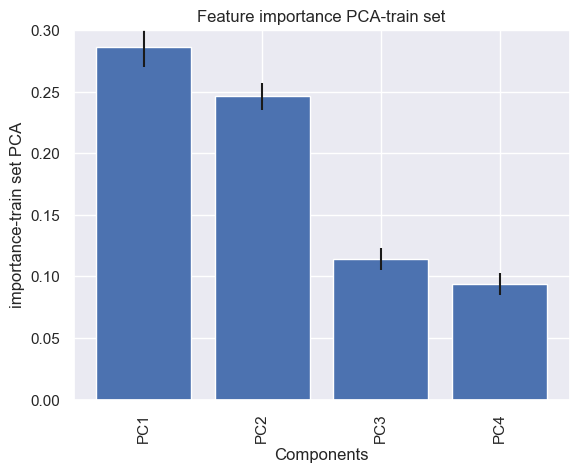

 estimator: 150 depth: 8 test score:0.7058823529411765
 estimator: 150 depth: 8 train score:0.9736842105263158
Accuracy test: 0.7058823529411765
Accuracy test: 0.9736842105263158
Classification Report:
              precision    recall  f1-score   support

         0.0       0.79      0.75      0.77        99
         1.0       0.58      0.63      0.60        54

    accuracy                           0.71       153
   macro avg       0.68      0.69      0.68       153
weighted avg       0.71      0.71      0.71       153



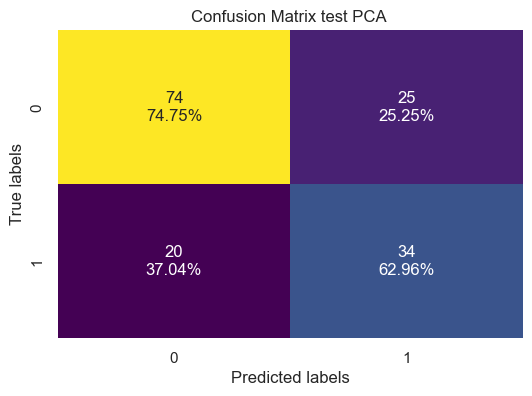

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.98      0.98      0.98       395
         1.0       0.96      0.97      0.96       213

    accuracy                           0.97       608
   macro avg       0.97      0.97      0.97       608
weighted avg       0.97      0.97      0.97       608



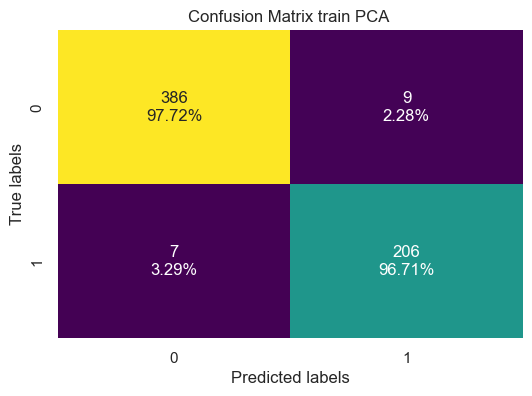

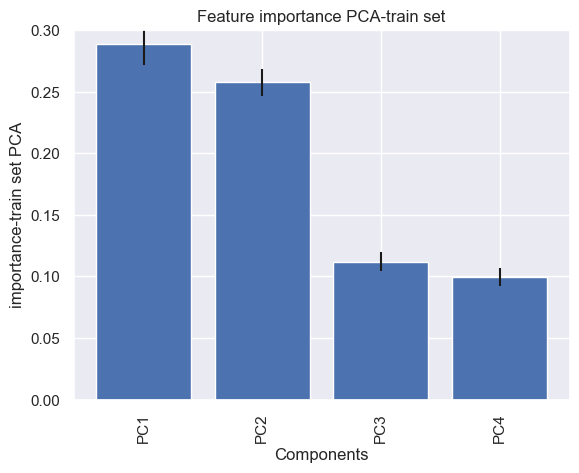

 estimator: 200 depth: 8 test score:0.7058823529411765
 estimator: 200 depth: 8 train score:0.9720394736842105
Accuracy test: 0.7058823529411765
Accuracy test: 0.9720394736842105
Classification Report:
              precision    recall  f1-score   support

         0.0       0.79      0.75      0.77        99
         1.0       0.58      0.63      0.60        54

    accuracy                           0.71       153
   macro avg       0.68      0.69      0.68       153
weighted avg       0.71      0.71      0.71       153



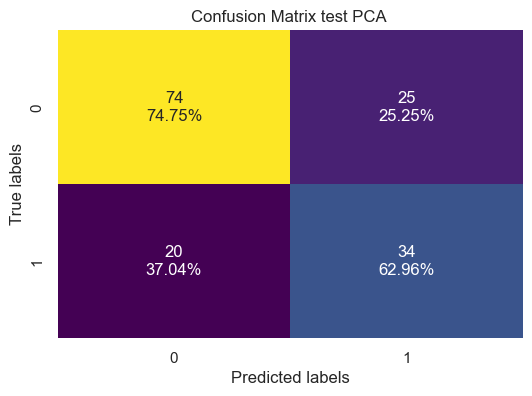

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.98      0.98      0.98       395
         1.0       0.96      0.96      0.96       213

    accuracy                           0.97       608
   macro avg       0.97      0.97      0.97       608
weighted avg       0.97      0.97      0.97       608



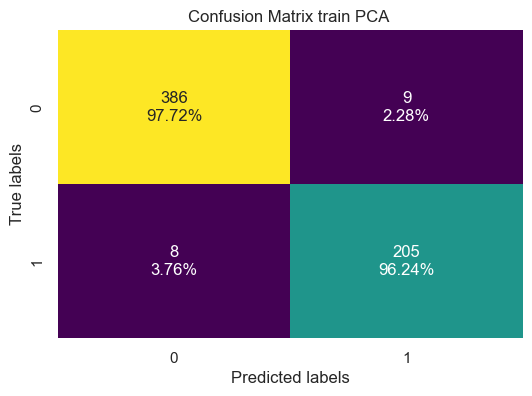

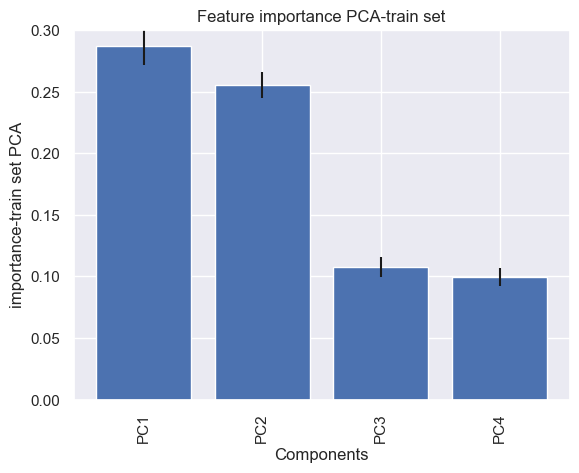

 estimator: 500 depth: 8 test score:0.7124183006535948
 estimator: 500 depth: 8 train score:0.975328947368421
Accuracy test: 0.7124183006535948
Accuracy test: 0.975328947368421
Classification Report:
              precision    recall  f1-score   support

         0.0       0.79      0.76      0.77        99
         1.0       0.59      0.63      0.61        54

    accuracy                           0.71       153
   macro avg       0.69      0.69      0.69       153
weighted avg       0.72      0.71      0.71       153



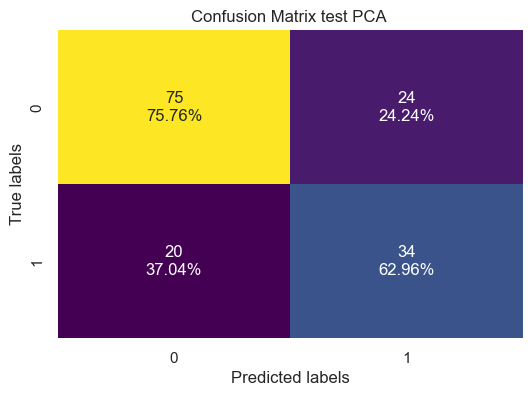

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.97      0.99      0.98       395
         1.0       0.98      0.95      0.96       213

    accuracy                           0.98       608
   macro avg       0.98      0.97      0.97       608
weighted avg       0.98      0.98      0.98       608



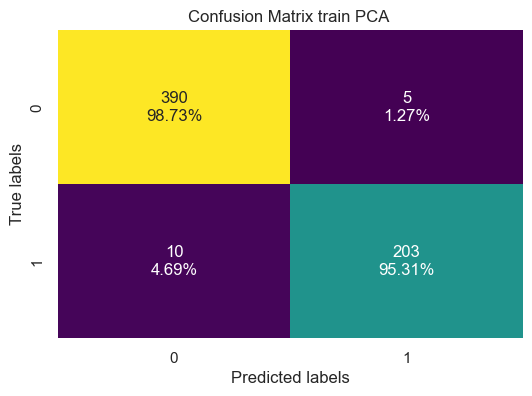

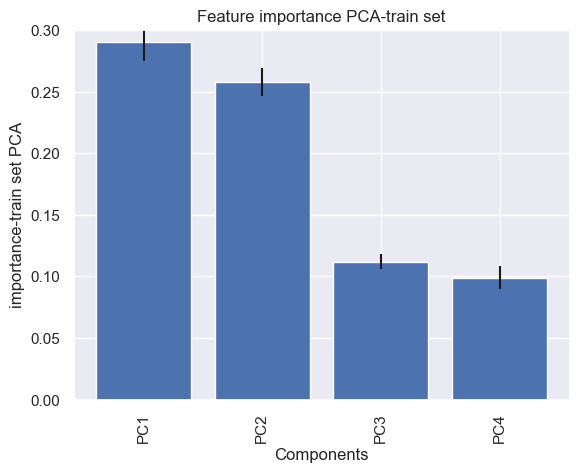

 estimator: 1 depth: 16 test score:0.673202614379085
 estimator: 1 depth: 16 train score:0.899671052631579
Accuracy test: 0.673202614379085
Accuracy test: 0.899671052631579
Classification Report:
              precision    recall  f1-score   support

         0.0       0.75      0.75      0.75        99
         1.0       0.54      0.54      0.54        54

    accuracy                           0.67       153
   macro avg       0.64      0.64      0.64       153
weighted avg       0.67      0.67      0.67       153



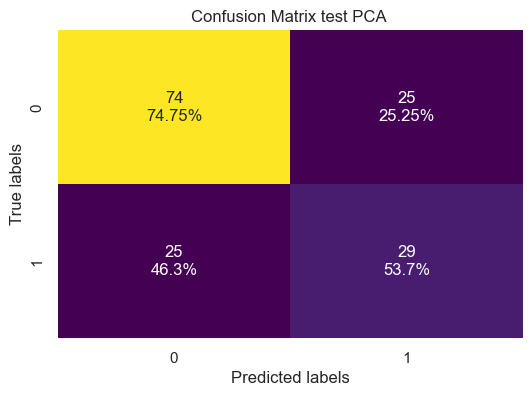

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.93      0.92      0.92       395
         1.0       0.85      0.86      0.86       213

    accuracy                           0.90       608
   macro avg       0.89      0.89      0.89       608
weighted avg       0.90      0.90      0.90       608



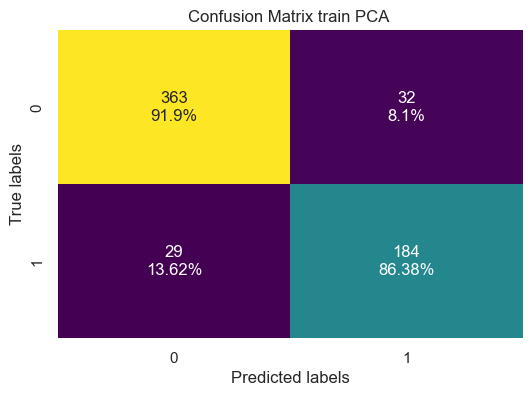

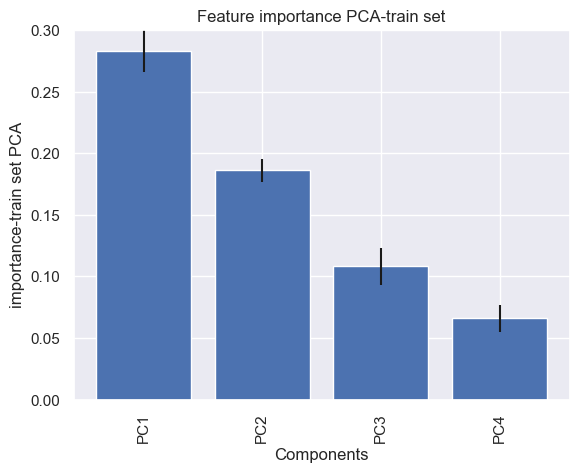

 estimator: 5 depth: 16 test score:0.7124183006535948
 estimator: 5 depth: 16 train score:0.9720394736842105
Accuracy test: 0.7124183006535948
Accuracy test: 0.9720394736842105
Classification Report:
              precision    recall  f1-score   support

         0.0       0.78      0.78      0.78        99
         1.0       0.59      0.59      0.59        54

    accuracy                           0.71       153
   macro avg       0.69      0.69      0.69       153
weighted avg       0.71      0.71      0.71       153



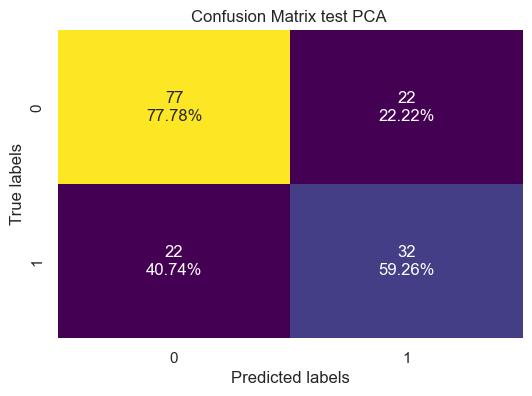

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.97      0.99      0.98       395
         1.0       0.98      0.94      0.96       213

    accuracy                           0.97       608
   macro avg       0.97      0.96      0.97       608
weighted avg       0.97      0.97      0.97       608



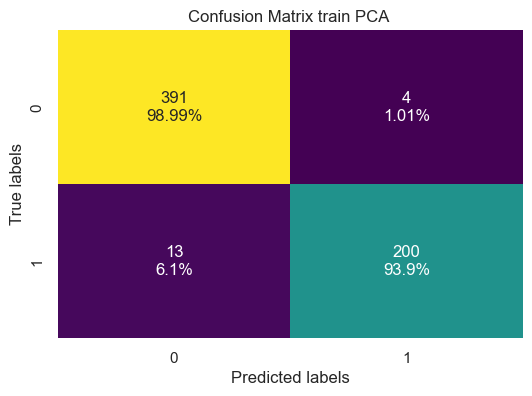

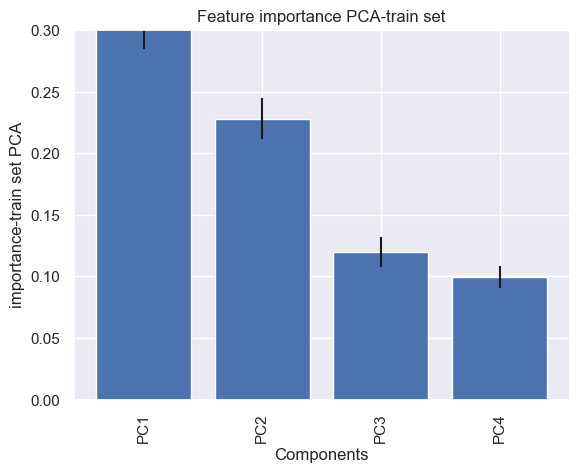

 estimator: 10 depth: 16 test score:0.7058823529411765
 estimator: 10 depth: 16 train score:0.9851973684210527
Accuracy test: 0.7058823529411765
Accuracy test: 0.9851973684210527
Classification Report:
              precision    recall  f1-score   support

         0.0       0.76      0.80      0.78        99
         1.0       0.59      0.54      0.56        54

    accuracy                           0.71       153
   macro avg       0.68      0.67      0.67       153
weighted avg       0.70      0.71      0.70       153



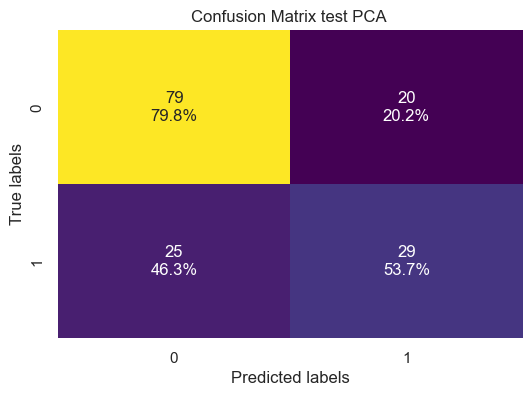

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.98      1.00      0.99       395
         1.0       1.00      0.96      0.98       213

    accuracy                           0.99       608
   macro avg       0.99      0.98      0.98       608
weighted avg       0.99      0.99      0.99       608



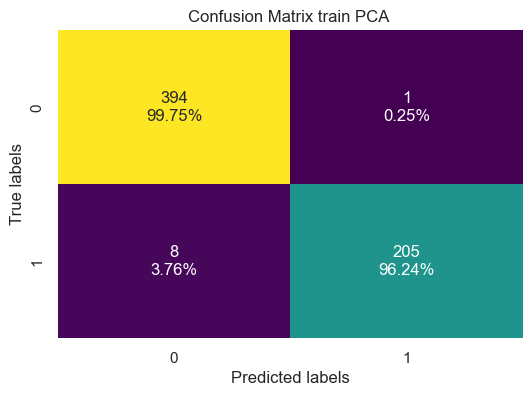

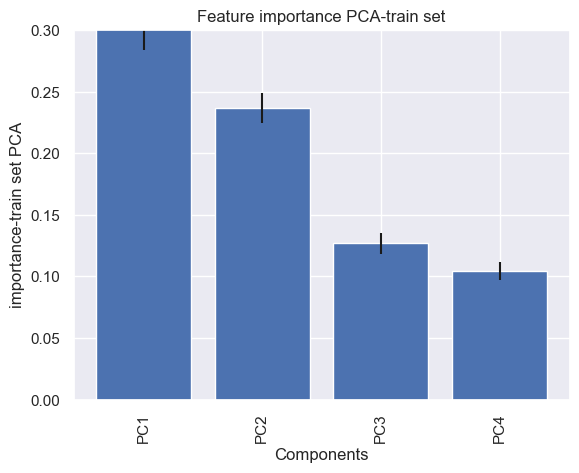

 estimator: 20 depth: 16 test score:0.7516339869281046
 estimator: 20 depth: 16 train score:0.9967105263157895
Accuracy test: 0.7516339869281046
Accuracy test: 0.9967105263157895
Classification Report:
              precision    recall  f1-score   support

         0.0       0.81      0.81      0.81        99
         1.0       0.65      0.65      0.65        54

    accuracy                           0.75       153
   macro avg       0.73      0.73      0.73       153
weighted avg       0.75      0.75      0.75       153



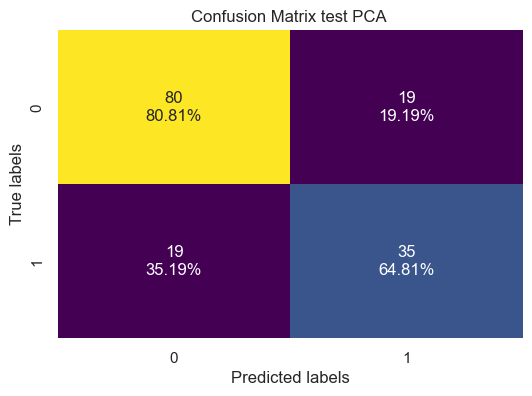

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.99      1.00      1.00       395
         1.0       1.00      0.99      1.00       213

    accuracy                           1.00       608
   macro avg       1.00      1.00      1.00       608
weighted avg       1.00      1.00      1.00       608



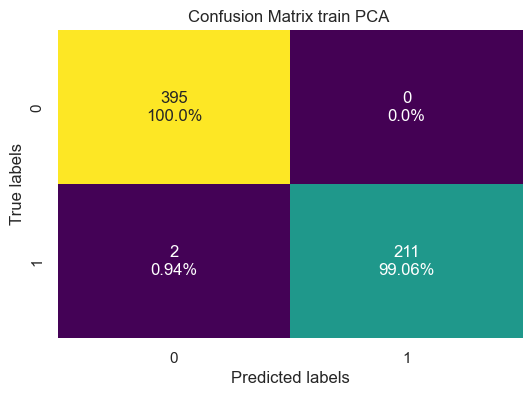

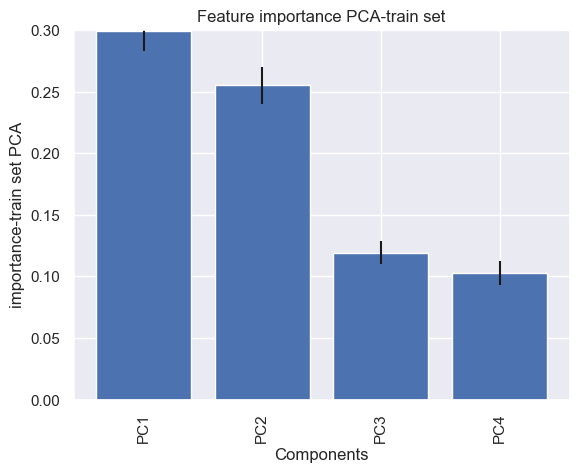

 estimator: 50 depth: 16 test score:0.738562091503268
 estimator: 50 depth: 16 train score:1.0
Accuracy test: 0.738562091503268
Accuracy test: 1.0
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.80      0.80        99
         1.0       0.63      0.63      0.63        54

    accuracy                           0.74       153
   macro avg       0.71      0.71      0.71       153
weighted avg       0.74      0.74      0.74       153



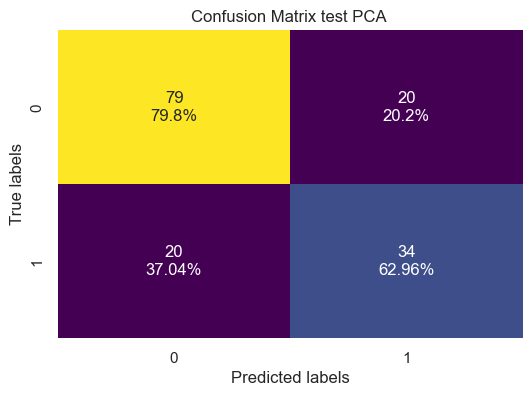

Classification Report_train:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       395
         1.0       1.00      1.00      1.00       213

    accuracy                           1.00       608
   macro avg       1.00      1.00      1.00       608
weighted avg       1.00      1.00      1.00       608



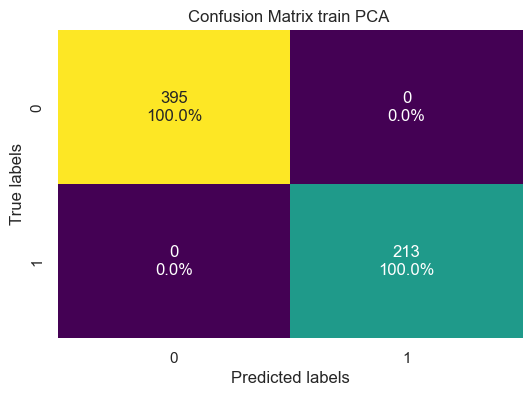

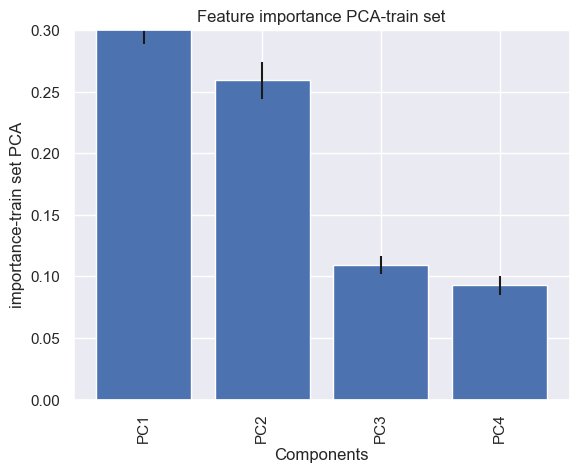

 estimator: 100 depth: 16 test score:0.7254901960784313
 estimator: 100 depth: 16 train score:1.0
Accuracy test: 0.7254901960784313
Accuracy test: 1.0
Classification Report:
              precision    recall  f1-score   support

         0.0       0.79      0.78      0.79        99
         1.0       0.61      0.63      0.62        54

    accuracy                           0.73       153
   macro avg       0.70      0.70      0.70       153
weighted avg       0.73      0.73      0.73       153



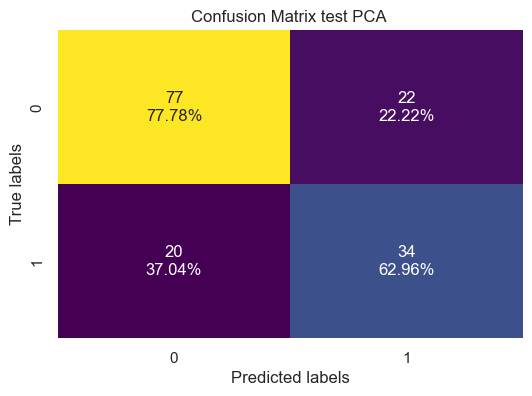

Classification Report_train:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       395
         1.0       1.00      1.00      1.00       213

    accuracy                           1.00       608
   macro avg       1.00      1.00      1.00       608
weighted avg       1.00      1.00      1.00       608



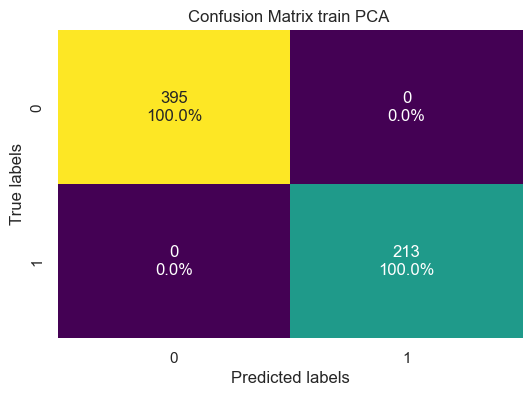

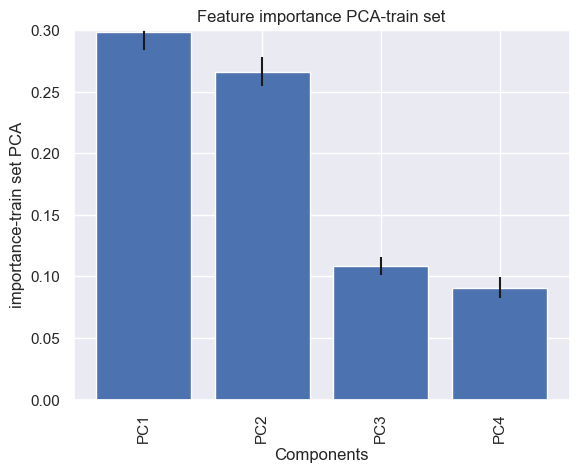

 estimator: 150 depth: 16 test score:0.738562091503268
 estimator: 150 depth: 16 train score:1.0
Accuracy test: 0.738562091503268
Accuracy test: 1.0
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.79      0.80        99
         1.0       0.62      0.65      0.64        54

    accuracy                           0.74       153
   macro avg       0.71      0.72      0.72       153
weighted avg       0.74      0.74      0.74       153



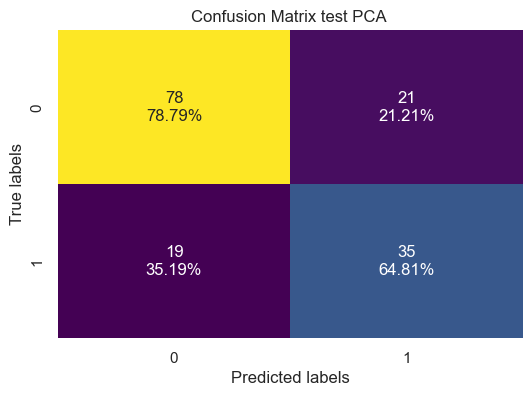

Classification Report_train:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       395
         1.0       1.00      1.00      1.00       213

    accuracy                           1.00       608
   macro avg       1.00      1.00      1.00       608
weighted avg       1.00      1.00      1.00       608



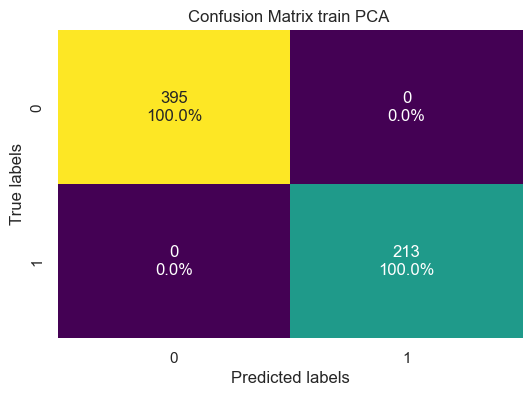

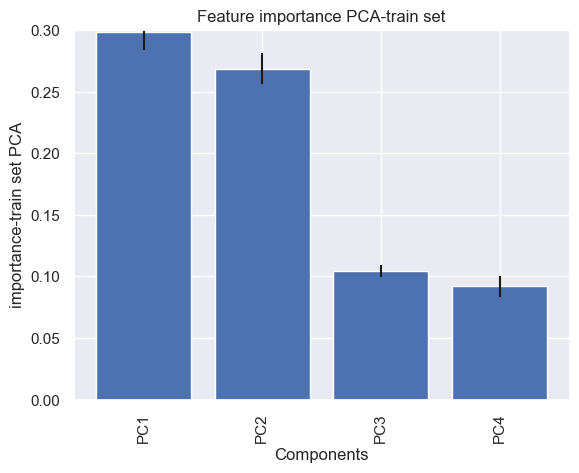

 estimator: 200 depth: 16 test score:0.7254901960784313
 estimator: 200 depth: 16 train score:1.0
Accuracy test: 0.7254901960784313
Accuracy test: 1.0
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.77      0.78        99
         1.0       0.60      0.65      0.62        54

    accuracy                           0.73       153
   macro avg       0.70      0.71      0.70       153
weighted avg       0.73      0.73      0.73       153



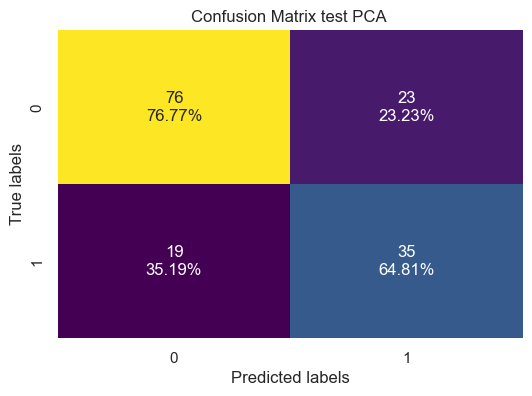

Classification Report_train:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       395
         1.0       1.00      1.00      1.00       213

    accuracy                           1.00       608
   macro avg       1.00      1.00      1.00       608
weighted avg       1.00      1.00      1.00       608



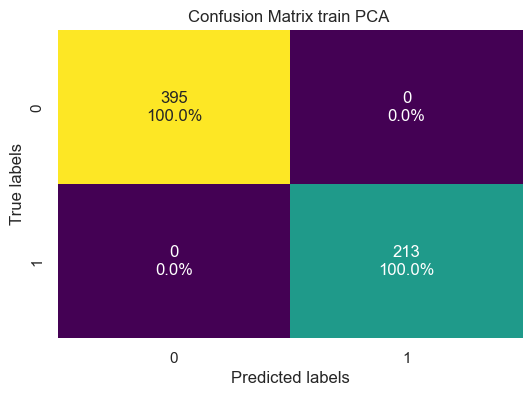

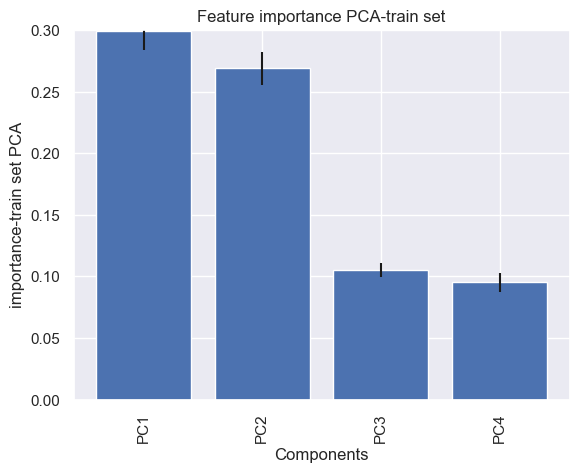

 estimator: 500 depth: 16 test score:0.7254901960784313
 estimator: 500 depth: 16 train score:1.0
Accuracy test: 0.7254901960784313
Accuracy test: 1.0
Classification Report:
              precision    recall  f1-score   support

         0.0       0.79      0.78      0.79        99
         1.0       0.61      0.63      0.62        54

    accuracy                           0.73       153
   macro avg       0.70      0.70      0.70       153
weighted avg       0.73      0.73      0.73       153



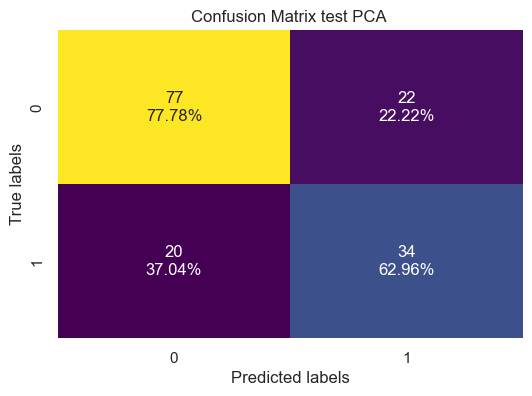

Classification Report_train:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       395
         1.0       1.00      1.00      1.00       213

    accuracy                           1.00       608
   macro avg       1.00      1.00      1.00       608
weighted avg       1.00      1.00      1.00       608



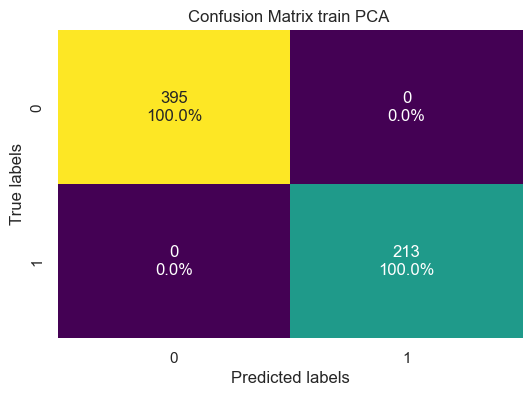

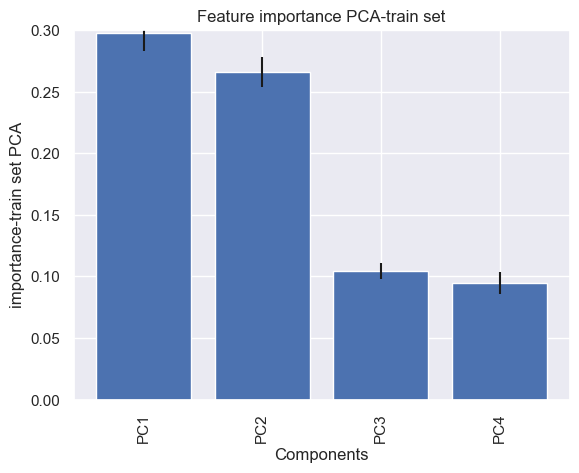

 estimator: 1 depth: 20 test score:0.673202614379085
 estimator: 1 depth: 20 train score:0.899671052631579
Accuracy test: 0.673202614379085
Accuracy test: 0.899671052631579
Classification Report:
              precision    recall  f1-score   support

         0.0       0.75      0.75      0.75        99
         1.0       0.54      0.54      0.54        54

    accuracy                           0.67       153
   macro avg       0.64      0.64      0.64       153
weighted avg       0.67      0.67      0.67       153



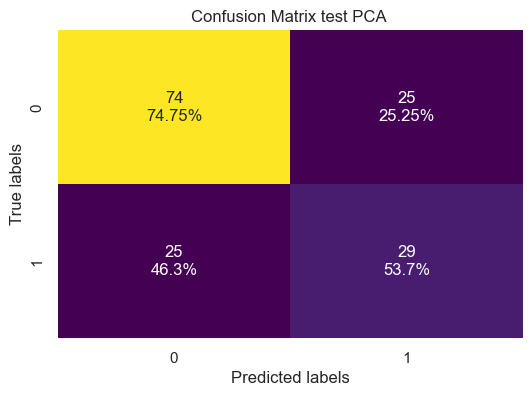

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.93      0.92      0.92       395
         1.0       0.85      0.86      0.86       213

    accuracy                           0.90       608
   macro avg       0.89      0.89      0.89       608
weighted avg       0.90      0.90      0.90       608



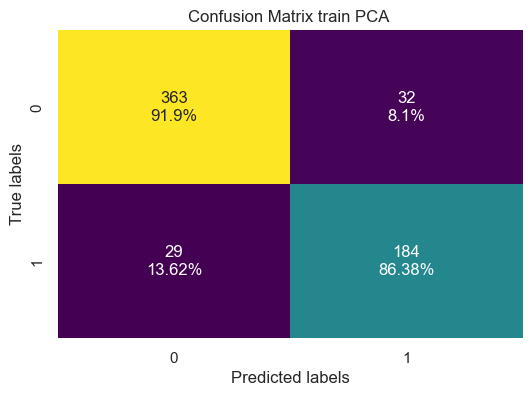

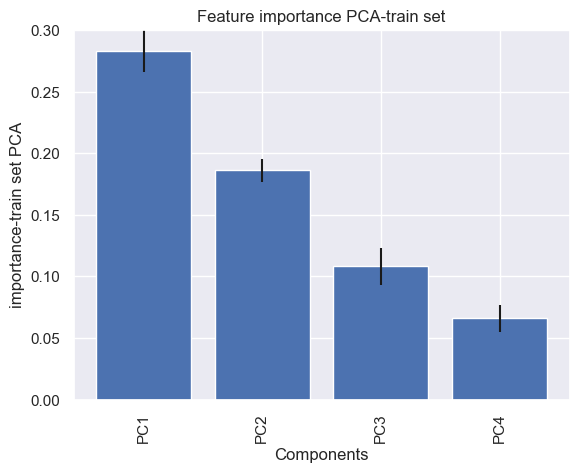

 estimator: 5 depth: 20 test score:0.7058823529411765
 estimator: 5 depth: 20 train score:0.9720394736842105
Accuracy test: 0.7058823529411765
Accuracy test: 0.9720394736842105
Classification Report:
              precision    recall  f1-score   support

         0.0       0.77      0.78      0.77        99
         1.0       0.58      0.57      0.58        54

    accuracy                           0.71       153
   macro avg       0.68      0.68      0.68       153
weighted avg       0.70      0.71      0.71       153



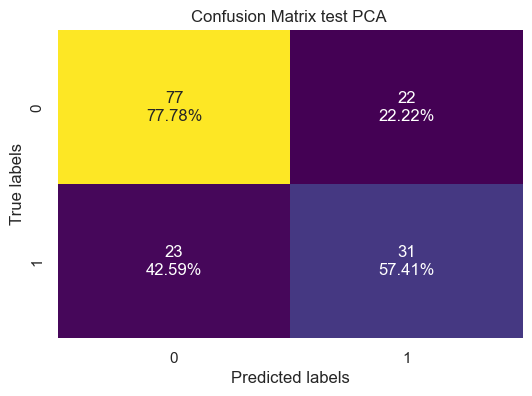

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.97      0.99      0.98       395
         1.0       0.98      0.94      0.96       213

    accuracy                           0.97       608
   macro avg       0.97      0.96      0.97       608
weighted avg       0.97      0.97      0.97       608



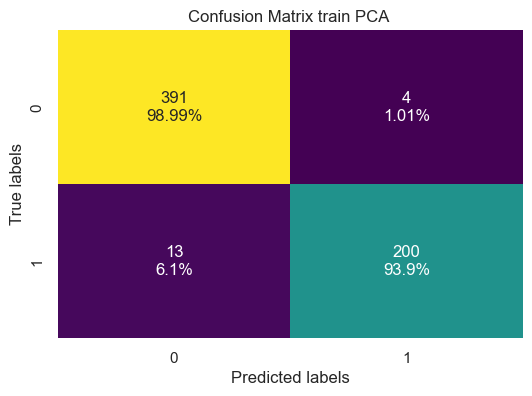

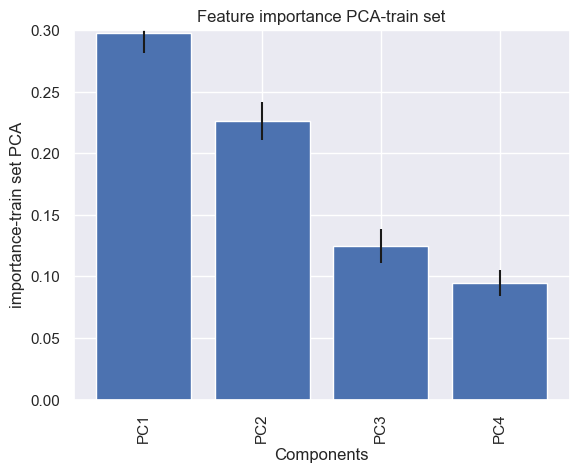

 estimator: 10 depth: 20 test score:0.6993464052287581
 estimator: 10 depth: 20 train score:0.9851973684210527
Accuracy test: 0.6993464052287581
Accuracy test: 0.9851973684210527
Classification Report:
              precision    recall  f1-score   support

         0.0       0.75      0.80      0.77        99
         1.0       0.58      0.52      0.55        54

    accuracy                           0.70       153
   macro avg       0.67      0.66      0.66       153
weighted avg       0.69      0.70      0.69       153



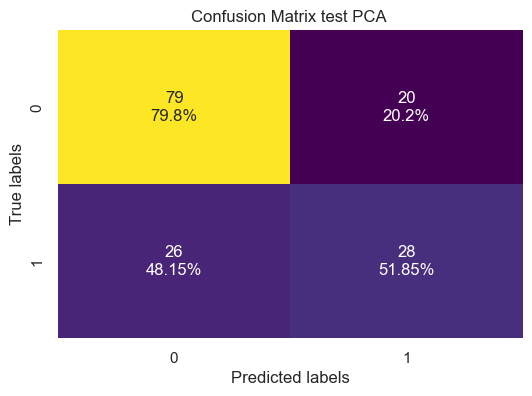

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.98      1.00      0.99       395
         1.0       1.00      0.96      0.98       213

    accuracy                           0.99       608
   macro avg       0.99      0.98      0.98       608
weighted avg       0.99      0.99      0.99       608



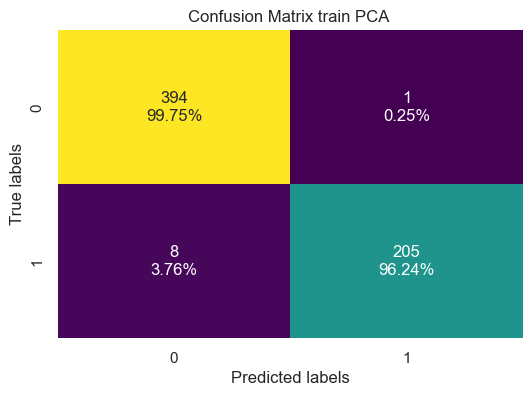

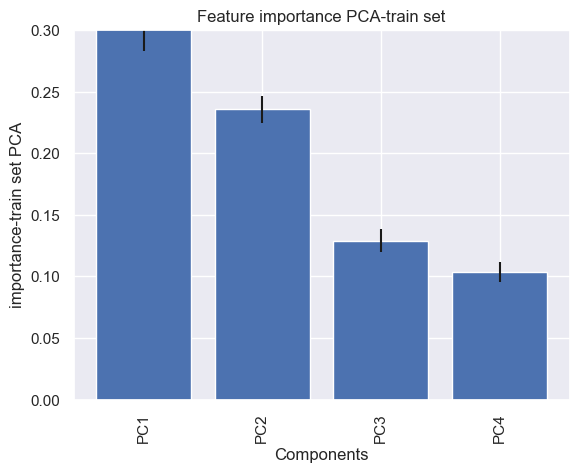

 estimator: 20 depth: 20 test score:0.738562091503268
 estimator: 20 depth: 20 train score:0.9967105263157895
Accuracy test: 0.738562091503268
Accuracy test: 0.9967105263157895
Classification Report:
              precision    recall  f1-score   support

         0.0       0.79      0.81      0.80        99
         1.0       0.63      0.61      0.62        54

    accuracy                           0.74       153
   macro avg       0.71      0.71      0.71       153
weighted avg       0.74      0.74      0.74       153



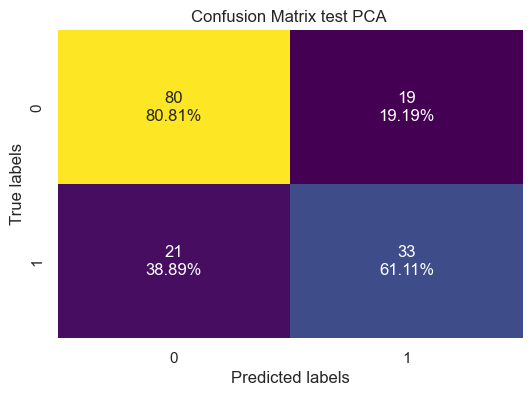

Classification Report_train:
              precision    recall  f1-score   support

         0.0       0.99      1.00      1.00       395
         1.0       1.00      0.99      1.00       213

    accuracy                           1.00       608
   macro avg       1.00      1.00      1.00       608
weighted avg       1.00      1.00      1.00       608



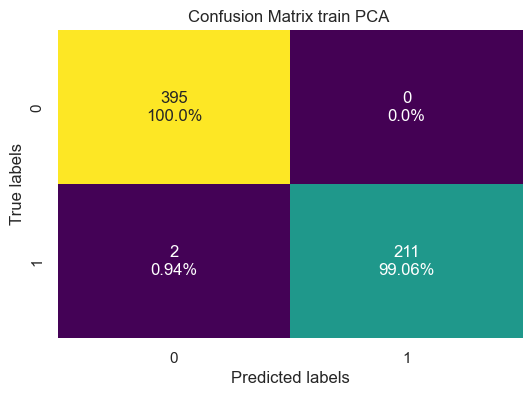

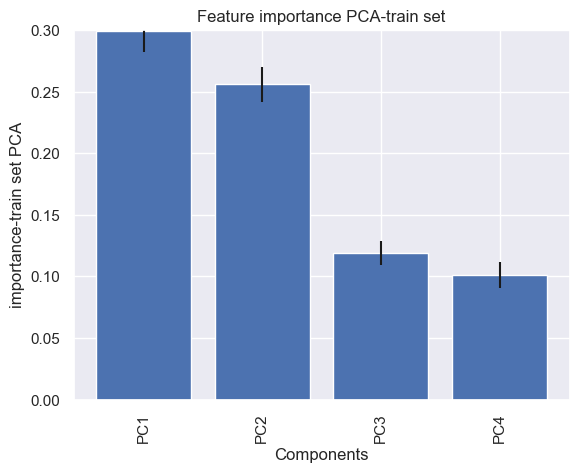

 estimator: 50 depth: 20 test score:0.738562091503268
 estimator: 50 depth: 20 train score:1.0
Accuracy test: 0.738562091503268
Accuracy test: 1.0
Classification Report:
              precision    recall  f1-score   support

         0.0       0.79      0.81      0.80        99
         1.0       0.63      0.61      0.62        54

    accuracy                           0.74       153
   macro avg       0.71      0.71      0.71       153
weighted avg       0.74      0.74      0.74       153



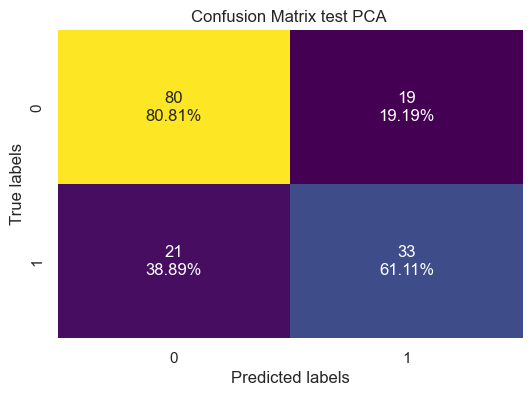

Classification Report_train:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       395
         1.0       1.00      1.00      1.00       213

    accuracy                           1.00       608
   macro avg       1.00      1.00      1.00       608
weighted avg       1.00      1.00      1.00       608



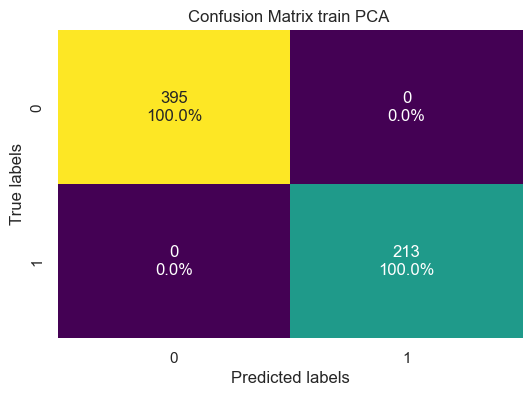

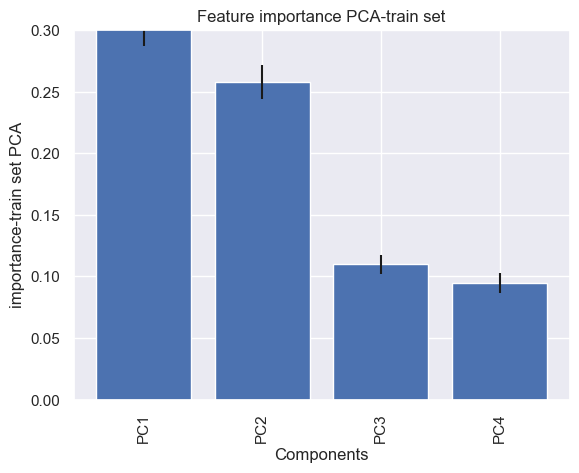

 estimator: 100 depth: 20 test score:0.7254901960784313
 estimator: 100 depth: 20 train score:1.0
Accuracy test: 0.7254901960784313
Accuracy test: 1.0
Classification Report:
              precision    recall  f1-score   support

         0.0       0.79      0.78      0.79        99
         1.0       0.61      0.63      0.62        54

    accuracy                           0.73       153
   macro avg       0.70      0.70      0.70       153
weighted avg       0.73      0.73      0.73       153



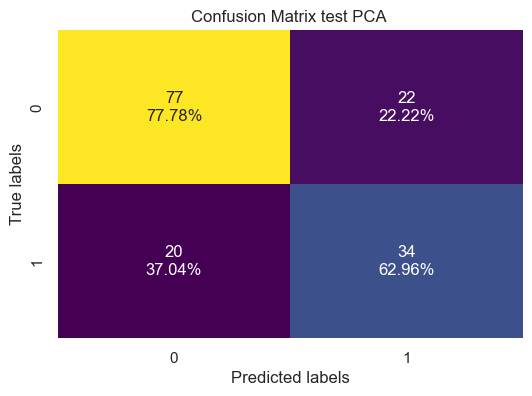

Classification Report_train:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       395
         1.0       1.00      1.00      1.00       213

    accuracy                           1.00       608
   macro avg       1.00      1.00      1.00       608
weighted avg       1.00      1.00      1.00       608



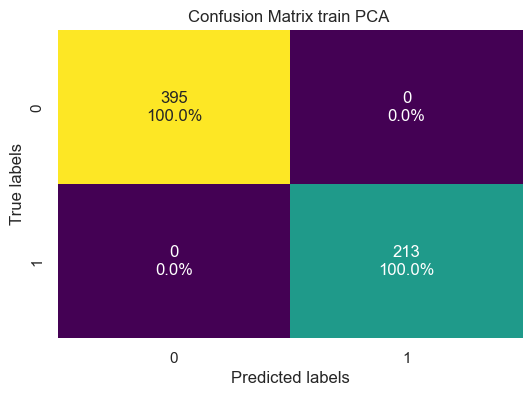

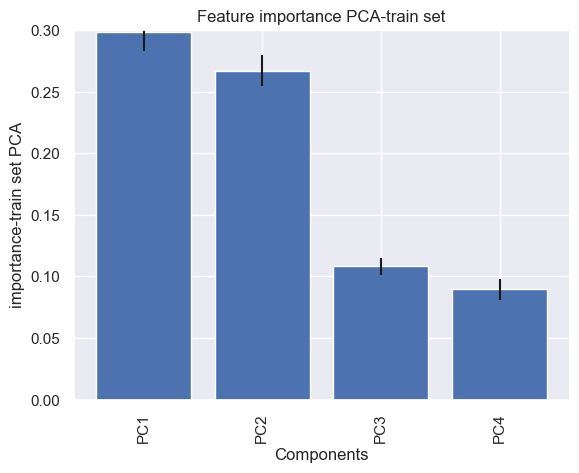

 estimator: 150 depth: 20 test score:0.738562091503268
 estimator: 150 depth: 20 train score:1.0
Accuracy test: 0.738562091503268
Accuracy test: 1.0
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.79      0.80        99
         1.0       0.62      0.65      0.64        54

    accuracy                           0.74       153
   macro avg       0.71      0.72      0.72       153
weighted avg       0.74      0.74      0.74       153



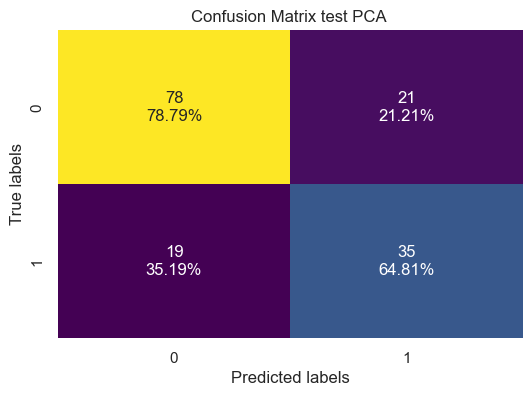

Classification Report_train:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       395
         1.0       1.00      1.00      1.00       213

    accuracy                           1.00       608
   macro avg       1.00      1.00      1.00       608
weighted avg       1.00      1.00      1.00       608



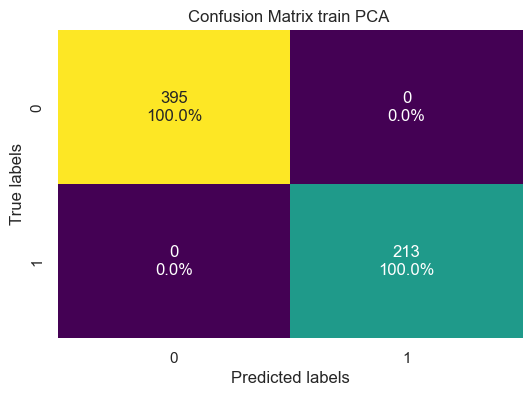

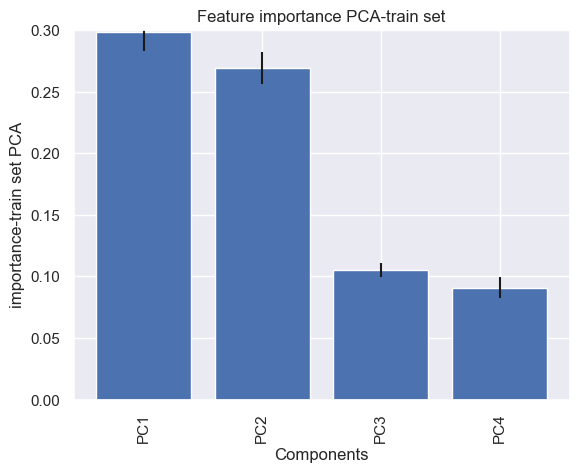

 estimator: 200 depth: 20 test score:0.7254901960784313
 estimator: 200 depth: 20 train score:1.0
Accuracy test: 0.7254901960784313
Accuracy test: 1.0
Classification Report:
              precision    recall  f1-score   support

         0.0       0.80      0.77      0.78        99
         1.0       0.60      0.65      0.62        54

    accuracy                           0.73       153
   macro avg       0.70      0.71      0.70       153
weighted avg       0.73      0.73      0.73       153



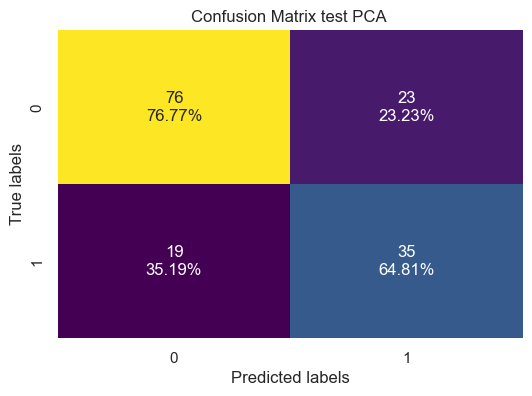

Classification Report_train:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       395
         1.0       1.00      1.00      1.00       213

    accuracy                           1.00       608
   macro avg       1.00      1.00      1.00       608
weighted avg       1.00      1.00      1.00       608



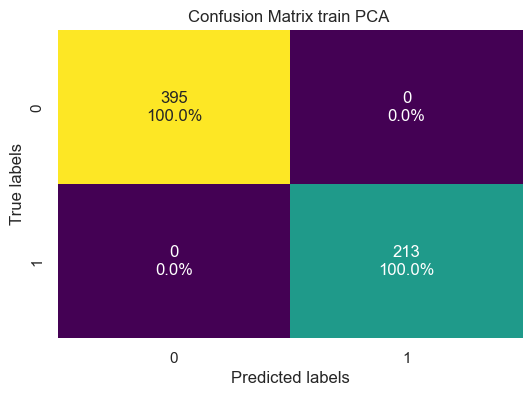

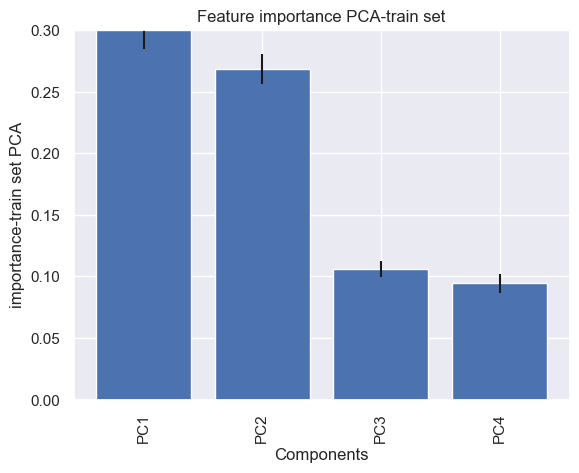

 estimator: 500 depth: 20 test score:0.7189542483660131
 estimator: 500 depth: 20 train score:1.0
Accuracy test: 0.7189542483660131
Accuracy test: 1.0
Classification Report:
              precision    recall  f1-score   support

         0.0       0.79      0.77      0.78        99
         1.0       0.60      0.63      0.61        54

    accuracy                           0.72       153
   macro avg       0.69      0.70      0.70       153
weighted avg       0.72      0.72      0.72       153



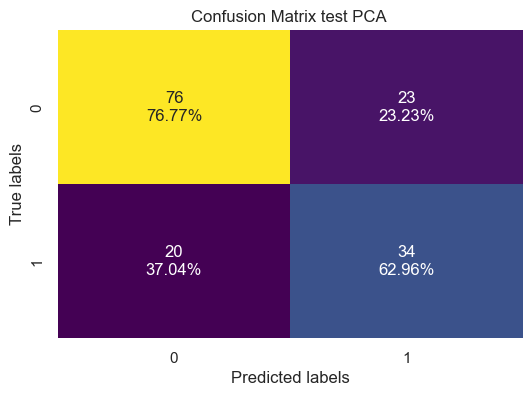

Classification Report_train:
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       395
         1.0       1.00      1.00      1.00       213

    accuracy                           1.00       608
   macro avg       1.00      1.00      1.00       608
weighted avg       1.00      1.00      1.00       608



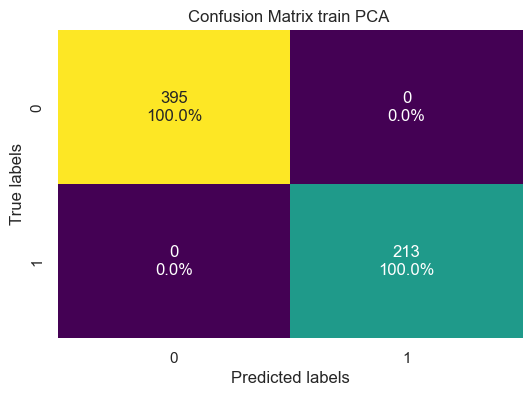

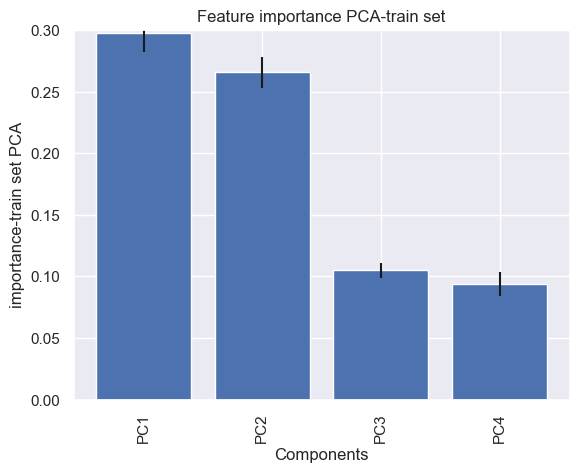

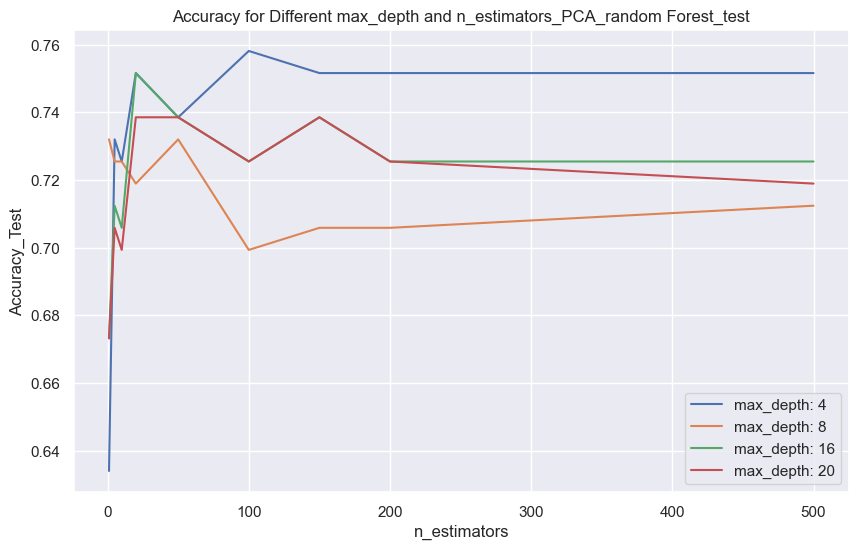

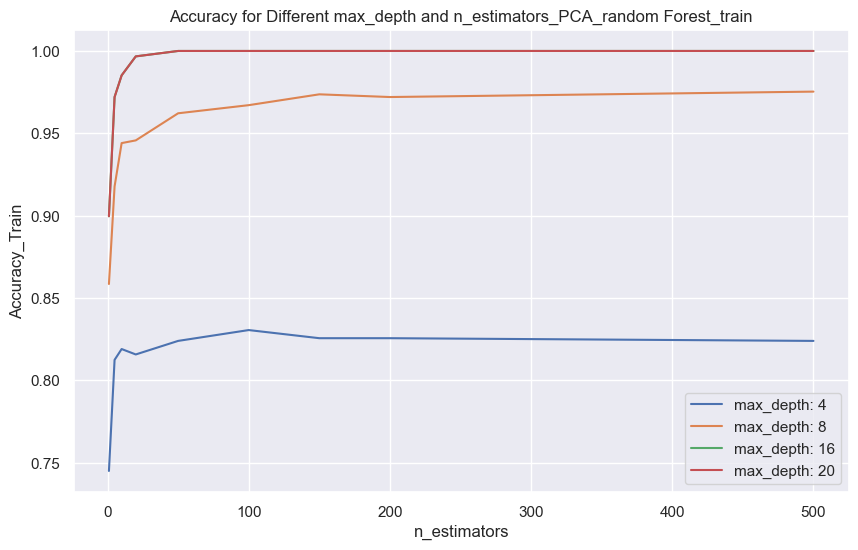

In [20]:

# make random forest with the principal components
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

accuracies_test =[]
accuracies_train =[]
for m_deph in (4,8,16,20):
    acc_row_test =[]
    acc_row_train =[]
    for n_est in (1, 5, 10,20, 50,100,150,200,500): #we are changing the number of estimatores to check
#for n_est in [100]:
# do fit
      rfc= ensemble.RandomForestClassifier(max_depth=m_deph, n_estimators=n_est,random_state=42)
      rfc.fit(x_train, y_train)
   # test different paramethers and take the one that gives the best aqurancy at the end.
    # print the training scores
      print(f' estimator: {n_est} depth: {m_deph} test score:{(rfc.score(x_test, y_test))}')
      print(f' estimator: {n_est} depth: {m_deph} train score:{(rfc.score(x_train, y_train))}')
      y_pred_test = rfc.predict(x_test)
      y_pred_train = rfc.predict(x_train)
    #print(y_pred_test)
       #Evaluate the classifier
      accuracy_test = accuracy_score(y_test, y_pred_test)
      print(f'Accuracy test: {accuracy_test}')
      acc_row_test.append(accuracy_test) 
     
      accuracy_train = accuracy_score(y_train, y_pred_train)
      print(f'Accuracy test: {accuracy_train}')
      acc_row_train.append(accuracy_train) 
    
    
    
    # Print classification report for test
      print("Classification Report:")
      print(classification_report(y_test, y_pred_test))

      
      
    
    
    # Display the confusion  matrixes test with values and percentages
      confusion_test = confusion_matrix(y_test,y_pred_test)
      cm_sum = np.sum(confusion_test, axis=1, keepdims=True)
      cm_percentages = confusion_test / cm_sum.astype(float) * 100
      cm_with_percentages = np.round(cm_percentages, 2)

      plt.figure(figsize=(6, 4))
      sns.heatmap(
      confusion_test,
      annot=np.array([f'{v1}\n{v2}%' for v1, v2 in zip(confusion_test.flatten(), cm_with_percentages.flatten())]).reshape(confusion_test.shape),
      fmt='',
      cmap='viridis',
      cbar=False
       )
      plt.xlabel('Predicted labels')
      plt.ylabel('True labels')
      plt.title('Confusion Matrix test PCA ')
      plt.show()
        
        
       # Print classification report for train
    
      print("Classification Report_train:")
      print(classification_report(y_train, y_pred_train)) 
    
     # Display the confusion  matrixes train with values and percentages
      confusion_train = confusion_matrix(y_train, y_pred_train)
      cm_sum = np.sum(confusion_train, axis=1, keepdims=True)
      cm_percentages = confusion_train / cm_sum.astype(float) * 100
      cm_with_percentages = np.round(cm_percentages, 2)

      plt.figure(figsize=(6, 4))
      sns.heatmap(
      confusion_train,
      annot=np.array([f'{v1}\n{v2}%' for v1, v2 in zip(confusion_train.flatten(), cm_with_percentages.flatten())]).reshape(confusion_train.shape),
      fmt='',
      cmap='viridis',
      cbar=False
       )
      plt.xlabel('Predicted labels')
      plt.ylabel('True labels')
      plt.title('Confusion Matrix train PCA ')
      plt.show()

     #calculate feature importance in train set
      p_importances = permutation_importance(rfc, x_train, y_train, n_repeats=20, n_jobs=-1,random_state=42)

      plt.bar(Components,
        p_importances.importances_mean,
        yerr=p_importances.importances_std)
      plt.xticks(rotation=90)
      plt.xlabel('Components')
      plt.ylabel('importance-train set PCA')
      plt.title('Feature importance PCA-train set')
      plt.ylim(0, 0.3)
      plt.show()
    
    accuracies_test.append(acc_row_test)
    accuracies_train.append(acc_row_train)
    
#plot accuracies vs est and deph for test set

plt.figure(figsize=(10, 6))
for i, m_deph in enumerate((4, 8, 16, 20)):
    plt.plot((1, 5, 10,20, 50,100,150,200,500), accuracies_test[i], label=f"max_depth: {m_deph}")

plt.xlabel("n_estimators")
plt.ylabel("Accuracy_Test")
plt.title("Accuracy for Different max_depth and n_estimators_PCA_random Forest_test")
plt.legend()
plt.show()
    
#plot accuracies vs est and deph for train

plt.figure(figsize=(10, 6))
for i, m_deph in enumerate((4, 8, 16, 20)):
    plt.plot((1, 5, 10,20, 50,100,150,200,500), accuracies_train[i], label=f"max_depth: {m_deph}")

plt.xlabel("n_estimators")
plt.ylabel("Accuracy_Train")
plt.title("Accuracy for Different max_depth and n_estimators_PCA_random Forest_train")
plt.legend()


Cross-validation scores: [0.75409836 0.73770492 0.75409836 0.79338843 0.82644628]
Mean cross-validation score: 0.7731472700176127


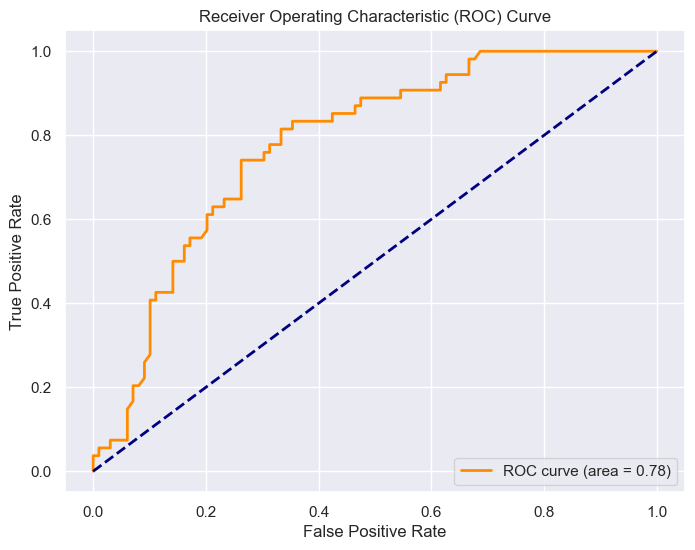

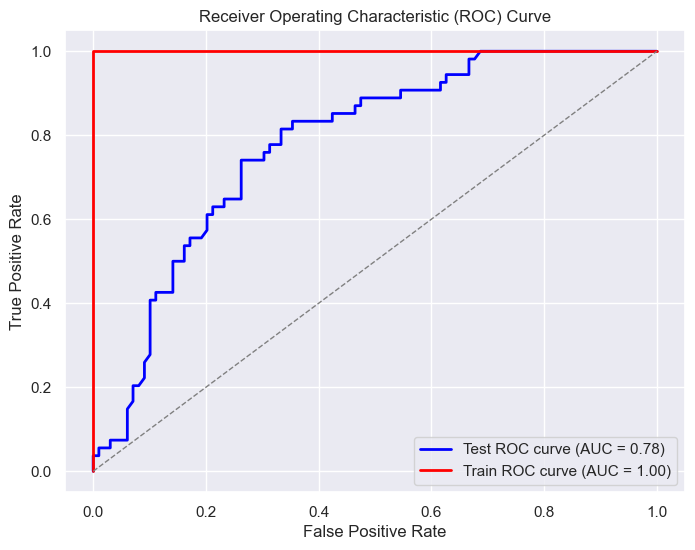

In [90]:
# ROC and crossvalidation score
from sklearn.model_selection import cross_val_score

# Replace this with your data and model
scores = cross_val_score(rfc, x_train, y_train, cv=5)  # 5-fold cross-validation

print("Cross-validation scores:", scores)
print("Mean cross-validation score:", scores.mean())

from sklearn.metrics import roc_curve, auc

# Assuming rfc is your trained random forest classifier
y_pred_proba = rfc.predict_proba(x_test)

# Compute ROC curve and ROC area for each class
fpr, tpr, _ = roc_curve(y_test, y_pred_proba[:, 1])
roc_auc = auc(fpr, tpr)

# Plot ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.show()



#plot both train and set ROCs

# Calculate ROC curve and ROC area for test set
y_test_pred_proba = rfc.predict_proba(x_test)[:, 1]
fpr_test, tpr_test, _ = roc_curve(y_test, y_test_pred_proba)
roc_auc_test = roc_auc_score(y_test, y_test_pred_proba)

# Calculate ROC curve and ROC area for train set
y_train_pred_proba = rfc.predict_proba(x_train)[:, 1]
fpr_train, tpr_train, _ = roc_curve(y_train, y_train_pred_proba)
roc_auc_train = roc_auc_score(y_train, y_train_pred_proba)

# Plotting ROC curves
plt.figure(figsize=(8, 6))
plt.plot(fpr_test, tpr_test, color='blue', lw=2, label=f'Test ROC curve (AUC = {roc_auc_test:.2f})')
plt.plot(fpr_train, tpr_train, color='red', lw=2, label=f'Train ROC curve (AUC = {roc_auc_train:.2f})')
plt.plot([0, 1], [0, 1], color='gray', lw=1, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc='lower right')
plt.show()



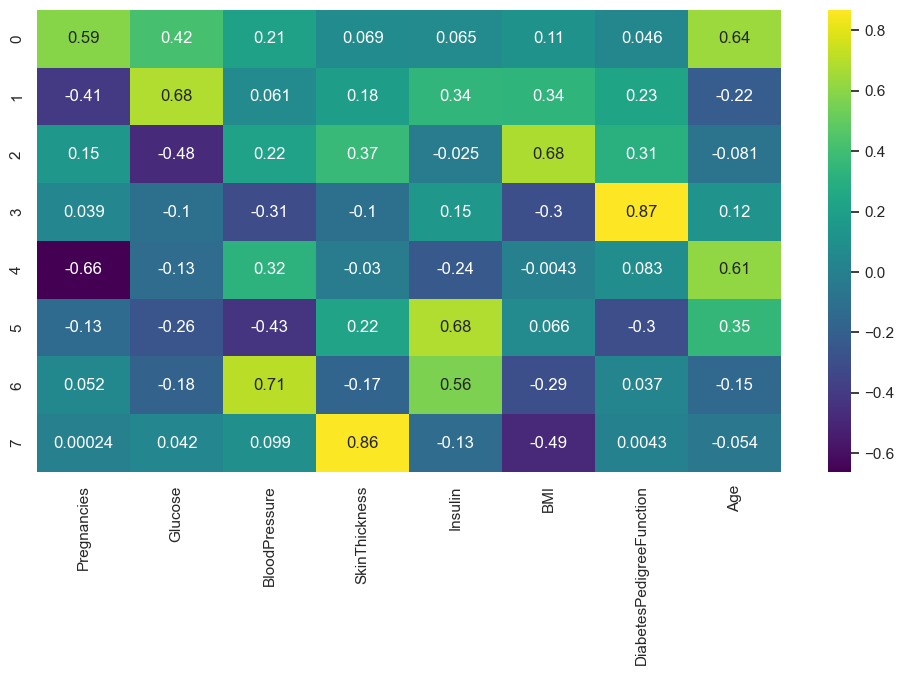

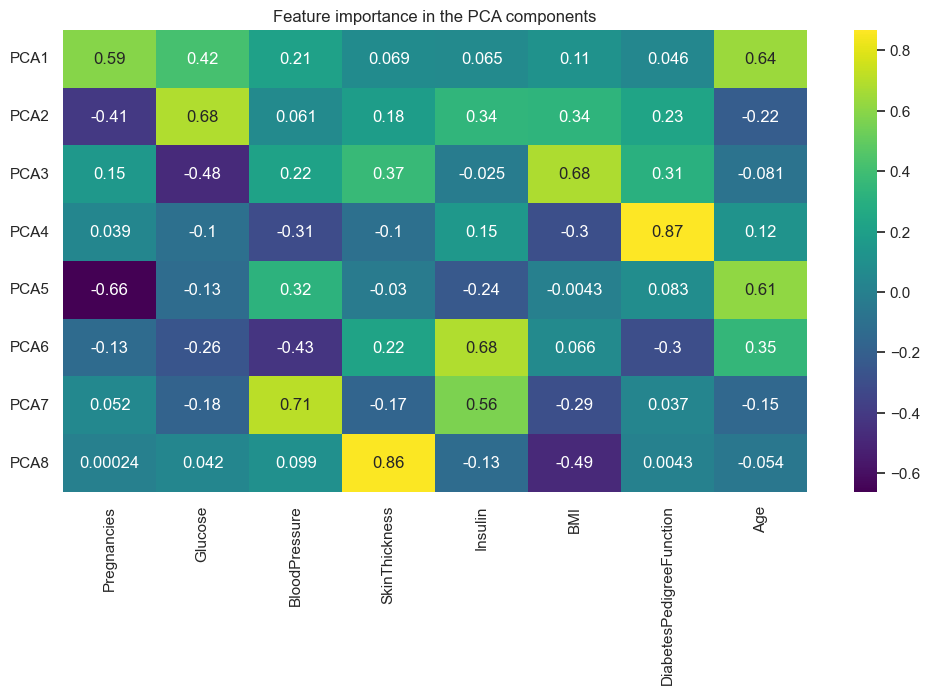

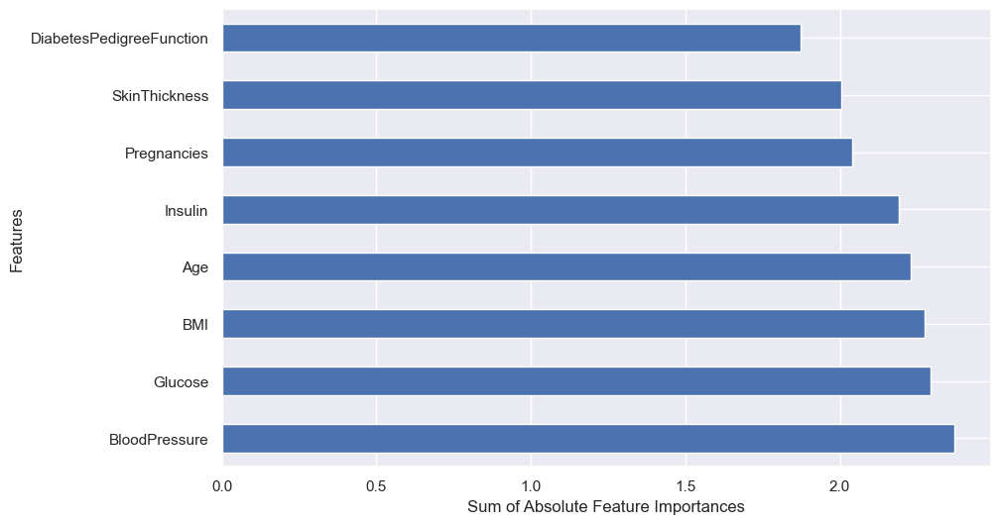

In [59]:
import seaborn as sns


# Get the feature importance of each principal component
feature_importance = pd.DataFrame(pca.components_, columns=features)

# Visualize the feature importance using a heatmap
plt.figure(figsize=(12, 6))
sns.heatmap(feature_importance, annot=True, cmap='viridis')
plt.show()


# with sets correct labels in the y-axis

# Set the labels for the y-axis
pc_labels = [f"PCA{i+1}" for i in range(len(feature_importance))]

# Visualize the feature importance using a heatmap with custom y-axis labels
plt.figure(figsize=(12, 6))
sns.heatmap(feature_importance, annot=True, cmap='viridis')
plt.yticks(ticks=np.arange(len(feature_importance)) + 0.5, labels=pc_labels, rotation=0)
plt.title('Feature importance in the PCA components')
plt.show()

# Visualize the feature importance using a bar plot
plt.figure(figsize=(10,6))
feature_importance.abs().sum(axis=0).nlargest(10).plot(kind='barh')
plt.xlabel('Sum of Absolute Feature Importances')
plt.ylabel('Features')
plt.show()


In [418]:
# try k means

#NOT FINISH!!!!!  

# input is the normalized data of the data frame features like in PCA
# select the data:
#df = df_diabetes_preprocessed_insulin
df = df_diabetes_preprocessed 

from sklearn.cluster import KMeans

num_clusters = 2# You can choose the appropriate number of clusters

kmeans = KMeans(n_clusters=num_clusters, random_state=42)

X = df.iloc[:, :8]
Y = df['Outcome']
scaler = MinMaxScaler()
X = scaler.fit_transform(X)

#x_train, y_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

print

kmeans.fit(X)

# analyzing clusters

cluster_labels = kmeans.labels_
print(cluster_labels)

# Add cluster labels to the original DataFrame
df['Cluster'] = cluster_labels
print(df)

# visualization of clusters....using two features xej Glucose and Insulin 

plt.scatter(df['Glucose'], df['Insulin'], c=cluster_labels, cmap='viridis')
plt.xlabel('Glucose')
plt.ylabel('Insulin')
plt.title('K-means Clustering')
plt.show()



plt.scatter(df['Glucose'], df['BMI'], c=cluster_labels, cmap='viridis')
plt.xlabel('Glucose')
plt.ylabel('BMI')
plt.show()

plt.scatter(df['Insulin'], df['BMI'], c=cluster_labels, cmap='viridis')
plt.xlabel('Insulin')
plt.ylabel('BMI')
plt.show()

plt.scatter(df['Glucose'], df['Outcome'], c=cluster_labels, cmap='viridis')
plt.xlabel('Glucose')
plt.ylabel('Outcome')
plt.show()



#x_train, y_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

[1 1 0 0 1 1 1 1 1 1 1 1 1 0 1 0 1 1 1 1 1 1 0 1 1 1 1 1 0 1 0 1 1 1 1 1 0
 1 1 1 1 1 0 1 1 1 1 0 1 1 1 0 1 1 1 1 1 1 0 0 1 1 1 0 0 1 1 1 0 1 0 0 1 1
 0 0 1 1 1 1 1 0 1 1 1 1 0 0 1 1 0 1 1 0 1 1 1 1 1 1 0 1 1 1 1 1 1 1 0 0 1
 1 1 1 1 0 1 1 0 0 1 1 1 1 1 1 1 1 1 1 1 0 0 1 1 1 1 1 1 1 0 1 0 1 0 0 1 0
 1 1 1 0 1 1 0 1 0 1 1 1 1 1 1 1 1 0 1 1 0 1 0 1 1 0 0 1 0 0 1 0 1 1 1 1 1
 1 0 0 0 1 1 1 1 1 0 1 1 0 1 1 0 1 0 0 1 1 1 0 1 1 1 1 1 0 0 0 0 1 1 1 1 0
 1 1 0 1 0 0 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 0 1 0 0 1 1 1 0 0 1 1 1 1 1 0 1
 1 0 0 1 1 1 1 1 1 0 1 1 0 1 1 1 1 1 1 0 0 0 1 1 0 1 1 0 1 0 0 1 1 1 1 0 0
 1 1 1 0 0 1 0 1 1 1 0 1 0 1 1 0 0 0 0 1 1 0 0 1 1 1 1 1 1 1 0 1 1 0 0 1 1
 0 0 0 1 1 0 0 1 0 0 1 0 1 0 0 1 1 0 0 1 1 1 1 1 1 1 1 0 1 1 0 1 1 0 1 1 1
 1 0 1 1 1 0 1 0 1 1 1 1 1 1 1 0 1 1 1 0 0 1 1 0 1 1 1 1 0 1 0 1 0 0 0 1 0
 1 0 0 0 1 0 1 1 0 1 1 0 0 0 1 1 0 1 1 1 1 1 0 1 1 1 0 1 1 0 1 1 0 0 0 1 0
 1 1 0 0 0 1 0 1 0 0 1 0 1 1 1 0 1 0 0 1 0 1 0 1 0 1 1 1 0 1 1 0 0 0 0 1 0
 1 1 1 1 0 0 1 1 0 1 1 1 

In [420]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt

num_clusters = 2
kmeans = KMeans(n_clusters=num_clusters, random_state=42)

# Assuming df is your dataframe containing the data
X = df.iloc[:, :8]
scaler = MinMaxScaler()
X_scaled = scaler.fit_transform(X)

kmeans.fit(X_scaled)

# Analyzing clusters and plotting cluster centers
cluster_labels = kmeans.labels_
df['Cluster'] = cluster_labels

cluster_centers = kmeans.cluster_centers_
print(cluster_centers)

# Visualizing clusters
plt.scatter(df['Glucose'], df['Insulin'], c=cluster_labels, cmap='viridis')
plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], marker='*', s=300, c='red', label='Cluster Centers')
plt.xlabel('Glucose')
plt.ylabel('Insulin')
plt.title('K-means Clustering')
plt.legend()
plt.show()


[[0.42463929 0.58502739 0.54424336 0.23182937 0.10432692 0.30383918
  0.17208643 0.41578616]
 [0.11978178 0.45853278 0.46681616 0.21592304 0.09896964 0.28496273
  0.16756598 0.09297715]]


/var/folders/07/cmbl5t2576sckxlm_hl6tw1c0000gn/T/ipykernel_17530/4013667119.py:3: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(outcome_data['Glucose'], outcome_data['Insulin'],


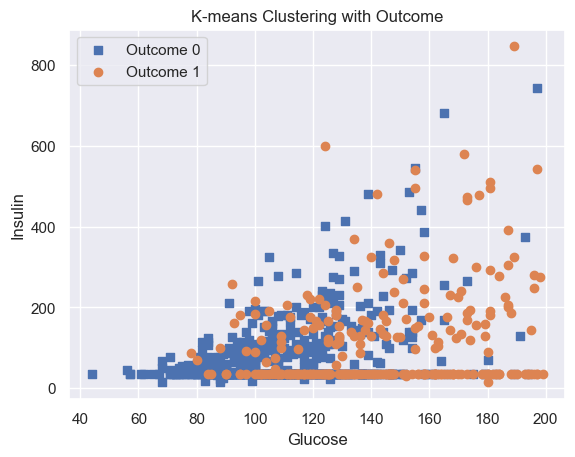

In [153]:
for outcome_label, marker in marker_dict.items():
    outcome_data = df[df['Outcome'] == outcome_label]
    plt.scatter(outcome_data['Glucose'], outcome_data['Insulin'], 
                cmap='viridis', marker=marker, label=f'Outcome {outcome_label}')

plt.xlabel('Glucose')
plt.ylabel('Insulin')
plt.title('K-means Clustering with Outcome')
plt.legend()
plt.show()



In [ ]:
# try k-means in the PCA :

#NOT YET Working!!!!


from sklearn.cluster import KMeans

Components = ['PC1', 'PC2']
X = df_final[Components]  # Use the principal components as features
scaler = MinMaxScaler()

X_norm = scaler.fit_transform(X)

Y = df_final['Outcome']  # Use the outcome variable
# transform to np arrays


y= Y.to_numpy().astype(np.float32)

x_train, x_test, y_train, y_test = train_test_split(X_norm, y, test_size=0.2, random_state=42)



num_clusters = 2# You can choose the appropriate number of clusters

kmeans = KMeans(n_clusters=num_clusters, random_state=42)


#x_train, y_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

print

kmeans.fit(x_train)

# analyzing clusters

cluster_labels = kmeans.labels_
print(cluster_labels)

# Add cluster labels to the original DataFrame
X['Cluster'] = cluster_labels
print(X)

# visualization of clusters....using two features xej Glucose and Insulin 

plt.scatter(X['PCA1'], X['PCA2'], c=cluster_labels, cmap='viridis')
plt.xlabel('PCA1')
plt.ylabel('PCA2')
plt.title('K-means Clustering PCA')
plt.show()






training time: 0.0s in 10 iterations
training score : 0.694 in 10 iterations
test score : 0.667 in 10 iterations
training time: 0.0s in 30 iterations
training score : 0.765 in 30 iterations
test score : 0.758 in 30 iterations
training time: 0.0s in 50 iterations
training score : 0.765 in 50 iterations
test score : 0.758 in 50 iterations
training time: 0.0s in 100 iterations
training score : 0.765 in 100 iterations
test score : 0.758 in 100 iterations
training time: 0.0s in 10000 iterations
training score : 0.765 in 10000 iterations
test score : 0.758 in 10000 iterations


/Users/paula/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


<IPython.core.display.Javascript object>


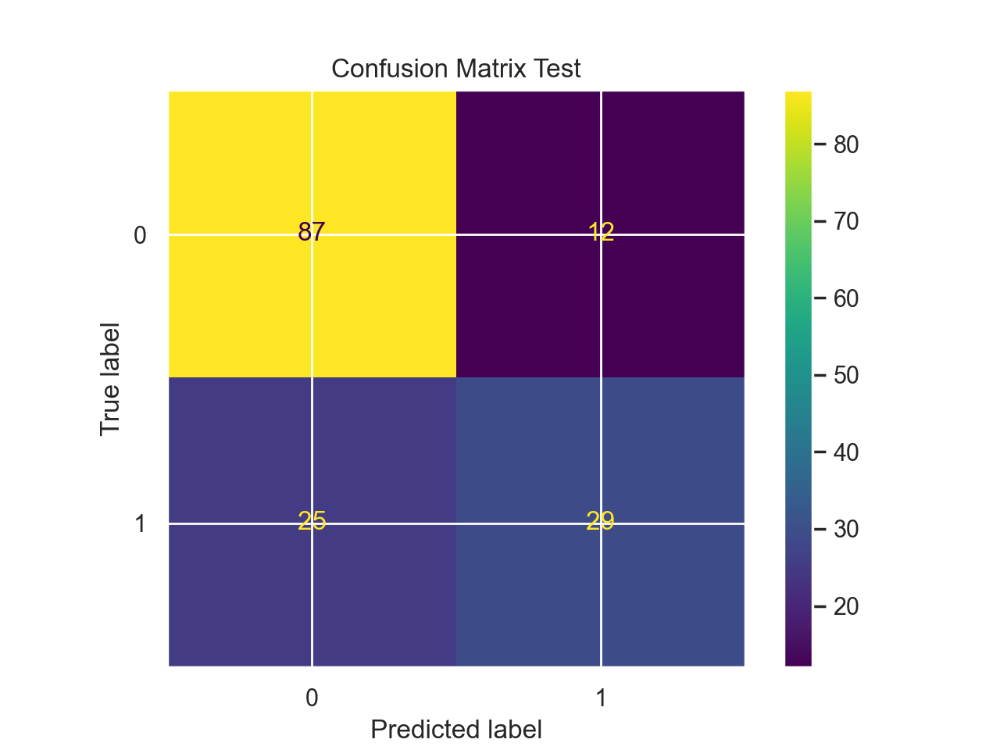

<IPython.core.display.Javascript object>


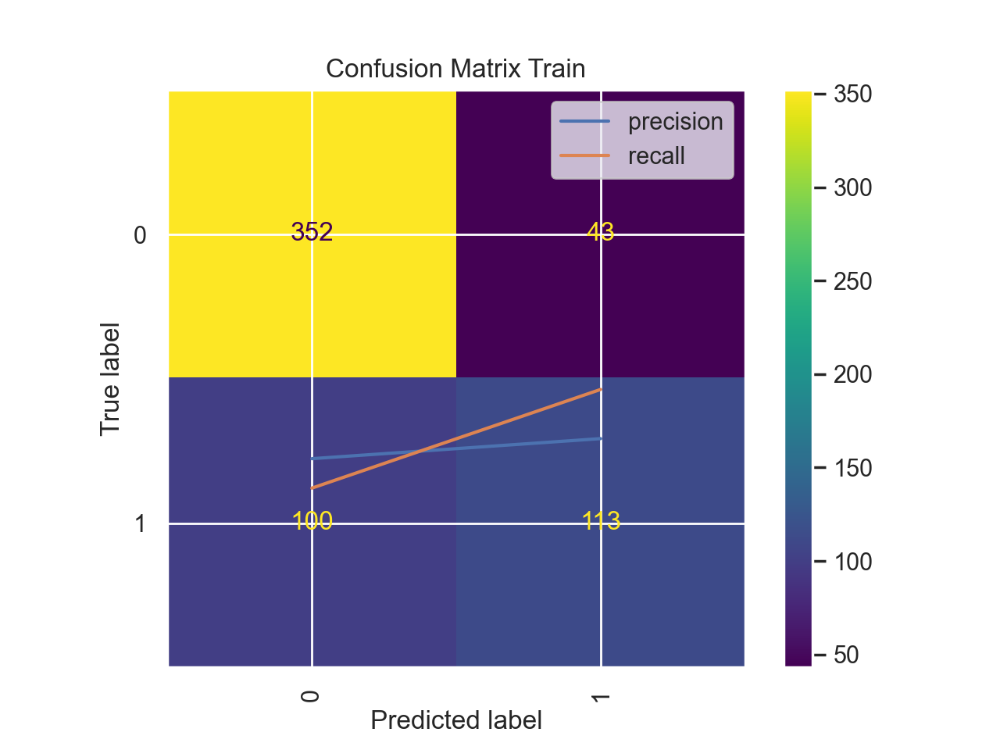

              precision    recall  f1-score   support

         0.0       0.78      0.88      0.82        99
         1.0       0.71      0.54      0.61        54

    accuracy                           0.76       153
   macro avg       0.74      0.71      0.72       153
weighted avg       0.75      0.76      0.75       153

Check that you get the same accuracy from the score method: 0.7581699346405228


In [424]:

df = df_diabetes_preprocessed 
# linear regression with reduce features: selection: Age, Glucose, BMI, Insulin, pedigree
Important_features =  ['Pregnancies',
                  'Glucose',
                  'Insulin', 'BMI', 'DiabetesPedigreeFunction', 'Age'
                  ]
df_outcome= df['Outcome']

df_reducedf = df[Important_features]
df_reducedf 
df_outcome

x = df_reducedf.to_numpy().astype(np.float32)
y = df_outcome.to_numpy().astype(np.float32)

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)


for n_iter in (10, 30,50, 100, 10000):
  clf = linear_model.LogisticRegression(solver='liblinear', max_iter= n_iter,
                                      multi_class='ovr')
#logreg = LogisticRegression(multi_class='ovr', solver='liblinear')

# 2. fit the model
  t1 = timer()
  clf.fit(x_train, y_train)
  t2 = timer()
  print ('training time: %.1fs'%(t2-t1),'in', n_iter, 'iterations')

# 3. evaluate accuracy on train and test datasets
  print("training score : %.3f" % (clf.score(x_train, y_train)),'in', n_iter, 'iterations')
  print("test score : %.3f" % (clf.score(x_test, y_test)),'in', n_iter, 'iterations')

y_pred_test = clf.predict(x_test)
#y_pred_test_proba= clf.predict_proba(x_test)
#np.sum(_pred_test_proba[0])
sklearn.metrics.confusion_matrix(y_test, y_pred_test, labels=None, sample_weight=None, normalize=None)
y_pred_train=clf.predict(x_train)
sklearn.metrics.confusion_matrix(y_train,y_pred_train)

# 5. inspect the confusion metrics and compute using matrix manipulations the precision and recall for each category


# Assuming you have already obtained 'y_pred' and 'y_test'
# 'y_pred' contains the predicted class labels, and 'y_test' contains the true class labels.

# Calculate the confusion matrix
confusion_test = confusion_matrix(y_test, y_pred_test)

#print("Confusion Matrix test:")
#print(confusion_test)

confusion_train = confusion_matrix(y_train, y_pred_train)

#print("Confusion Matrix train:")
#print(confusion_train)

from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix

cm_display = ConfusionMatrixDisplay(confusion_test).plot()
plt.title('Confusion Matrix Test')
cm_display = ConfusionMatrixDisplay(confusion_train).plot()
plt.title('Confusion Matrix Train')
plt.show()
print(classification_report(y_test, y_pred_test))


Output_names = ['Non-diabetes', 'Diabetes']

print(f'Check that you get the same accuracy from the score method: {np.sum([confusion_test[i,i] for i in range(2)])/np.sum(confusion_test)}')
#sums the diagonal and divide the whole matrix
precisions=[]
recalls=[]
#precision
for i in range(2):
    precisions.append(confusion_test[i,i]/np.sum(confusion_test[:,i])) #take the diagonal divided by the whole column
#percentage of positive identified??
#recall
for i in range(2):
    recalls.append(confusion_test[i,i]/np.sum(confusion_test[i,:])) #take the diagonal and divide by the whole row

plt.plot(Output_names,precisions, label='precision')
plt.plot(Output_names,recalls, label='recall')
plt.xticks(rotation=90)
plt.legend()

plt.show()


training time: 0.0s in 10 iterations
training score : 0.727 in 10 iterations
test score : 0.719 in 10 iterations
training time: 0.0s in 30 iterations
training score : 0.773 in 30 iterations
test score : 0.758 in 30 iterations
training time: 0.0s in 50 iterations


/Users/paula/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


training score : 0.773 in 50 iterations
test score : 0.758 in 50 iterations
training time: 0.0s in 100 iterations
training score : 0.773 in 100 iterations
test score : 0.758 in 100 iterations
training time: 0.0s in 10000 iterations
training score : 0.773 in 10000 iterations
test score : 0.758 in 10000 iterations


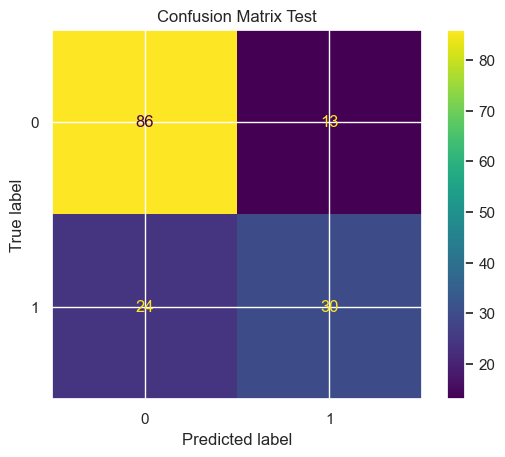

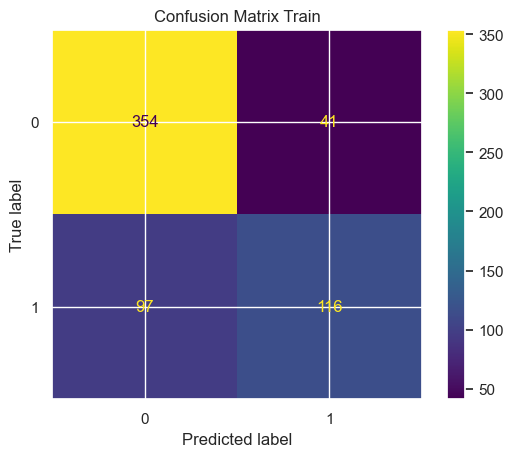

              precision    recall  f1-score   support

         0.0       0.78      0.87      0.82        99
         1.0       0.70      0.56      0.62        54

    accuracy                           0.76       153
   macro avg       0.74      0.71      0.72       153
weighted avg       0.75      0.76      0.75       153

Check that you get the same accuracy from the score method: 0.7581699346405228


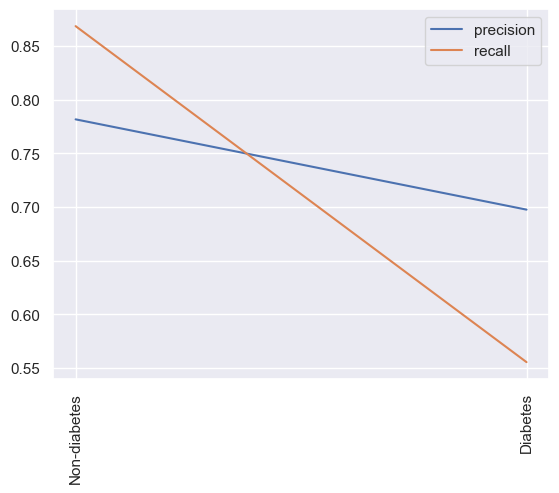

In [122]:
# linear regression with more reduce features: selection: Age, Glucose, BMI,
Important_features =  ['Pregnancies',
                  'Glucose',
                   'BMI', 'DiabetesPedigreeFunction', 'Age']

df_outcome= df['Outcome']

df_reducedf = df[Important_features]
df_reducedf 
df_outcome

x = df_reducedf.to_numpy().astype(np.float32)
y = df_outcome.to_numpy().astype(np.float32)

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)


for n_iter in (10, 30,50, 100, 10000):
  clf = linear_model.LogisticRegression(solver='liblinear', max_iter= n_iter,
                                      multi_class='ovr')
#logreg = LogisticRegression(multi_class='ovr', solver='liblinear')

# 2. fit the model
  t1 = timer()
  clf.fit(x_train, y_train)
  t2 = timer()
  print ('training time: %.1fs'%(t2-t1),'in', n_iter, 'iterations')

# 3. evaluate accuracy on train and test datasets
  print("training score : %.3f" % (clf.score(x_train, y_train)),'in', n_iter, 'iterations')
  print("test score : %.3f" % (clf.score(x_test, y_test)),'in', n_iter, 'iterations')

y_pred_test = clf.predict(x_test)
#y_pred_test_proba= clf.predict_proba(x_test)
#np.sum(_pred_test_proba[0])
sklearn.metrics.confusion_matrix(y_test, y_pred_test, labels=None, sample_weight=None, normalize=None)
y_pred_train=clf.predict(x_train)
sklearn.metrics.confusion_matrix(y_train,y_pred_train)

# 5. inspect the confusion metrics and compute using matrix manipulations the precision and recall for each category


# Assuming you have already obtained 'y_pred' and 'y_test'
# 'y_pred' contains the predicted class labels, and 'y_test' contains the true class labels.

# Calculate the confusion matrix
confusion_test = confusion_matrix(y_test, y_pred_test)

#print("Confusion Matrix test:")
#print(confusion_test)

confusion_train = confusion_matrix(y_train, y_pred_train)

#print("Confusion Matrix train:")
#print(confusion_train)

from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix

cm_display = ConfusionMatrixDisplay(confusion_test).plot()
plt.title('Confusion Matrix Test')
cm_display = ConfusionMatrixDisplay(confusion_train).plot()
plt.title('Confusion Matrix Train')
plt.show()
print(classification_report(y_test, y_pred_test))


Output_names = ['Non-diabetes', 'Diabetes']

print(f'Check that you get the same accuracy from the score method: {np.sum([confusion_test[i,i] for i in range(2)])/np.sum(confusion_test)}')
#sums the diagonal and divide the whole matrix
precisions=[]
recalls=[]
#precision
for i in range(2):
    precisions.append(confusion_test[i,i]/np.sum(confusion_test[:,i])) #take the diagonal divided by the whole column
#percentage of positive identified??
#recall
for i in range(2):
    recalls.append(confusion_test[i,i]/np.sum(confusion_test[i,:])) #take the diagonal and divide by the whole row

plt.plot(Output_names,precisions, label='precision')
plt.plot(Output_names,recalls, label='recall')
plt.xticks(rotation=90)
plt.legend()

plt.show()


training time: 0.0s in 10 iterations
training score : 0.775 in 10 iterations
test score : 0.771 in 10 iterations
training time: 0.0s in 30 iterations
training score : 0.775 in 30 iterations
test score : 0.771 in 30 iterations
training time: 0.0s in 50 iterations
training score : 0.775 in 50 iterations
test score : 0.771 in 50 iterations
training time: 0.0s in 100 iterations
training score : 0.775 in 100 iterations
test score : 0.771 in 100 iterations
training time: 0.0s in 10000 iterations
training score : 0.775 in 10000 iterations
test score : 0.771 in 10000 iterations


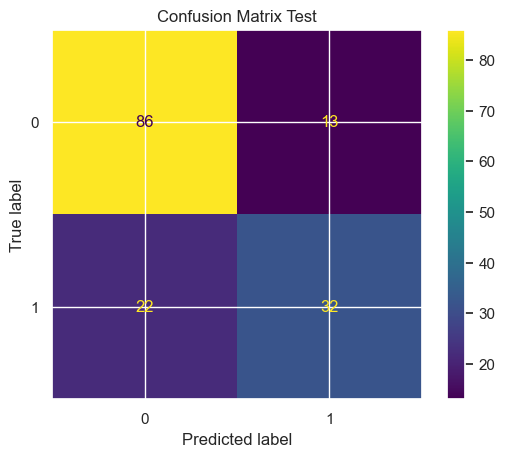

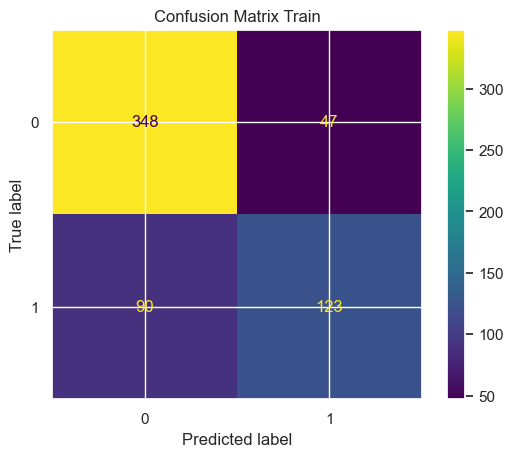

              precision    recall  f1-score   support

         0.0       0.80      0.87      0.83        99
         1.0       0.71      0.59      0.65        54

    accuracy                           0.77       153
   macro avg       0.75      0.73      0.74       153
weighted avg       0.77      0.77      0.77       153

Check that you get the same accuracy from the score method: 0.7712418300653595


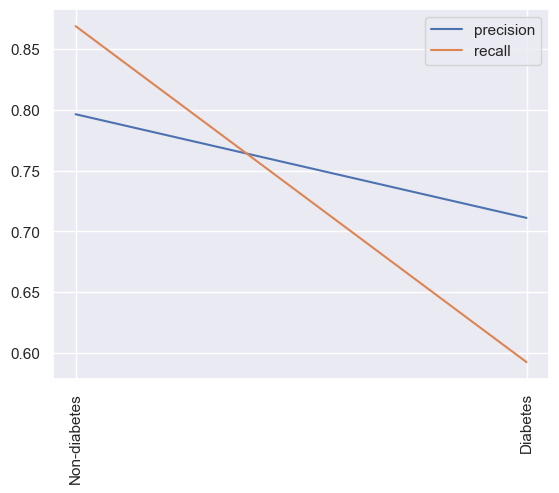

In [123]:
# reducing features in scalar normalization

# linear regression with more reduce features:
Important_features =  [ 'Glucose','Insulin', 'BMI',
                    'DiabetesPedigreeFunction', 'Age']

df_outcome= df['Outcome']

df_reducedf = df[Important_features]
df_reducedf 
df_outcome

x = df_reducedf.to_numpy().astype(np.float32)
y = df_outcome.to_numpy().astype(np.float32)


scaler = StandardScaler()
x_scaled_standar = scaler.fit_transform(x)



x_train, x_test, y_train, y_test = train_test_split(x_scaled_standar, y, test_size=0.2, random_state=42)


for n_iter in (10, 30,50, 100, 10000):
  clf = linear_model.LogisticRegression(solver='liblinear', max_iter= n_iter,
                                      multi_class='ovr')
#logreg = LogisticRegression(multi_class='ovr', solver='liblinear')

# 2. fit the model
  t1 = timer()
  clf.fit(x_train, y_train)
  t2 = timer()
  print ('training time: %.1fs'%(t2-t1),'in', n_iter, 'iterations')

# 3. evaluate accuracy on train and test datasets
  print("training score : %.3f" % (clf.score(x_train, y_train)),'in', n_iter, 'iterations')
  print("test score : %.3f" % (clf.score(x_test, y_test)),'in', n_iter, 'iterations')

y_pred_test = clf.predict(x_test)
#y_pred_test_proba= clf.predict_proba(x_test)
#np.sum(_pred_test_proba[0])
sklearn.metrics.confusion_matrix(y_test, y_pred_test, labels=None, sample_weight=None, normalize=None)
y_pred_train=clf.predict(x_train)
sklearn.metrics.confusion_matrix(y_train,y_pred_train)

# 5. inspect the confusion metrics and compute using matrix manipulations the precision and recall for each category


# Assuming you have already obtained 'y_pred' and 'y_test'
# 'y_pred' contains the predicted class labels, and 'y_test' contains the true class labels.

# Calculate the confusion matrix
confusion_test = confusion_matrix(y_test, y_pred_test)

#print("Confusion Matrix test:")
#print(confusion_test)

confusion_train = confusion_matrix(y_train, y_pred_train)

#print("Confusion Matrix train:")
#print(confusion_train)

from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix

cm_display = ConfusionMatrixDisplay(confusion_test).plot()
plt.title('Confusion Matrix Test')
cm_display = ConfusionMatrixDisplay(confusion_train).plot()
plt.title('Confusion Matrix Train')
plt.show()
print(classification_report(y_test, y_pred_test))


Output_names = ['Non-diabetes', 'Diabetes']

print(f'Check that you get the same accuracy from the score method: {np.sum([confusion_test[i,i] for i in range(2)])/np.sum(confusion_test)}')
#sums the diagonal and divide the whole matrix
precisions=[]
recalls=[]
#precision
for i in range(2):
    precisions.append(confusion_test[i,i]/np.sum(confusion_test[:,i])) #take the diagonal divided by the whole column
#percentage of positive identified??
#recall
for i in range(2):
    recalls.append(confusion_test[i,i]/np.sum(confusion_test[i,:])) #take the diagonal and divide by the whole row

plt.plot(Output_names,precisions, label='precision')
plt.plot(Output_names,recalls, label='recall')
plt.xticks(rotation=90)
plt.legend()

plt.show()
